In [104]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import datetime

input_data = pd.read_csv("2023_smartFarm_AI_hackathon_dataset.csv")


pd.set_option('display.max_rows', 10000)
pd.set_option('display.max_columns', 1000)
pd.options.display.float_format = '{:.2f}'.format

In [135]:
def preprocessing(input_data):
    input_data = input_data.sort_values(["frmDist","date"]).copy()
    input_data["date"] = pd.to_datetime(input_data["date"], format='%Y%m%d')

    input_data = input_data.copy()
    input_data["frmYearWeek"] = input_data.date.dt.strftime('%Y-%W')
    input_data = input_data.sort_values("frmYearWeek")


    tmp_df = input_data.groupby(["frmDist", 'frmYearWeek']).max().reset_index()

    # 16주 이상 농장만
    frmDist_list = (tmp_df.groupby("frmDist").frmYearWeek.count() >= 16).reset_index()

    tmp_df = pd.merge(frmDist_list.loc[frmDist_list.frmYearWeek,["frmDist"]], tmp_df, on="frmDist")

    start_point = ((tmp_df['outtrn_cumsum'] == 0)&
    (tmp_df['outtrn_cumsum'].shift(-1, fill_value=False) != 0) & 
    (tmp_df['outtrn_cumsum'].shift(1, fill_value=False) == 0))

    x_cols = ['inTp', 'inHd', 'otmsuplyqy', 'acSlrdQy', 'cunt',
               'ph', 'outTp', 'outWs', 'daysuplyqy', 'inCo2', 'ec', 
               'frtstGrupp', 'lefstalklt', 'frtstSetCo', 'pllnLt',
               'flanGrupp', 'frtstCo', 'flanJnt', 'tcdmt', 'frmhsFclu', 'hvstGrupp',
               'hvstJnt', 'grwtLt', 'fcluHg', 'lefLt', 'flwrCo', 'hvstCo', 'lefCunt',
               'frtstJnt', 'lefBt', 'stemThck', 'frmAr', 'frmDov', 'outtrn_cumsum',
               'WaterUsage', 'WaterCost', 'FertilizerUsage', 'FertilizerCost',
               'CO2Usage', 'CO2Cost', 'MistUsageTime', 'Mist Cost',
               'HeatingEnergyUsage_cumsum'] 


    agg_dict = {i:'mean' for i in x_cols}
    agg_dict["HeatingEnergyUsage_cumsum"] = 'max'
    agg_dict["outtrn_cumsum"] = 'max'
    agg_dict["frmAr"] = 'max'
    agg_dict["frmDist"] = 'first'
    agg_dict["date"] = 'first'

#     print(agg_dict)
    result_list = []
    for i in tmp_df[start_point].index:
        sub_df = tmp_df[(i-7):(i+9)]
        if len(sub_df.frmDist.unique()) != 1:
            print("NONONO", sub_df.frmDist.unique())
            continue
        result = sub_df.groupby('frmDist').agg(agg_dict)
        result_list.append(result)

    result_df = pd.concat(result_list, ignore_index=True)
#     result_df.columns = list(map('_'.join, result_df.columns.values))
    return result_df




def preprocessing_t(input_data):
    input_data = input_data.sort_values(["frmDist","date"]).copy()
    input_data["date"] = pd.to_datetime(input_data["date"], format='%Y%m%d')

    input_data = input_data.copy()
    input_data["frmYearWeek"] = input_data.date.dt.strftime('%Y-%W')
    input_data = input_data.sort_values("frmYearWeek")


    tmp_df = input_data.groupby(["frmDist", 'frmYearWeek']).max().reset_index()

    # 16주 이상 농장만
    frmDist_list = (tmp_df.groupby("frmDist").frmYearWeek.count() >= 16).reset_index()

    tmp_df = pd.merge(frmDist_list.loc[frmDist_list.frmYearWeek,["frmDist"]], tmp_df, on="frmDist")

    start_point = ((tmp_df['outtrn_cumsum'] == 0)&
    (tmp_df['outtrn_cumsum'].shift(-1, fill_value=False) != 0) & 
    (tmp_df['outtrn_cumsum'].shift(1, fill_value=False) == 0))

#     x_cols = ['inTp', 'inHd', 'otmsuplyqy', 'cunt', 'ph', 'outTp', 'outWs', 'daysuplyqy', 'inCo2', 'ec',
#     'frtstGrupp', 'lefstalklt', 'frtstSetCo',
#     'pllnLt', 'flanGrupp', 'frtstCo', 'flanJnt', 'tcdmt', 'frmhsFclu',
#     'hvstGrupp', 'hvstJnt', 'grwtLt', 'fcluHg', 'lefLt', 'flwrCo', 'hvstCo',
#     'lefCunt', 'frtstJnt', 'lefBt', 'stemThck', 'frmAr', 'frmDov',
#      'WaterUsage', 'WaterCost', 'FertilizerUsage',
#     'FertilizerCost', 'CO2Usage', 'CO2Cost', 'MistUsageTime', 'Mist Cost'] 


#     agg_dict = {i:['max','min','mean'] for i in x_cols}
#     agg_dict["HeatingEnergyUsage_cumsum"] = 'max'
#     agg_dict["outtrn_cumsum"] = 'max'
#     agg_dict["frmAr"] = 'max'
#     agg_dict["frmDist"] = 'first'
#     agg_dict["date"] = 'first'


    result_list = []
    for i in tmp_df[start_point].index:
        sub_df = tmp_df[(i-7):(i+9)]
#         if len(sub_df.frmDist.unique()) != 1:
#             print("NONONO", sub_df.frmDist.unique())
#             continue
#         result = sub_df.groupby('frmDist').agg(agg_dict)
        result_list.append(sub_df)

    result_df = pd.concat(result_list, ignore_index=True)
#     result_df.columns = list(map('_'.join, result_df.columns.values))
    return result_df

result_df = preprocessing(input_data)

result_df2 = preprocessing_t(input_data)

In [136]:
result_df.to_csv("Preprocessed_data_v0.1.csv", index=False)
result_df2.to_csv("Preprocessed_data_timeseries_v0.1.csv", index=False)

In [137]:
result_df

,inTp,inHd,otmsuplyqy,acSlrdQy,cunt,ph,outTp,outWs,daysuplyqy,inCo2,ec,frtstGrupp,lefstalklt,frtstSetCo,pllnLt,flanGrupp,frtstCo,flanJnt,tcdmt,frmhsFclu,hvstGrupp,hvstJnt,grwtLt,fcluHg,lefLt,flwrCo,hvstCo,lefCunt,frtstJnt,lefBt,stemThck,frmAr,frmDov,outtrn_cumsum,WaterUsage,WaterCost,FertilizerUsage,FertilizerCost,CO2Usage,CO2Cost,MistUsageTime,Mist Cost,HeatingEnergyUsage_cumsum,frmDist,date
0,22.73,95.91,91.22,0.00,19.24,6.51,16.96,0.00,0.00,491.88,3.16,5.32,0.00,0.00,0.00,5.98,15.31,0.00,0.00,6.60,0.90,0.00,19.31,24.05,45.87,0.00,0.00,12.78,0.00,44.06,11.61,900,8.50,15486.89,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1186,2017-09-03
1,19.43,87.10,115.73,1484.94,9.99,5.39,5.08,0.00,0.00,565.19,2.95,6.67,0.00,0.00,0.00,7.39,18.75,0.00,0.00,8.01,1.14,0.00,25.82,31.14,55.82,0.00,0.00,12.50,0.00,58.71,10.91,900,7.60,17048.95,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1205,2018-12-09
2,21.69,103.40,223.53,1702.67,15.53,6.55,15.98,0.00,0.00,453.56,2.59,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,42757.95,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1215,2017-09-03
3,18.92,87.75,114.53,1498.88,10.64,5.38,5.31,0.00,0.00,576.68,3.01,6.97,0.00,0.00,0.00,7.43,18.59,0.00,0.00,7.83,1.09,0.00,26.25,30.60,58.48,0.00,0.00,12.51,0.00,58.61,11.05,900,7.60,16609.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1218,2018-12-09
4,18.83,86.67,115.92,1440.80,10.57,5.44,4.96,0.00,0.00,569.53,2.94,6.81,0.00,0.00,0.00,7.18,18.91,0.00,0.00,8.00,1.09,0.00,25.45,30.75,57.61,0.00,0.00,12.31,0.00,57.42,11.13,900,7.60,17739.89,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1232,2018-12-09
5,22.42,102.22,213.67,1734.98,15.43,6.61,16.24,0.00,0.00,449.75,2.65,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,42560.86,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1386,2017-09-03
6,21.98,100.83,163.96,1525.82,13.22,6.28,13.32,2.00,0.00,611.48,3.29,7.38,0.00,0.00,0.00,7.84,17.33,0.00,0.00,8.45,1.99,0.00,22.93,30.49,55.90,0.00,0.00,13.52,0.00,50.99,13.39,800,8.40,20771.73,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1466,2018-09-16
7,21.96,99.52,88.49,0.00,18.64,6.43,17.08,0.00,0.00,485.91,3.21,5.57,0.00,0.00,0.00,6.04,15.73,0.00,0.00,6.68,0.90,0.00,19.35,25.12,42.90,0.00,0.00,13.21,0.00,42.70,10.79,900,8.50,15219.35,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1490,2017-09-03
8,22.12,101.26,219.89,1712.11,15.39,6.72,16.25,0.00,0.00,453.84,2.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,44430.98,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1505,2017-09-03
9,21.15,100.22,87.99,977.46,13.21,6.40,8.08,1.53,0.00,510.07,3.37,5.62,0.00,0.00,0.00,5.92,13.88,0.00,0.00,6.72,1.83,0.00,9.60,19.49,0.00,0.00,0.00,9.94,0.00,0.00,8.26,800,9.40,13547.88,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,DBSF1554,2017-09-24


In [129]:
result_df2[['frmYearWeek','acSlrdQy']]

,frmYearWeek,acSlrdQy
0,2017-35,0.00
1,2017-36,0.00
2,2017-37,0.00
3,2017-38,0.00
4,2017-39,0.00
5,2017-40,0.00
6,2017-41,0.00
7,2017-42,0.00
8,2017-43,0.00
9,2017-44,0.00


8.4(와트퍼미터제곱)  * (설정 온도 - 외기 온도)
MAX 열매 수 
m^2당 2.4(주) = 58개가 max, 2.0

24시간 평균온도 (최소 15 ~ 최대 23)

VPD : 0.2 ~ 1.5
주간 (광량 800w 되면 스크린 닫아야 함)
일일 1500J 필요함 (최소 800J)



In [93]:
result_df.to_csv("Preprocessed_data_v0.1.csv", index=False)

In [94]:
result_df

,inTp,inHd,otmsuplyqy,cunt,ph,outTp,outWs,daysuplyqy,inCo2,ec,frtstGrupp,lefstalklt,frtstSetCo,pllnLt,flanGrupp,frtstCo,flanJnt,tcdmt,frmhsFclu,hvstGrupp,hvstJnt,grwtLt,fcluHg,lefLt,flwrCo,hvstCo,lefCunt,frtstJnt,lefBt,stemThck,frmAr,frmDov,WaterUsage,WaterCost,FertilizerUsage,FertilizerCost,CO2Usage,CO2Cost,MistUsageTime,Mist Cost,HeatingEnergyUsage_cumsum,outtrn_cumsum,frmDist,date
0,22.73,95.91,91.22,19.24,6.51,16.96,0.00,0.00,491.88,3.16,5.32,0.00,0.00,0.00,5.98,15.31,0.00,0.00,6.60,0.90,0.00,19.31,24.05,45.87,0.00,0.00,12.78,0.00,44.06,11.61,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,15486.89,DBSF1186,2017-09-03
1,19.43,87.10,115.73,9.99,5.39,5.08,0.00,0.00,565.19,2.95,6.67,0.00,0.00,0.00,7.39,18.75,0.00,0.00,8.01,1.14,0.00,25.82,31.14,55.82,0.00,0.00,12.50,0.00,58.71,10.91,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17048.95,DBSF1205,2018-12-09
2,21.69,103.40,223.53,15.53,6.55,15.98,0.00,0.00,453.56,2.59,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,42757.95,DBSF1215,2017-09-03
3,18.92,87.75,114.53,10.64,5.38,5.31,0.00,0.00,576.68,3.01,6.97,0.00,0.00,0.00,7.43,18.59,0.00,0.00,7.83,1.09,0.00,26.25,30.60,58.48,0.00,0.00,12.51,0.00,58.61,11.05,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,16609.00,DBSF1218,2018-12-09
4,18.83,86.67,115.92,10.57,5.44,4.96,0.00,0.00,569.53,2.94,6.81,0.00,0.00,0.00,7.18,18.91,0.00,0.00,8.00,1.09,0.00,25.45,30.75,57.61,0.00,0.00,12.31,0.00,57.42,11.13,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17739.89,DBSF1232,2018-12-09
5,22.42,102.22,213.67,15.43,6.61,16.24,0.00,0.00,449.75,2.65,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,42560.86,DBSF1386,2017-09-03
6,21.98,100.83,163.96,13.22,6.28,13.32,2.00,0.00,611.48,3.29,7.38,0.00,0.00,0.00,7.84,17.33,0.00,0.00,8.45,1.99,0.00,22.93,30.49,55.90,0.00,0.00,13.52,0.00,50.99,13.39,800,8.40,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,20771.73,DBSF1466,2018-09-16
7,21.96,99.52,88.49,18.64,6.43,17.08,0.00,0.00,485.91,3.21,5.57,0.00,0.00,0.00,6.04,15.73,0.00,0.00,6.68,0.90,0.00,19.35,25.12,42.90,0.00,0.00,13.21,0.00,42.70,10.79,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,15219.35,DBSF1490,2017-09-03
8,22.12,101.26,219.89,15.39,6.72,16.25,0.00,0.00,453.84,2.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,44430.98,DBSF1505,2017-09-03
9,21.15,100.22,87.99,13.21,6.40,8.08,1.53,0.00,510.07,3.37,5.62,0.00,0.00,0.00,5.92,13.88,0.00,0.00,6.72,1.83,0.00,9.60,19.49,0.00,0.00,0.00,9.94,0.00,0.00,8.26,800,9.40,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,13547.88,DBSF1554,2017-09-24


In [42]:
len(tmp_df.frmDist.unique()

360

In [43]:
# for i in input_data.frmDist.unique():
#     plt.figure(figsize=[5,2])
#     sub_df = input_data[input_data.frmDist==i]
#     print(i, "/ Date:", min(sub_df.date), max(sub_df.date))
#     plt.plot(sub_df.frmYearWeek, sub_df.outtrn_cumsum)
#     plt.xticks(rotation=90)
#     plt.show()

In [44]:
# 16주 이상 농장만
frmDist_list = (input_data.groupby("frmDist").frmYearWeek.count() >= 16).reset_index()

In [45]:
# frmDist_list

In [46]:
tmp_df = pd.merge(frmDist_list.loc[frmDist_list.frmYearWeek,["frmDist"]], tmp_df, on="frmDist")

In [47]:
tmp_df.frmDist.unique().shape

(240,)

In [48]:
start_point = ((tmp_df['outtrn_cumsum'] == 0)&
    (tmp_df['outtrn_cumsum'].shift(-1, fill_value=False) != 0) & 
    (tmp_df['outtrn_cumsum'].shift(1, fill_value=False) == 0))

In [49]:
tmp_df[start_point].index

Int64Index([    9,    60,    97,   149,   188,   225,   274,   317,   366,
              413,
            ...
            10668, 10726, 10778, 10813, 10864, 10901, 10950, 10992, 11033,
            11091],
           dtype='int64', length=240)

In [50]:
start_point

0        False
1        False
2        False
3        False
4        False
         ...  
11125    False
11126    False
11127    False
11128    False
11129    False
Name: outtrn_cumsum, Length: 11130, dtype: bool

In [51]:
tmp_df[(9- 7) : (9+9)]

,frmDist,frmYearWeek,date,inTp,inHd,otmsuplyqy,acSlrdQy,cunt,ph,outTp,outWs,daysuplyqy,inCo2,ec,frmYear,frmWeek,frtstGrupp,lefstalklt,frtstSetCo,pllnLt,flanGrupp,frtstCo,flanJnt,tcdmt,frmhsFclu,hvstGrupp,hvstJnt,grwtLt,fcluHg,lefLt,flwrCo,hvstCo,lefCunt,frtstJnt,lefBt,stemThck,frmAr,frmDov,outtrn_cumsum,WaterUsage,WaterCost,FertilizerUsage,FertilizerCost,CO2Usage,CO2Cost,MistUsageTime,Mist Cost,HeatingEnergyUsage_cumsum
2,DBSF1186,2017-35,2017-09-03,28.06,75.41,71.57,0.00,24.94,6.71,23.75,0.00,0.00,375.71,3.15,2017,35,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,DBSF1186,2017-36,2017-09-10,27.13,92.89,71.12,0.00,14.76,6.60,26.68,0.00,0.00,373.90,3.43,2017,36,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,DBSF1186,2017-37,2017-09-17,27.34,83.84,81.43,0.00,28.09,6.58,25.56,0.00,0.00,399.58,3.34,2017,37,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
5,DBSF1186,2017-38,2017-09-24,26.53,103.59,83.64,0.00,26.36,6.52,24.47,0.00,0.00,394.65,3.19,2017,38,1.90,0.00,0.00,0.00,2.24,6.40,0.00,0.00,2.95,0.00,0.00,0.00,25.79,39.32,0.00,0.00,9.98,0.00,44.45,14.96,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
6,DBSF1186,2017-39,2017-10-01,26.48,102.90,88.35,0.00,29.80,6.63,26.37,0.00,0.00,380.08,3.07,2017,39,2.55,0.00,0.00,0.00,3.41,10.00,0.00,0.00,3.99,0.00,0.00,27.12,32.37,61.09,0.00,0.00,13.25,0.00,62.84,19.55,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
7,DBSF1186,2017-40,2017-10-08,21.92,102.83,82.73,0.00,24.84,6.69,23.87,0.00,0.00,401.69,3.21,2017,40,3.50,0.00,0.00,0.00,5.40,12.66,0.00,0.00,5.31,0.00,0.00,29.82,28.99,63.49,0.00,0.00,15.68,0.00,54.12,14.78,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
8,DBSF1186,2017-41,2017-10-15,25.96,104.82,82.82,0.00,22.52,6.65,21.50,0.00,0.00,451.94,3.19,2017,41,4.55,0.00,0.00,0.00,5.01,14.46,0.00,0.00,6.01,0.00,0.00,29.75,23.91,59.13,0.00,0.00,16.79,0.00,60.87,17.55,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
9,DBSF1186,2017-42,2017-10-22,21.98,93.20,75.35,0.00,22.74,6.39,20.30,0.00,0.00,488.92,3.13,2017,42,6.06,0.00,0.00,0.00,6.50,18.90,0.00,0.00,6.77,0.00,0.00,31.71,38.62,60.47,0.00,0.00,15.68,0.00,62.36,15.54,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
10,DBSF1186,2017-43,2017-10-29,21.82,86.87,71.10,0.00,22.51,6.51,16.47,0.00,0.00,517.07,3.07,2017,43,5.79,0.00,0.00,0.00,6.91,23.42,0.00,0.00,7.65,0.00,0.00,23.96,27.61,58.96,0.00,0.00,13.04,0.00,65.06,14.50,900,8.50,1076.34,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
11,DBSF1186,2017-44,2017-11-05,20.55,105.70,83.20,0.00,19.71,6.52,15.73,0.00,0.00,550.75,2.81,2017,44,7.29,0.00,0.00,0.00,7.13,25.05,0.00,0.00,9.42,0.37,0.00,20.07,23.61,58.01,0.00,0.00,15.97,0.00,48.99,11.66,900,8.50,2387.99,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [52]:
tmp_df.outtrn_cumsum / tmp_df.frmAr

0        0.00
1        0.00
2        0.00
3        0.00
4        0.00
         ... 
11125   62.68
11126   64.82
11127   67.46
11128   67.53
11129   73.90
Length: 11130, dtype: float64

In [75]:
tmp_df.frmAr.describe()

count   11130.00
mean     1387.60
std       829.58
min       800.00
25%       900.00
50%      1200.00
75%      1500.00
max      3400.00
Name: frmAr, dtype: float64

In [76]:
tmp_df.columns

Index(['frmDist', 'frmYearWeek', 'date', 'inTp', 'inHd', 'otmsuplyqy',
       'acSlrdQy', 'cunt', 'ph', 'outTp', 'outWs', 'daysuplyqy', 'inCo2', 'ec',
       'frmYear', 'frmWeek', 'frtstGrupp', 'lefstalklt', 'frtstSetCo',
       'pllnLt', 'flanGrupp', 'frtstCo', 'flanJnt', 'tcdmt', 'frmhsFclu',
       'hvstGrupp', 'hvstJnt', 'grwtLt', 'fcluHg', 'lefLt', 'flwrCo', 'hvstCo',
       'lefCunt', 'frtstJnt', 'lefBt', 'stemThck', 'frmAr', 'frmDov',
       'outtrn_cumsum', 'WaterUsage', 'WaterCost', 'FertilizerUsage',
       'FertilizerCost', 'CO2Usage', 'CO2Cost', 'MistUsageTime', 'Mist Cost',
       'HeatingEnergyUsage_cumsum'],
      dtype='object')

In [77]:
x_cols = ['inTp', 'inHd', 'otmsuplyqy', 'cunt', 'ph', 'outTp', 'outWs', 'daysuplyqy', 'inCo2', 'ec',
'frtstGrupp', 'lefstalklt', 'frtstSetCo',
'pllnLt', 'flanGrupp', 'frtstCo', 'flanJnt', 'tcdmt', 'frmhsFclu',
'hvstGrupp', 'hvstJnt', 'grwtLt', 'fcluHg', 'lefLt', 'flwrCo', 'hvstCo',
'lefCunt', 'frtstJnt', 'lefBt', 'stemThck', 'frmAr', 'frmDov',
 'WaterUsage', 'WaterCost', 'FertilizerUsage',
'FertilizerCost', 'CO2Usage', 'CO2Cost', 'MistUsageTime', 'Mist Cost']

In [78]:
x_cols += ['WaterUsage', 'WaterCost', 'FertilizerUsage',
'FertilizerCost', 'CO2Usage', 'CO2Cost', 'MistUsageTime', 'Mist Cost']

In [79]:

agg_dict = {i:'mean' for i in x_cols}
agg_dict["HeatingEnergyUsage_cumsum"] = 'max'
agg_dict["outtrn_cumsum"] = 'max'
agg_dict["frmAr"] = 'max'
agg_dict["frmDist"] = 'first'
agg_dict["date"] = 'first'


In [80]:
result_list = []
for i in tmp_df[start_point].index:
    sub_df = tmp_df[(i-7):(i+9)]
    if len(sub_df.frmDist.unique()) != 1:
        print("NONONO", sub_df.frmDist.unique())
        continue
    result = sub_df.groupby('frmDist').agg(agg_dict)
    result_list.append(result)

In [81]:
result_df = pd.concat(result_list, ignore_index=True)
result_df

,inTp,inHd,otmsuplyqy,cunt,ph,outTp,outWs,daysuplyqy,inCo2,ec,frtstGrupp,lefstalklt,frtstSetCo,pllnLt,flanGrupp,frtstCo,flanJnt,tcdmt,frmhsFclu,hvstGrupp,hvstJnt,grwtLt,fcluHg,lefLt,flwrCo,hvstCo,lefCunt,frtstJnt,lefBt,stemThck,frmAr,frmDov,WaterUsage,WaterCost,FertilizerUsage,FertilizerCost,CO2Usage,CO2Cost,MistUsageTime,Mist Cost,HeatingEnergyUsage_cumsum,outtrn_cumsum,frmDist,date
0,22.73,95.91,91.22,19.24,6.51,16.96,0.00,0.00,491.88,3.16,5.32,0.00,0.00,0.00,5.98,15.31,0.00,0.00,6.60,0.90,0.00,19.31,24.05,45.87,0.00,0.00,12.78,0.00,44.06,11.61,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,15486.89,DBSF1186,2017-09-03
1,19.43,87.10,115.73,9.99,5.39,5.08,0.00,0.00,565.19,2.95,6.67,0.00,0.00,0.00,7.39,18.75,0.00,0.00,8.01,1.14,0.00,25.82,31.14,55.82,0.00,0.00,12.50,0.00,58.71,10.91,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17048.95,DBSF1205,2018-12-09
2,21.69,103.40,223.53,15.53,6.55,15.98,0.00,0.00,453.56,2.59,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,42757.95,DBSF1215,2017-09-03
3,18.92,87.75,114.53,10.64,5.38,5.31,0.00,0.00,576.68,3.01,6.97,0.00,0.00,0.00,7.43,18.59,0.00,0.00,7.83,1.09,0.00,26.25,30.60,58.48,0.00,0.00,12.51,0.00,58.61,11.05,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,16609.00,DBSF1218,2018-12-09
4,18.83,86.67,115.92,10.57,5.44,4.96,0.00,0.00,569.53,2.94,6.81,0.00,0.00,0.00,7.18,18.91,0.00,0.00,8.00,1.09,0.00,25.45,30.75,57.61,0.00,0.00,12.31,0.00,57.42,11.13,900,7.60,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17739.89,DBSF1232,2018-12-09
5,22.42,102.22,213.67,15.43,6.61,16.24,0.00,0.00,449.75,2.65,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,42560.86,DBSF1386,2017-09-03
6,21.98,100.83,163.96,13.22,6.28,13.32,2.00,0.00,611.48,3.29,7.38,0.00,0.00,0.00,7.84,17.33,0.00,0.00,8.45,1.99,0.00,22.93,30.49,55.90,0.00,0.00,13.52,0.00,50.99,13.39,800,8.40,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,20771.73,DBSF1466,2018-09-16
7,21.96,99.52,88.49,18.64,6.43,17.08,0.00,0.00,485.91,3.21,5.57,0.00,0.00,0.00,6.04,15.73,0.00,0.00,6.68,0.90,0.00,19.35,25.12,42.90,0.00,0.00,13.21,0.00,42.70,10.79,900,8.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,15219.35,DBSF1490,2017-09-03
8,22.12,101.26,219.89,15.39,6.72,16.25,0.00,0.00,453.84,2.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,44430.98,DBSF1505,2017-09-03
9,21.15,100.22,87.99,13.21,6.40,8.08,1.53,0.00,510.07,3.37,5.62,0.00,0.00,0.00,5.92,13.88,0.00,0.00,6.72,1.83,0.00,9.60,19.49,0.00,0.00,0.00,9.94,0.00,0.00,8.26,800,9.40,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,13547.88,DBSF1554,2017-09-24


In [82]:
result_df = pd.concat(result_list, ignore_index=True)

result_df.to_csv("Preprocessed_data_v0.1.csv", index=False)

In [83]:
["HeatingEnergyUsage_cumsum", "outtrn_cumsum"]

['HeatingEnergyUsage_cumsum', 'outtrn_cumsum']

In [84]:
result_df = pd.concat(result_list, ignore_index=True)

In [416]:
result_df.outtrn_cumsum / result_df.frmAr

0     17.21
1     18.94
2     12.58
3     18.45
4     19.71
5     12.52
6     25.96
7     16.91
8     13.07
9     16.93
10    19.02
11    15.63
12     5.45
13     5.96
14    18.55
15    16.64
16     5.64
17     5.64
18    18.89
19    17.90
20    15.90
21    16.26
22    16.86
23    17.12
24    15.72
25    12.78
26    17.42
27    17.66
28    19.03
29    25.21
30    12.36
31     5.50
32    17.66
33    16.45
34    17.30
35    18.47
36    16.96
37    18.91
38    17.67
39    16.64
40    19.62
41    16.84
42    15.91
43    16.88
44    24.96
45    12.95
46    16.26
47     5.89
48    24.85
49    18.18
50    16.04
51    19.42
52     5.74
53    18.04
54    24.48
55    15.34
56    14.94
57    18.23
58    13.01
59    18.11
60    25.33
61     6.08
62    16.17
63    16.10
64    17.98
65    18.63
66    16.07
67    16.37
68    24.35
69    12.87
70    17.05
71    16.29
72    18.77
73    19.19
74    25.73
75    24.45
76    26.00
77    24.59
78    19.56
79     5.67
80     5.68
81    15.98
82    15.47
83  

In [405]:
pd.DataFrame({"수확량":result_df.outtrn_cumsum, "면적":result_df.frmAr, "누적수확":result_df.outtrn_cumsum / result_df.frmAr})

,수확량,면적,누적수확
0,15486.89,900,17.21
1,17048.95,900,18.94
2,42757.95,3400,12.58
3,16609.00,900,18.45
4,17739.89,900,19.71
5,42560.86,3400,12.52
6,20771.73,800,25.96
7,15219.35,900,16.91
8,44430.98,3400,13.07
9,13547.88,800,16.93


In [404]:
result_df.frmAr

0       900
1       900
2      3400
3       900
4       900
5      3400
6       800
7       900
8      3400
9       800
10      900
11      900
12     1300
13     1300
14      900
15      900
16     1300
17     1300
18     1200
19     1200
20      800
21     1500
22      900
23      900
24     1500
25     3400
26      900
27      900
28     1200
29      800
30     3400
31     1300
32     1200
33     1500
34     1200
35     1200
36      900
37     1200
38     1200
39     1500
40      900
41      800
42     1500
43      900
44      800
45     3400
46      800
47     1300
48      800
49     1200
50      900
51      900
52     1300
53     1200
54      800
55     1500
56     1500
57     1200
58     3400
59      900
60      800
61     1300
62     1500
63      900
64      900
65      900
66     1500
67     1500
68      800
69     3400
70      900
71      900
72     1200
73      900
74      800
75      800
76      800
77      800
78     1200
79     1300
80     1300
81      900
82     1500
83  

In [246]:
tmp_df.groupby('frmDist')["outtrn_cumsum"].transform(pd.Series.cumsum)

0              0.00
1              0.00
2              0.00
3              0.00
4              0.00
            ...    
84835   19289431.47
84836   19517378.59
84837   19748906.02
84838   20000160.34
84839   20000160.34
Name: outtrn_cumsum, Length: 84840, dtype: float64

In [247]:
tmp_df["outtrn_cumsum_new"] = tmp_df.groupby('frmDist')["outtrn_cumsum"].transform(pd.Series.cumsum)

In [251]:
tmp_df[(tmp_df["outtrn_cumsum"] == 0)&(tmp_df["outtrn_cumsum_new"] != 0)]

,frmDist,date,inTp,inHd,otmsuplyqy,acSlrdQy,cunt,ph,outTp,outWs,daysuplyqy,inCo2,ec,frmYear,frmWeek,frtstGrupp,lefstalklt,frtstSetCo,pllnLt,flanGrupp,frtstCo,flanJnt,tcdmt,frmhsFclu,hvstGrupp,hvstJnt,grwtLt,fcluHg,lefLt,flwrCo,hvstCo,lefCunt,frtstJnt,lefBt,stemThck,frmAr,frmDov,outtrn_cumsum,WaterUsage,WaterCost,FertilizerUsage,FertilizerCost,CO2Usage,CO2Cost,MistUsageTime,Mist Cost,HeatingEnergyUsage_cumsum,outtrn_cumsum_new
48,DBSF1059,2022-11-17,0.00,0.00,0.00,0.00,0.00,6.14,0.00,0.00,0.00,0.00,3.31,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,30,4.50,0.00,1832.28,274.84,4531.15,5709.25,0.00,0.00,226.21,2642.16,703420.31,1.47
50,DBSF1059,2022-11-19,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,30,4.50,0.00,1855.50,278.33,4653.46,5863.36,0.00,0.00,590.64,6898.65,776027.33,7.16
51,DBSF1059,2022-11-20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,30,4.50,0.00,1039.14,155.87,3004.34,3785.46,0.00,0.00,328.59,3837.91,800315.06,7.16
53,DBSF1059,2022-11-22,0.00,0.00,0.00,0.00,0.00,6.35,0.00,0.00,0.00,0.00,2.37,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,30,4.50,0.00,1114.33,167.15,2785.94,3510.28,0.00,0.00,187.57,2190.83,871150.73,21.67
55,DBSF1059,2022-11-24,0.00,0.00,0.00,0.00,0.00,6.90,0.00,0.00,0.00,0.00,3.16,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,30,4.50,0.00,1203.95,180.59,2851.48,3592.86,0.00,0.00,231.82,2707.64,847794.97,45.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84825,DBSF9969,2018-06-30,28.12,91.24,49.31,646.20,18.79,6.08,27.31,0.15,0.00,304.42,2.30,2018,26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17698256.65
84826,DBSF9969,2018-07-01,23.88,79.64,38.20,488.26,11.70,5.06,26.33,0.39,0.00,358.56,1.84,2018,26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,17698256.65
84832,DBSF9969,2018-07-07,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,18816977.17
84833,DBSF9969,2018-07-08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3400,8.20,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,18816977.17


In [256]:
tmp_df.groupby('frmDist').agg({
                                   
    'date':['count','min', 'max'],
    'HeatingEnergyUsage_cumsum' : ['min', 'max', 'mean'],
    'outtrn_cumsum' : ['max'],
#     'hvstCo' : ['sum']
                                  })

date                       HeatingEnergyUsage_cumsum             \
         count        min        max                       min        max   
frmDist                                                                     
DBSF1059    72 2022-09-26 2022-12-12                      0.00 3543467.14   
DBSF1093    72 2022-09-26 2022-12-12                      0.00 2282252.09   
DBSF1121    72 2022-09-26 2022-12-12                      0.00 3185110.74   
DBSF1172    72 2022-09-26 2022-12-12                      0.00 3258953.97   
DBSF1180    72 2022-09-26 2022-12-12                      0.00 2366789.91   
DBSF1186   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1205   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1215   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1218   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1232   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1279    72 2022-09-26 2022-12-12                      0.00 3902693.24   
DBSF1294    72 2022-09-26 2022-12-12                      0.00 3372594.62   
DBSF1385    72 2022-09-26 2022-12-12                      0.00 3188061.84   
DBSF1386   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1459    72 2022-09-26 2022-12-12                      0.00 3793535.26   
DBSF1466   300 2018-08-20 2019-06-15                      0.00       0.00   
DBSF1469    72 2022-09-26 2022-12-12                      0.00 3229884.86   
DBSF1490   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1505   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1507    72 2022-09-26 2022-12-12                      0.00 2299817.81   
DBSF1539    72 2022-09-26 2022-12-12                      0.00 2339169.96   
DBSF1554   287 2017-09-17 2018-06-30                      0.00       0.00   
DBSF1601    72 2022-09-26 2022-12-12                      0.00 2255898.14   
DBSF1621    72 2022-09-26 2022-12-12                      0.00 3291436.72   
DBSF1644   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1645   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1673   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1757   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1767   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1871    72 2022-09-26 2022-12-12                      0.00 3368531.42   
DBSF1873    72 2022-09-26 2022-12-12                      0.00 2406491.65   
DBSF1880   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1886   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1916   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1921    72 2022-09-26 2022-12-12                      0.00 3594519.85   
DBSF1934   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1974    72 2022-09-26 2022-12-12                      0.00 2359549.94   
DBSF1975   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1991   287 2017-09-17 2018-06-30                      0.00       0.00   
DBSF1998    72 2022-09-26 2022-12-12                      0.00 2893154.69   
DBSF2008   329 2017-08-13 2018-07-07                      0.00       0.00   
DBSF2027   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF2032   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF2044    72 2022-09-26 2022-12-12                      0.00 2957560.30   
DBSF2117    72 2022-09-26 2022-12-12                      0.00 3804755.43   
DBSF2191   329 2017-08-13 2018-07-07                      0.00       0.00   
DBSF2212    72 2022-09-26 2022-12-12                      0.00 3476638.90   
DBSF2218   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF2244   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF22

In [259]:
# tmp_df.groupby('frmDist').agg({'date' : ['count', lambda x : len(x.unique())]})

In [206]:
d = tmp_df.frmYear.astype(str) +"-" +  tmp_df.frmWeek.astype(str)
tmp_df["frmYearMonth"] = d.apply(lambda x : pd.datetime.strptime(x + '-6', "%Y-%W-%w").strftime('%Y-%m'))

C:\Users\83189\AppData\Local\Temp\ipykernel_2604\2385970531.py:2: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  tmp_df["frmYearMonth"] = d.apply(lambda x : pd.datetime.strptime(x + '-6', "%Y-%W-%w").strftime('%Y-%m'))


In [262]:
tmp_df3 = tmp_df.copy()
tmp_df3.loc[((tmp_df3["outtrn_cumsum"] == 0)&(tmp_df3["outtrn_cumsum_new"] != 0)), "outtrn_cumsum"] = np.nan
tmp_df3["outtrn_cumsum"] = tmp_df3["outtrn_cumsum"].ffill()

In [208]:
tmp_df.loc[tmp_df.date.dt.strftime('%Y-%m') != tmp_df["frmYearMonth"], ["date", 'frmYearMonth']]

,date,frmYearMonth
16914,2017-07-31,2017-08
6511,2017-07-31,2017-08
36578,2017-07-31,2017-08
55927,2017-07-31,2017-08
36949,2017-07-31,2017-08
52580,2017-07-31,2017-08
54833,2017-07-31,2017-08
56620,2017-07-31,2017-08
29142,2017-07-31,2017-08
76235,2017-07-31,2017-08


In [ ]:
tmp_df

In [154]:
input_data.groupby('frmDist').agg({
                                   
    'date':['count','min', 'max'],
    'HeatingEnergyUsage_cumsum' : ['min', 'max', 'mean'],
    'outtrn_cumsum' : ['max'],
#     'hvstCo' : ['sum']
                                  })

date                       HeatingEnergyUsage_cumsum             \
         count        min        max                       min        max   
frmDist                                                                     
DBSF1059    72 2022-09-26 2022-12-12                      0.00 3543467.14   
DBSF1093    72 2022-09-26 2022-12-12                      0.00 2282252.09   
DBSF1121    72 2022-09-26 2022-12-12                      0.00 3185110.74   
DBSF1172    72 2022-09-26 2022-12-12                      0.00 3258953.97   
DBSF1180    72 2022-09-26 2022-12-12                      0.00 2366789.91   
DBSF1186   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1205   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1215   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1218   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1232   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1279    72 2022-09-26 2022-12-12                      0.00 3902693.24   
DBSF1294    72 2022-09-26 2022-12-12                      0.00 3372594.62   
DBSF1385    72 2022-09-26 2022-12-12                      0.00 3188061.84   
DBSF1386   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1459    72 2022-09-26 2022-12-12                      0.00 3793535.26   
DBSF1466   300 2018-08-20 2019-06-15                      0.00       0.00   
DBSF1469    72 2022-09-26 2022-12-12                      0.00 3229884.86   
DBSF1490   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1505   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF1507    72 2022-09-26 2022-12-12                      0.00 2299817.81   
DBSF1539    72 2022-09-26 2022-12-12                      0.00 2339169.96   
DBSF1554   287 2017-09-17 2018-06-30                      0.00       0.00   
DBSF1601    72 2022-09-26 2022-12-12                      0.00 2255898.14   
DBSF1621    72 2022-09-26 2022-12-12                      0.00 3291436.72   
DBSF1644   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1645   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1673   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1757   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1767   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF1871    72 2022-09-26 2022-12-12                      0.00 3368531.42   
DBSF1873    72 2022-09-26 2022-12-12                      0.00 2406491.65   
DBSF1880   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1886   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1916   371 2017-07-09 2018-07-14                      0.00       0.00   
DBSF1921    72 2022-09-26 2022-12-12                      0.00 3594519.85   
DBSF1934   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1974    72 2022-09-26 2022-12-12                      0.00 2359549.94   
DBSF1975   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF1991   287 2017-09-17 2018-06-30                      0.00       0.00   
DBSF1998    72 2022-09-26 2022-12-12                      0.00 2893154.69   
DBSF2008   329 2017-08-13 2018-07-07                      0.00       0.00   
DBSF2027   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF2032   322 2017-08-20 2018-07-07                      0.00       0.00   
DBSF2044    72 2022-09-26 2022-12-12                      0.00 2957560.30   
DBSF2117    72 2022-09-26 2022-12-12                      0.00 3804755.43   
DBSF2191   329 2017-08-13 2018-07-07                      0.00       0.00   
DBSF2212    72 2022-09-26 2022-12-12                      0.00 3476638.90   
DBSF2218   348 2017-08-01 2018-07-14                      0.00       0.00   
DBSF2244   261 2018-10-26 2019-07-13                      0.00       0.00   
DBSF22

DBSF1059 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


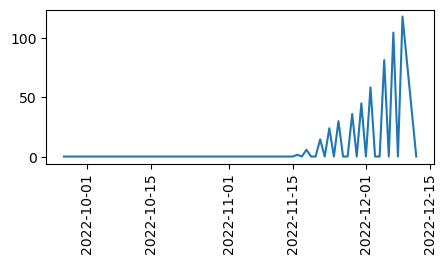

DBSF1093 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


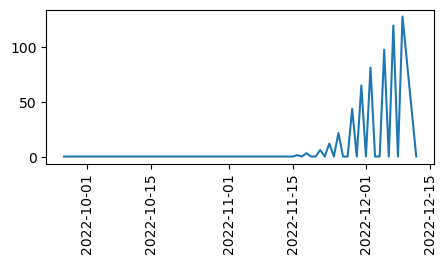

DBSF1121 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


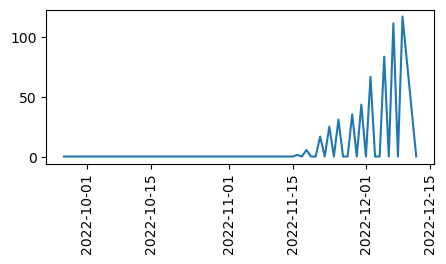

DBSF1172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


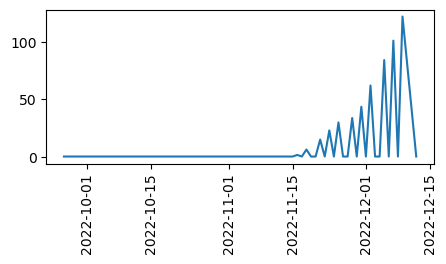

DBSF1180 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


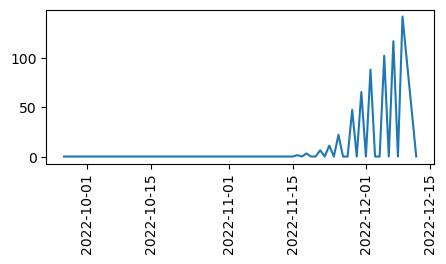

DBSF1186 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


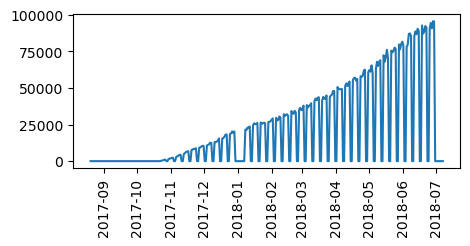

DBSF1205 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


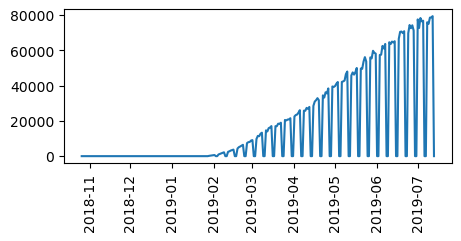

DBSF1215 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


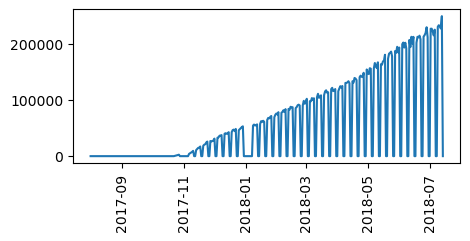

DBSF1218 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


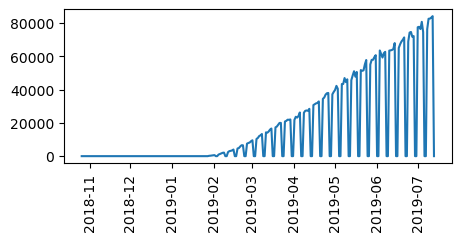

DBSF1232 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


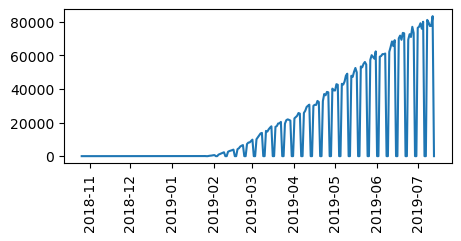

DBSF1279 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


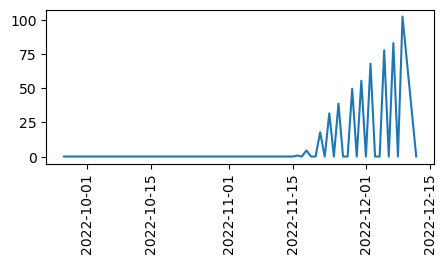

DBSF1294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


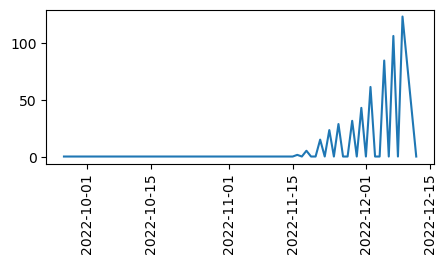

DBSF1385 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


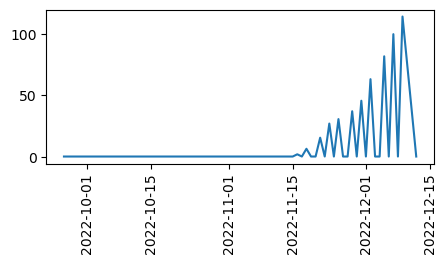

DBSF1386 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


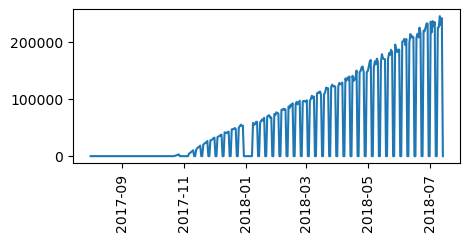

DBSF1459 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


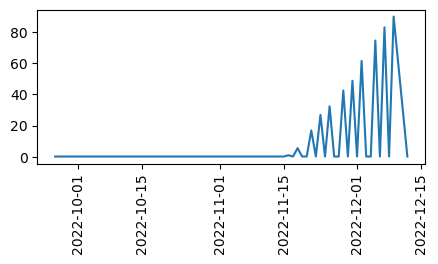

DBSF1466 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


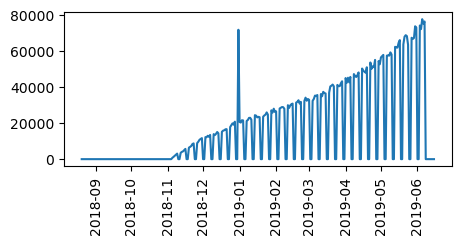

DBSF1469 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


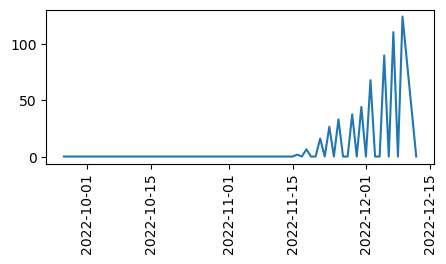

DBSF1490 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


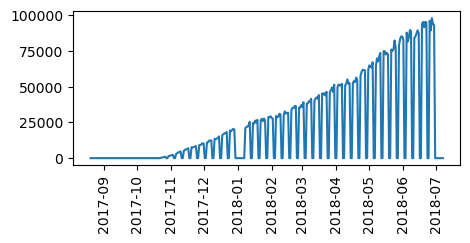

DBSF1505 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


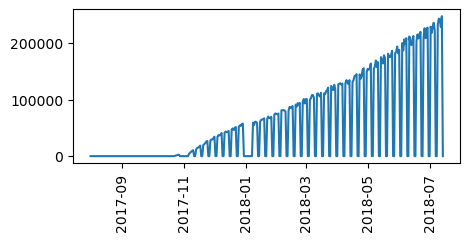

DBSF1507 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


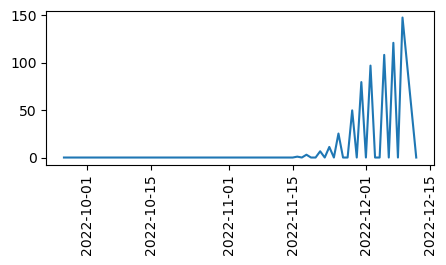

DBSF1539 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


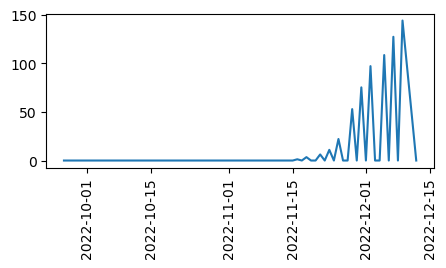

DBSF1554 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


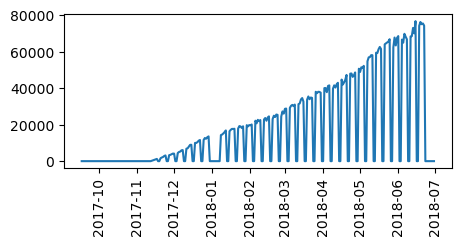

DBSF1601 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


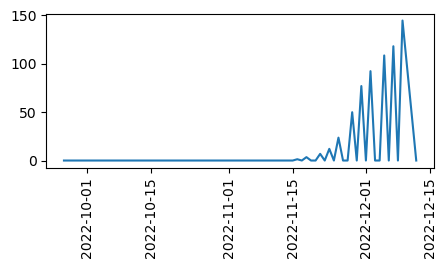

DBSF1621 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


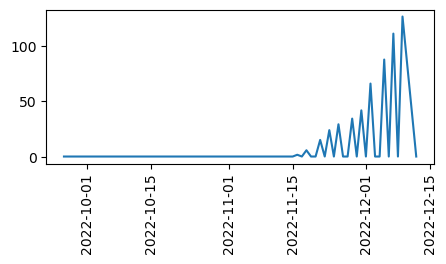

DBSF1644 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


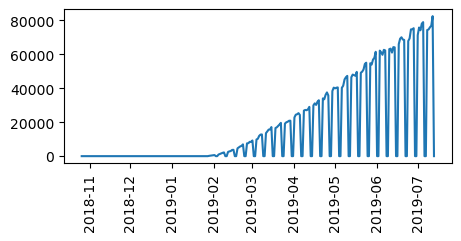

DBSF1645 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


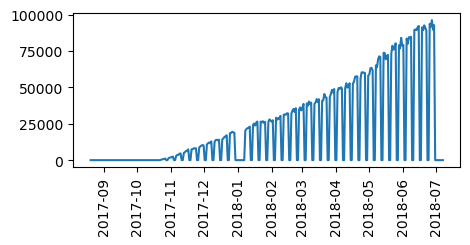

DBSF1673 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


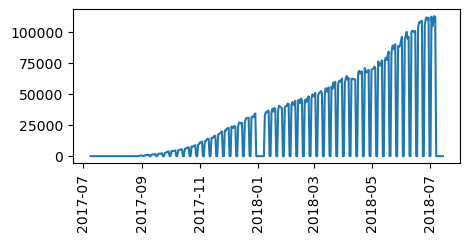

DBSF1757 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


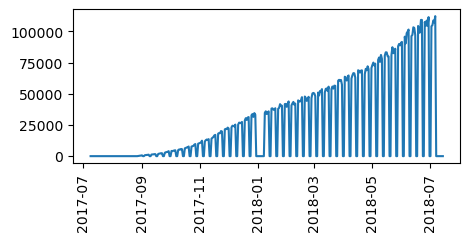

DBSF1767 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


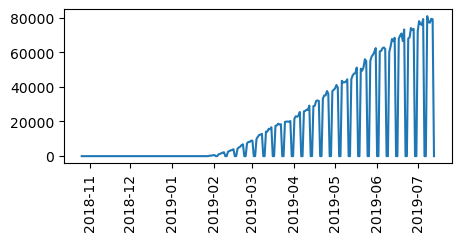

DBSF1871 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


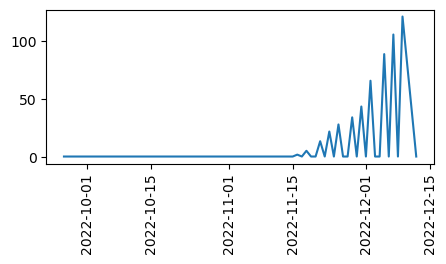

DBSF1873 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


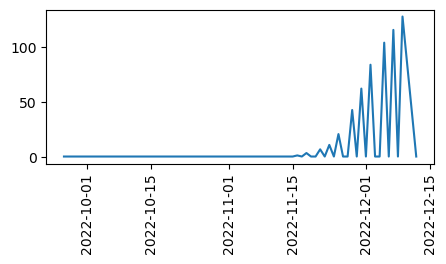

DBSF1880 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


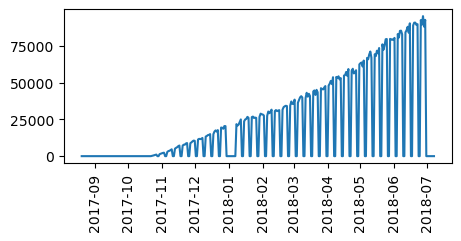

DBSF1886 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


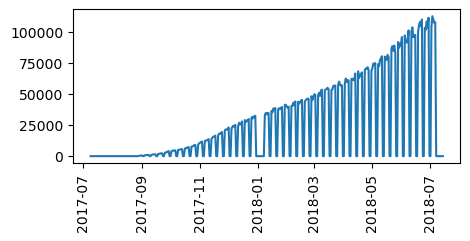

DBSF1916 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


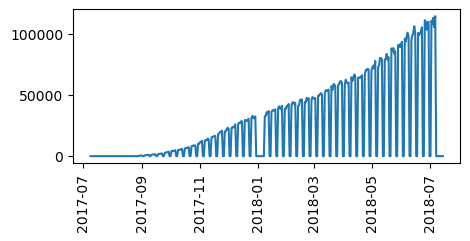

DBSF1921 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


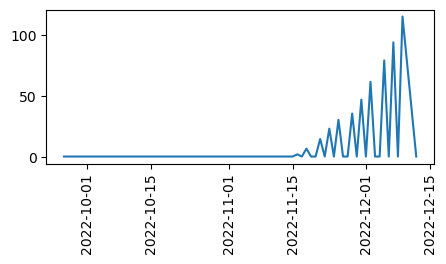

DBSF1934 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


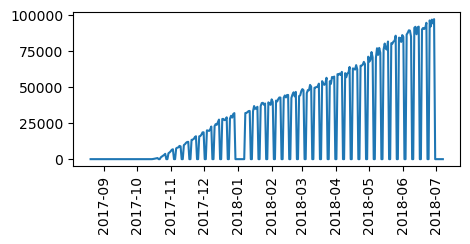

DBSF1974 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


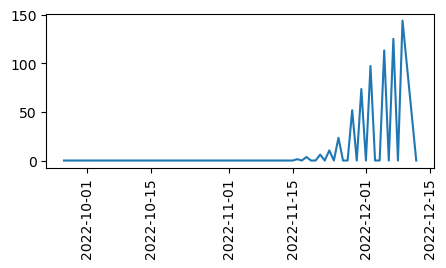

DBSF1975 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


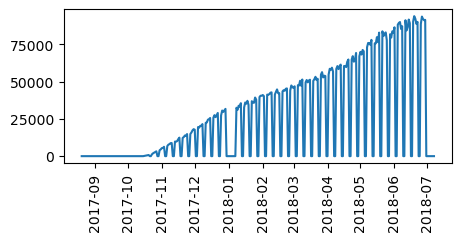

DBSF1991 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


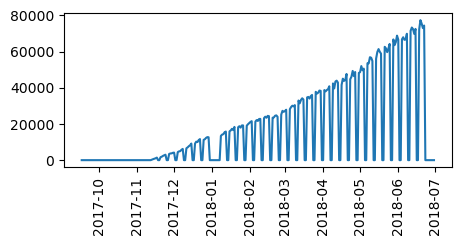

DBSF1998 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


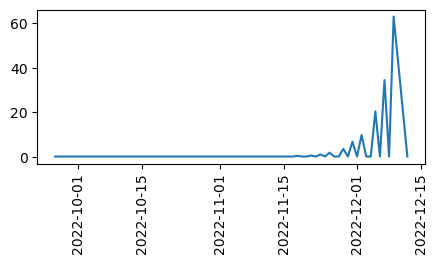

DBSF2008 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


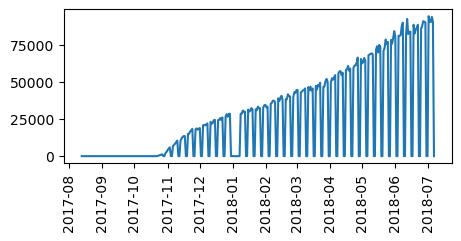

DBSF2027 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


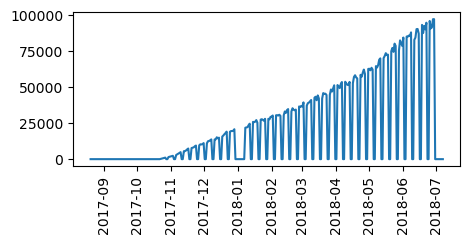

DBSF2032 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


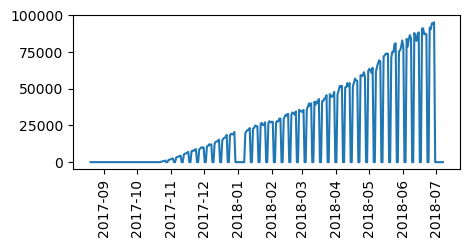

DBSF2044 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


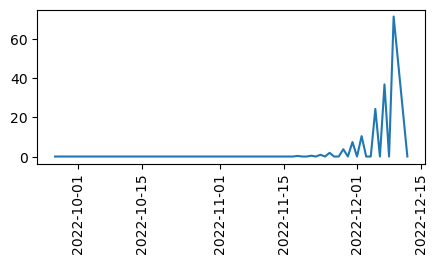

DBSF2117 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


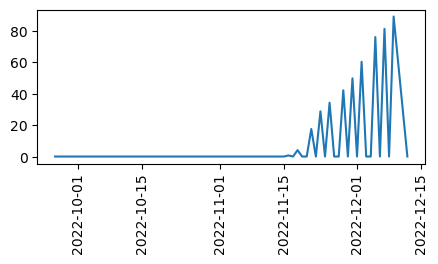

DBSF2191 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


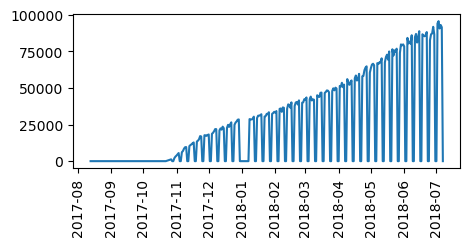

DBSF2212 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


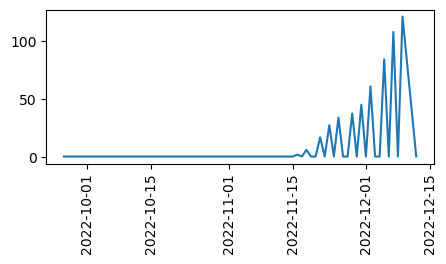

DBSF2218 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


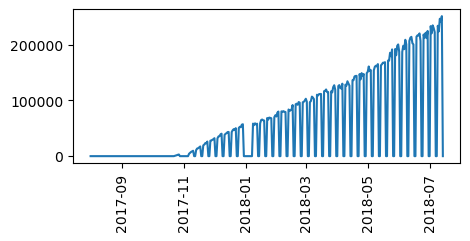

DBSF2244 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


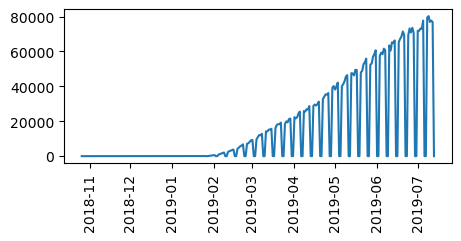

DBSF2252 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


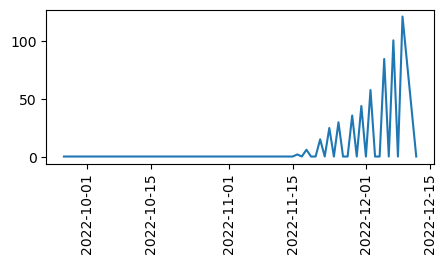

DBSF2256 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


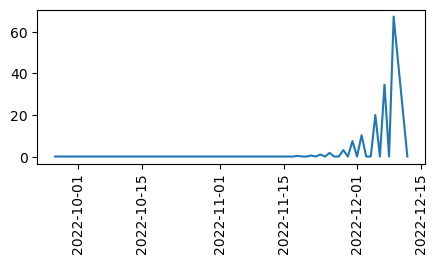

DBSF2259 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


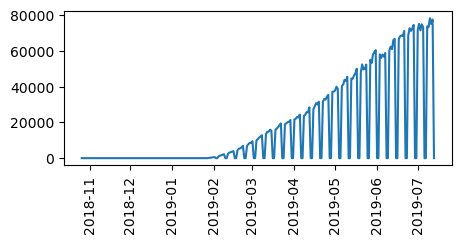

DBSF2274 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


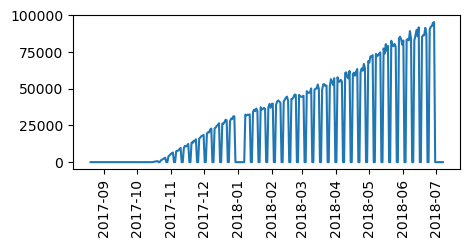

DBSF2318 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


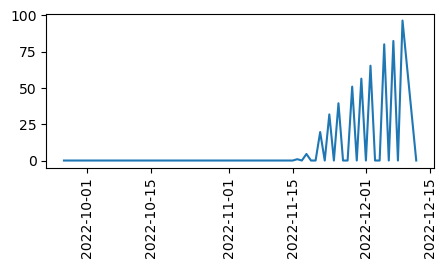

DBSF2319 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


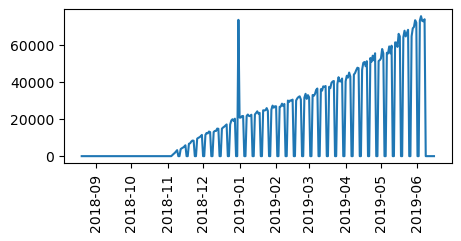

DBSF2334 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


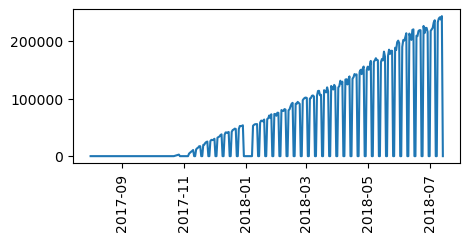

DBSF2335 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


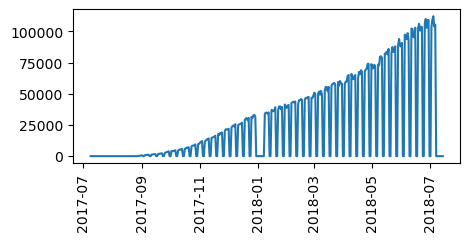

DBSF2347 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


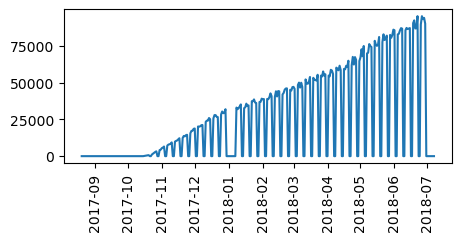

DBSF2352 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


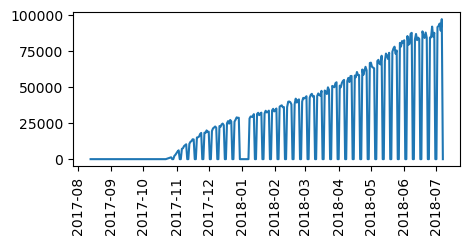

DBSF2360 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


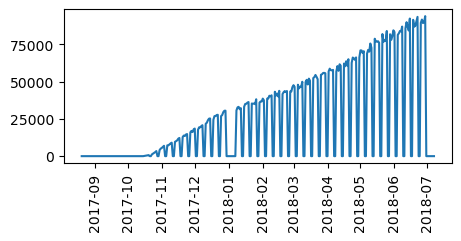

DBSF2371 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


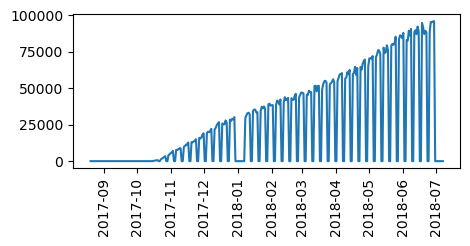

DBSF2376 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


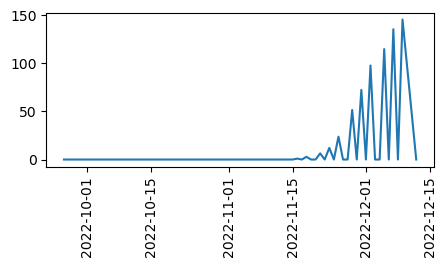

DBSF2378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


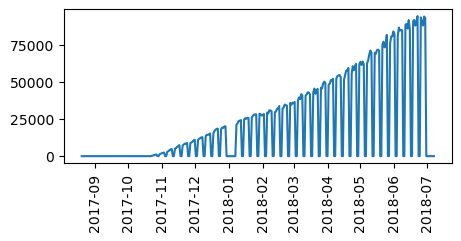

DBSF2389 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


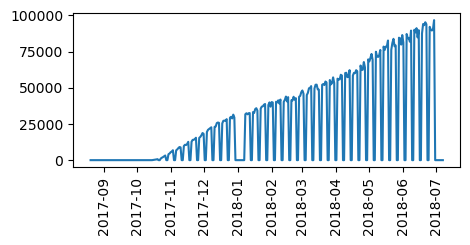

DBSF2413 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


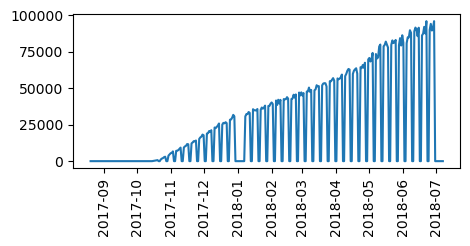

DBSF2422 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


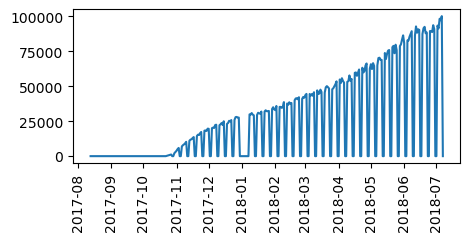

DBSF2471 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


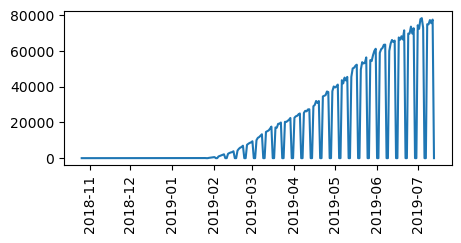

DBSF2525 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


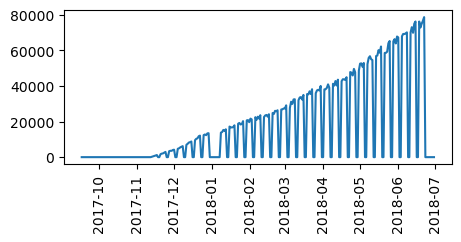

DBSF2571 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


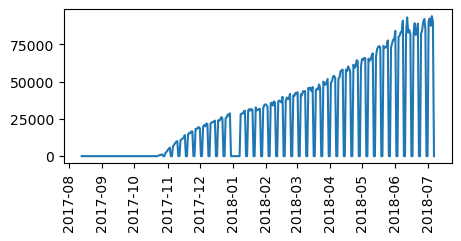

DBSF2630 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


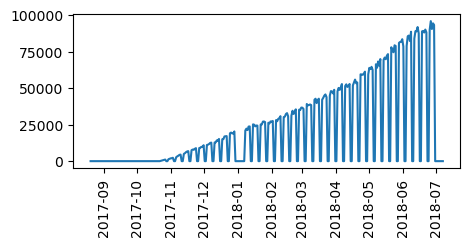

DBSF2640 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


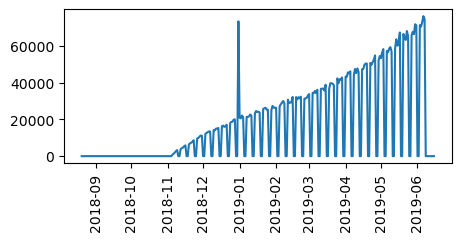

DBSF2681 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


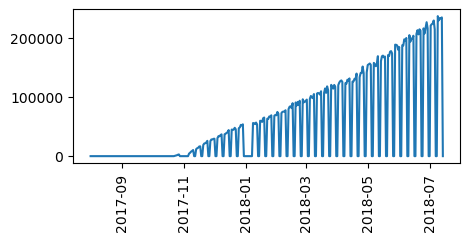

DBSF2686 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


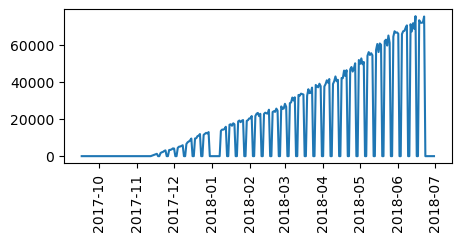

DBSF2689 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


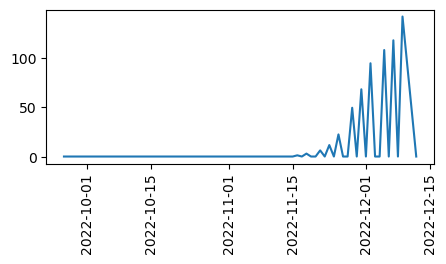

DBSF2708 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


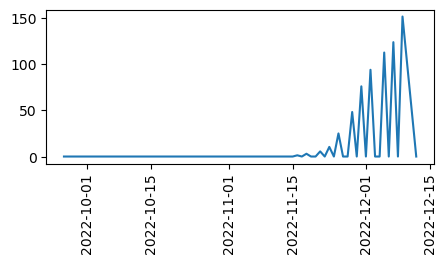

DBSF2752 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


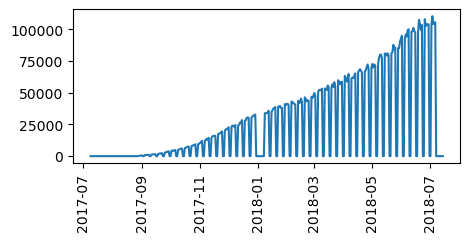

DBSF2803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


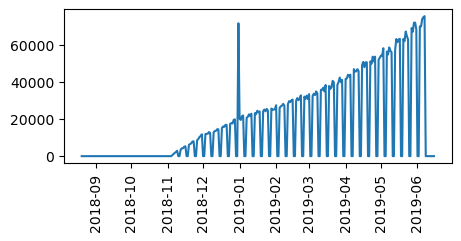

DBSF2809 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


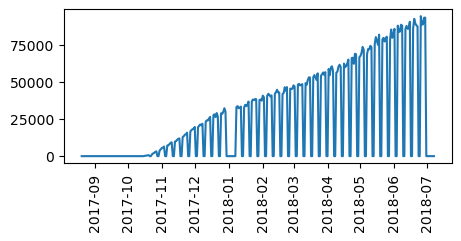

DBSF2822 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


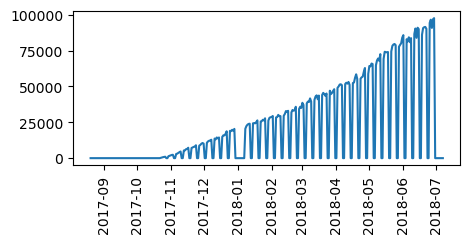

DBSF2823 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


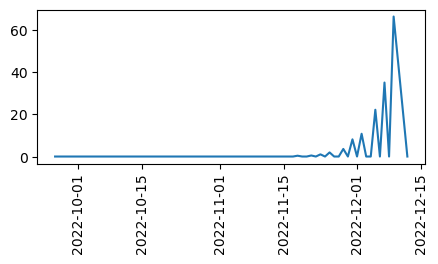

DBSF2828 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


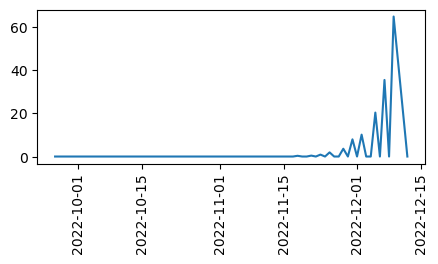

DBSF2832 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


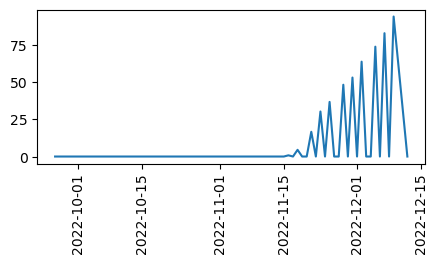

DBSF2846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


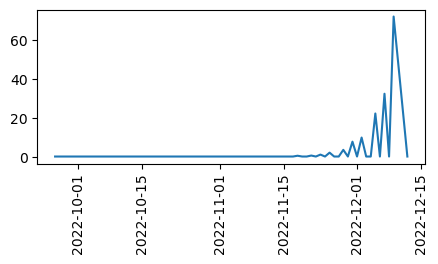

DBSF2888 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


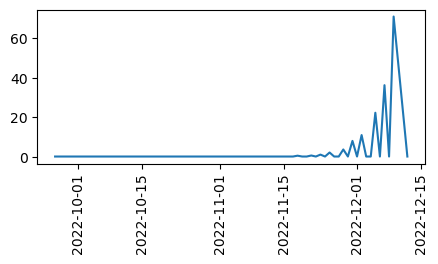

DBSF2911 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


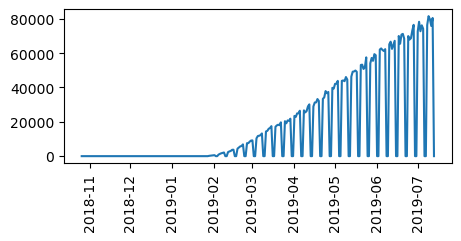

DBSF2918 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


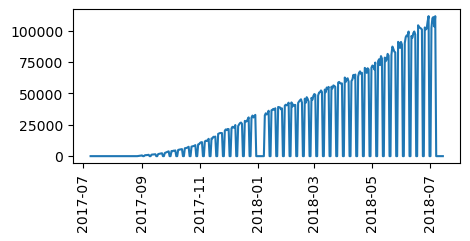

DBSF2927 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


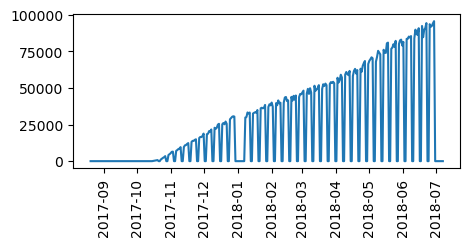

DBSF2989 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


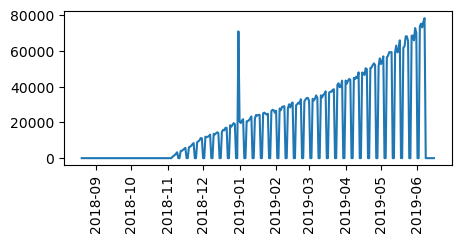

DBSF2992 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


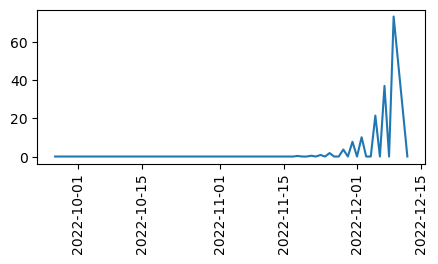

DBSF3001 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


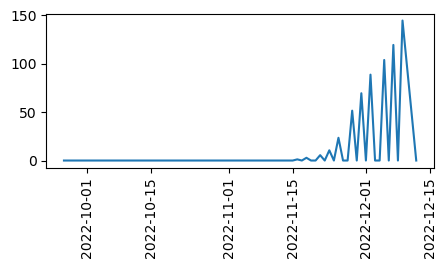

DBSF3010 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


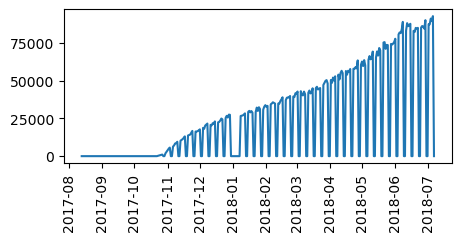

DBSF3034 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


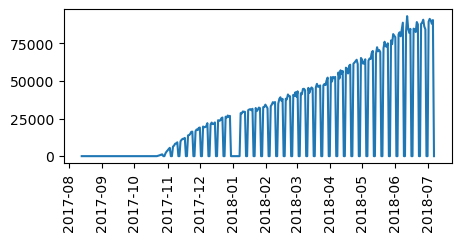

DBSF3067 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


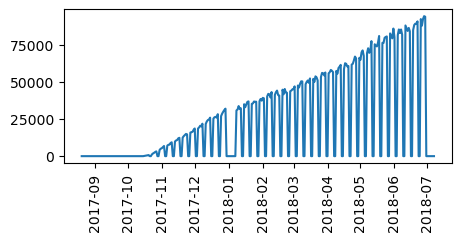

DBSF3068 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


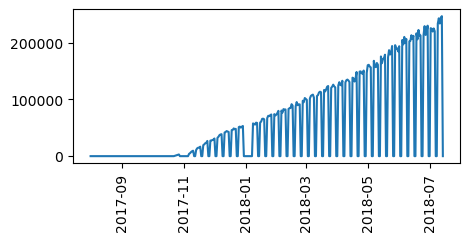

DBSF3075 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


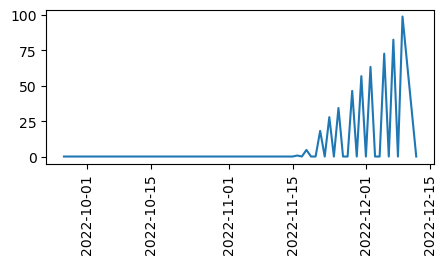

DBSF3076 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


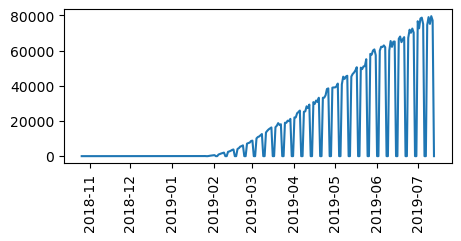

DBSF3118 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


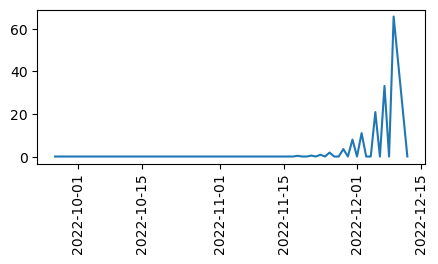

DBSF3132 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


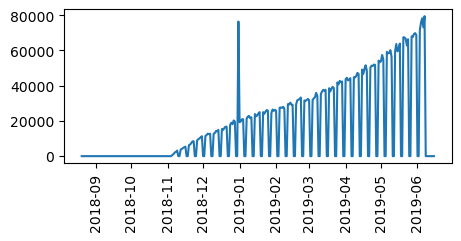

DBSF3135 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


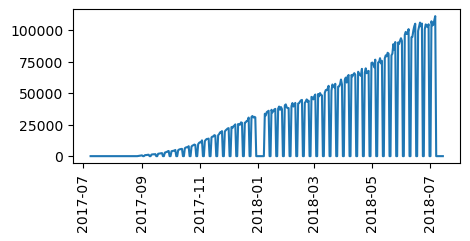

DBSF3165 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


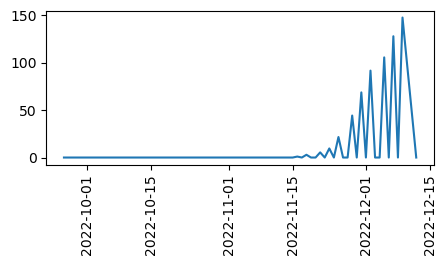

DBSF3172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


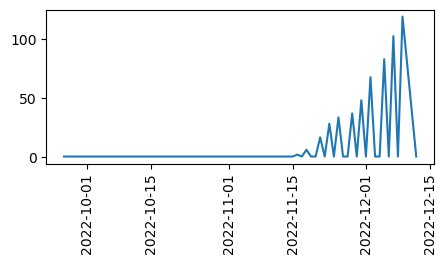

DBSF3199 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


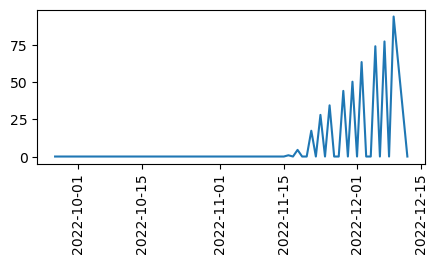

DBSF3205 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


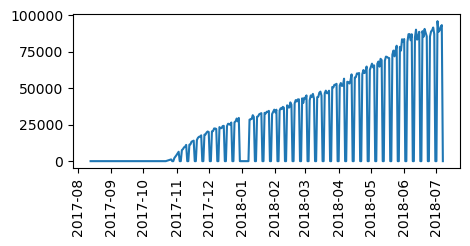

DBSF3214 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


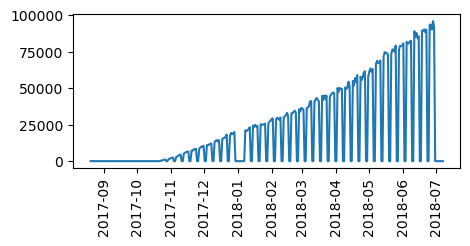

DBSF3228 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


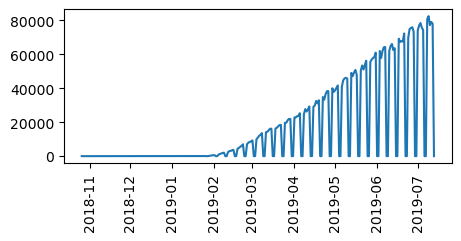

DBSF3311 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


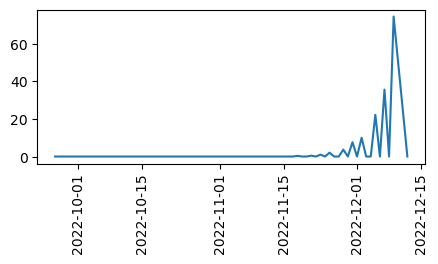

DBSF3367 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


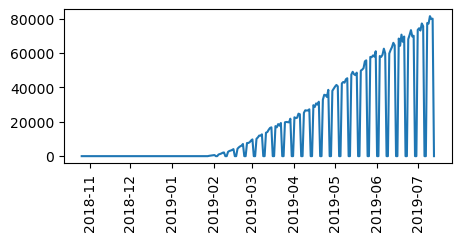

DBSF3372 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


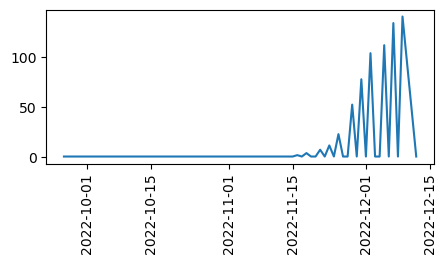

DBSF3383 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


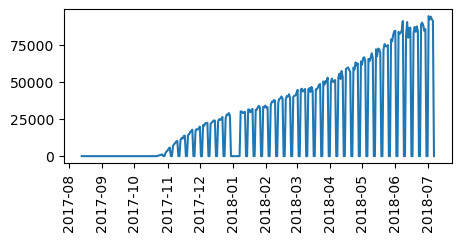

DBSF3399 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


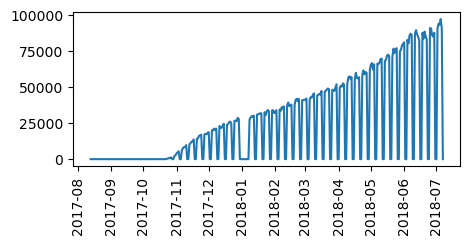

DBSF3425 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


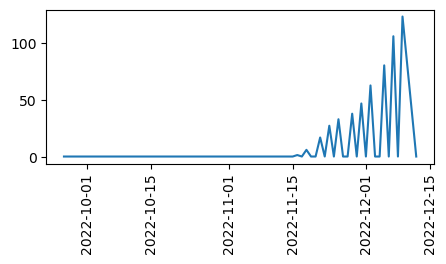

DBSF3426 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


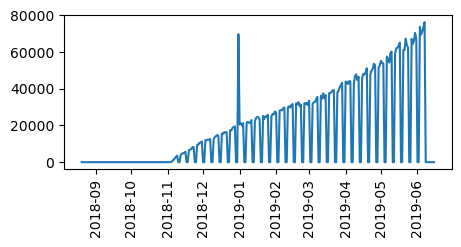

DBSF3467 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


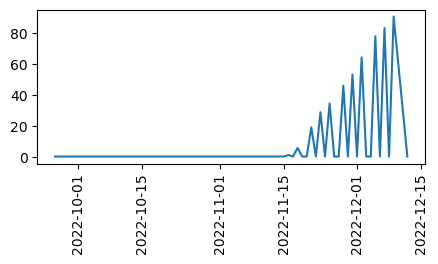

DBSF3470 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


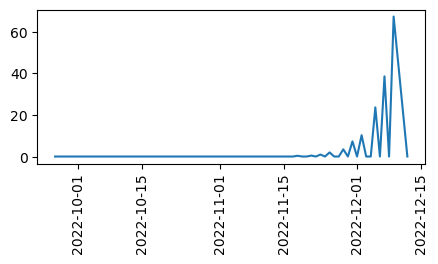

DBSF3490 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


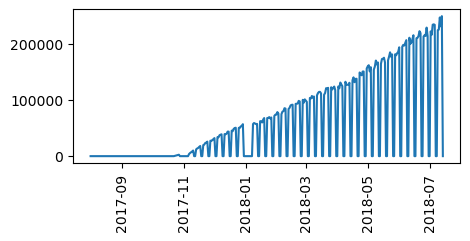

DBSF3527 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


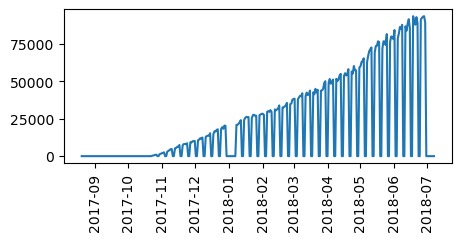

DBSF3532 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


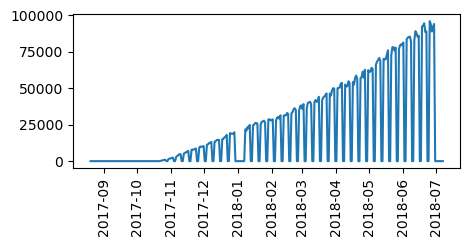

DBSF3546 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


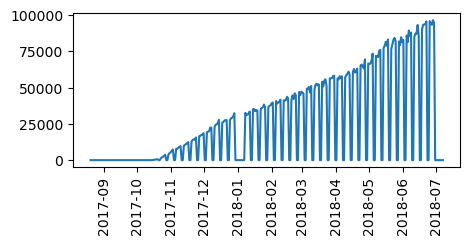

DBSF3567 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


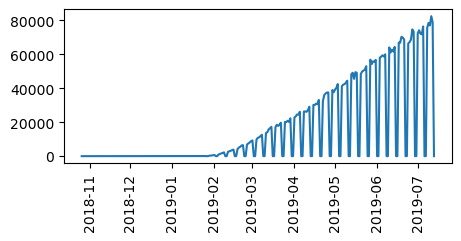

DBSF3583 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


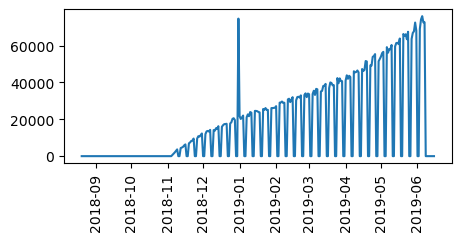

DBSF3593 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


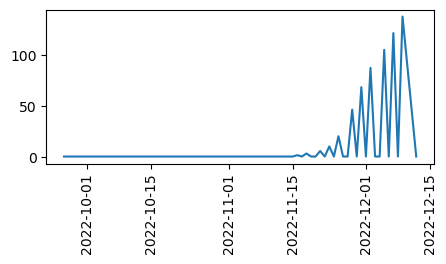

DBSF3597 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


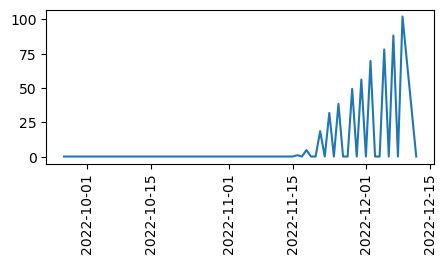

DBSF3655 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


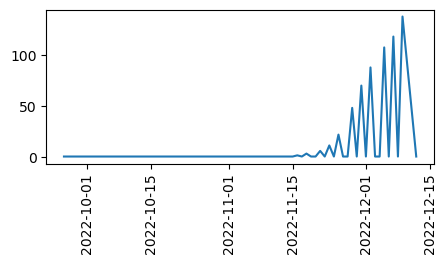

DBSF3661 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


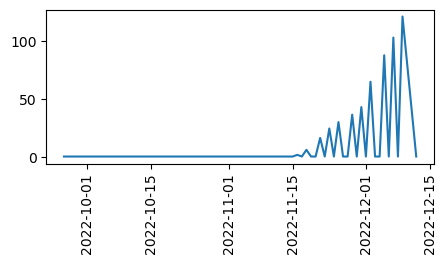

DBSF3705 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


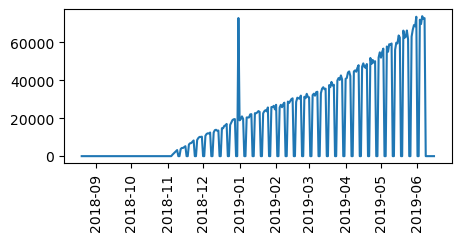

DBSF3755 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


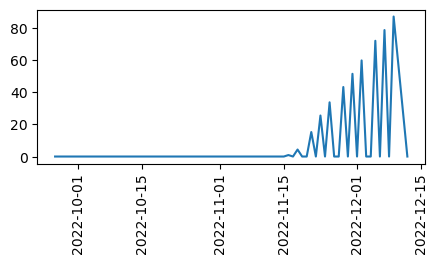

DBSF3803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


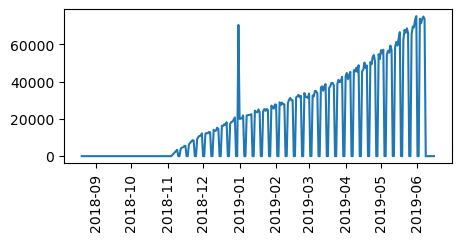

DBSF3841 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


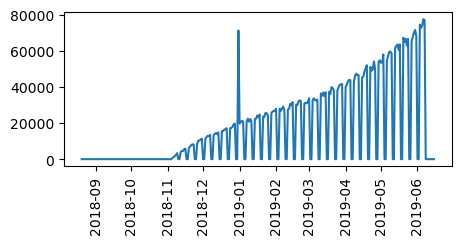

DBSF3850 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


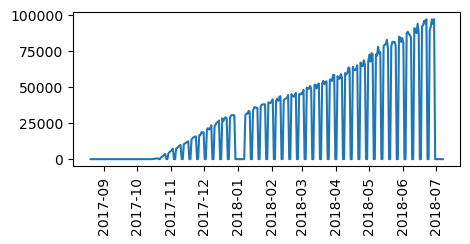

DBSF3891 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


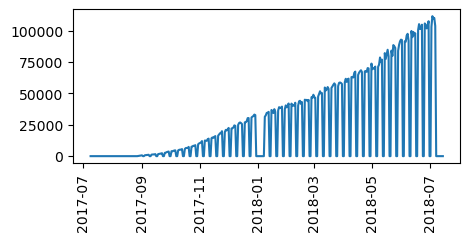

DBSF3906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


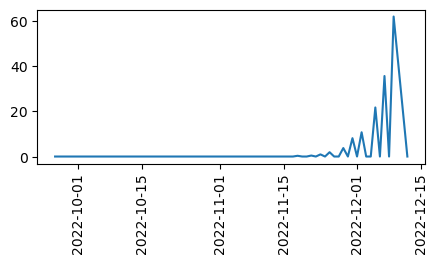

DBSF3911 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


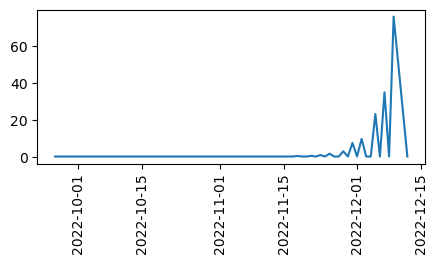

DBSF3912 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


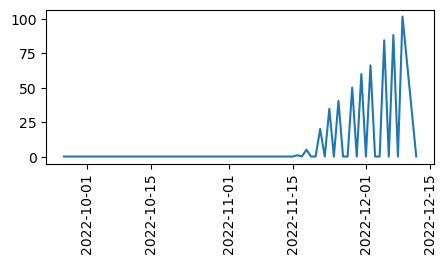

DBSF3924 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


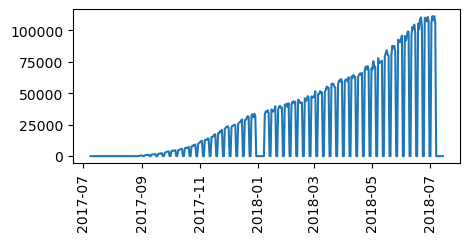

DBSF3932 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


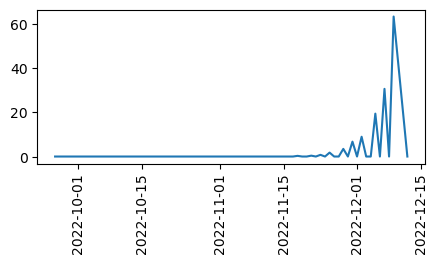

DBSF3990 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


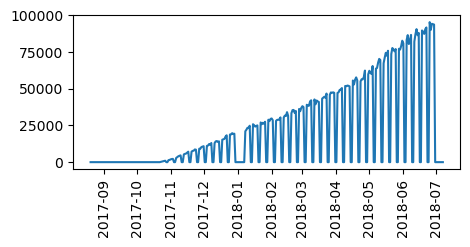

DBSF3998 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


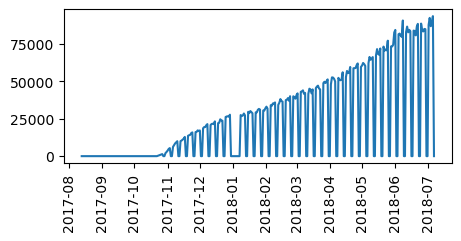

DBSF4004 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


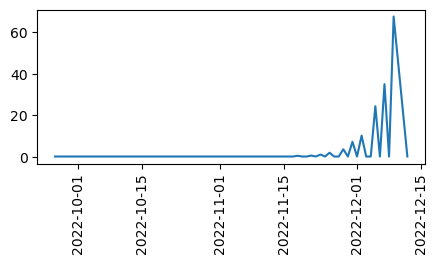

DBSF4013 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


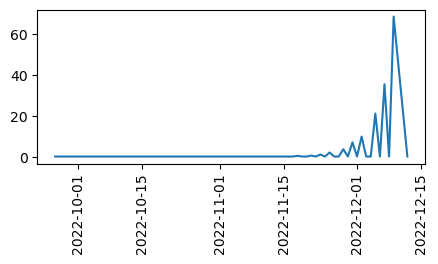

DBSF4049 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


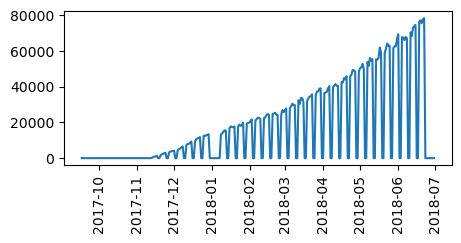

DBSF4083 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


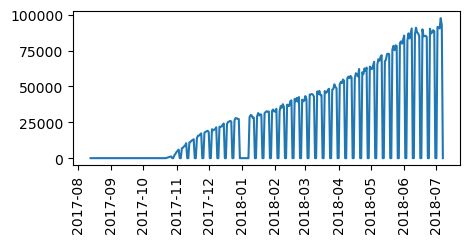

DBSF4101 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


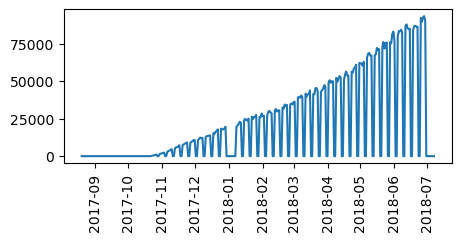

DBSF4111 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


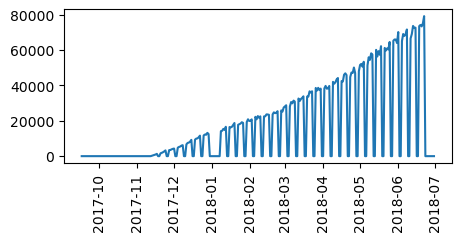

DBSF4121 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


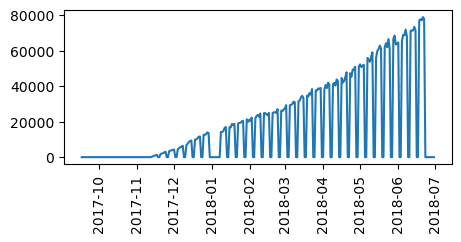

DBSF4146 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


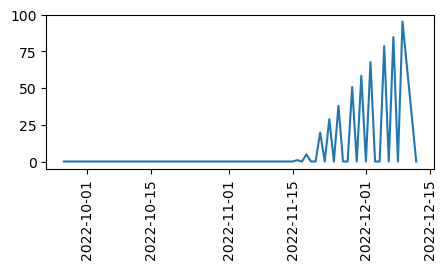

DBSF4154 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


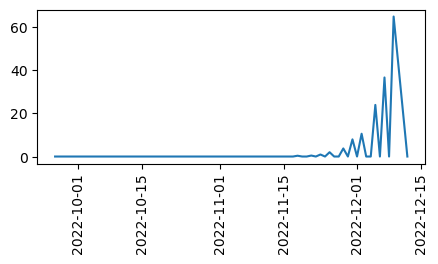

DBSF4163 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


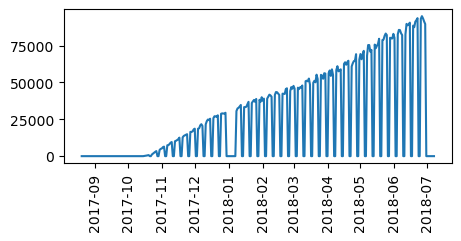

DBSF4181 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


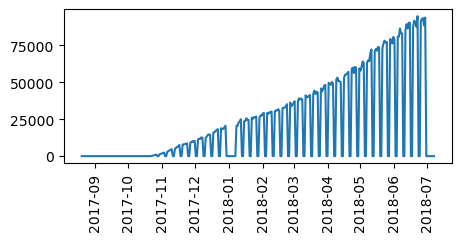

DBSF4197 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


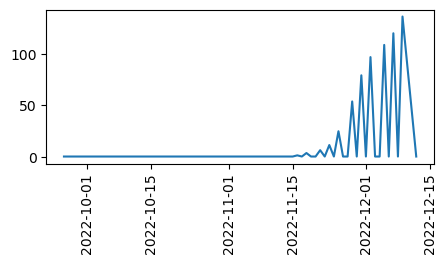

DBSF4202 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


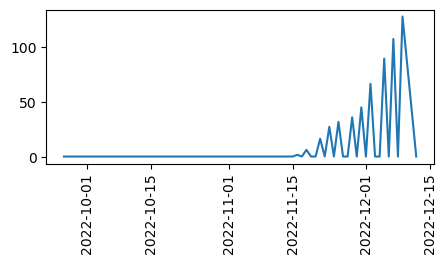

DBSF4212 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


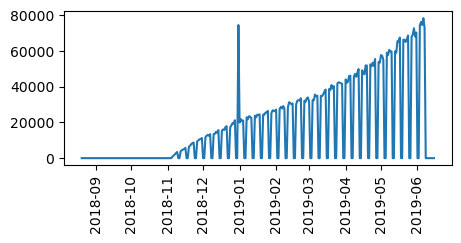

DBSF4250 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


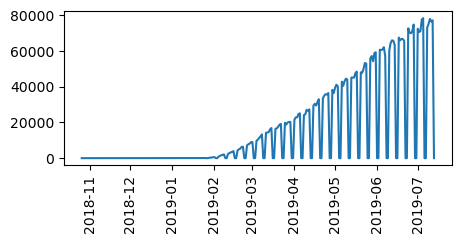

DBSF4283 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


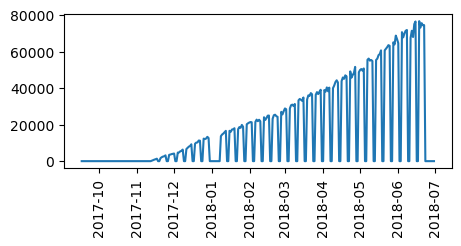

DBSF4310 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


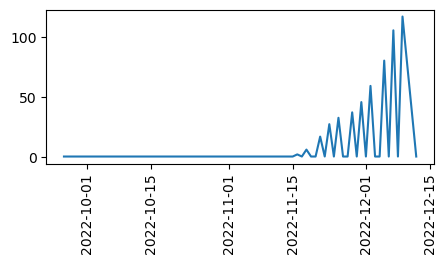

DBSF4329 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


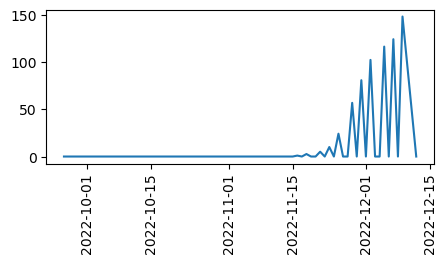

DBSF4371 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


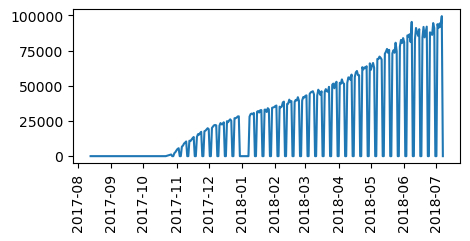

DBSF4401 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


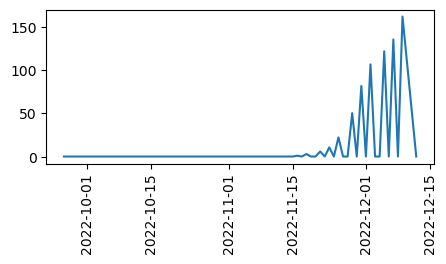

DBSF4442 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


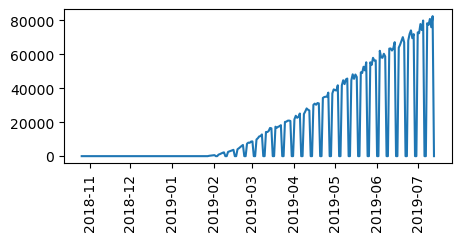

DBSF4466 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


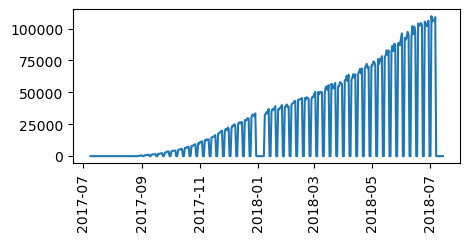

DBSF4554 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


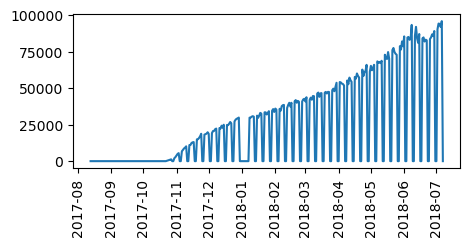

DBSF4640 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


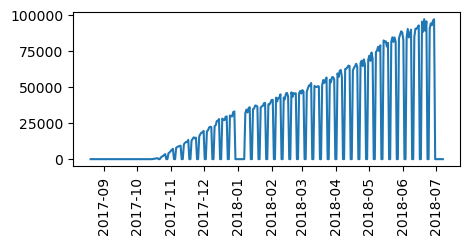

DBSF4646 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


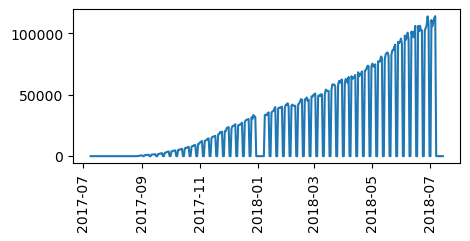

DBSF4659 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


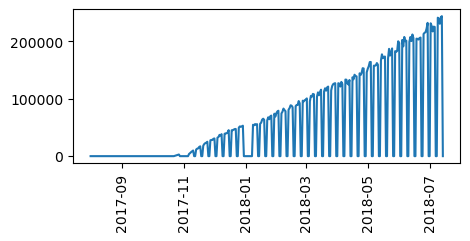

DBSF4678 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


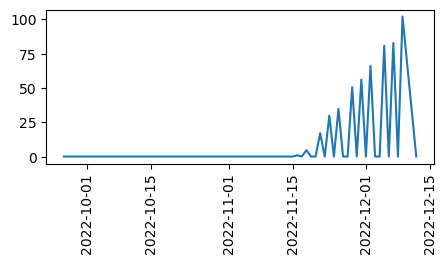

DBSF4713 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


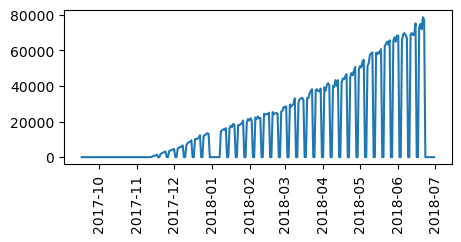

DBSF4716 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


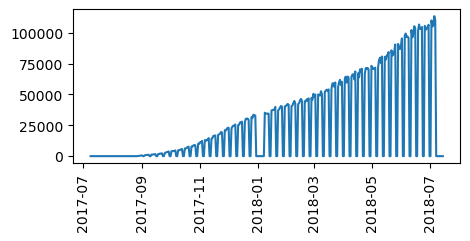

DBSF4720 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


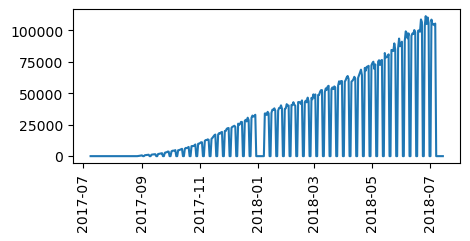

DBSF4752 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


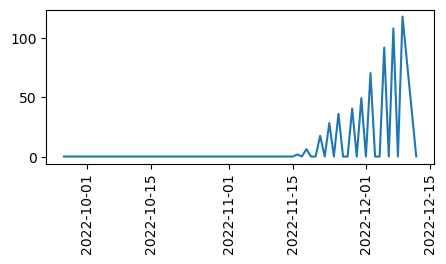

DBSF4800 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


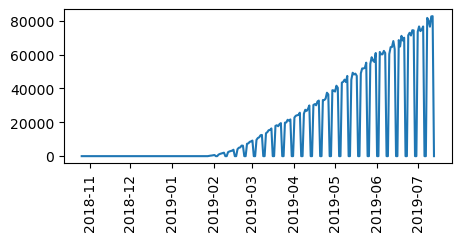

DBSF4812 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


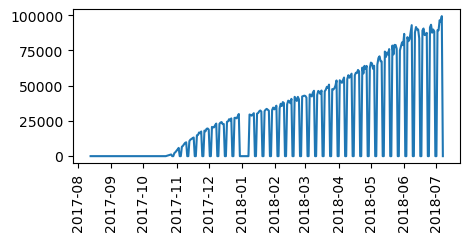

DBSF4814 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


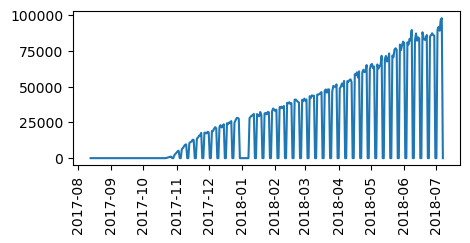

DBSF4817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


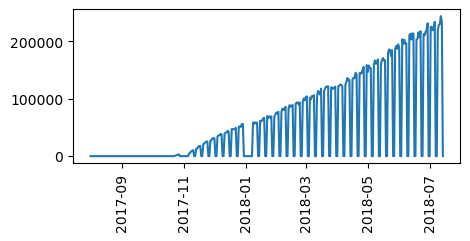

DBSF4846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


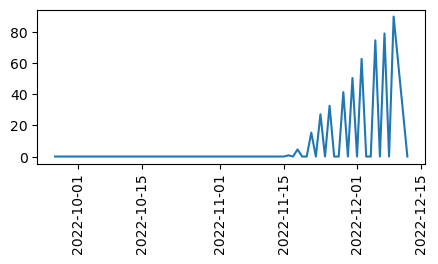

DBSF4885 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


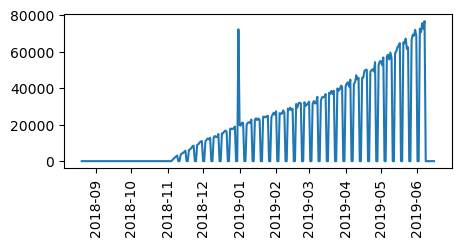

DBSF4907 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


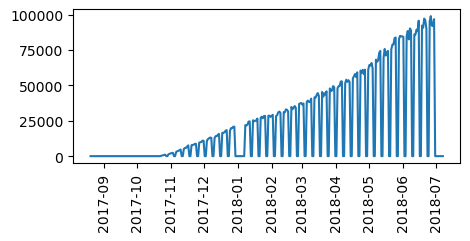

DBSF4964 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


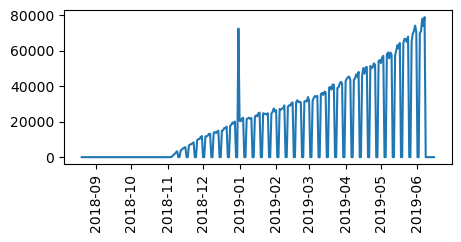

DBSF4972 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


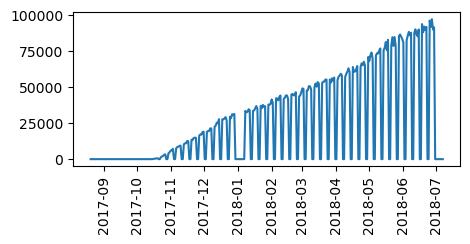

DBSF5022 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


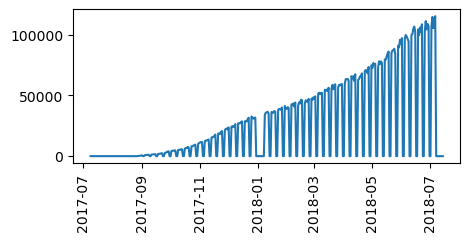

DBSF5056 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


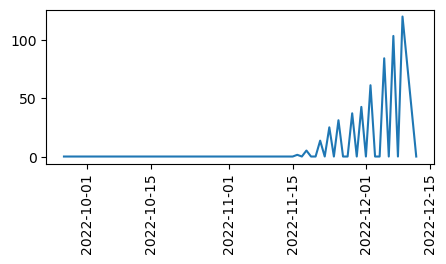

DBSF5095 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


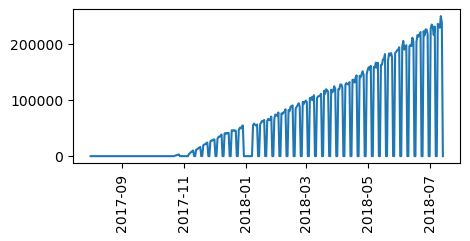

DBSF5121 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


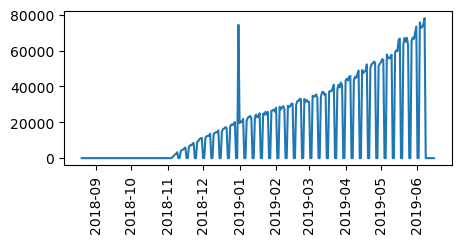

DBSF5170 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


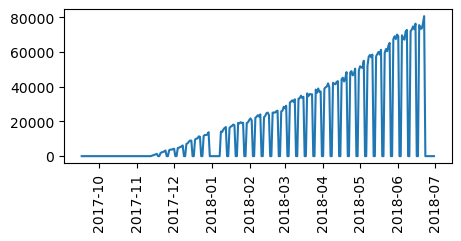

DBSF5193 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


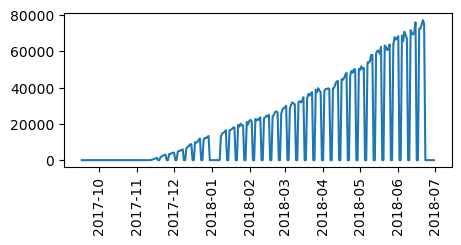

DBSF5216 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


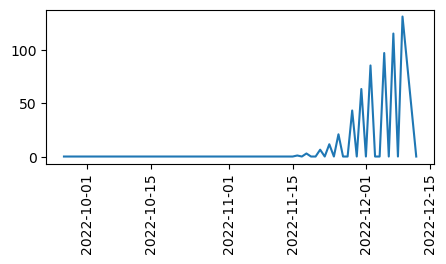

DBSF5227 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


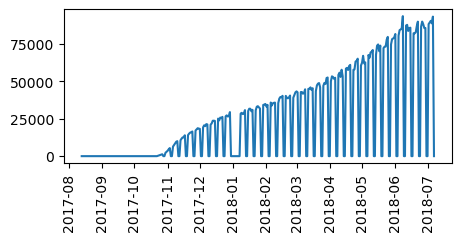

DBSF5240 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


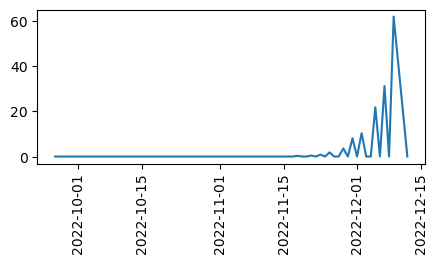

DBSF5243 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


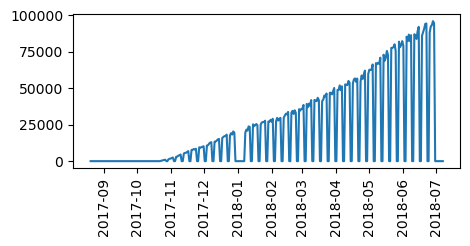

DBSF5271 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


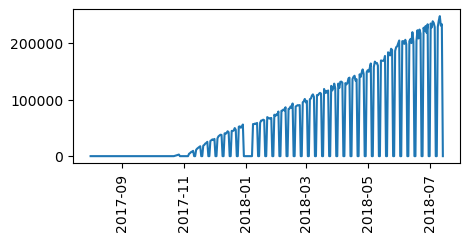

DBSF5299 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


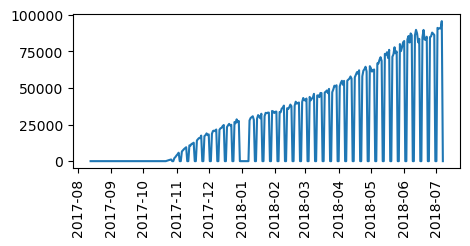

DBSF5303 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


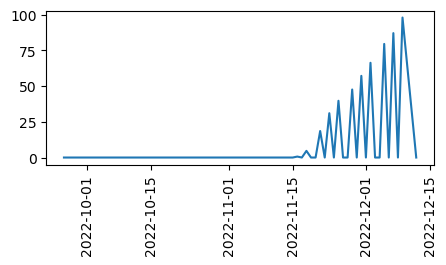

DBSF5344 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


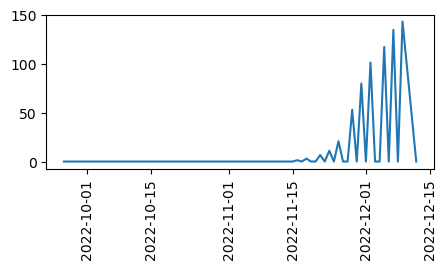

DBSF5351 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


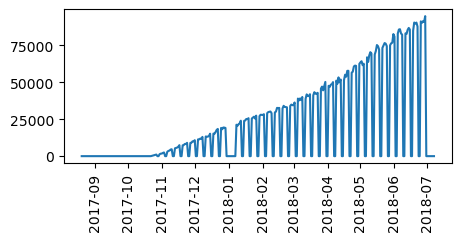

DBSF5403 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


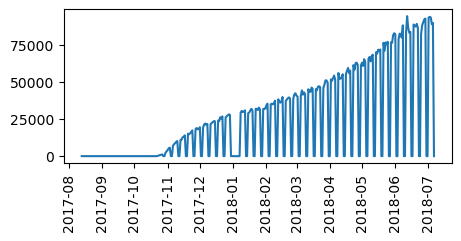

DBSF5429 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


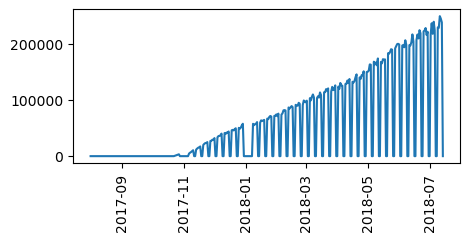

DBSF5452 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


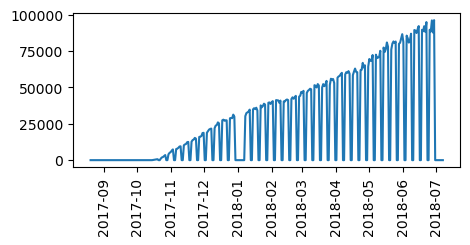

DBSF5534 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


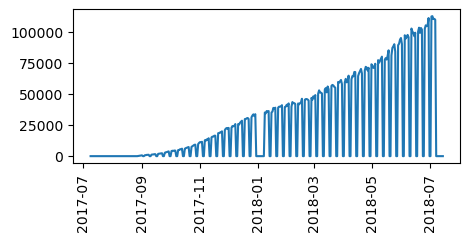

DBSF5549 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


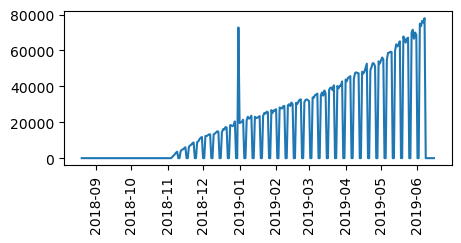

DBSF5566 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


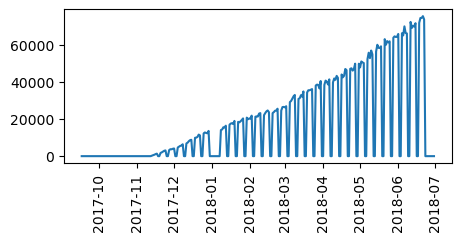

DBSF5575 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


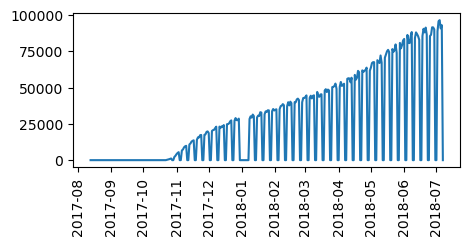

DBSF5587 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


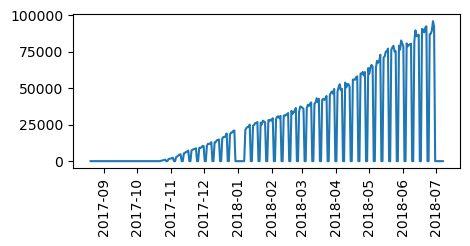

DBSF5607 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


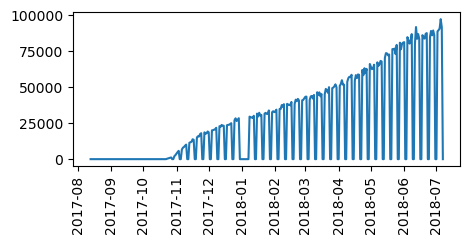

DBSF5628 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


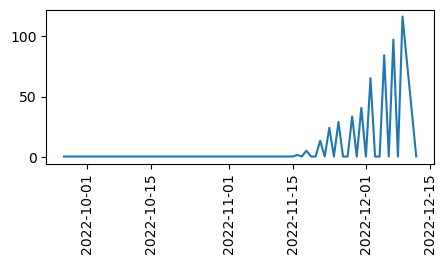

DBSF5644 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


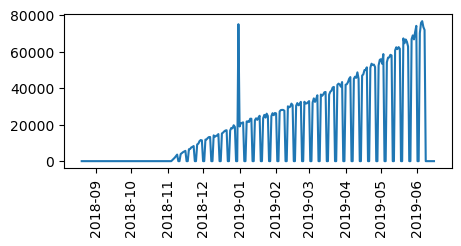

DBSF5661 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


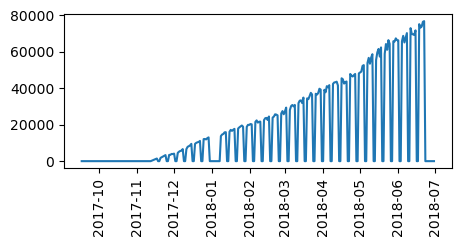

DBSF5686 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


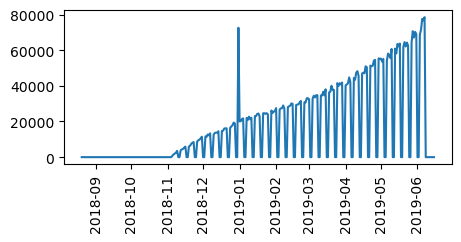

DBSF5705 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


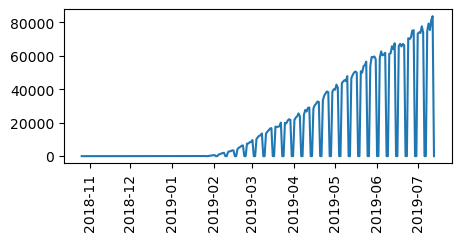

DBSF5734 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


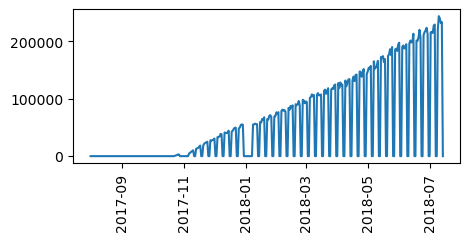

DBSF5764 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


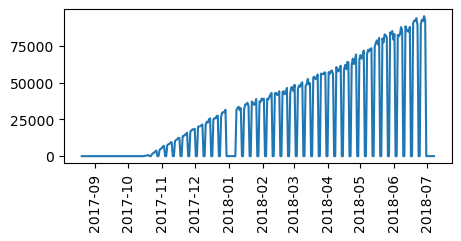

DBSF5769 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


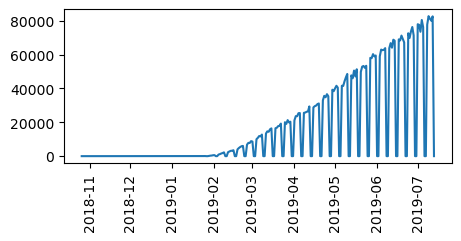

DBSF5772 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


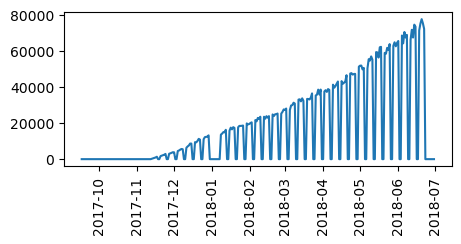

DBSF5823 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


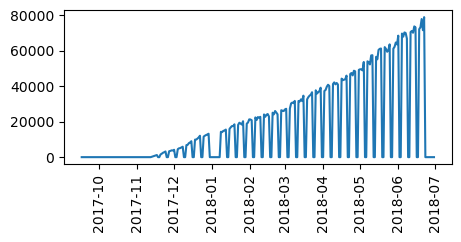

DBSF5833 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


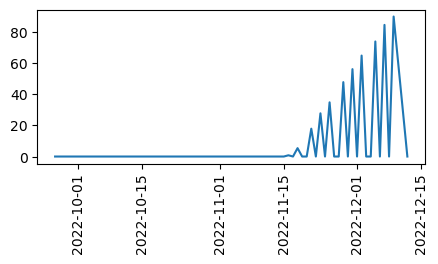

DBSF5847 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


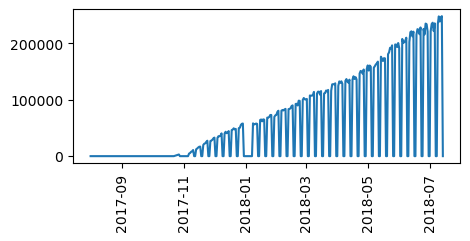

DBSF5848 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


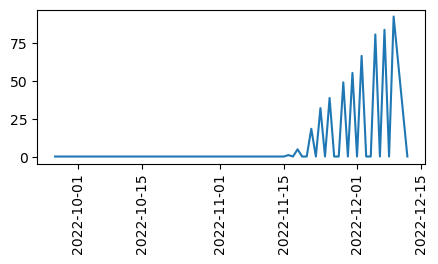

DBSF5875 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


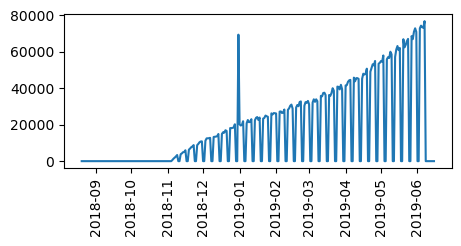

DBSF5973 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


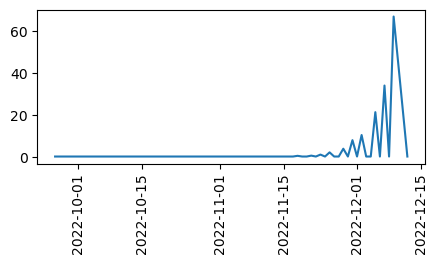

DBSF6030 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


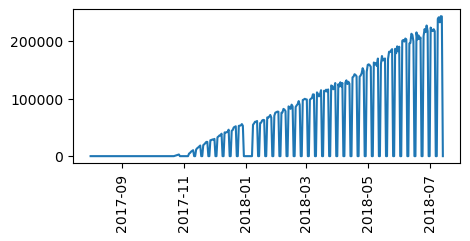

DBSF6039 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


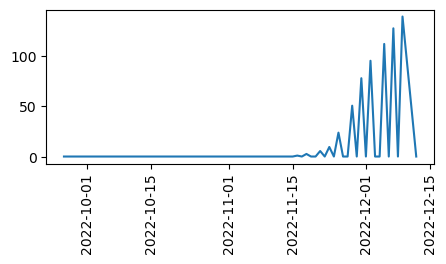

DBSF6042 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


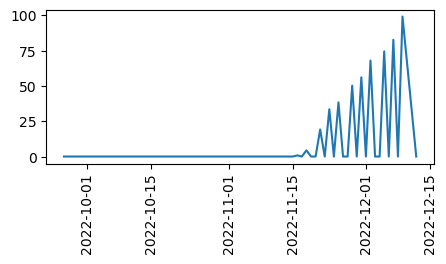

DBSF6053 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


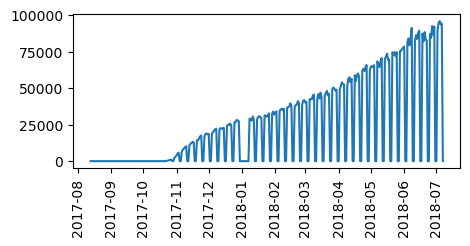

DBSF6057 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


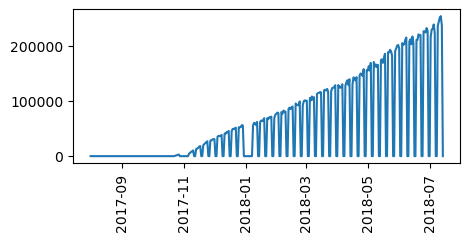

DBSF6059 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


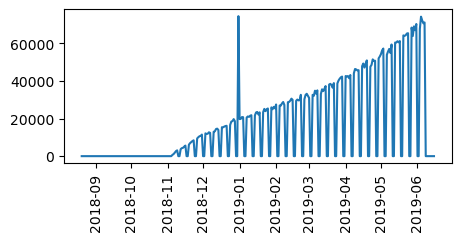

DBSF6134 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


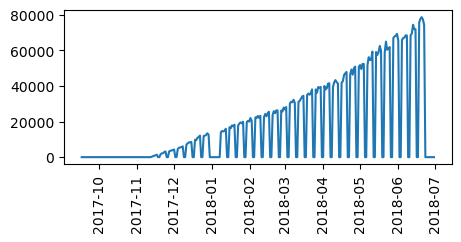

DBSF6144 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


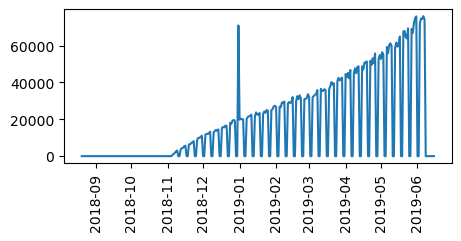

DBSF6147 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


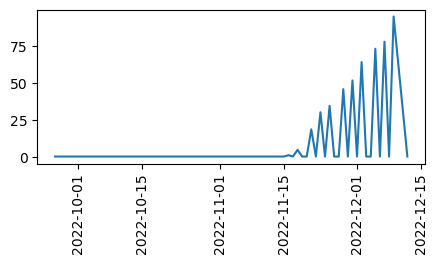

DBSF6163 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


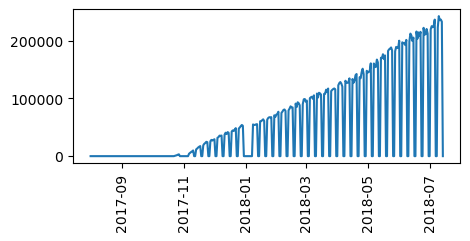

DBSF6174 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


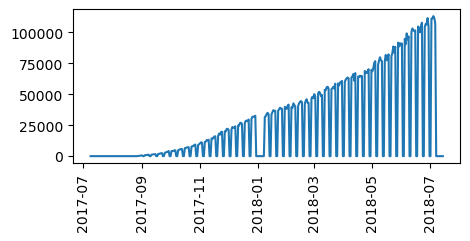

DBSF6206 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


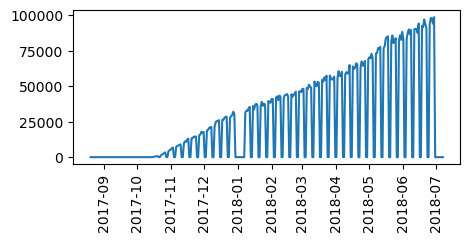

DBSF6211 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


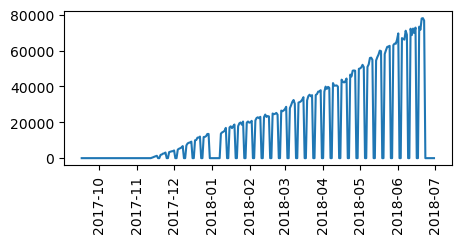

DBSF6218 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


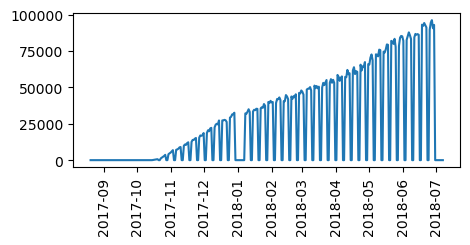

DBSF6295 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


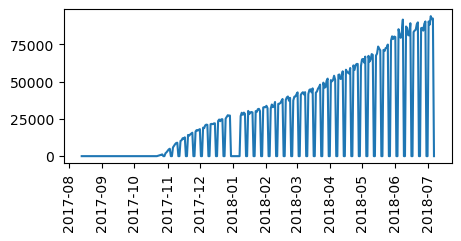

DBSF6298 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


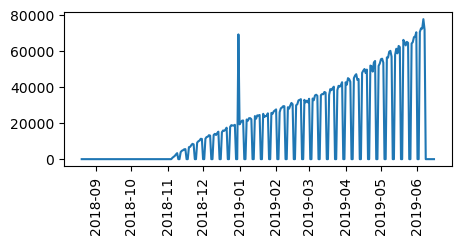

DBSF6305 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


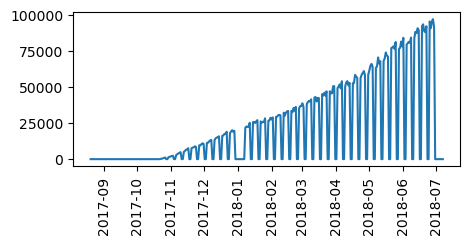

DBSF6318 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


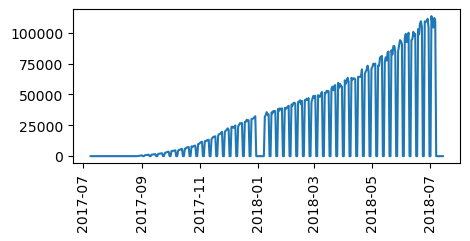

DBSF6441 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


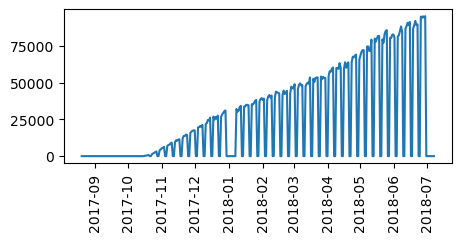

DBSF6473 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


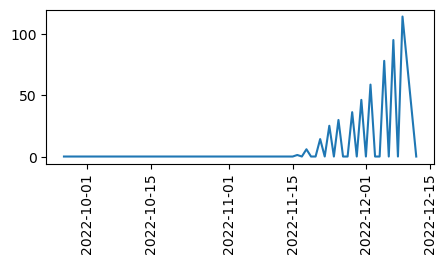

DBSF6497 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


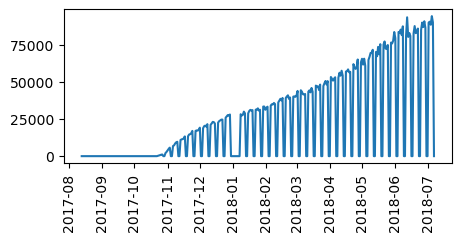

DBSF6502 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


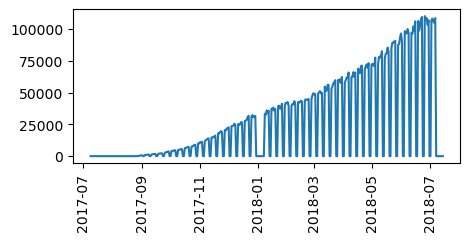

DBSF6503 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


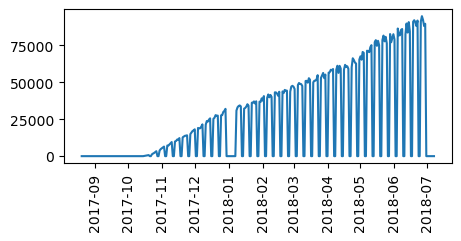

DBSF6522 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


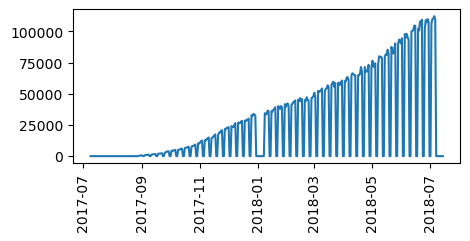

DBSF6576 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


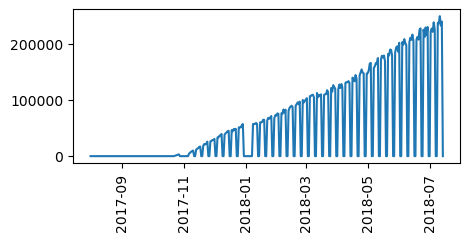

DBSF6618 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


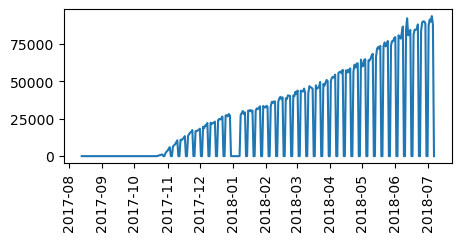

DBSF6619 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


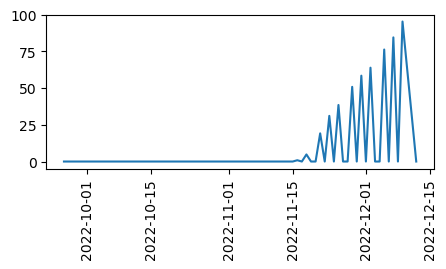

DBSF6641 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


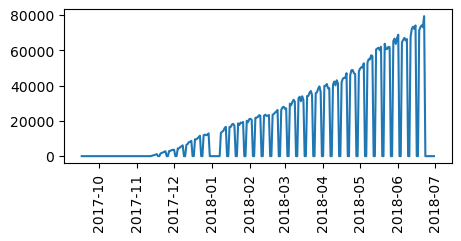

DBSF6690 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


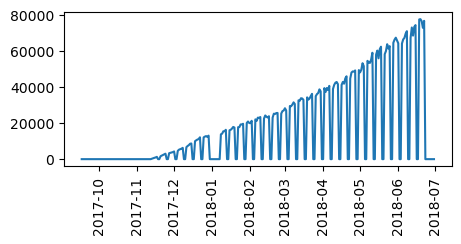

DBSF6699 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


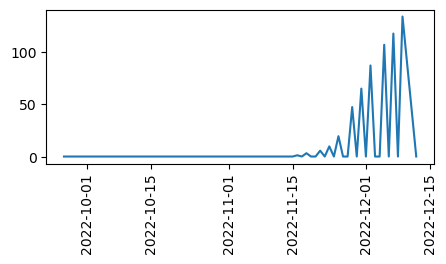

DBSF6771 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


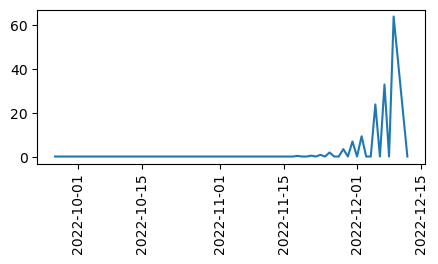

DBSF6806 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


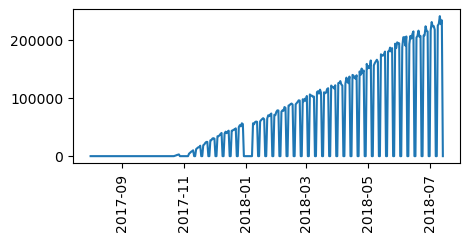

DBSF6817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


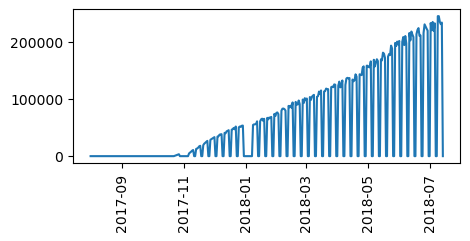

DBSF6833 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


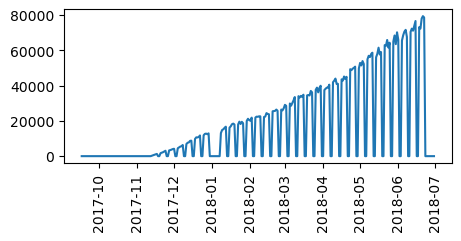

DBSF6892 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


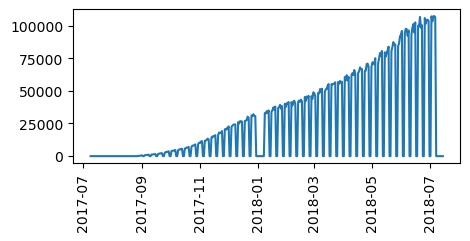

DBSF6914 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


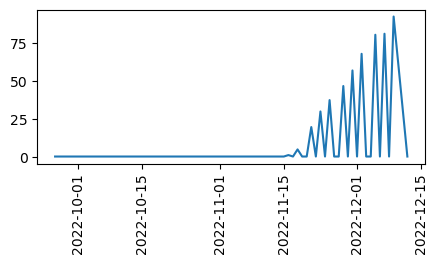

DBSF6949 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


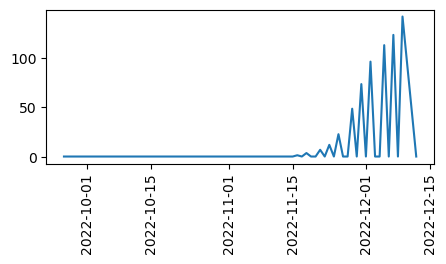

DBSF6979 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


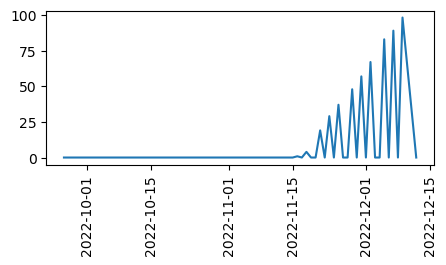

DBSF6990 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


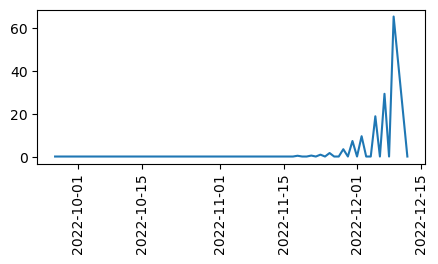

DBSF7114 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


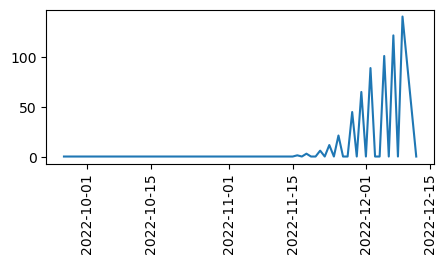

DBSF7130 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


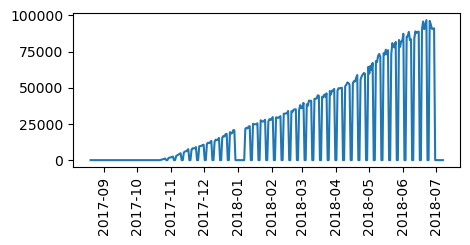

DBSF7151 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


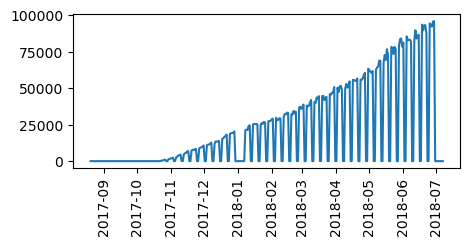

DBSF7185 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


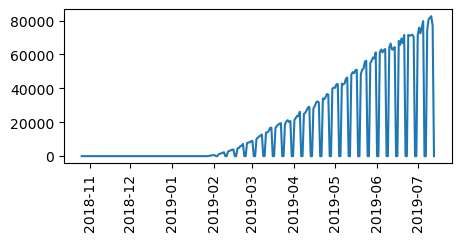

DBSF7186 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


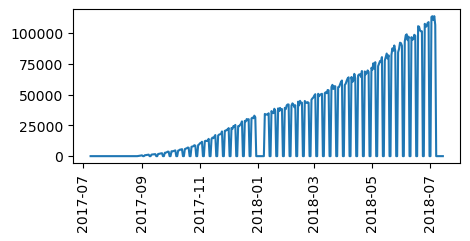

DBSF7195 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


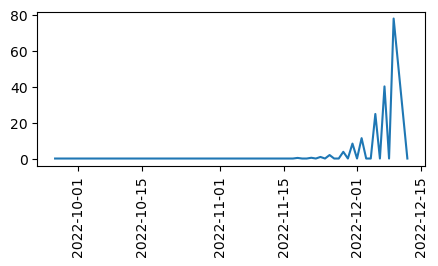

DBSF7198 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


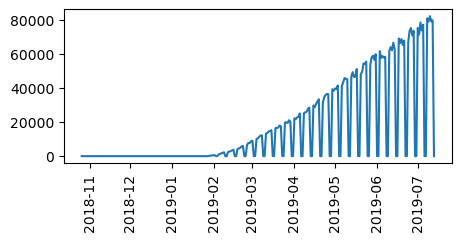

DBSF7221 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


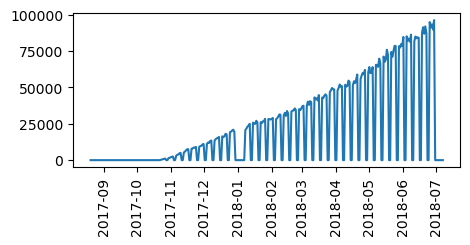

DBSF7294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


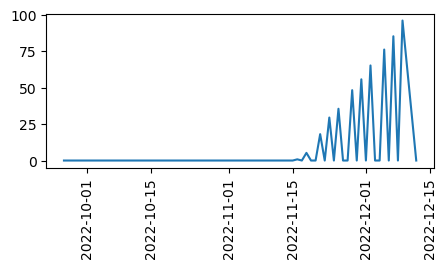

DBSF7339 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


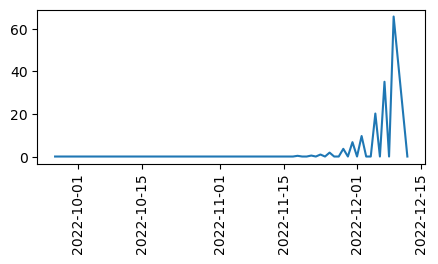

DBSF7419 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


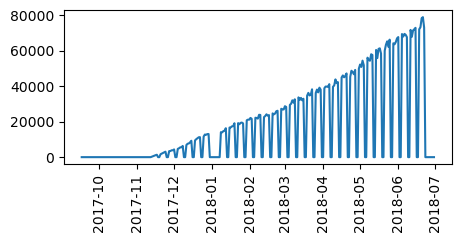

DBSF7476 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


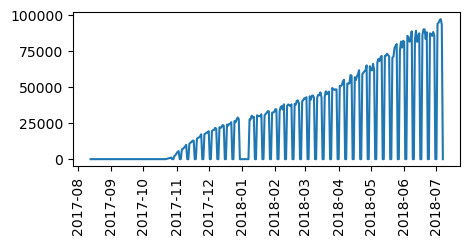

DBSF7477 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


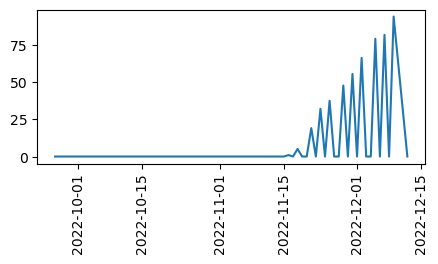

DBSF7548 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


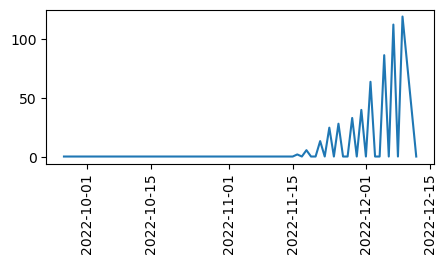

DBSF7633 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


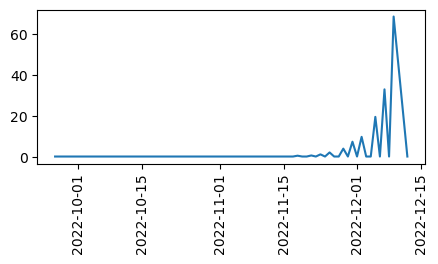

DBSF7641 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


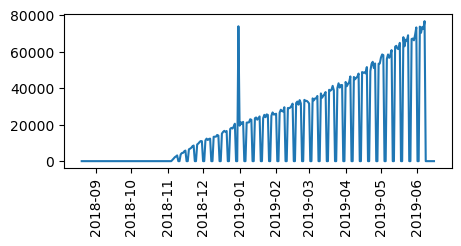

DBSF7654 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


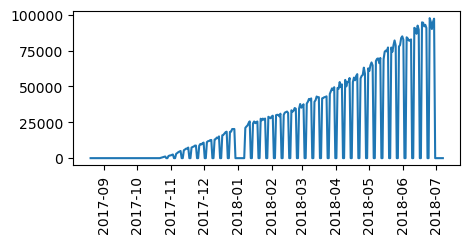

DBSF7666 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


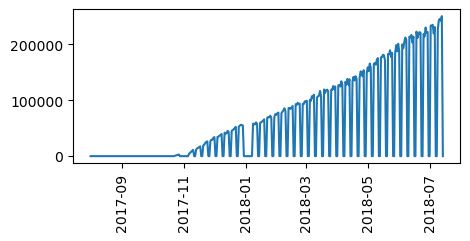

DBSF7673 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


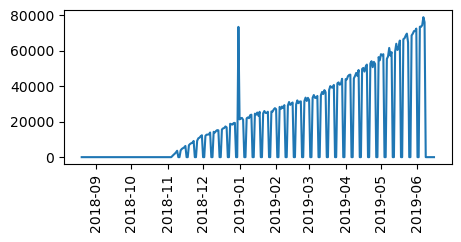

DBSF7679 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


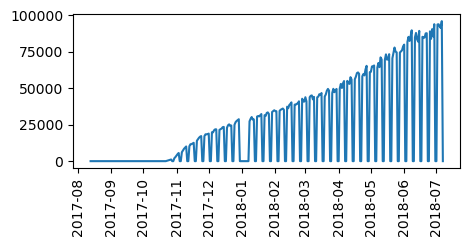

DBSF7692 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


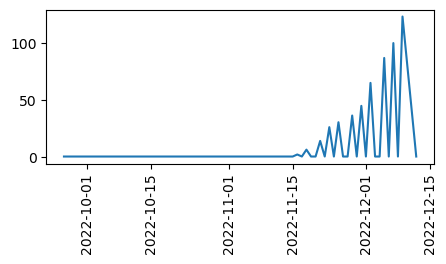

DBSF7705 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


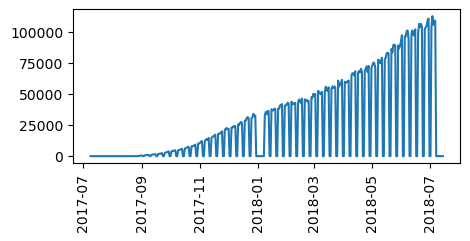

DBSF7717 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


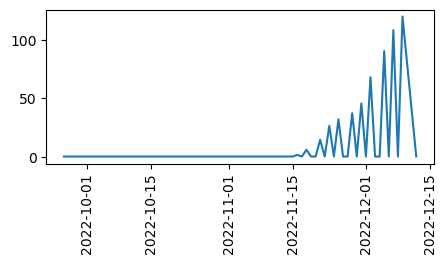

DBSF7722 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


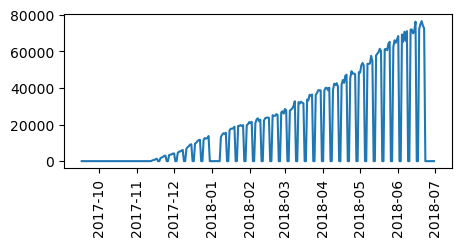

DBSF7740 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


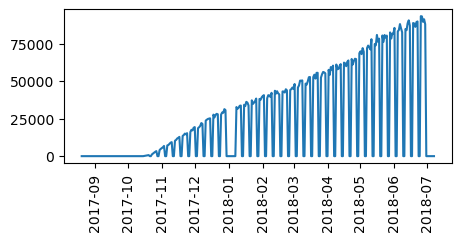

DBSF7828 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


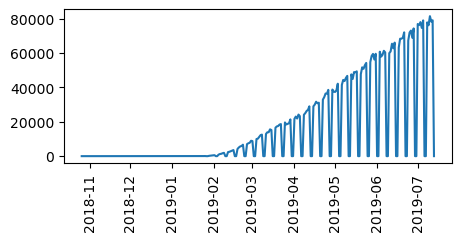

DBSF7863 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


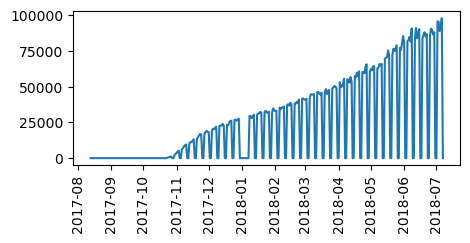

DBSF7882 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


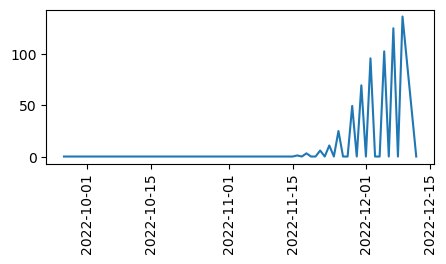

DBSF7897 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


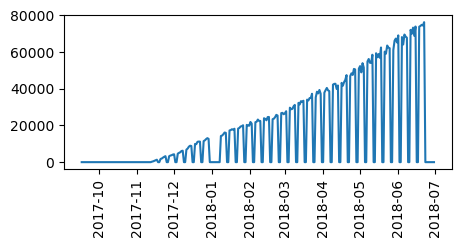

DBSF7898 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


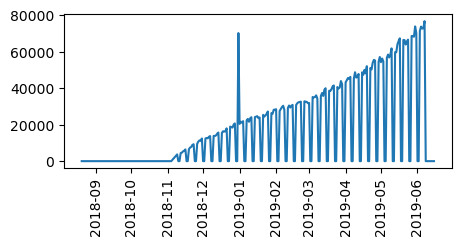

DBSF8040 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


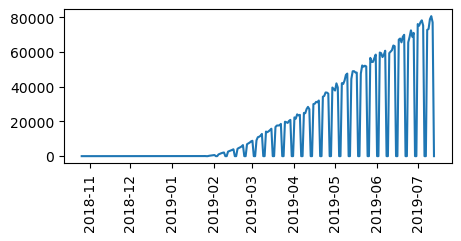

DBSF8047 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


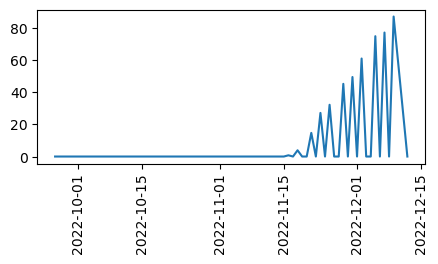

DBSF8065 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


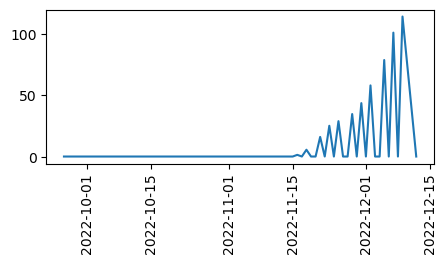

DBSF8072 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


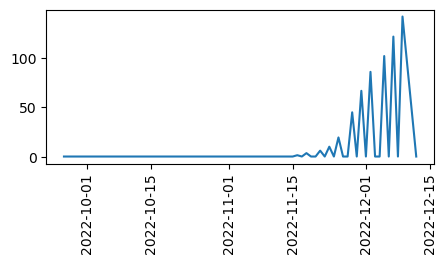

DBSF8083 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


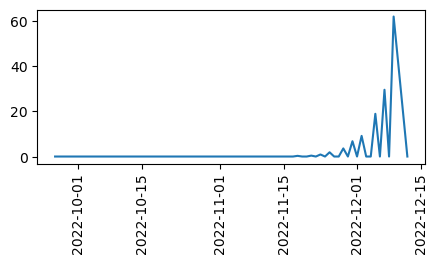

DBSF8124 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


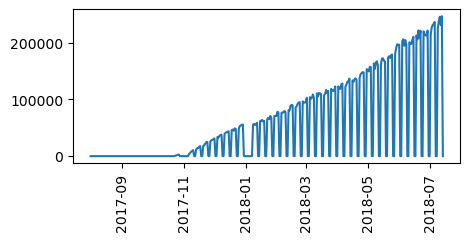

DBSF8175 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


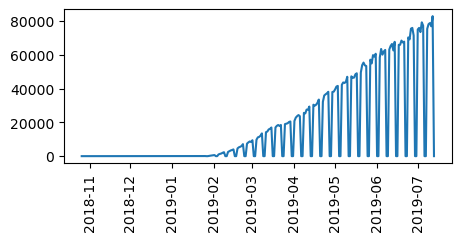

DBSF8195 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


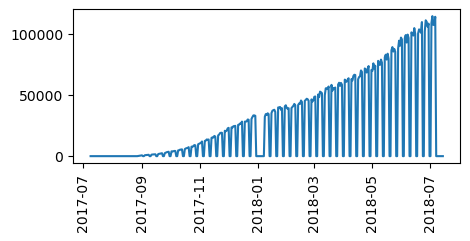

DBSF8205 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


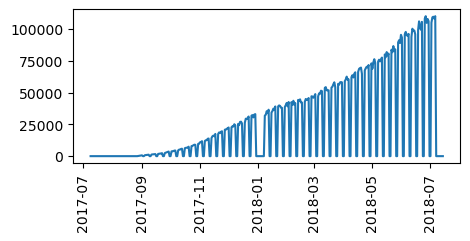

DBSF8221 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


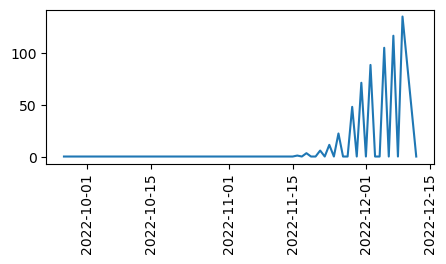

DBSF8230 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


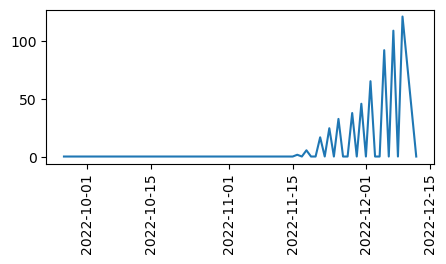

DBSF8242 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


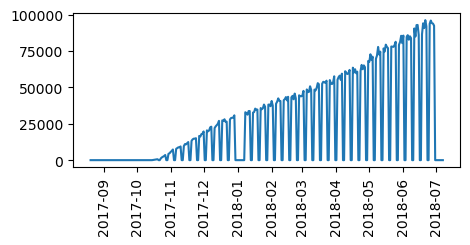

DBSF8258 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


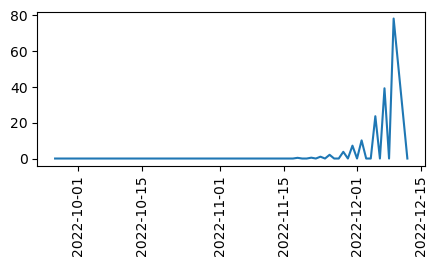

DBSF8285 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


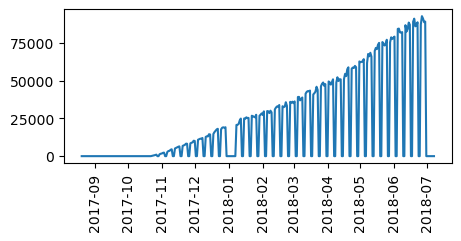

DBSF8293 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


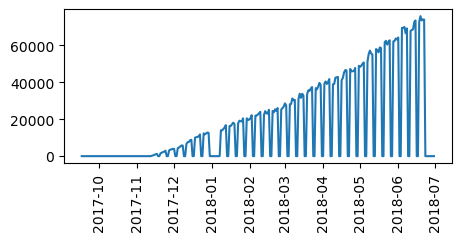

DBSF8318 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


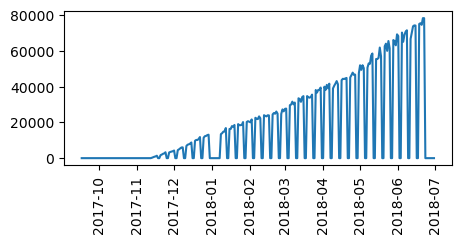

DBSF8381 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


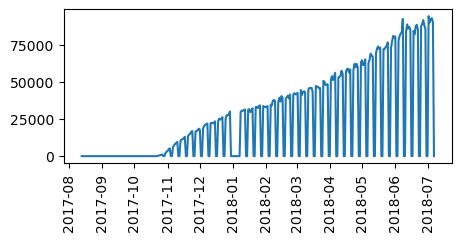

DBSF8383 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


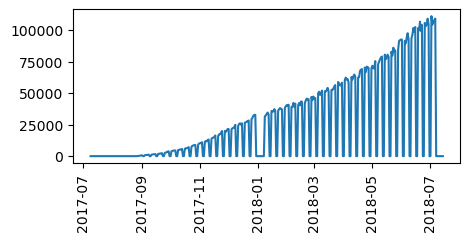

DBSF8405 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


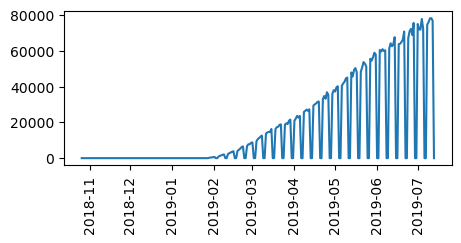

DBSF8411 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


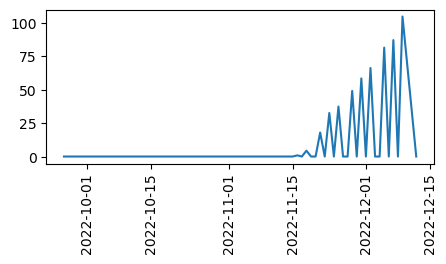

DBSF8440 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


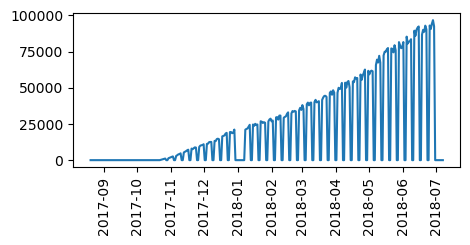

DBSF8457 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


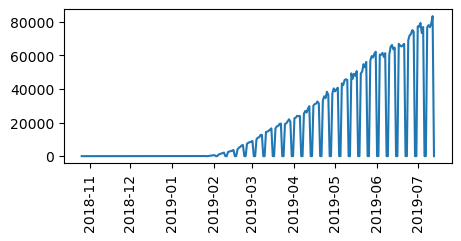

DBSF8462 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


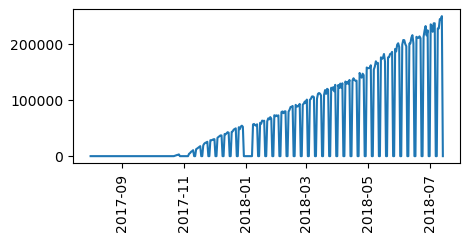

DBSF8492 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


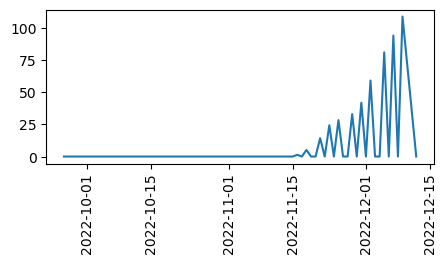

DBSF8512 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


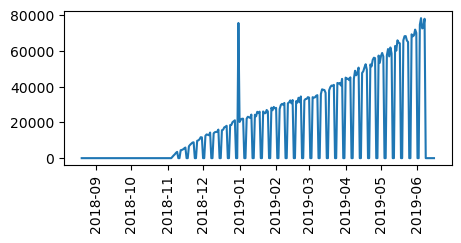

DBSF8533 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


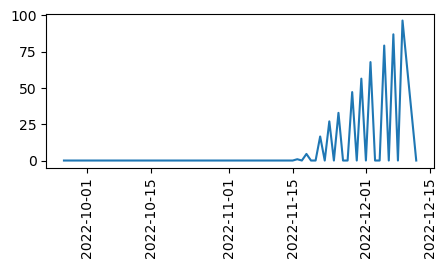

DBSF8545 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


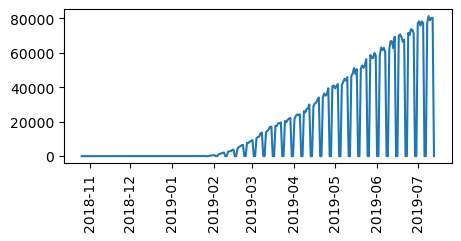

DBSF8557 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


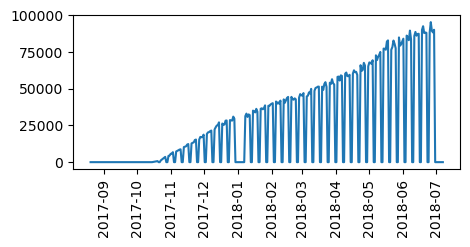

DBSF8573 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


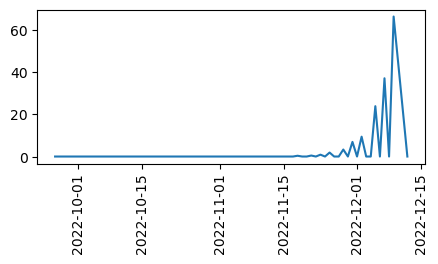

DBSF8588 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


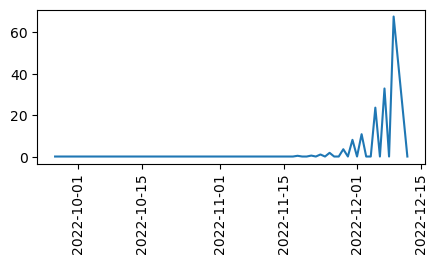

DBSF8590 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


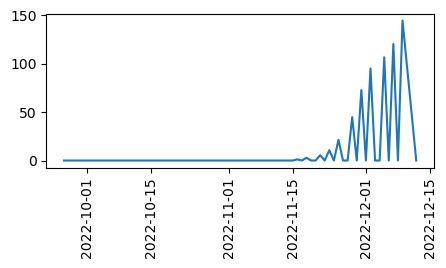

DBSF8665 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


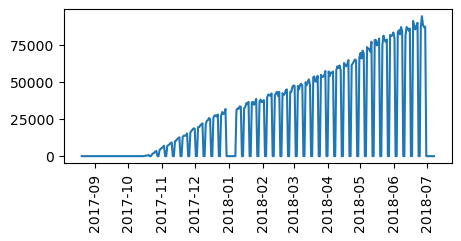

DBSF8670 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


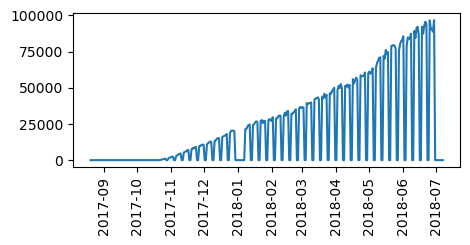

DBSF8704 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


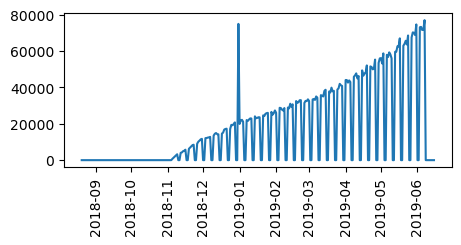

DBSF8721 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


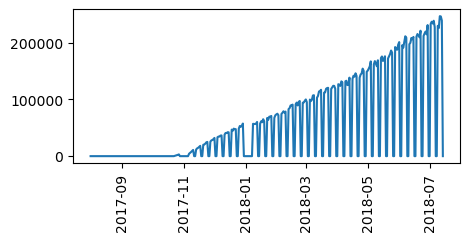

DBSF8764 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


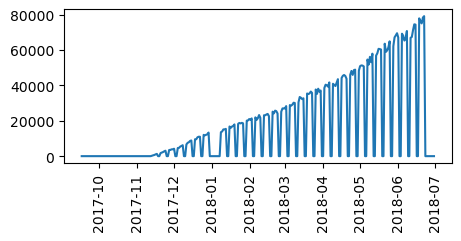

DBSF8793 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


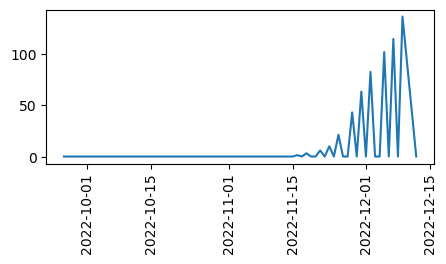

DBSF8830 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


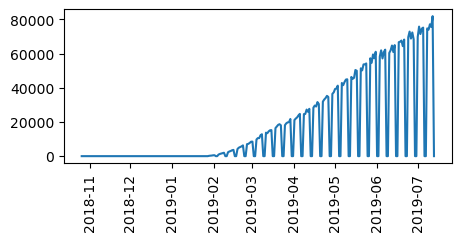

DBSF8906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


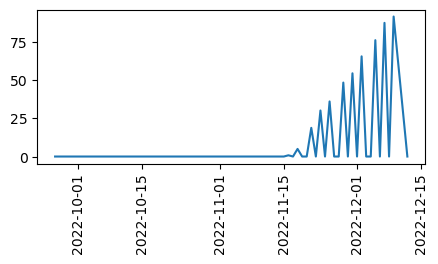

DBSF8924 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


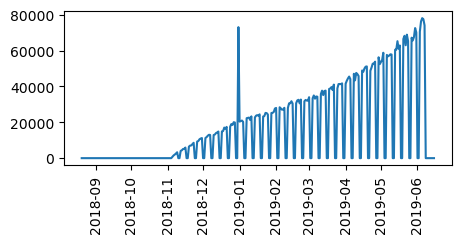

DBSF8958 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


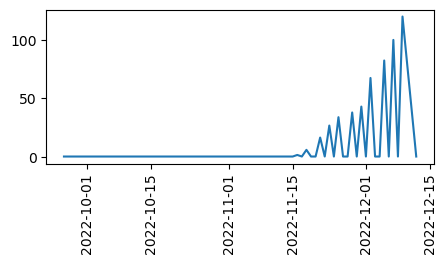

DBSF8966 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


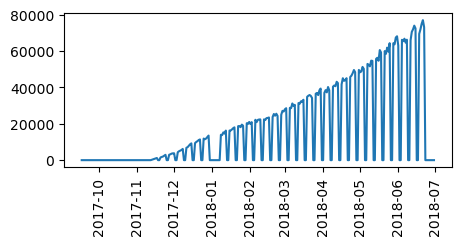

DBSF9076 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


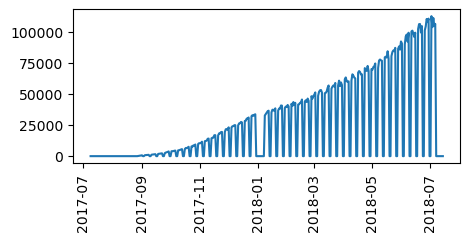

DBSF9088 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


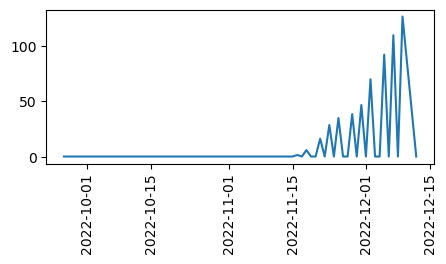

DBSF9161 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


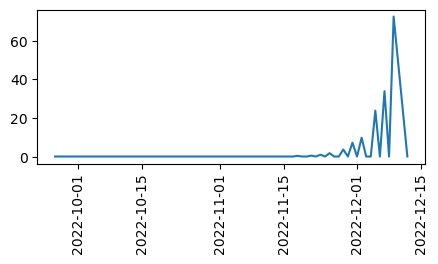

DBSF9172 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


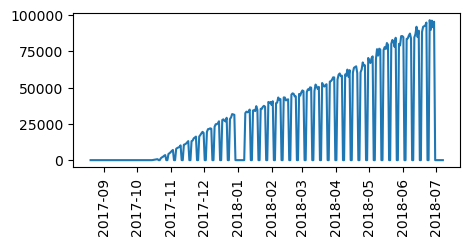

DBSF9184 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


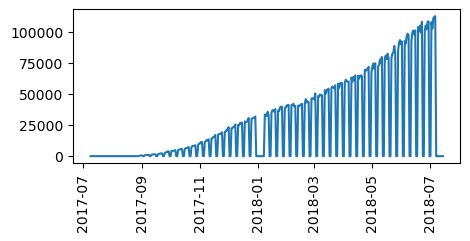

DBSF9221 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


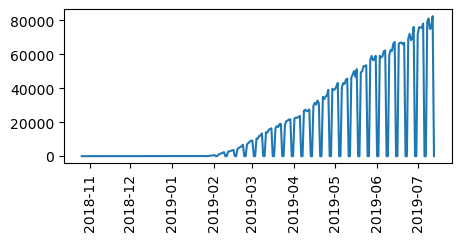

DBSF9223 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


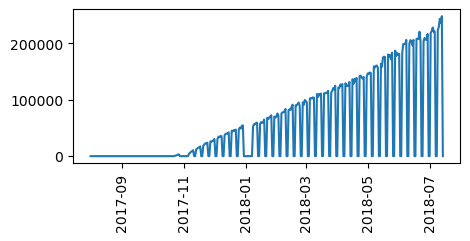

DBSF9229 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


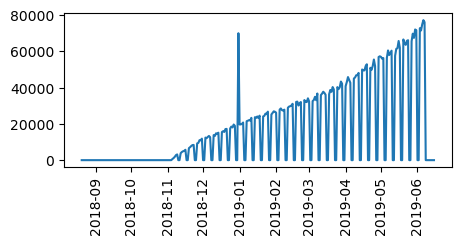

DBSF9275 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


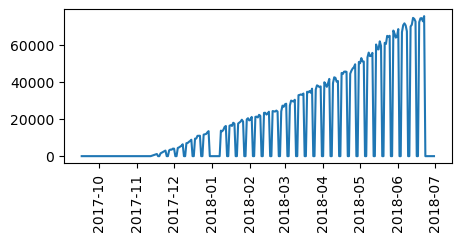

DBSF9369 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


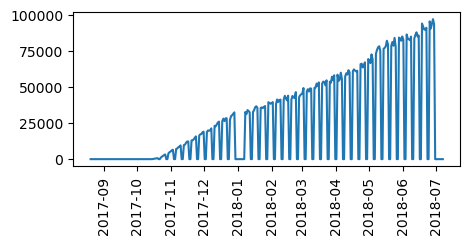

DBSF9377 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


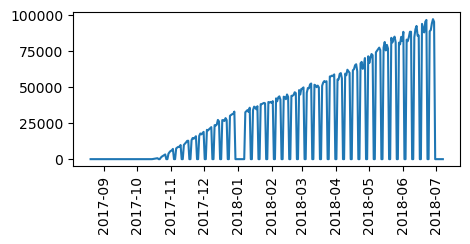

DBSF9378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


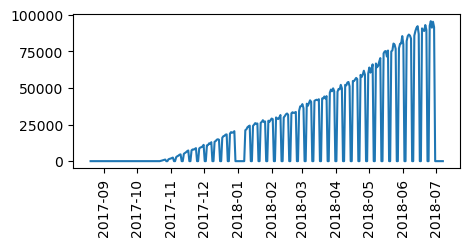

DBSF9391 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


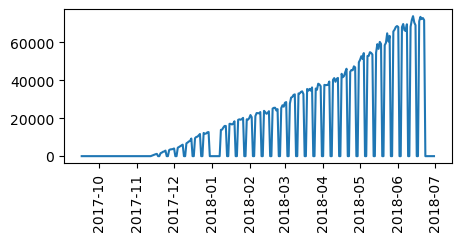

DBSF9404 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


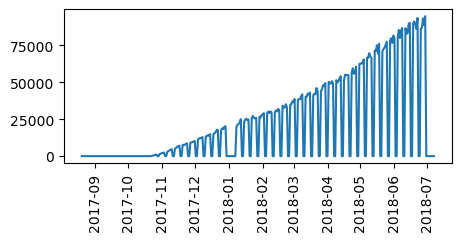

DBSF9406 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


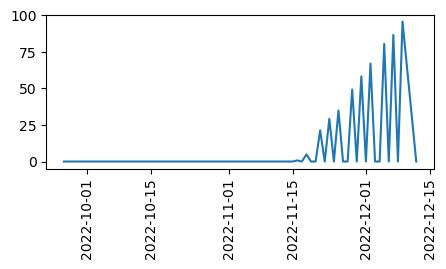

DBSF9498 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


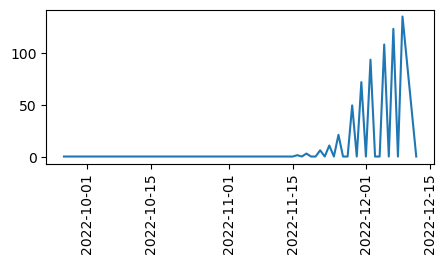

DBSF9546 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


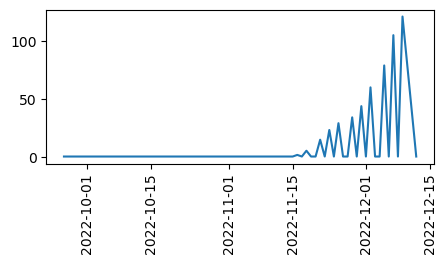

DBSF9627 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


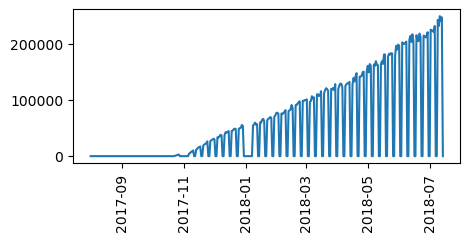

DBSF9631 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


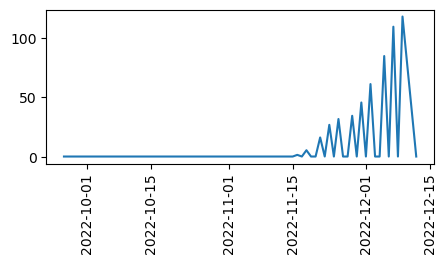

DBSF9675 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


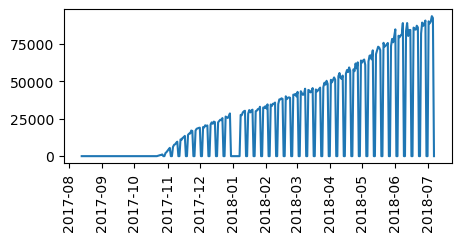

DBSF9688 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


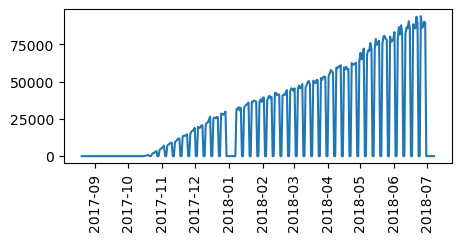

DBSF9741 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


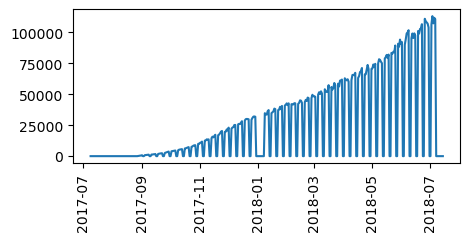

DBSF9746 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


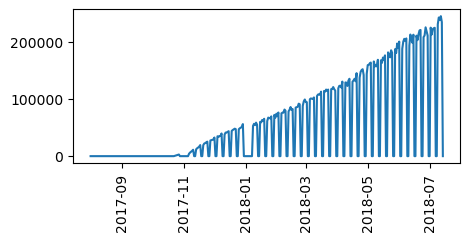

DBSF9761 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


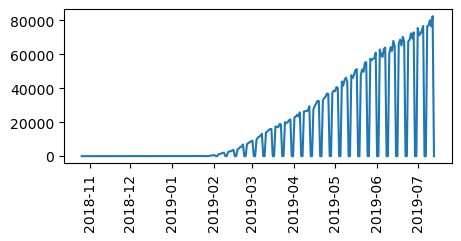

DBSF9777 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


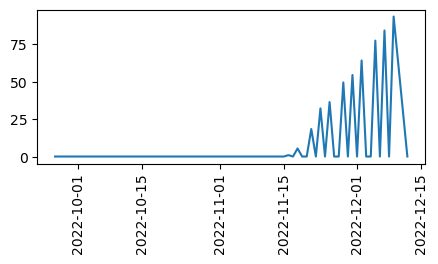

DBSF9793 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


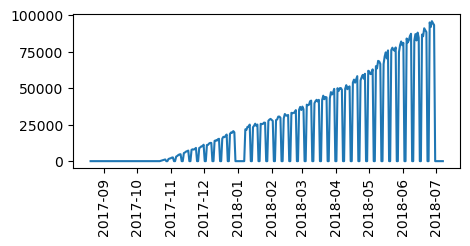

DBSF9838 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


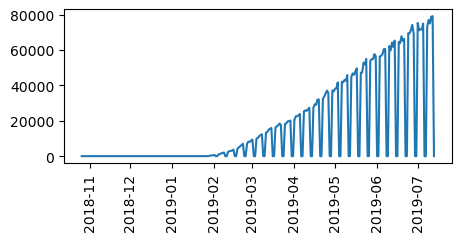

DBSF9894 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


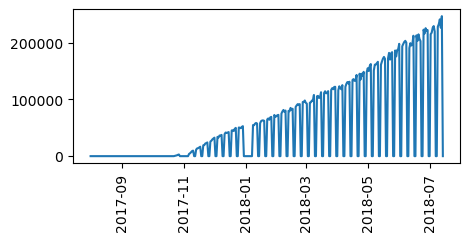

DBSF9922 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


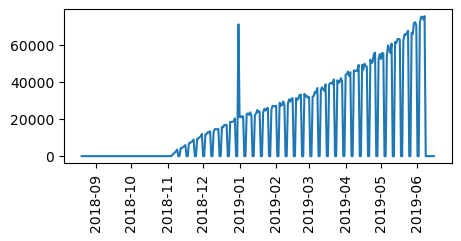

DBSF9942 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


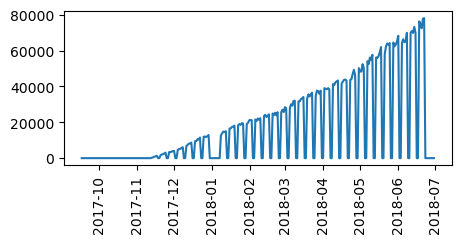

DBSF9948 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


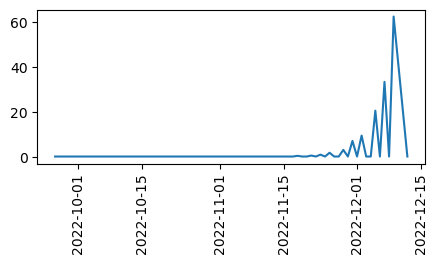

DBSF9961 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


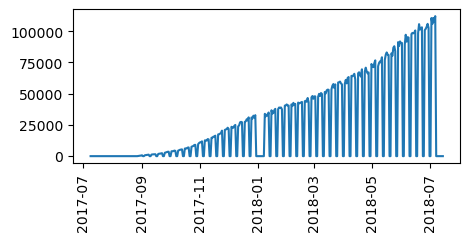

DBSF9969 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


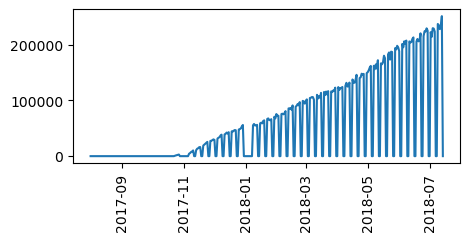

In [238]:
for i in tmp_df.frmDist.unique():
    plt.figure(figsize=[5,2])
    sub_df = tmp_df[tmp_df.frmDist==i]
    print(i, "/ Date:", min(sub_df.date), max(sub_df.date))
    plt.plot(sub_df.date, sub_df.outtrn_cumsum)
    plt.xticks(rotation=90)
    plt.show()

DBSF1059 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


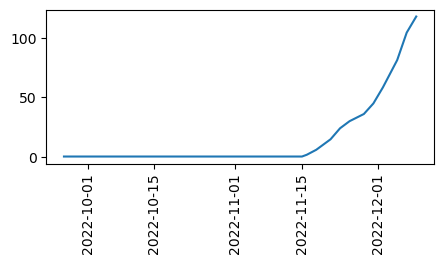

DBSF1093 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


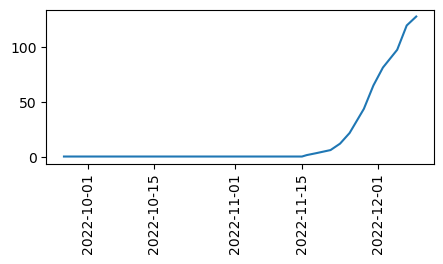

DBSF1121 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


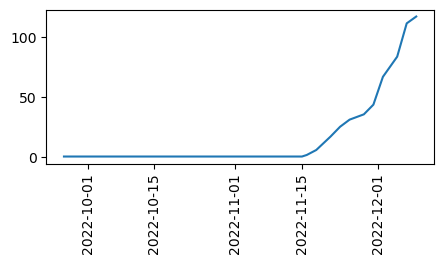

DBSF1172 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


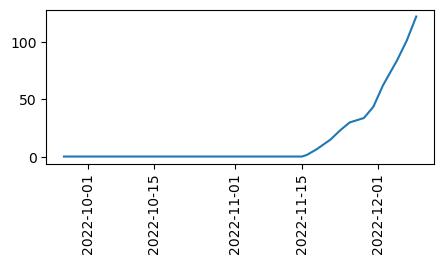

DBSF1180 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


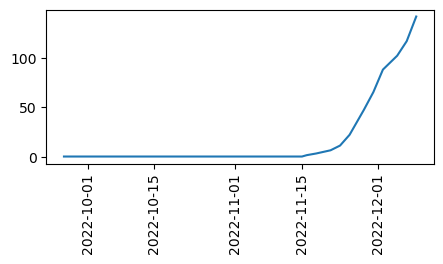

DBSF1186 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


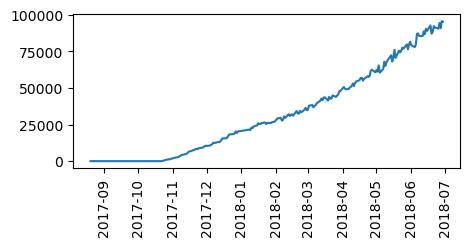

DBSF1205 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


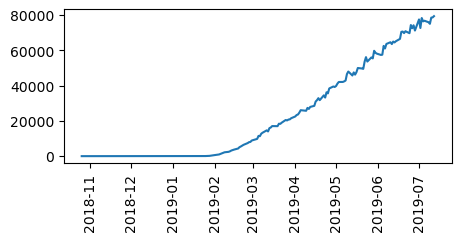

DBSF1215 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


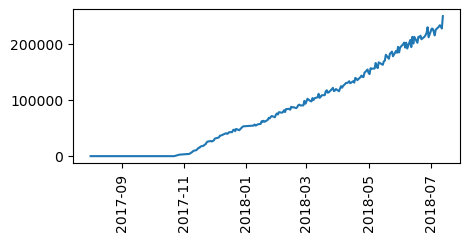

DBSF1218 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


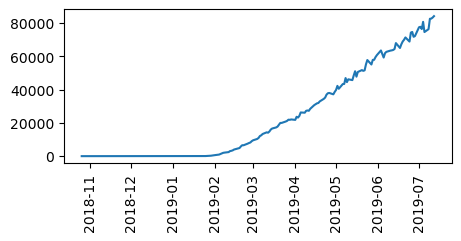

DBSF1232 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


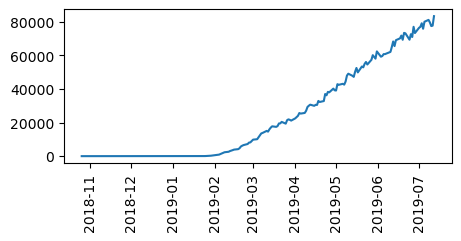

DBSF1279 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


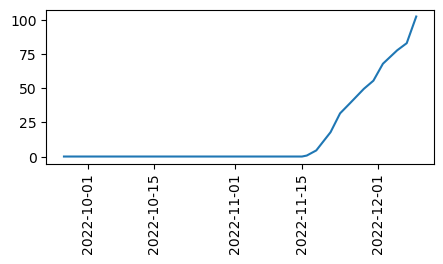

DBSF1294 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


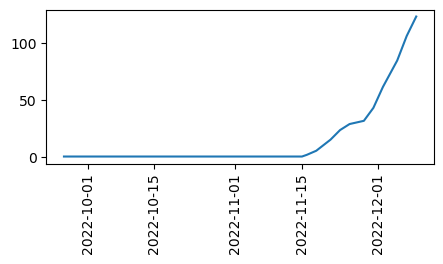

DBSF1385 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


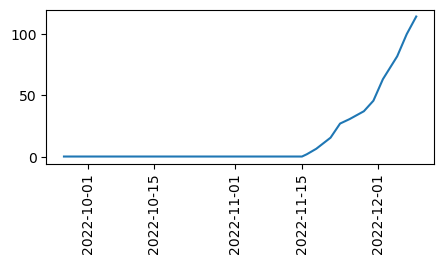

DBSF1386 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


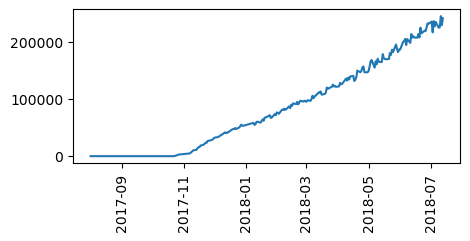

DBSF1459 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


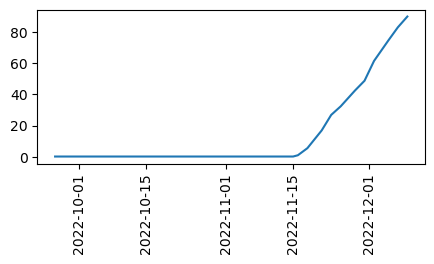

DBSF1466 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


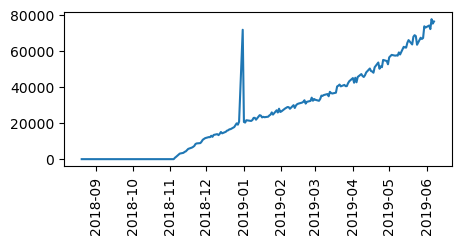

DBSF1469 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


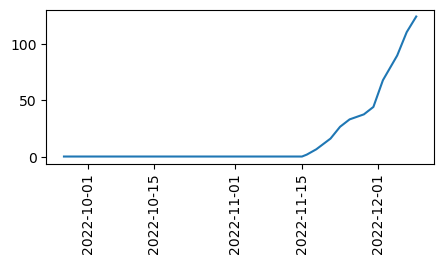

DBSF1490 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


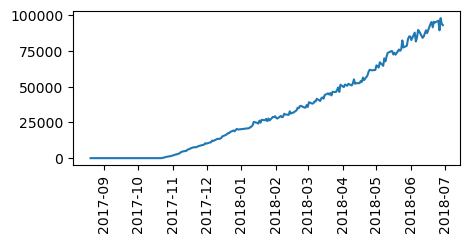

DBSF1505 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


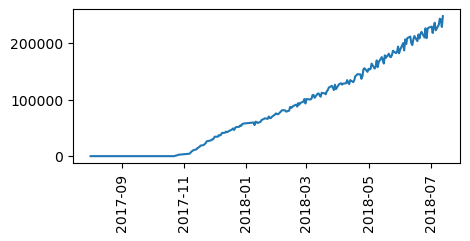

DBSF1507 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


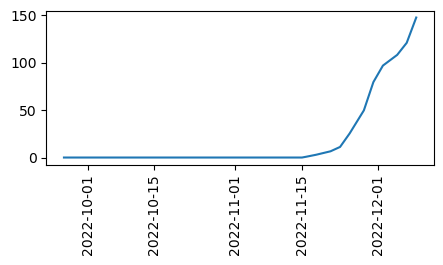

DBSF1539 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


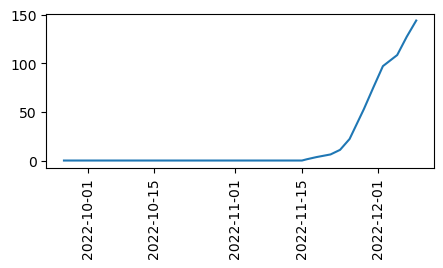

DBSF1554 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


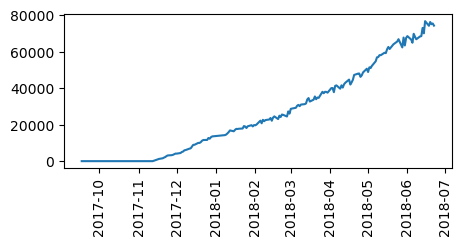

DBSF1601 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


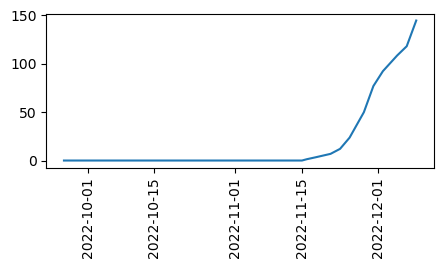

DBSF1621 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


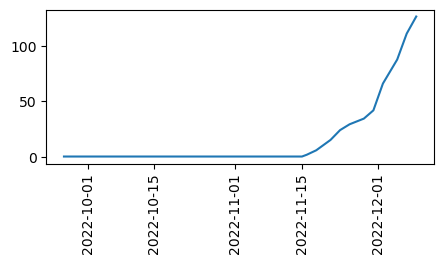

DBSF1644 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


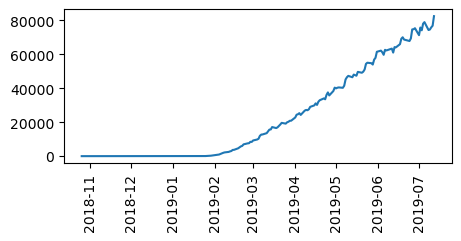

DBSF1645 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


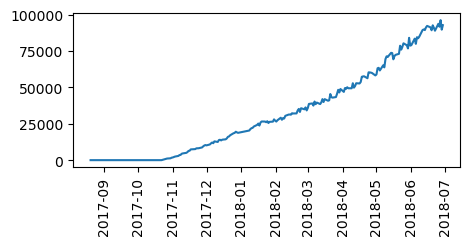

DBSF1673 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


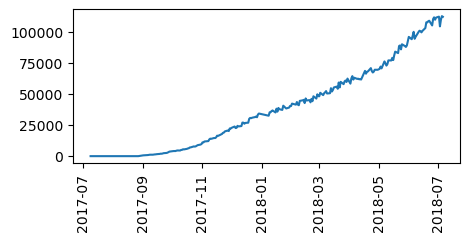

DBSF1757 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


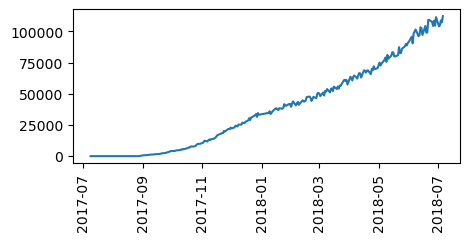

DBSF1767 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


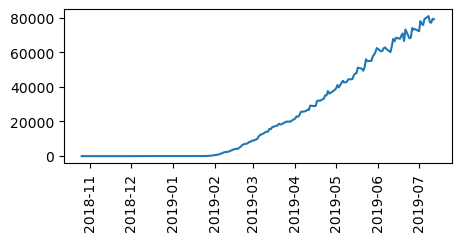

DBSF1871 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


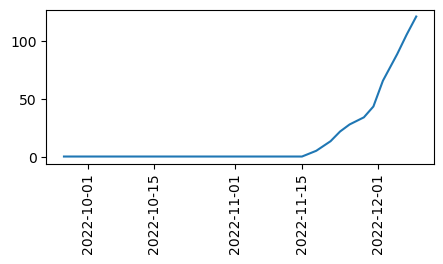

DBSF1873 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


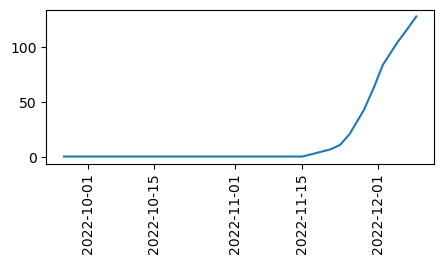

DBSF1880 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


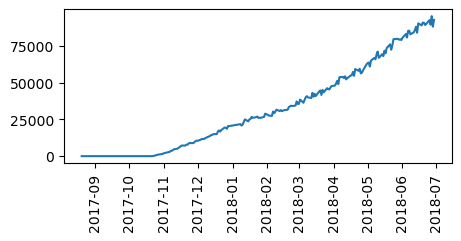

DBSF1886 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


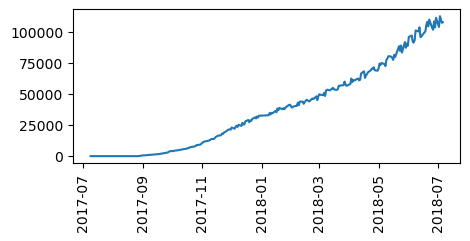

DBSF1916 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


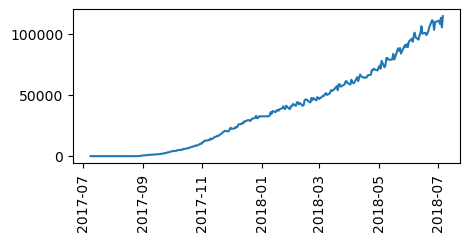

DBSF1921 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


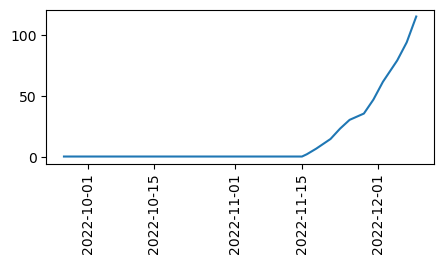

DBSF1934 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


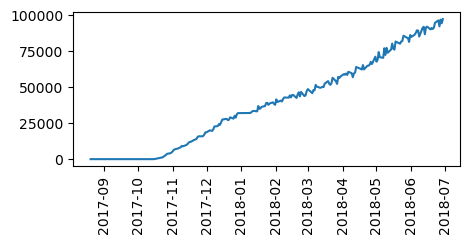

DBSF1974 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


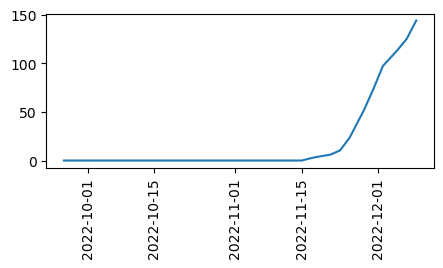

DBSF1975 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


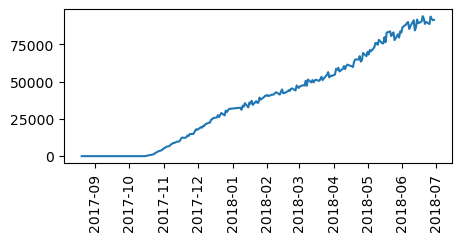

DBSF1991 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


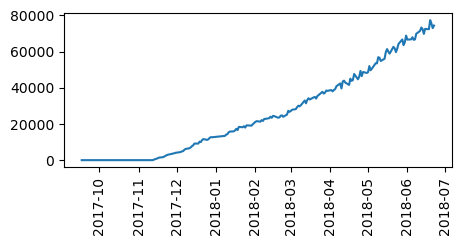

DBSF1998 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


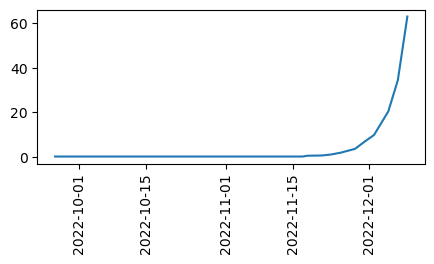

DBSF2008 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


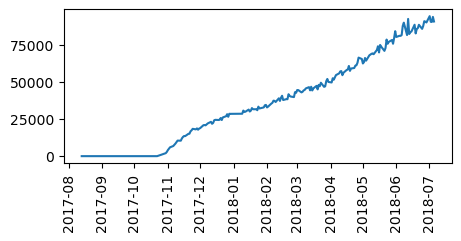

DBSF2027 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


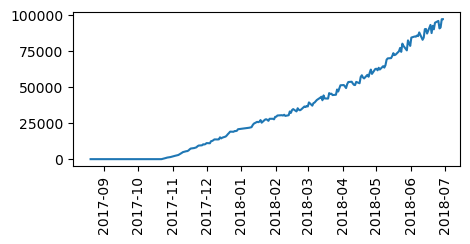

DBSF2032 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


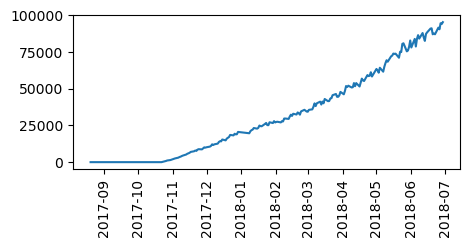

DBSF2044 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


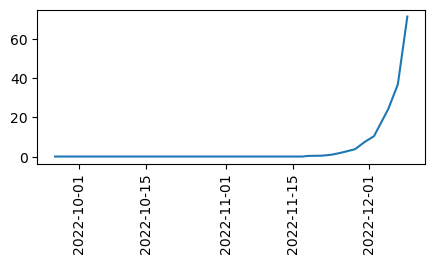

DBSF2117 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


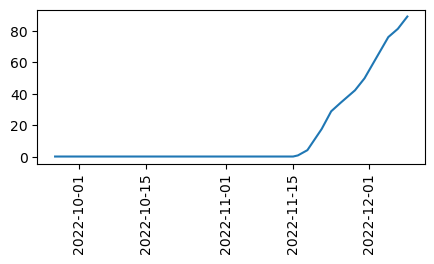

DBSF2191 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


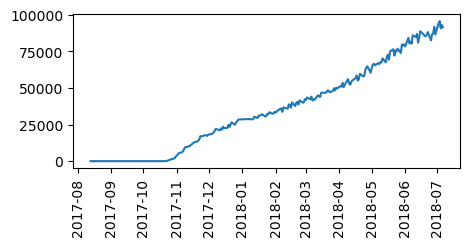

DBSF2212 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


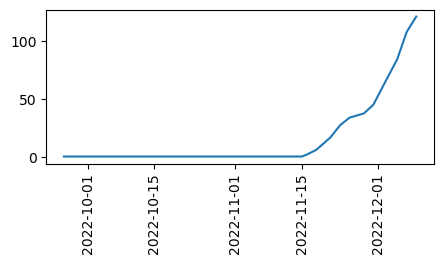

DBSF2218 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


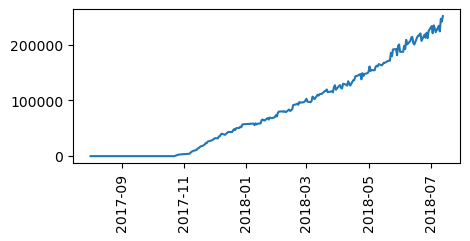

DBSF2244 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


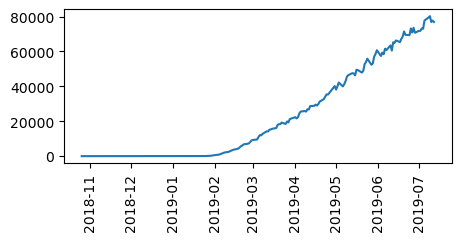

DBSF2252 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


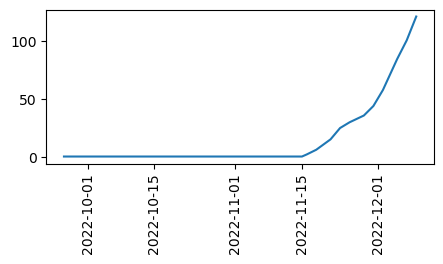

DBSF2256 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


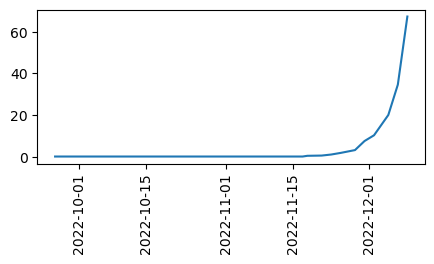

DBSF2259 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


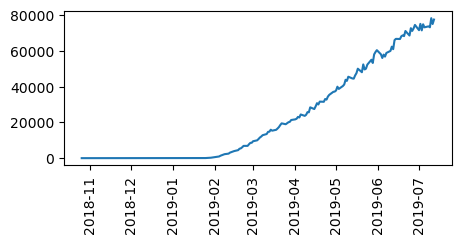

DBSF2274 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


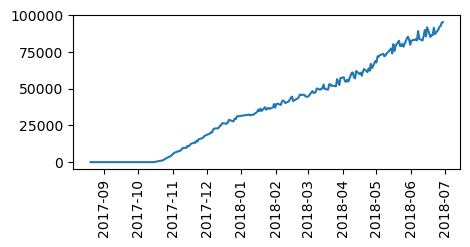

DBSF2318 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


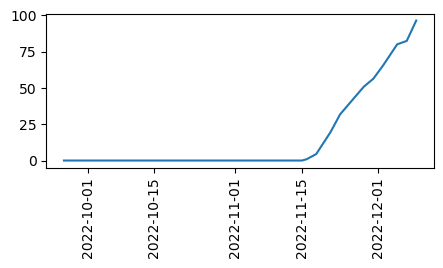

DBSF2319 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


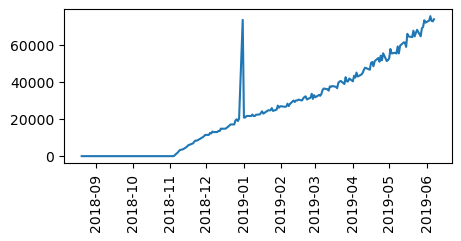

DBSF2334 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


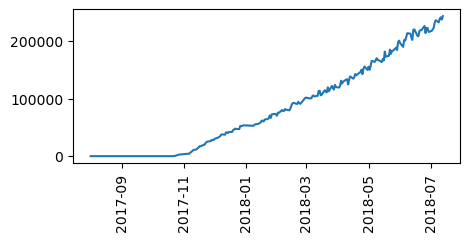

DBSF2335 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


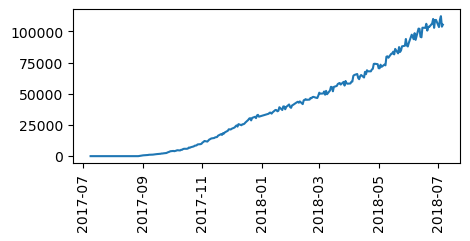

DBSF2347 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


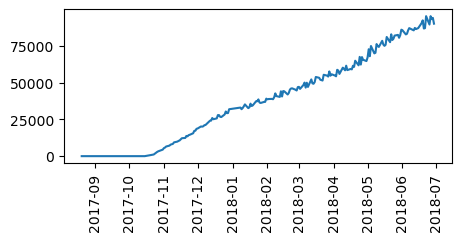

DBSF2352 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


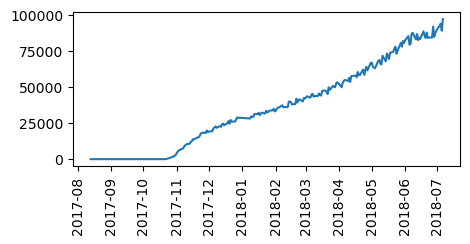

DBSF2360 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


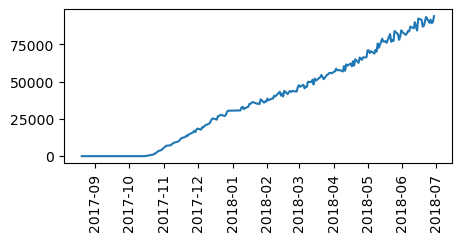

DBSF2371 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


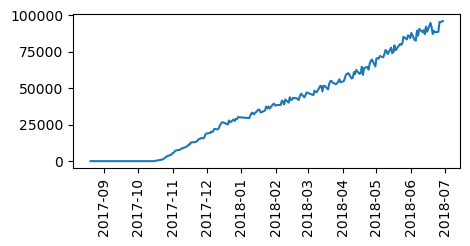

DBSF2376 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


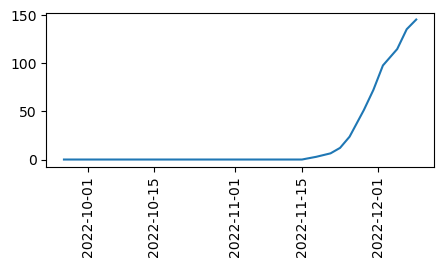

DBSF2378 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


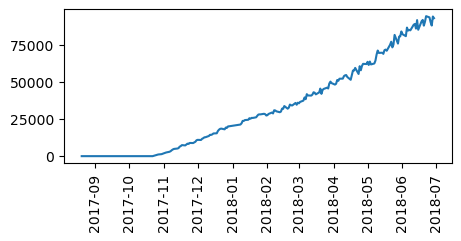

DBSF2389 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


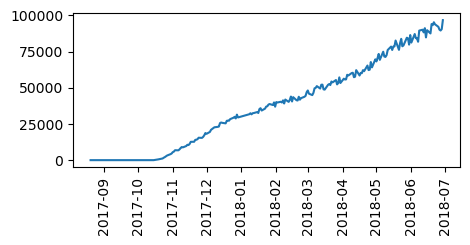

DBSF2413 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


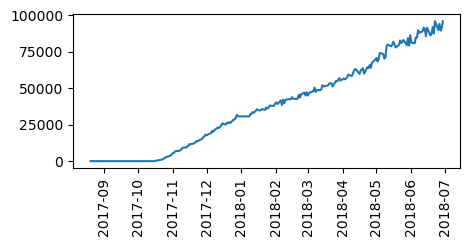

DBSF2422 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


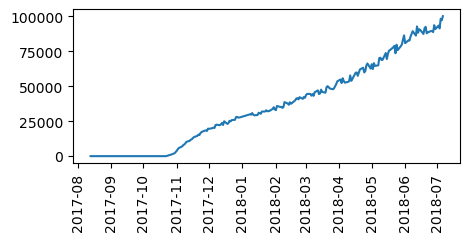

DBSF2471 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


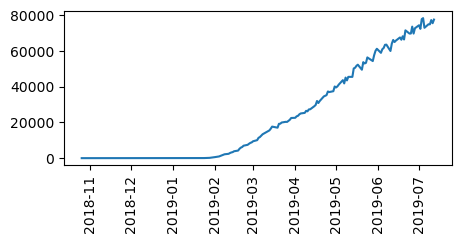

DBSF2525 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


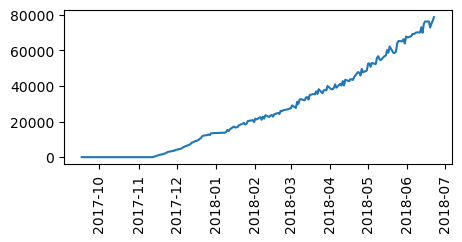

DBSF2571 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


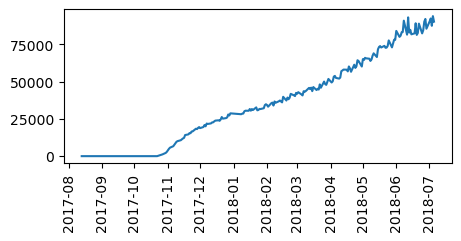

DBSF2630 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


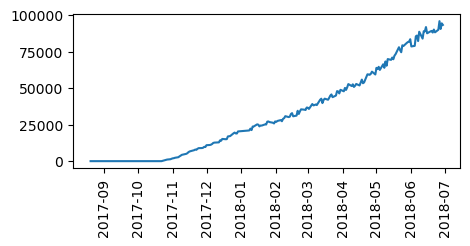

DBSF2640 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


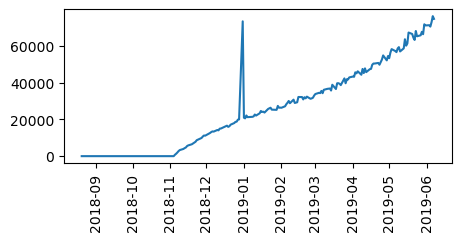

DBSF2681 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


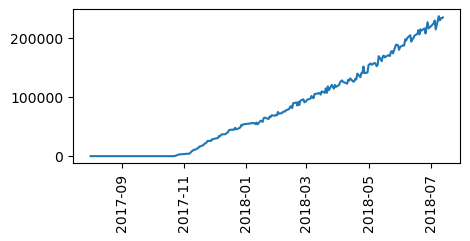

DBSF2686 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


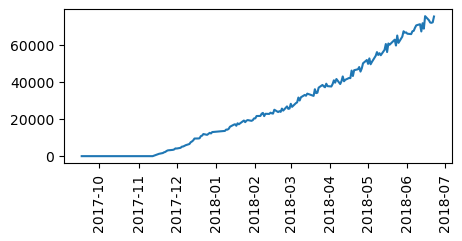

DBSF2689 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


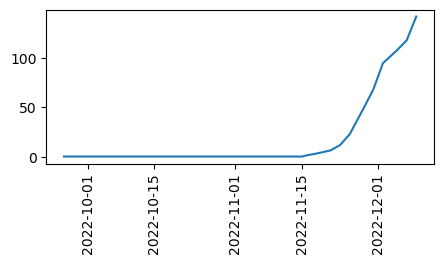

DBSF2708 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


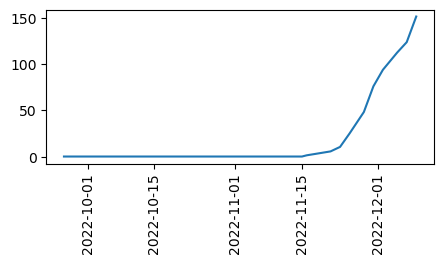

DBSF2752 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


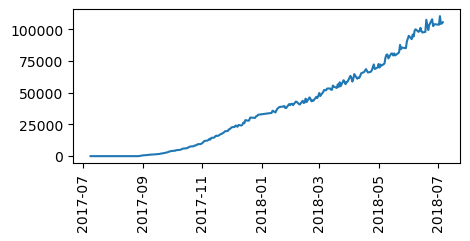

DBSF2803 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


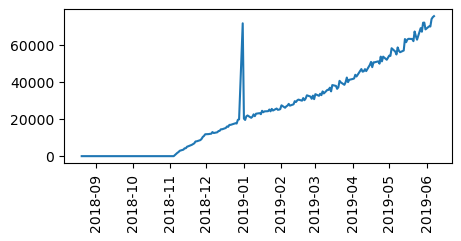

DBSF2809 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


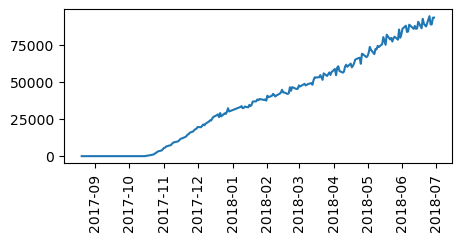

DBSF2822 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


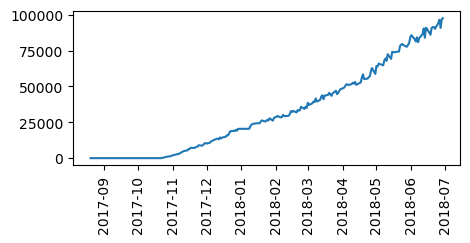

DBSF2823 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


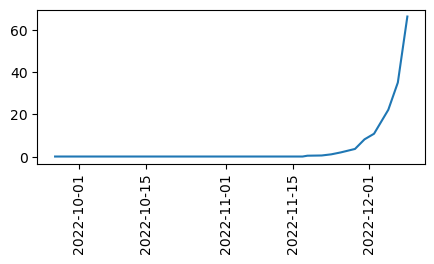

DBSF2828 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


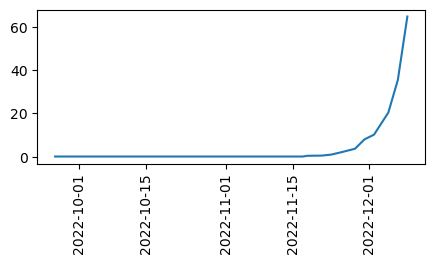

DBSF2832 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


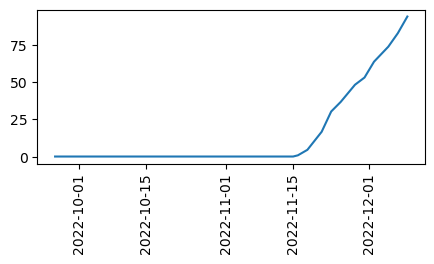

DBSF2846 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


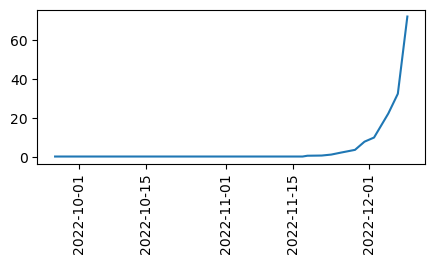

DBSF2888 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


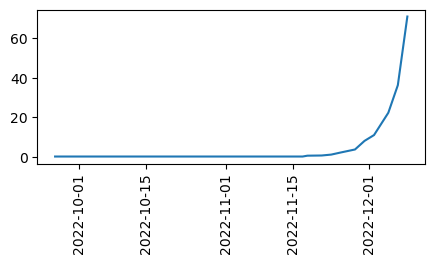

DBSF2911 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


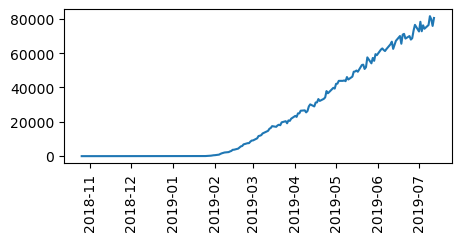

DBSF2918 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


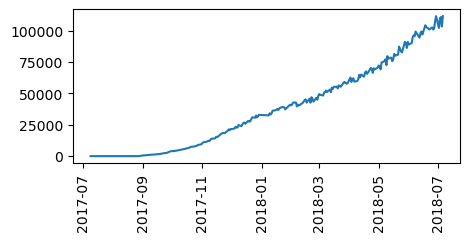

DBSF2927 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


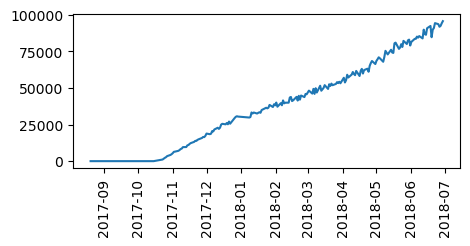

DBSF2989 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


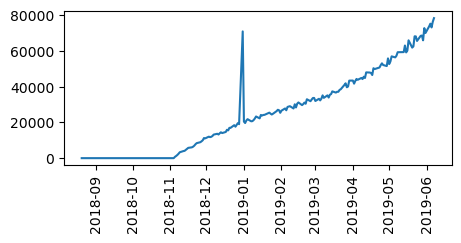

DBSF2992 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


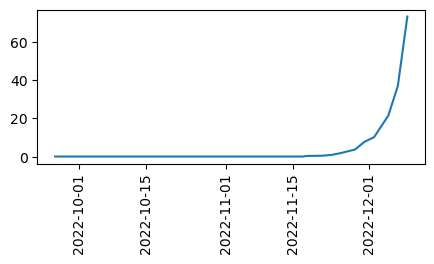

DBSF3001 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


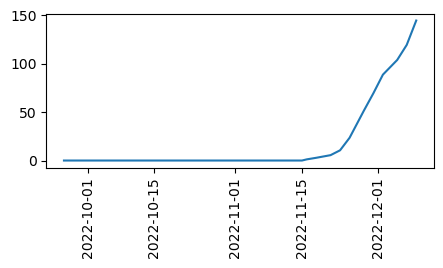

DBSF3010 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


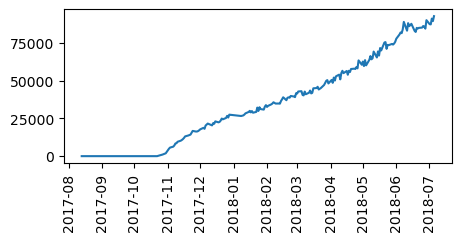

DBSF3034 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


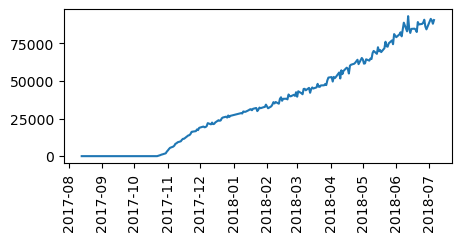

DBSF3067 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


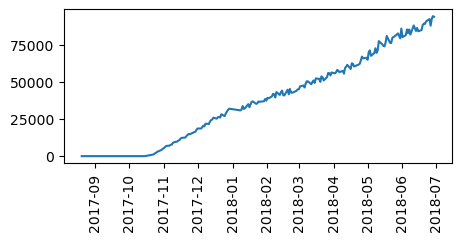

DBSF3068 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


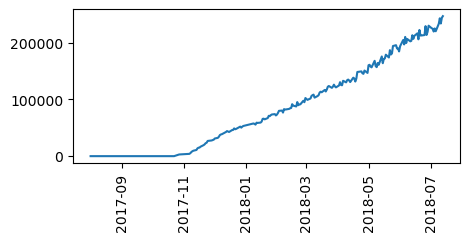

DBSF3075 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


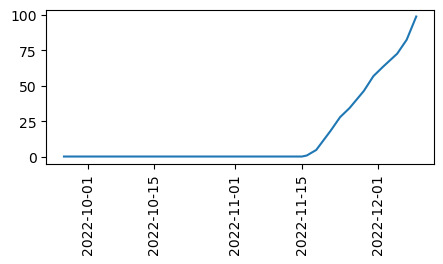

DBSF3076 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


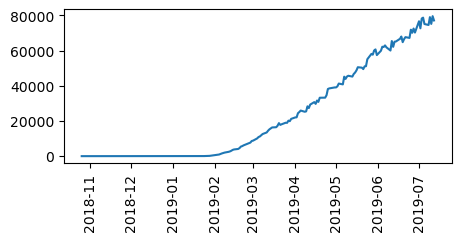

DBSF3118 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


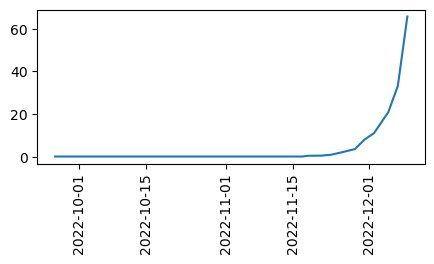

DBSF3132 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


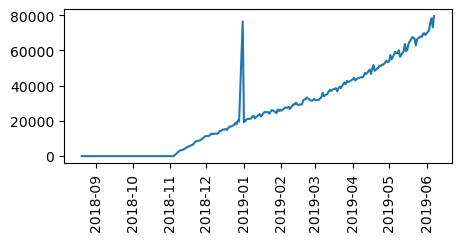

DBSF3135 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


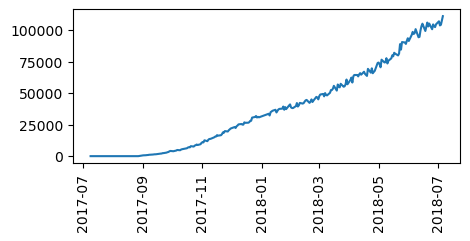

DBSF3165 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


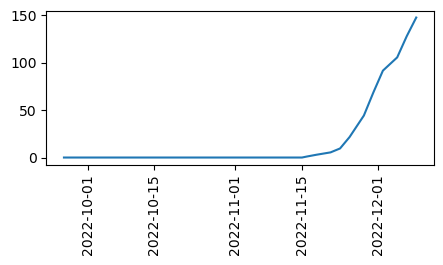

DBSF3172 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


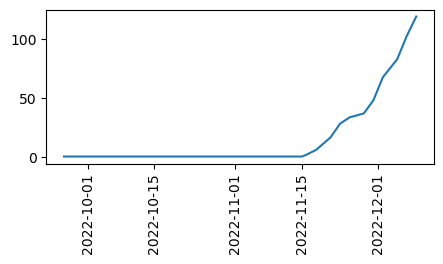

DBSF3199 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


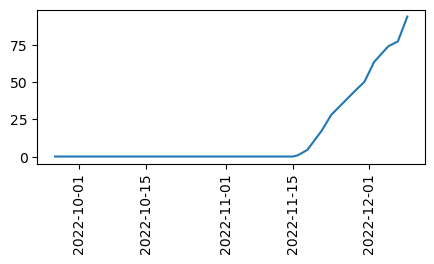

DBSF3205 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


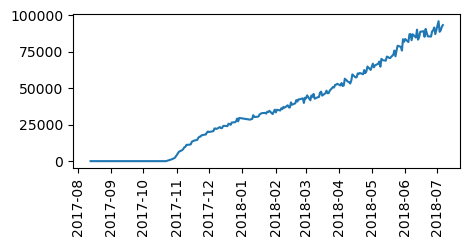

DBSF3214 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


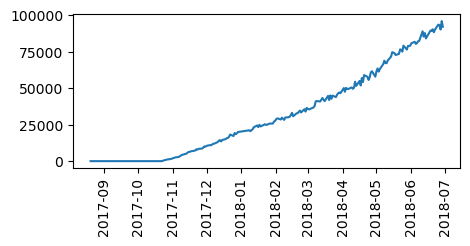

DBSF3228 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


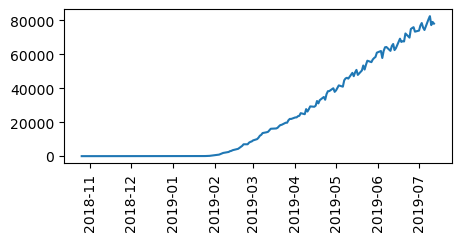

DBSF3311 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


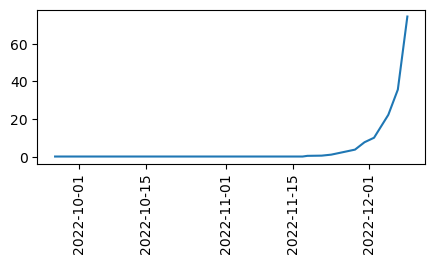

DBSF3367 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


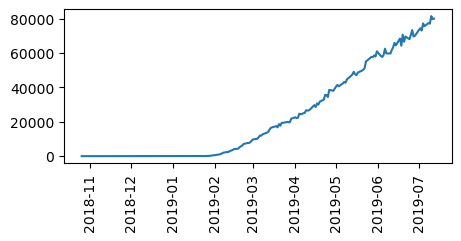

DBSF3372 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


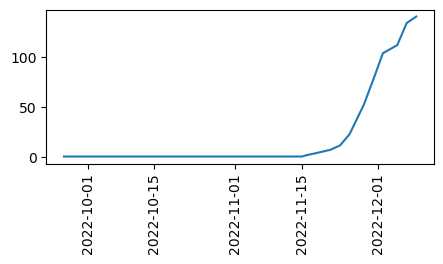

DBSF3383 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


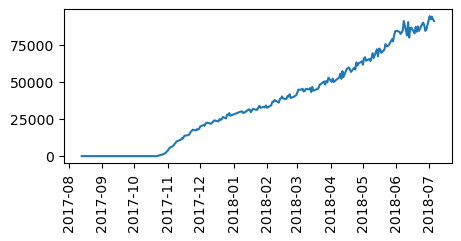

DBSF3399 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


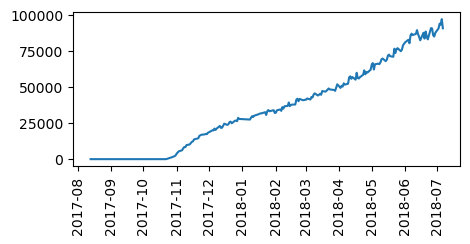

DBSF3425 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


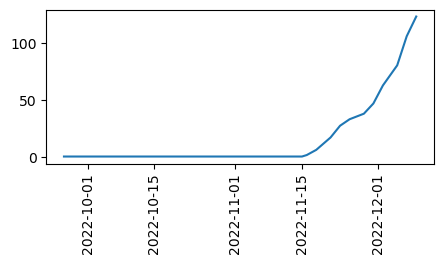

DBSF3426 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


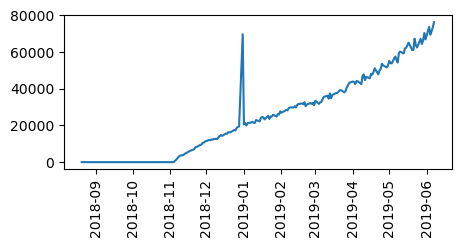

DBSF3467 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


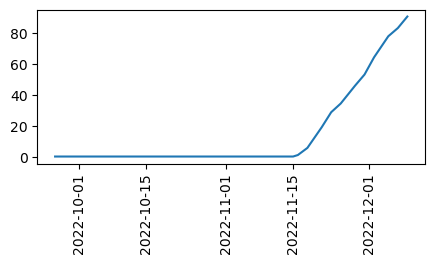

DBSF3470 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


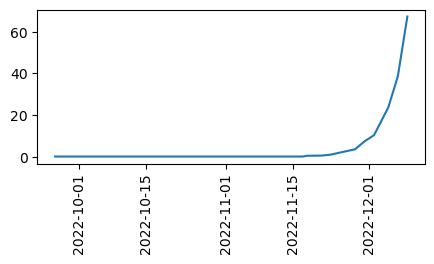

DBSF3490 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


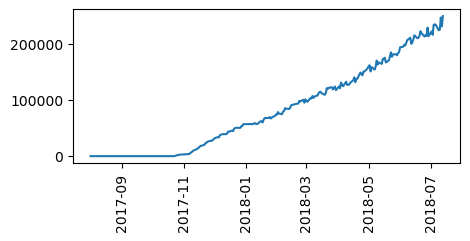

DBSF3527 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


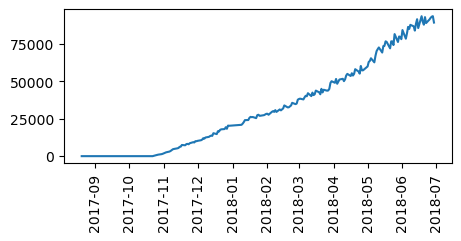

DBSF3532 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


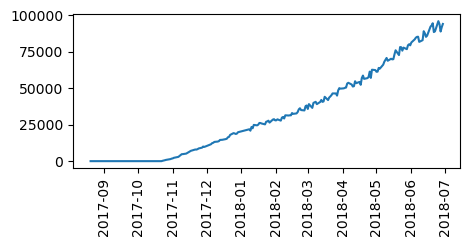

DBSF3546 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


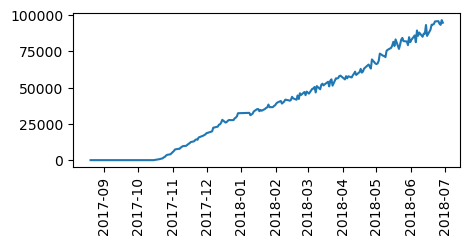

DBSF3567 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


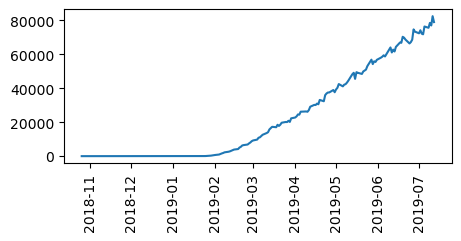

DBSF3583 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


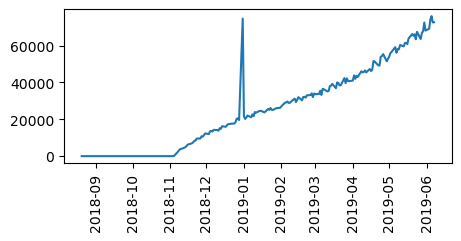

DBSF3593 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


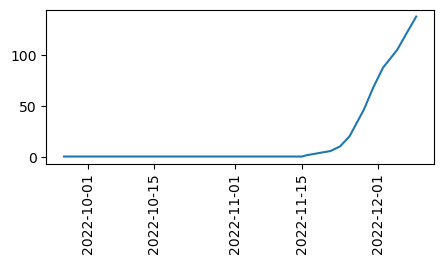

DBSF3597 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


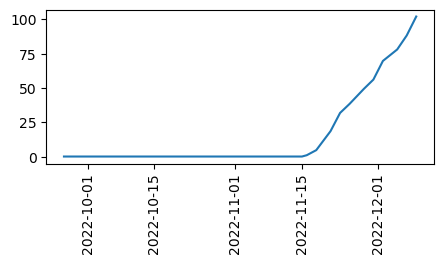

DBSF3655 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


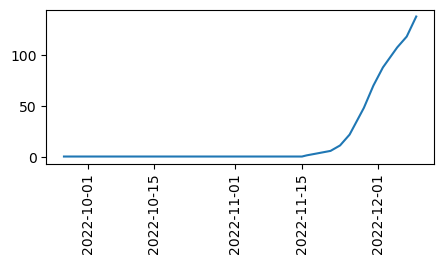

DBSF3661 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


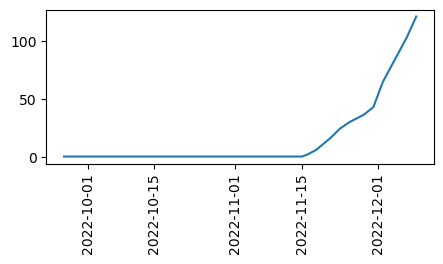

DBSF3705 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


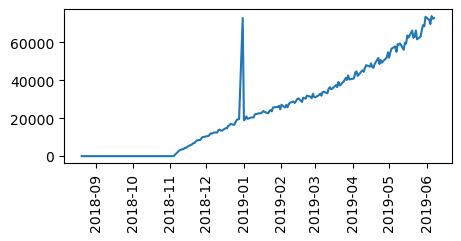

DBSF3755 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


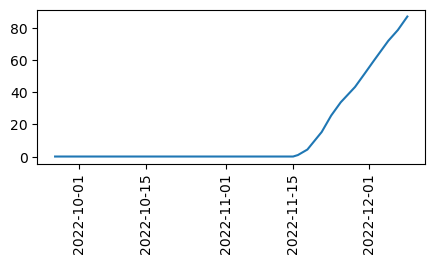

DBSF3803 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


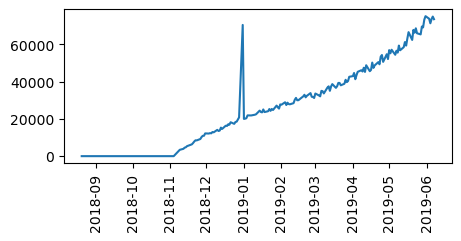

DBSF3841 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


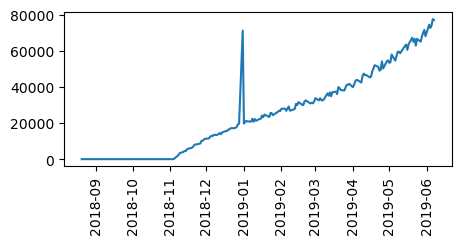

DBSF3850 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


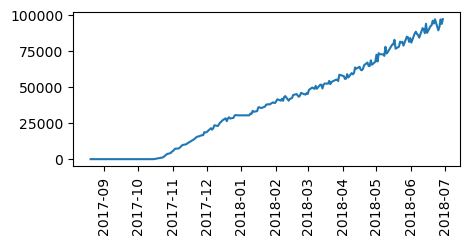

DBSF3891 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


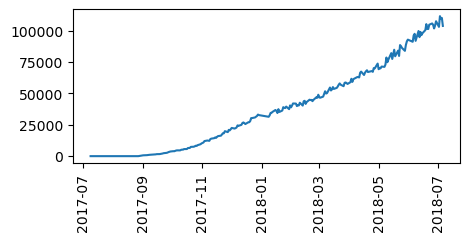

DBSF3906 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


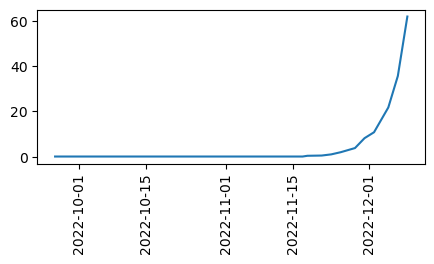

DBSF3911 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


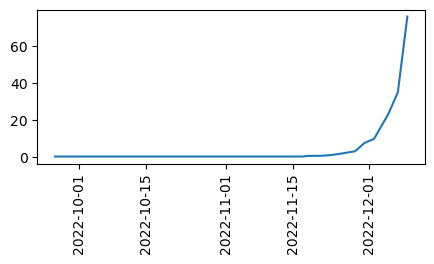

DBSF3912 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


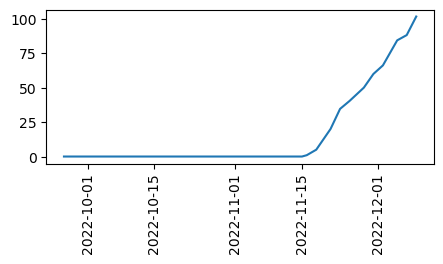

DBSF3924 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


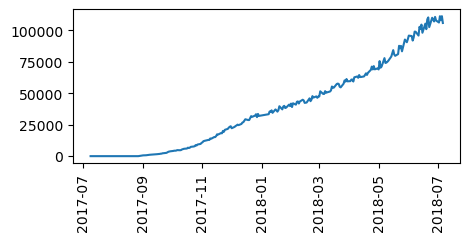

DBSF3932 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


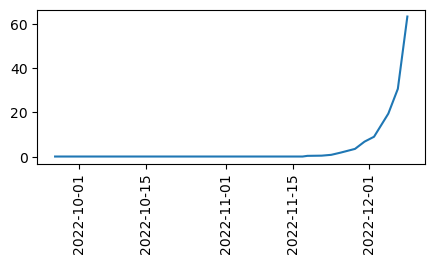

DBSF3990 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


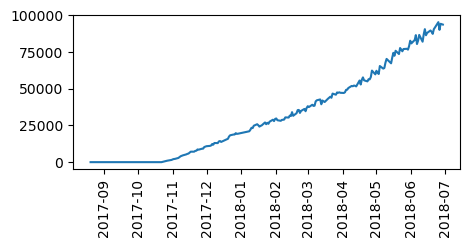

DBSF3998 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


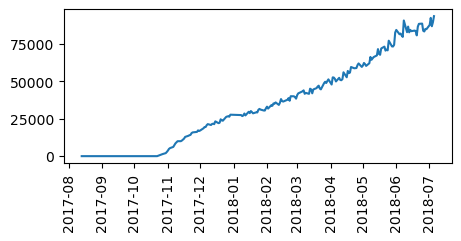

DBSF4004 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


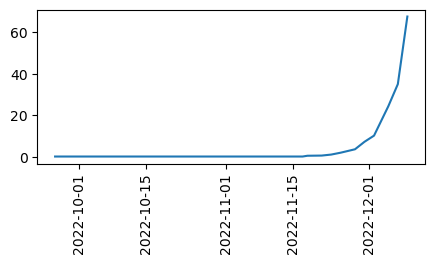

DBSF4013 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


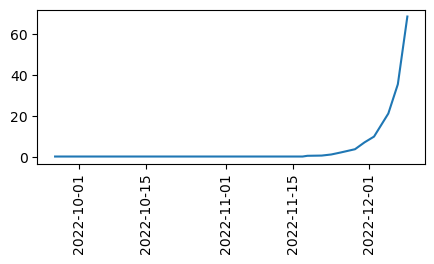

DBSF4049 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


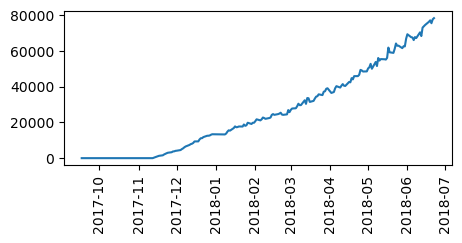

DBSF4083 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


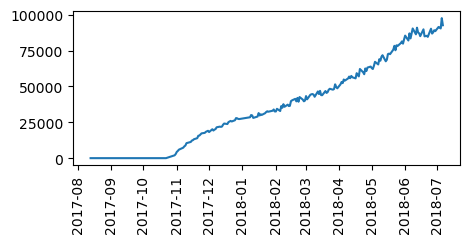

DBSF4101 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


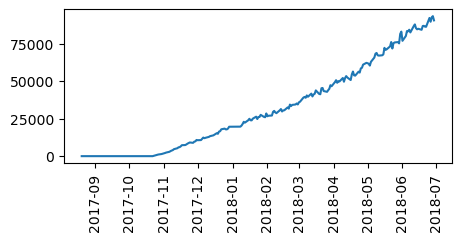

DBSF4111 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


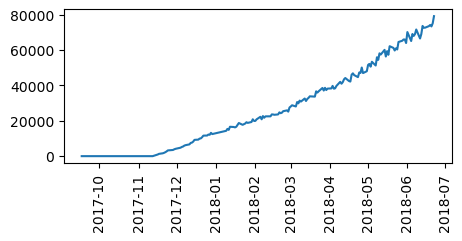

DBSF4121 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


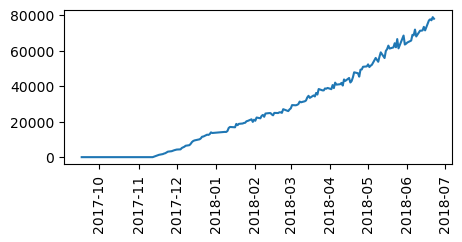

DBSF4146 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


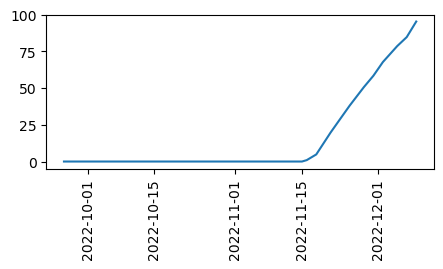

DBSF4154 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


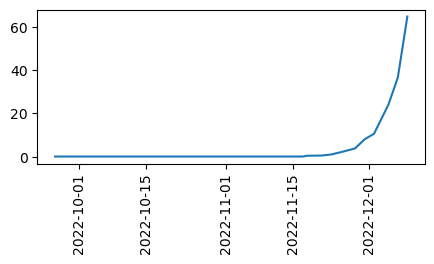

DBSF4163 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


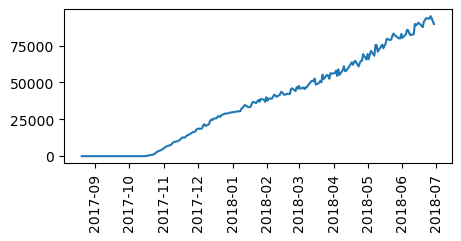

DBSF4181 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


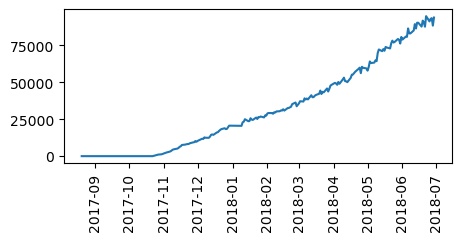

DBSF4197 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


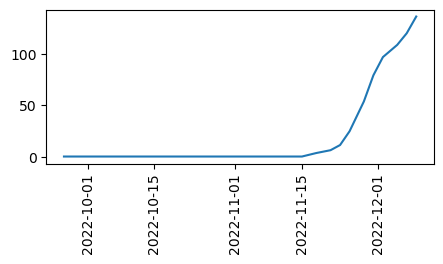

DBSF4202 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


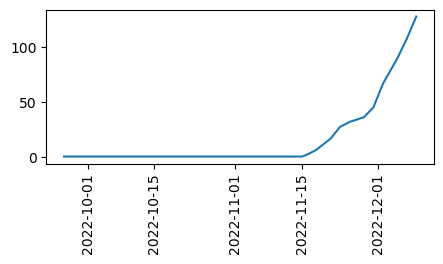

DBSF4212 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


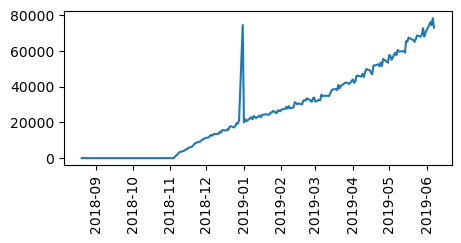

DBSF4250 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


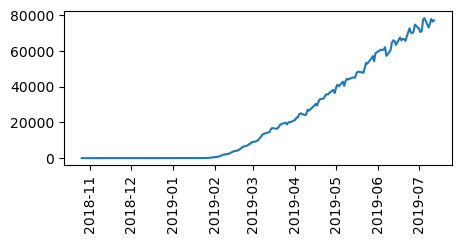

DBSF4283 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


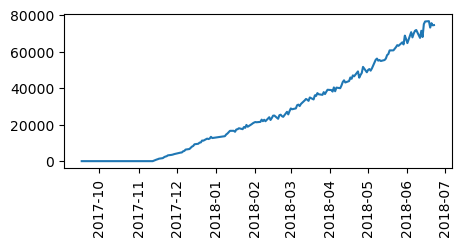

DBSF4310 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


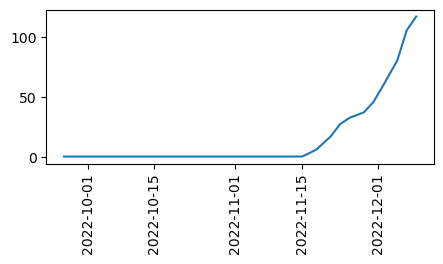

DBSF4329 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


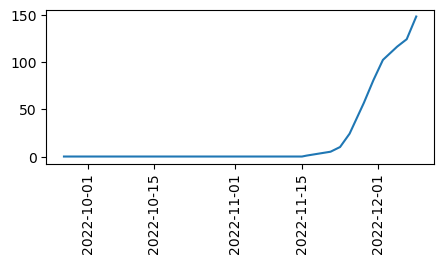

DBSF4371 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


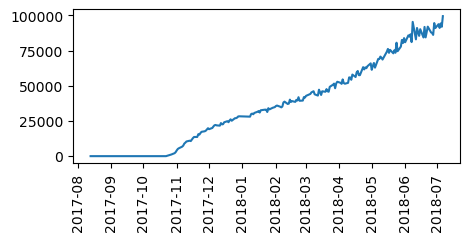

DBSF4401 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


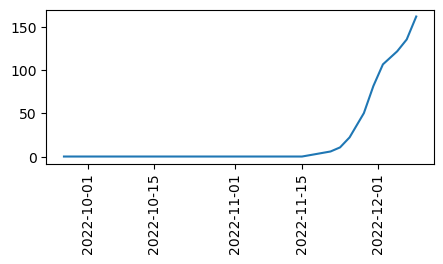

DBSF4442 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


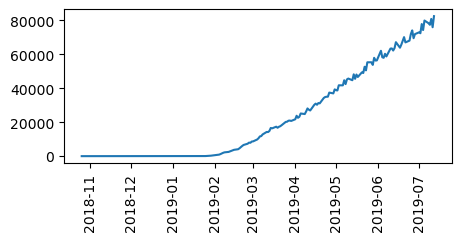

DBSF4466 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


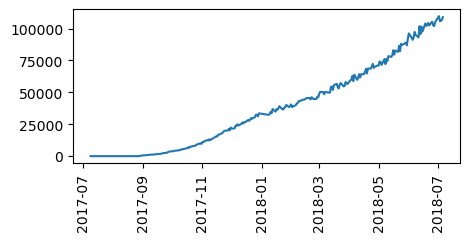

DBSF4554 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


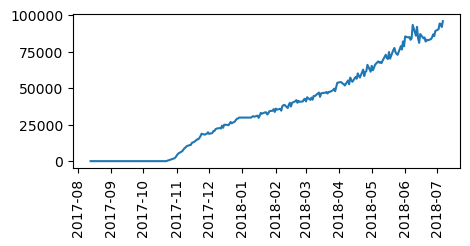

DBSF4640 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


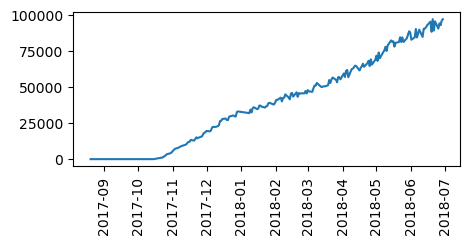

DBSF4646 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


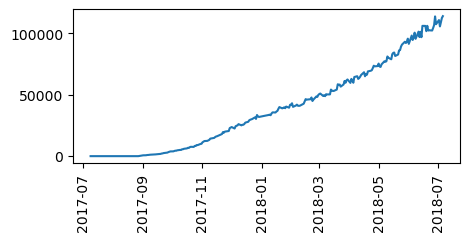

DBSF4659 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


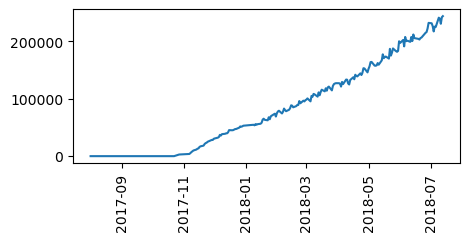

DBSF4678 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


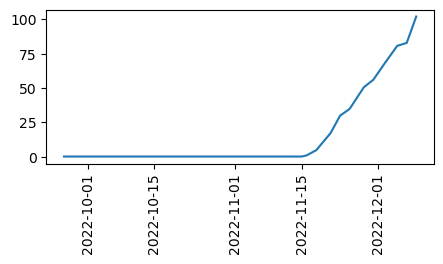

DBSF4713 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


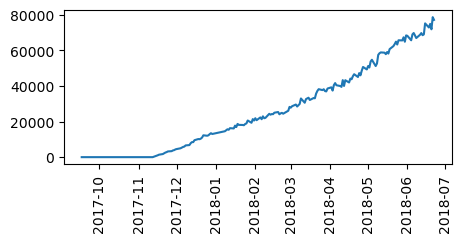

DBSF4716 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


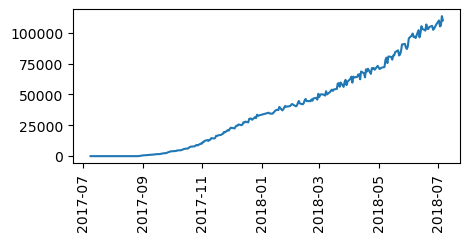

DBSF4720 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


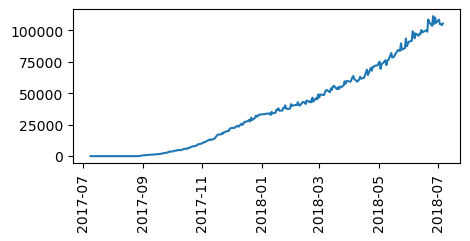

DBSF4752 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


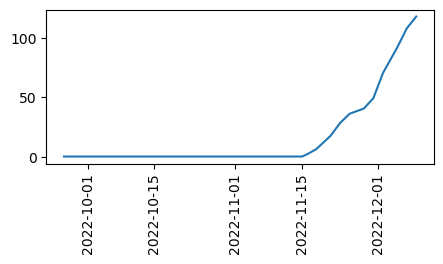

DBSF4800 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


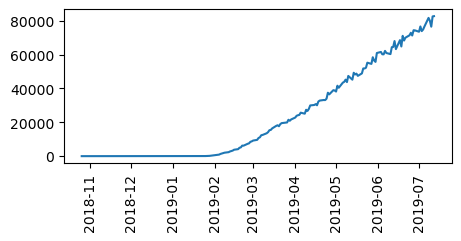

DBSF4812 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


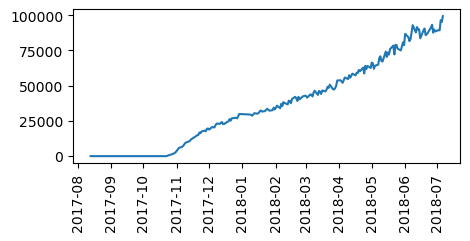

DBSF4814 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


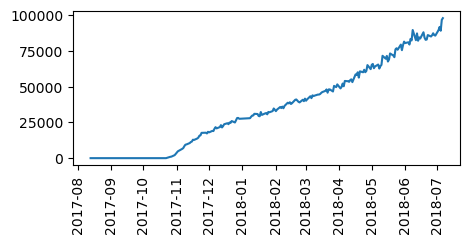

DBSF4817 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


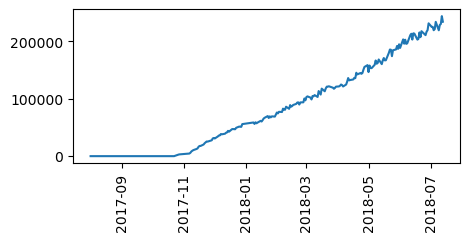

DBSF4846 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


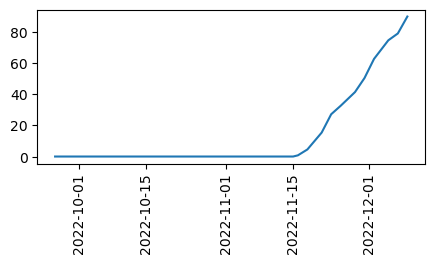

DBSF4885 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


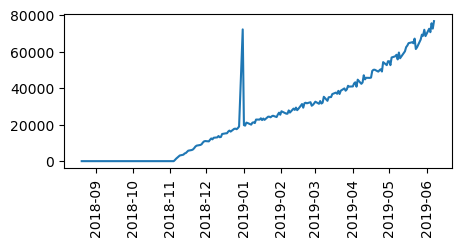

DBSF4907 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


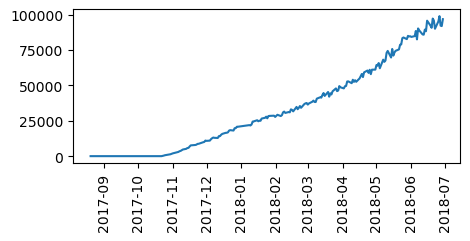

DBSF4964 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


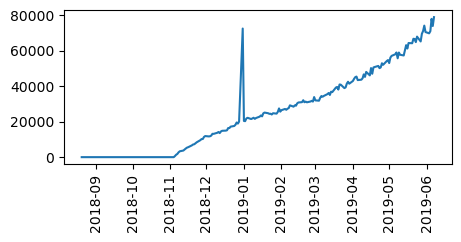

DBSF4972 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


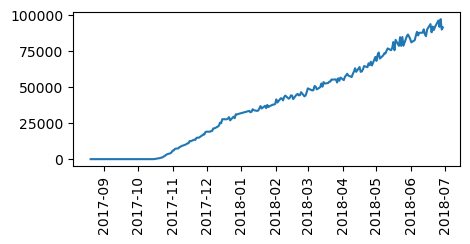

DBSF5022 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


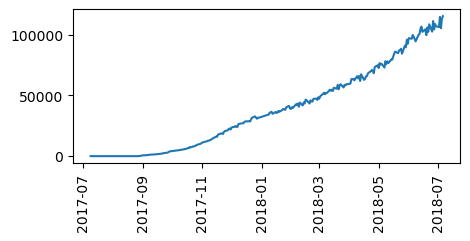

DBSF5056 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


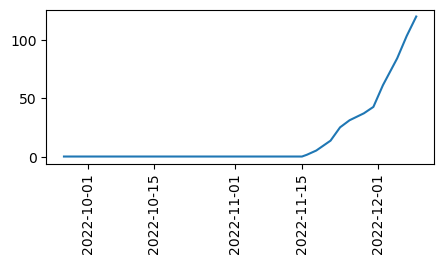

DBSF5095 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


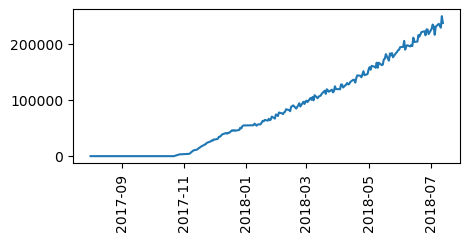

DBSF5121 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


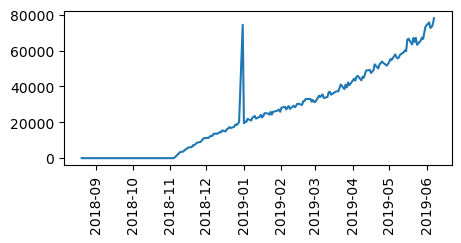

DBSF5170 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


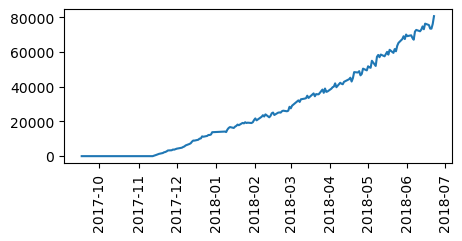

DBSF5193 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


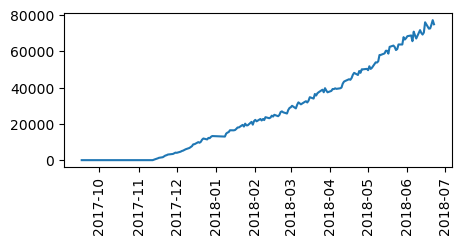

DBSF5216 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


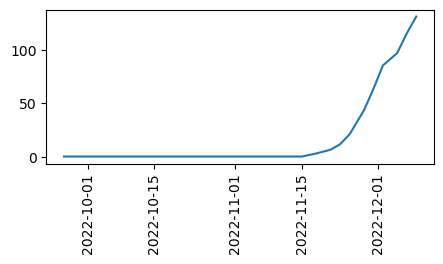

DBSF5227 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


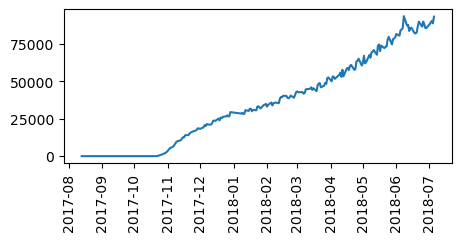

DBSF5240 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


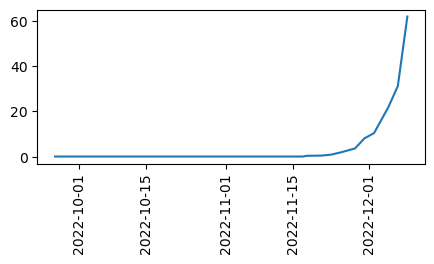

DBSF5243 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


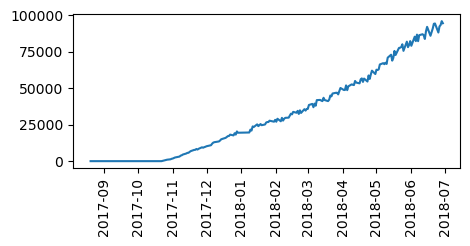

DBSF5271 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


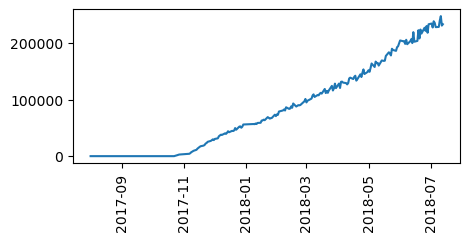

DBSF5299 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


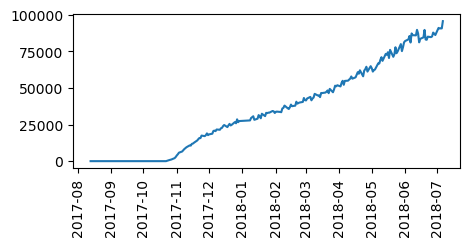

DBSF5303 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


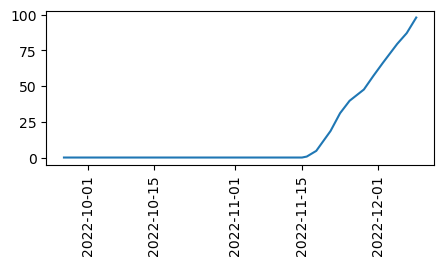

DBSF5344 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


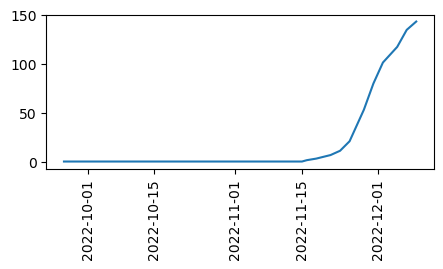

DBSF5351 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


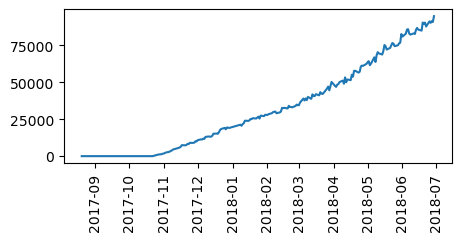

DBSF5403 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


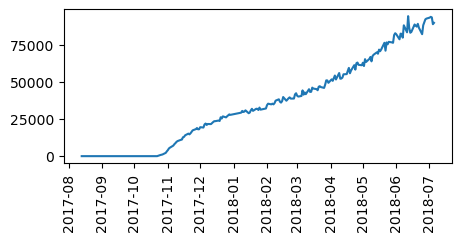

DBSF5429 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


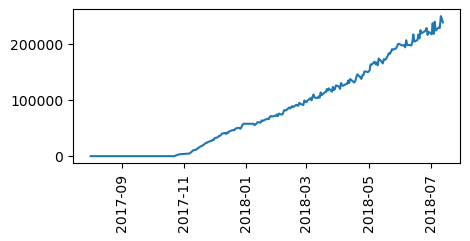

DBSF5452 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


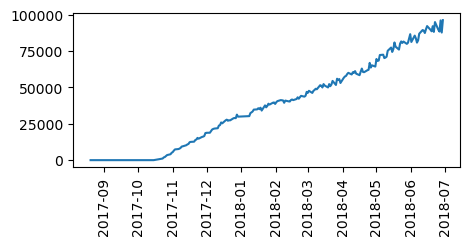

DBSF5534 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


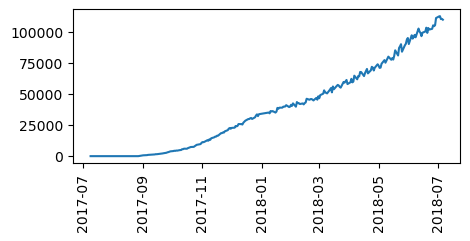

DBSF5549 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


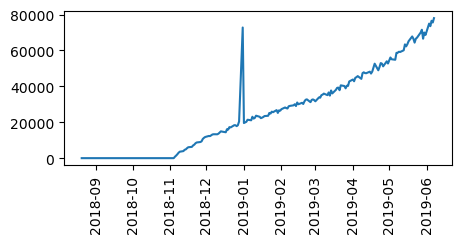

DBSF5566 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


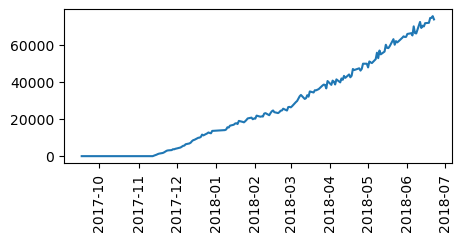

DBSF5575 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


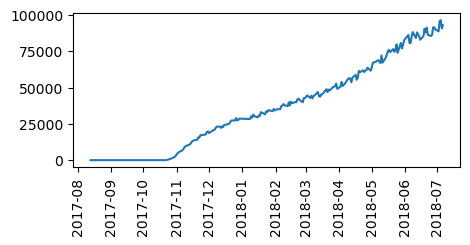

DBSF5587 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


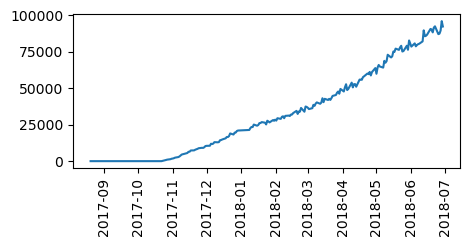

DBSF5607 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


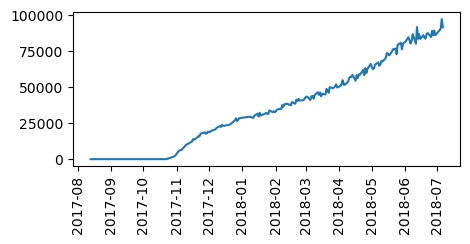

DBSF5628 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


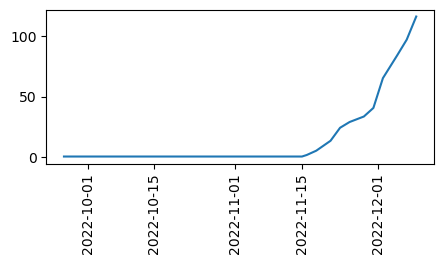

DBSF5644 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


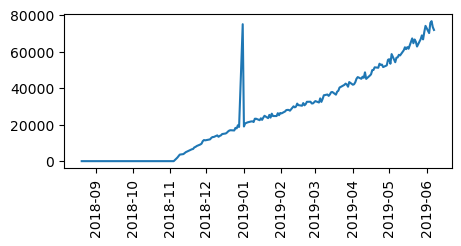

DBSF5661 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


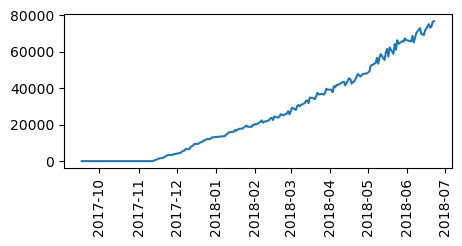

DBSF5686 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


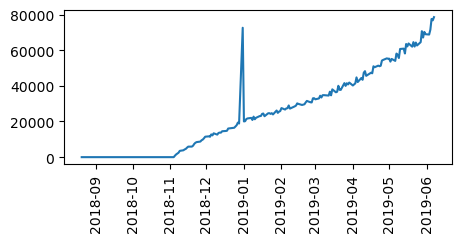

DBSF5705 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


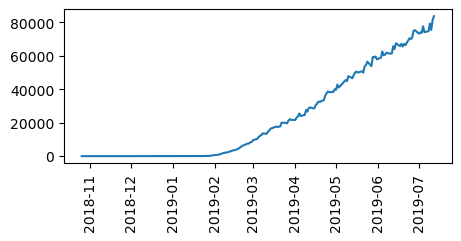

DBSF5734 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


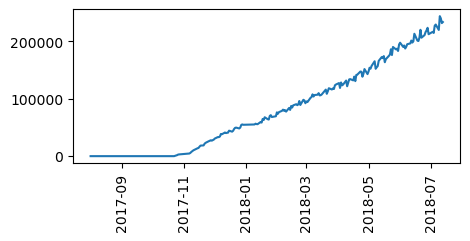

DBSF5764 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


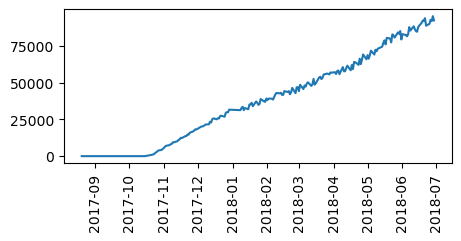

DBSF5769 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


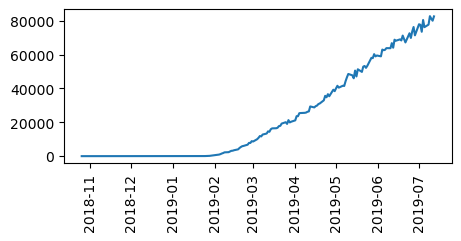

DBSF5772 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


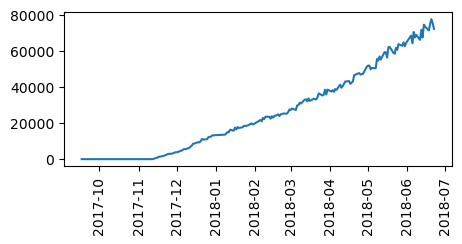

DBSF5823 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


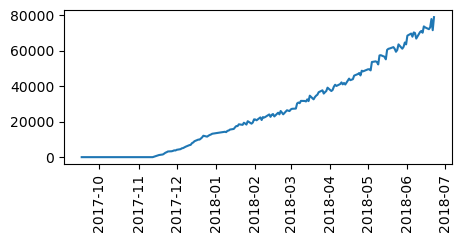

DBSF5833 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


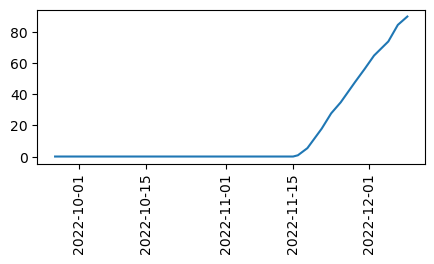

DBSF5847 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


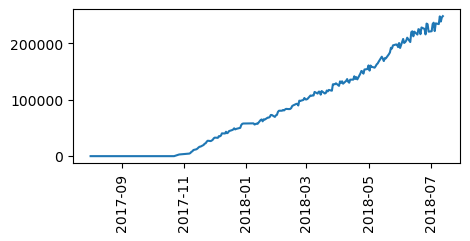

DBSF5848 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


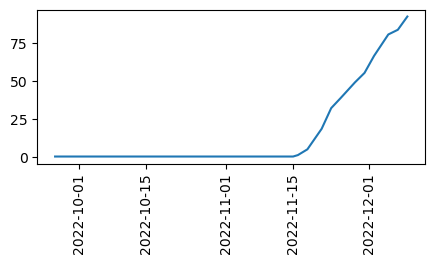

DBSF5875 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


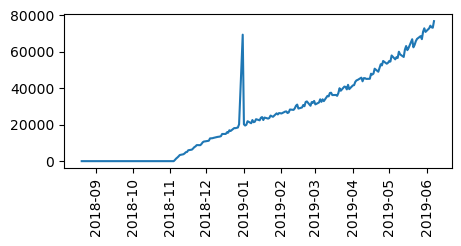

DBSF5973 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


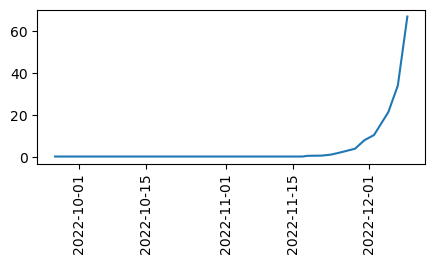

DBSF6030 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


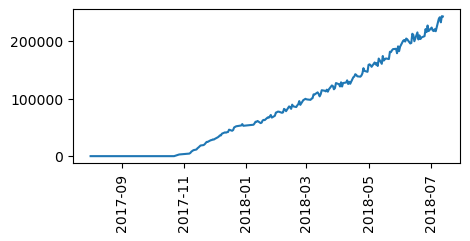

DBSF6039 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


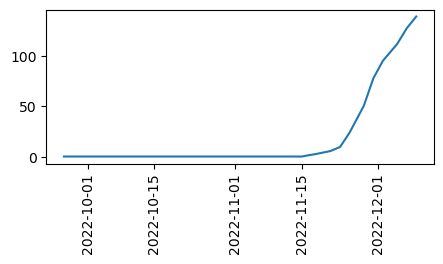

DBSF6042 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


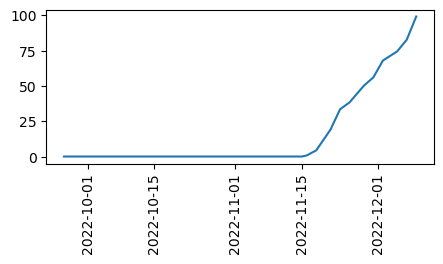

DBSF6053 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


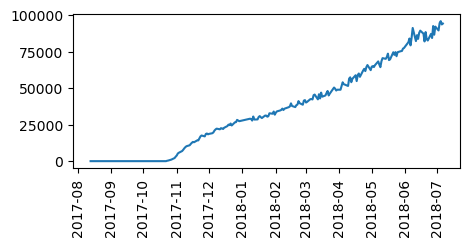

DBSF6057 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


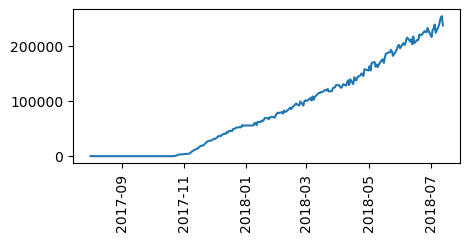

DBSF6059 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


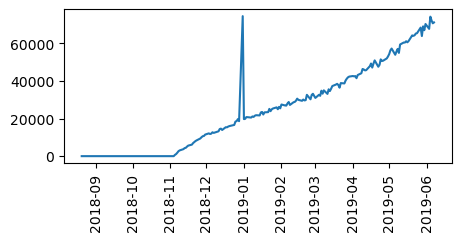

DBSF6134 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


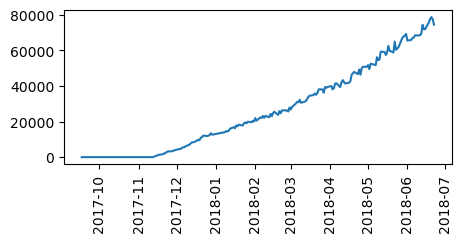

DBSF6144 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


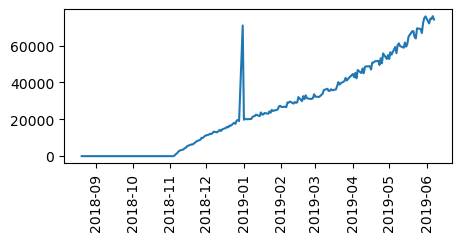

DBSF6147 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


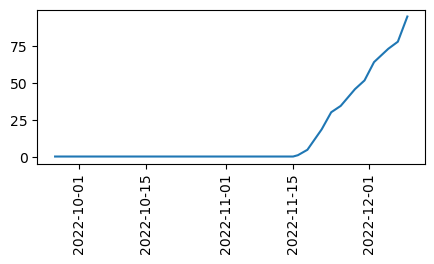

DBSF6163 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


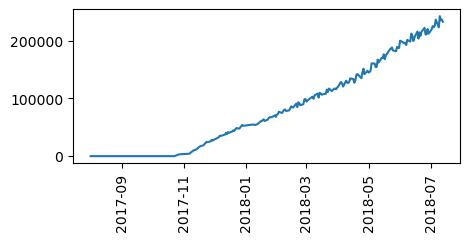

DBSF6174 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


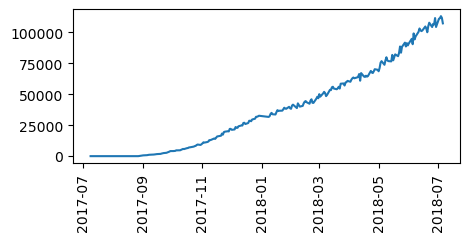

DBSF6206 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


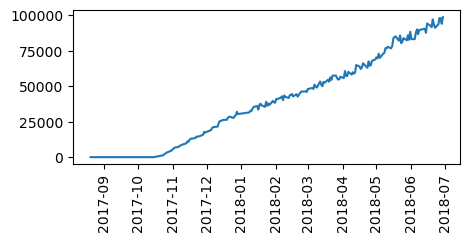

DBSF6211 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


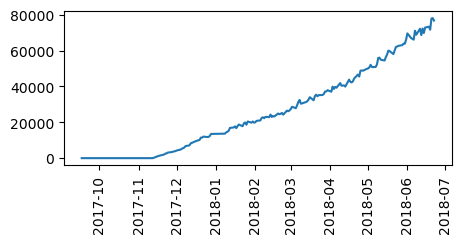

DBSF6218 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


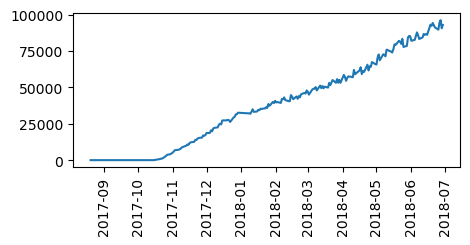

DBSF6295 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


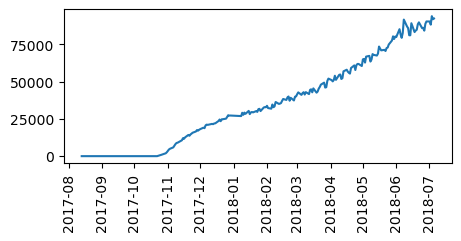

DBSF6298 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


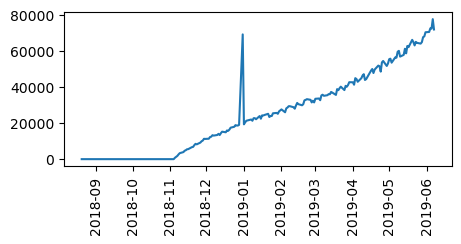

DBSF6305 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


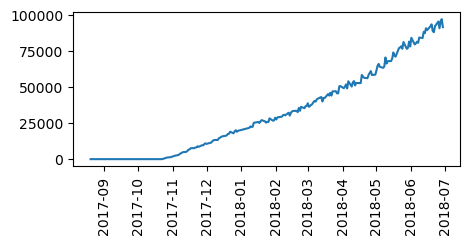

DBSF6318 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


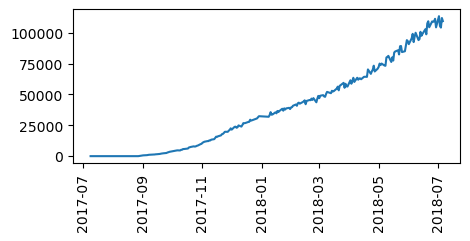

DBSF6441 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


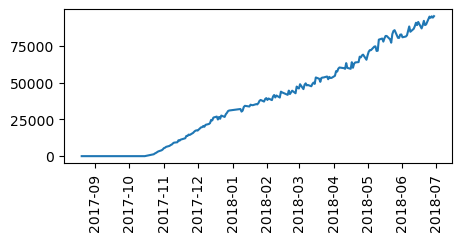

DBSF6473 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


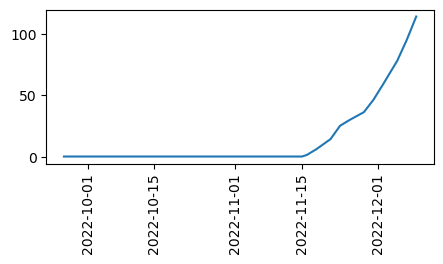

DBSF6497 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


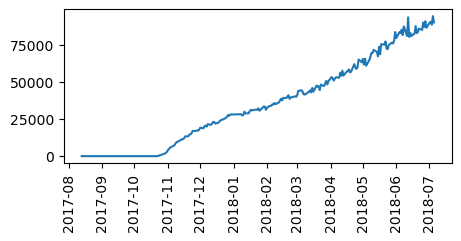

DBSF6502 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


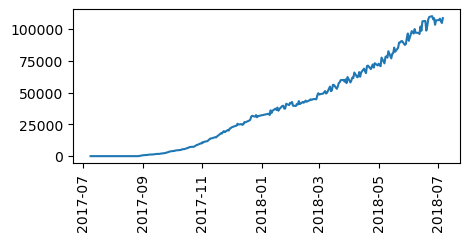

DBSF6503 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


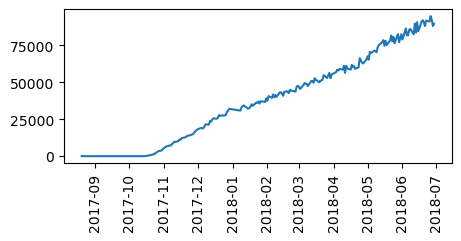

DBSF6522 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


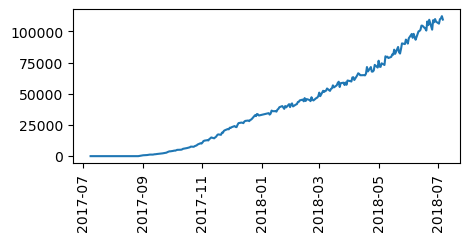

DBSF6576 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


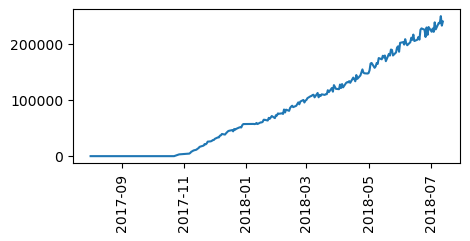

DBSF6618 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


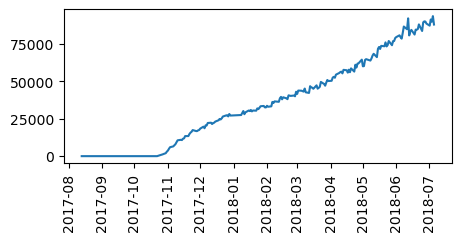

DBSF6619 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


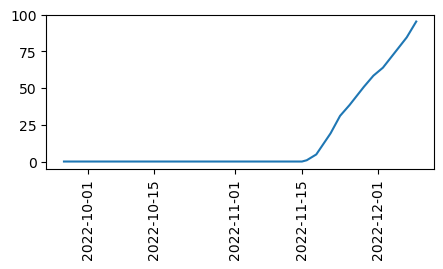

DBSF6641 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


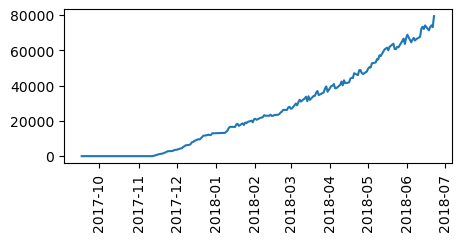

DBSF6690 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


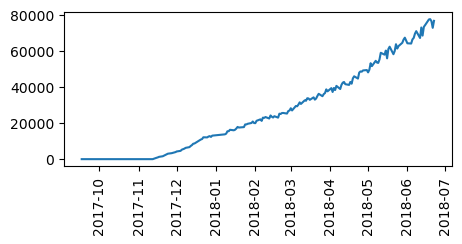

DBSF6699 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


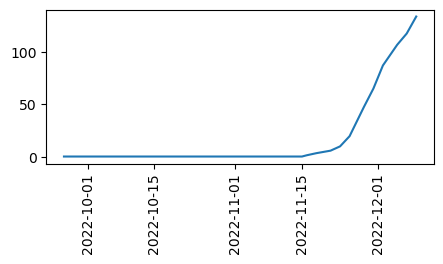

DBSF6771 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


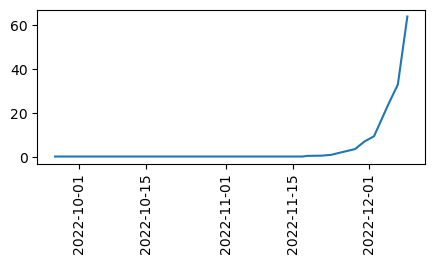

DBSF6806 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


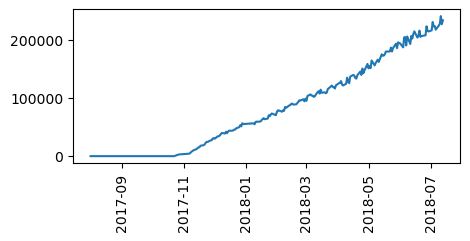

DBSF6817 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


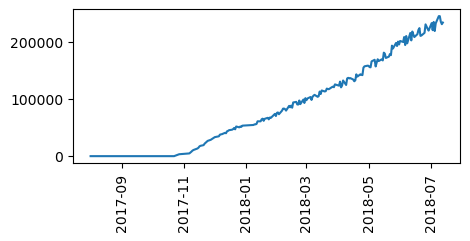

DBSF6833 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


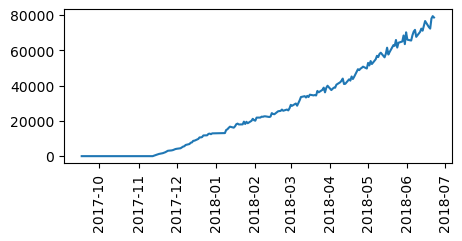

DBSF6892 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


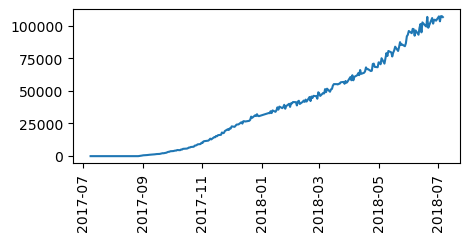

DBSF6914 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


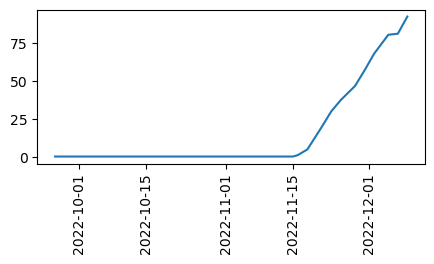

DBSF6949 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


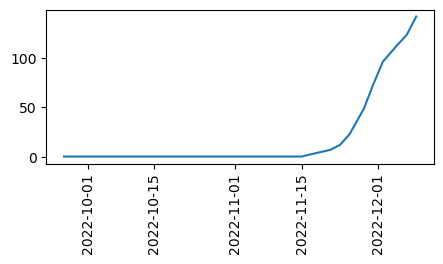

DBSF6979 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


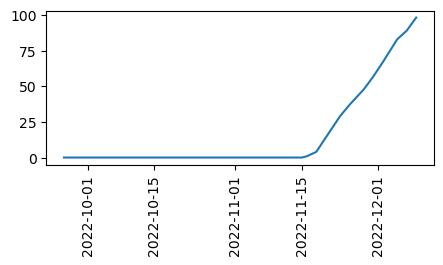

DBSF6990 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


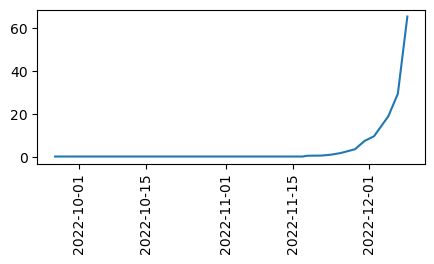

DBSF7114 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


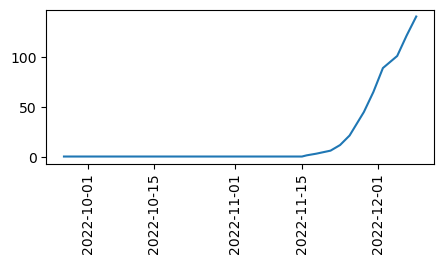

DBSF7130 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


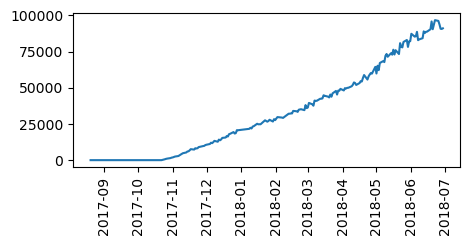

DBSF7151 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


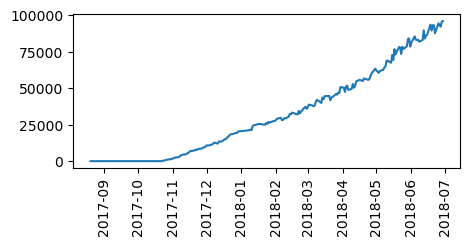

DBSF7185 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


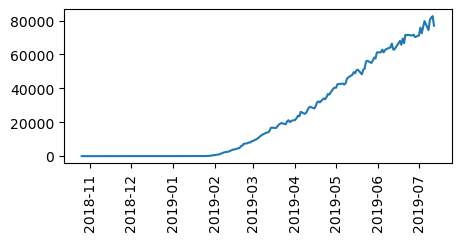

DBSF7186 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


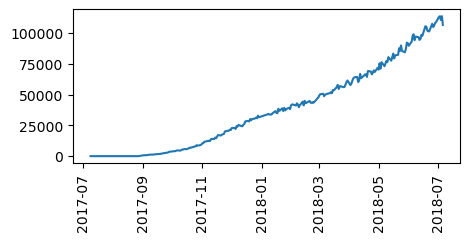

DBSF7195 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


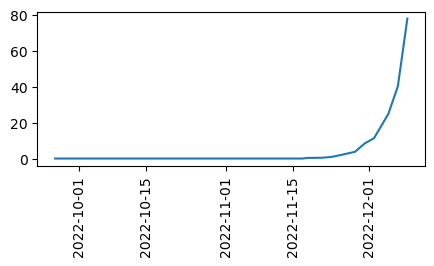

DBSF7198 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


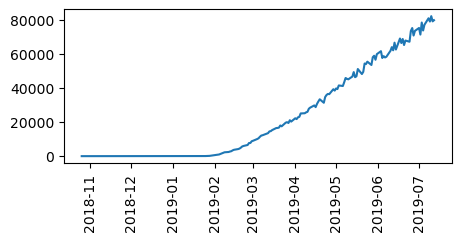

DBSF7221 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


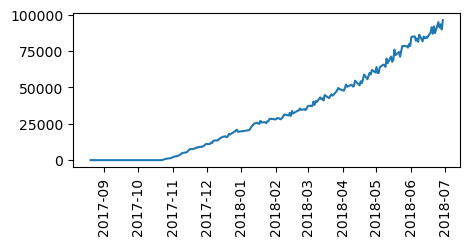

DBSF7294 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


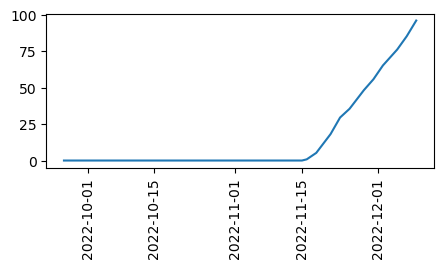

DBSF7339 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


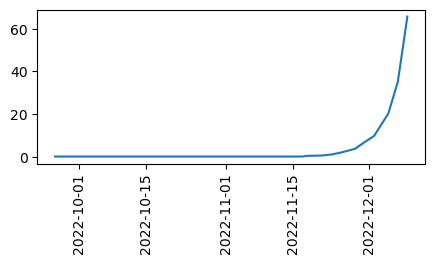

DBSF7419 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


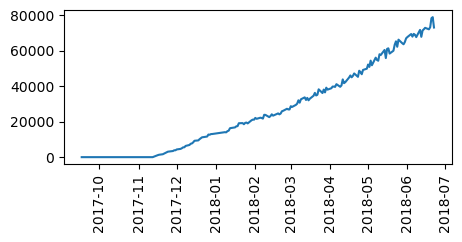

DBSF7476 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


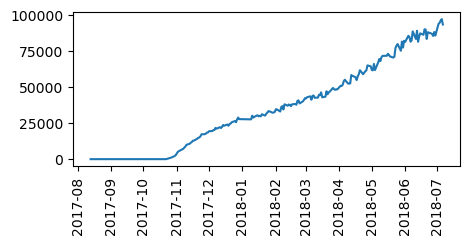

DBSF7477 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


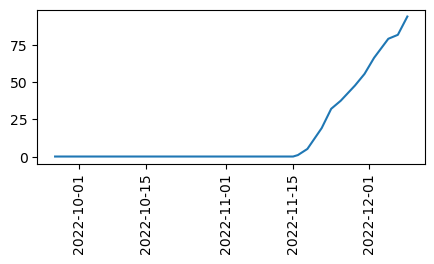

DBSF7548 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


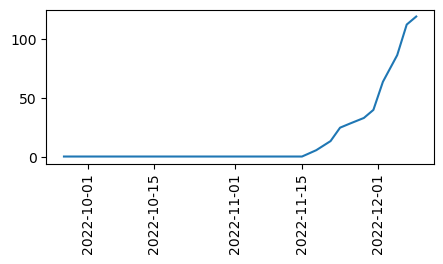

DBSF7633 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


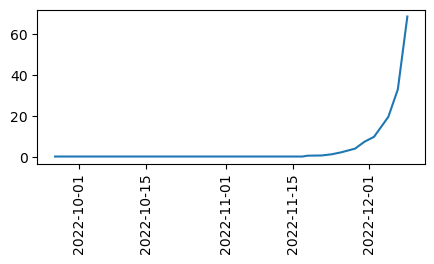

DBSF7641 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


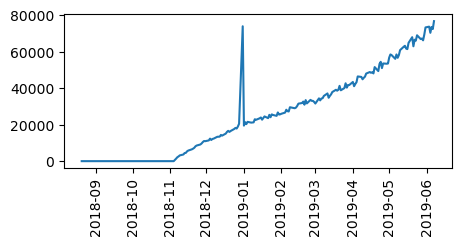

DBSF7654 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


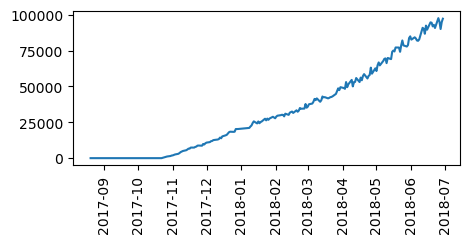

DBSF7666 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


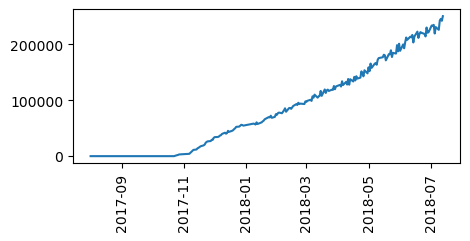

DBSF7673 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


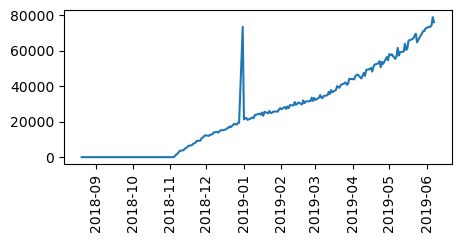

DBSF7679 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


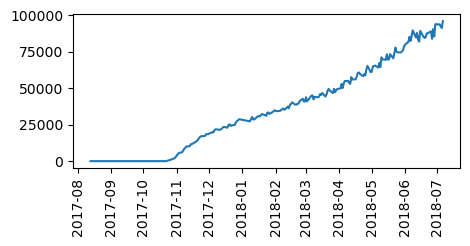

DBSF7692 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


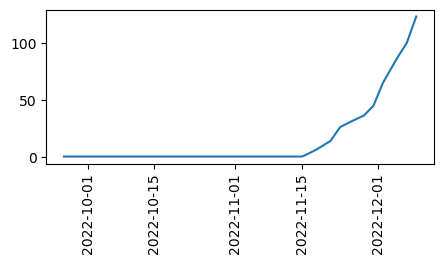

DBSF7705 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


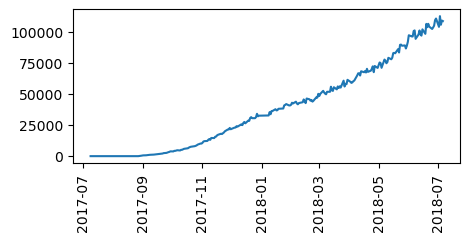

DBSF7717 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


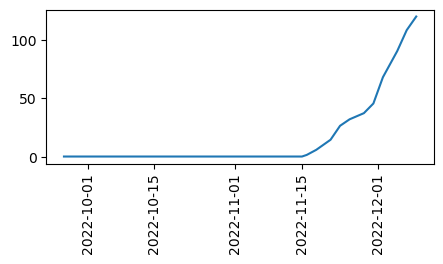

DBSF7722 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


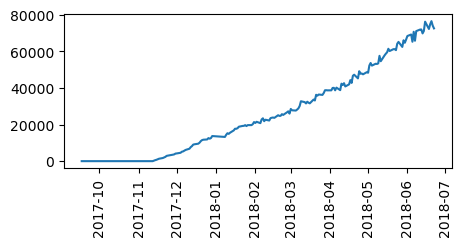

DBSF7740 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


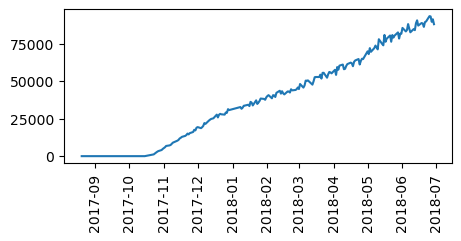

DBSF7828 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


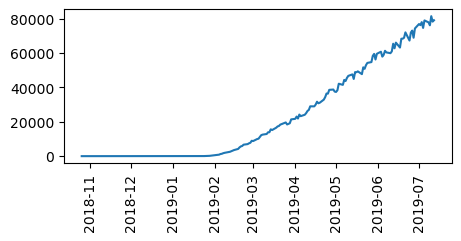

DBSF7863 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


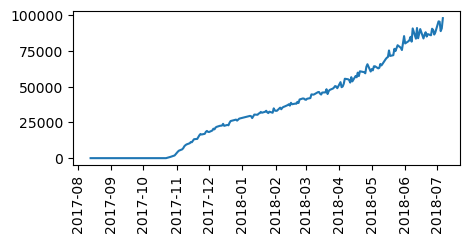

DBSF7882 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


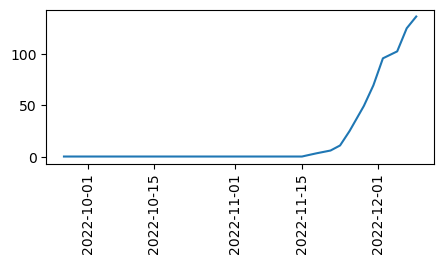

DBSF7897 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


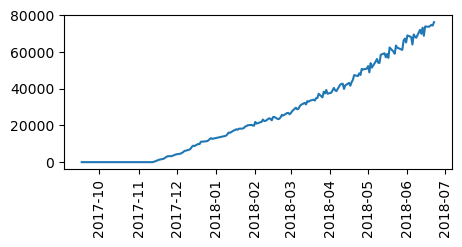

DBSF7898 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


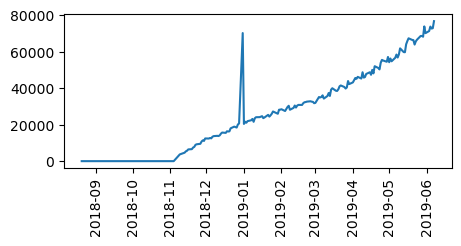

DBSF8040 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


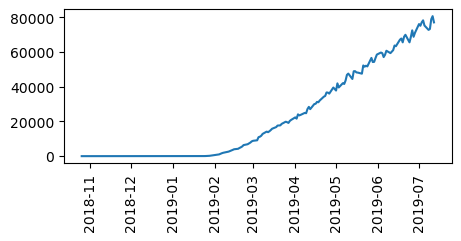

DBSF8047 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


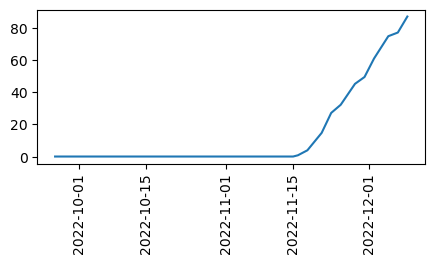

DBSF8065 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


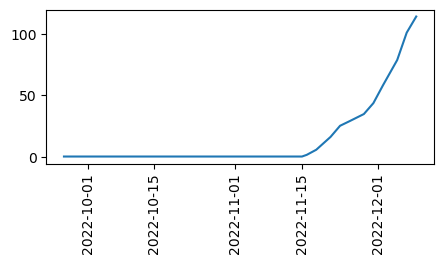

DBSF8072 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


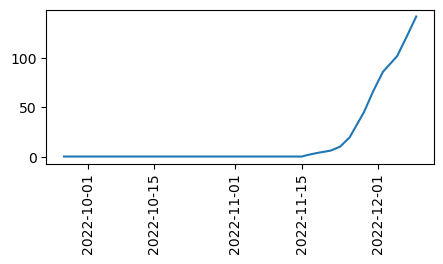

DBSF8083 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


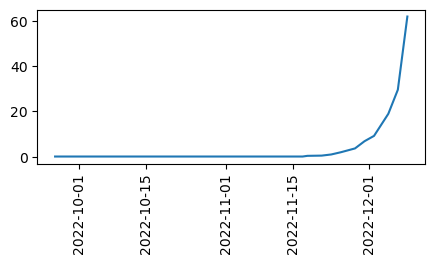

DBSF8124 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


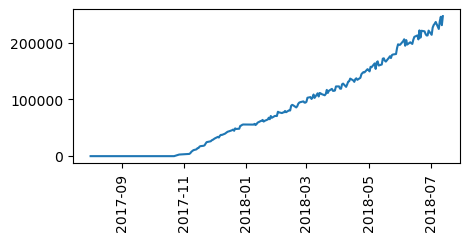

DBSF8175 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


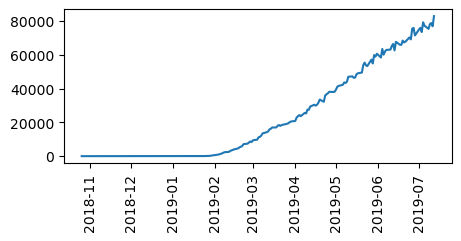

DBSF8195 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


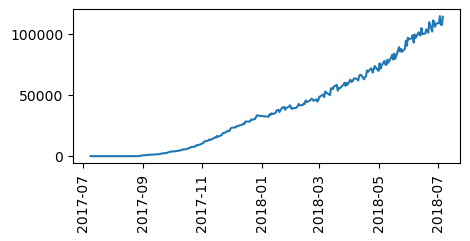

DBSF8205 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


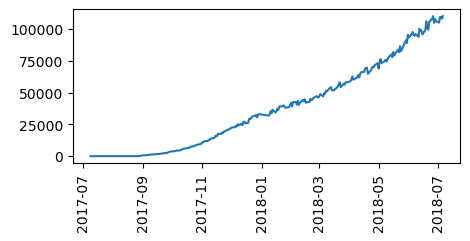

DBSF8221 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


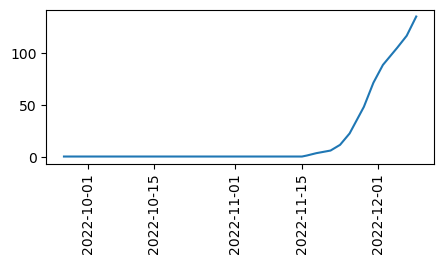

DBSF8230 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


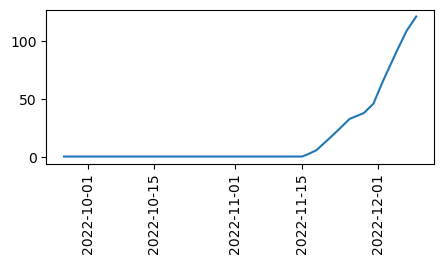

DBSF8242 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


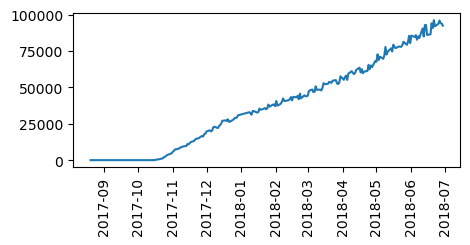

DBSF8258 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


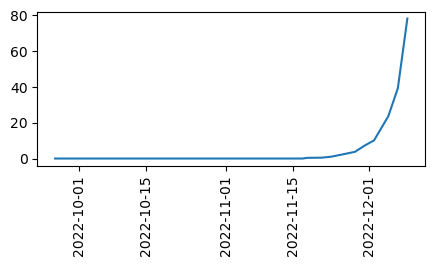

DBSF8285 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


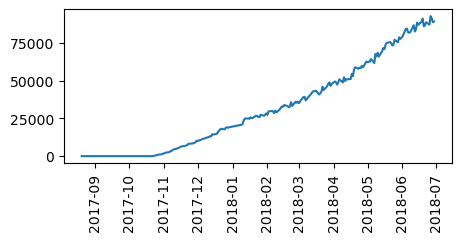

DBSF8293 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


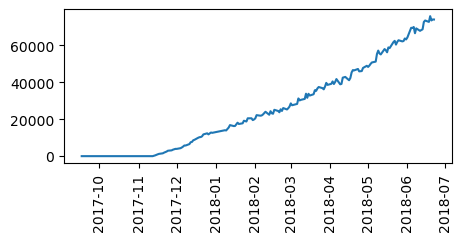

DBSF8318 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


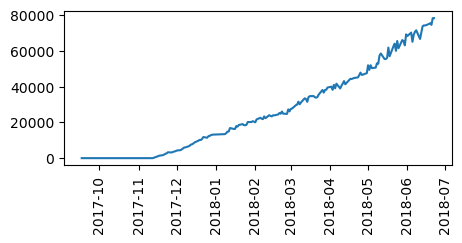

DBSF8381 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


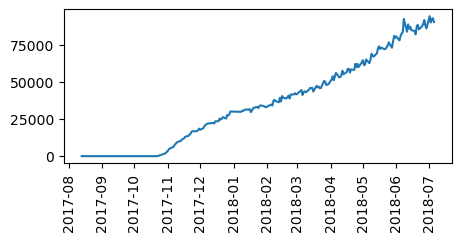

DBSF8383 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


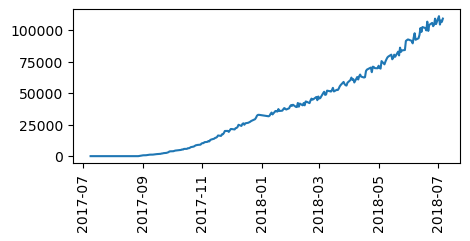

DBSF8405 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


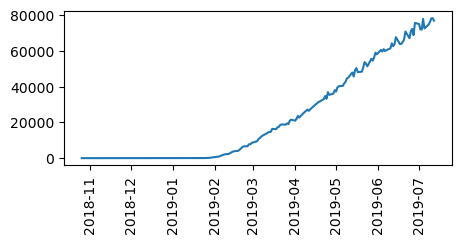

DBSF8411 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


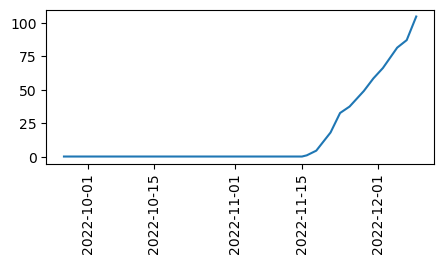

DBSF8440 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


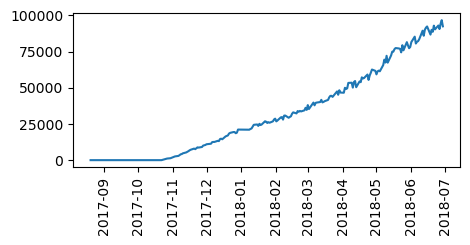

DBSF8457 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


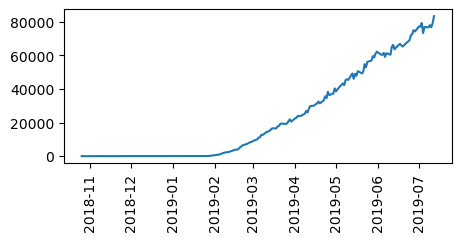

DBSF8462 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


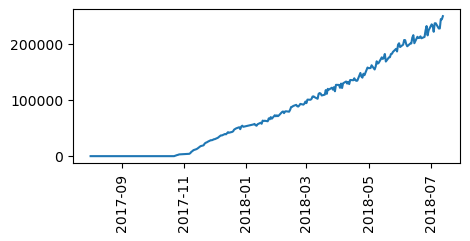

DBSF8492 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


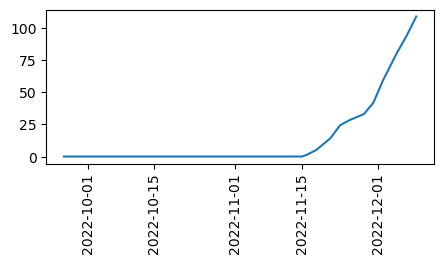

DBSF8512 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


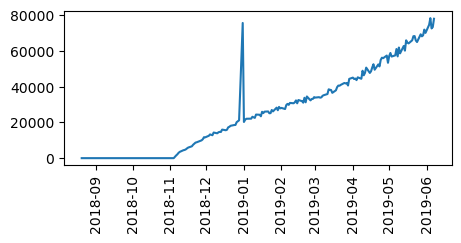

DBSF8533 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


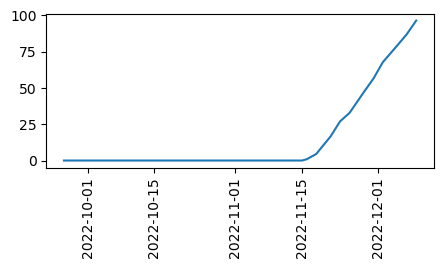

DBSF8545 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


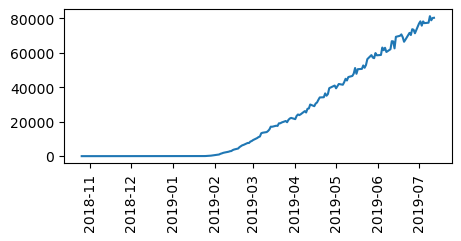

DBSF8557 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


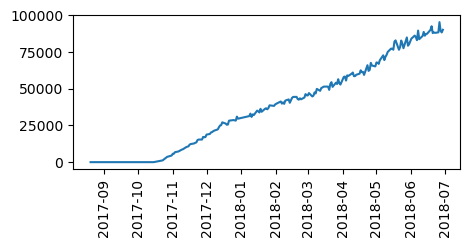

DBSF8573 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


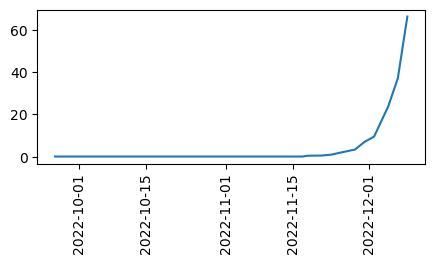

DBSF8588 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


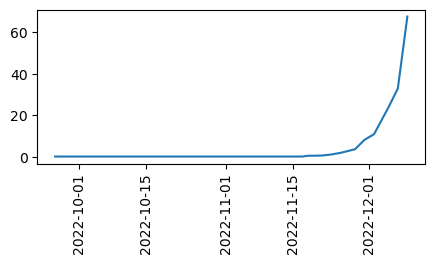

DBSF8590 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


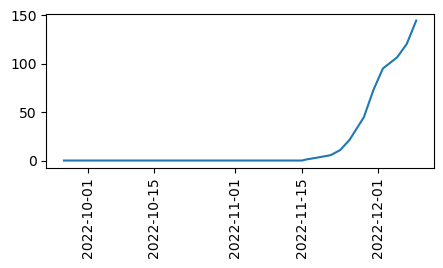

DBSF8665 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


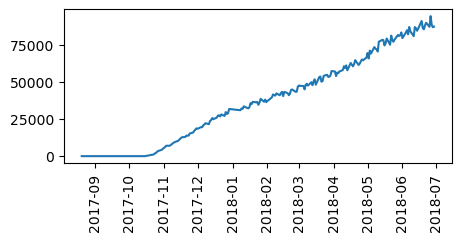

DBSF8670 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


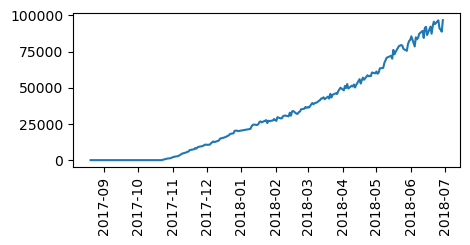

DBSF8704 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


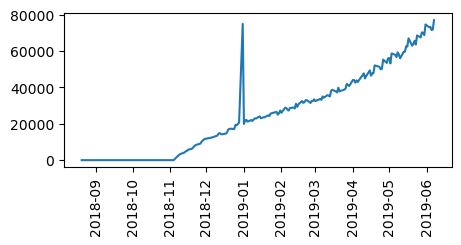

DBSF8721 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


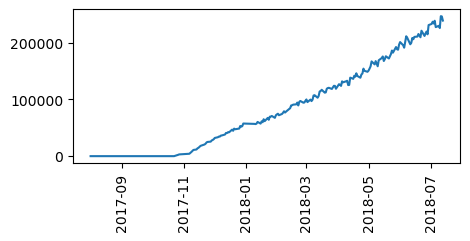

DBSF8764 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


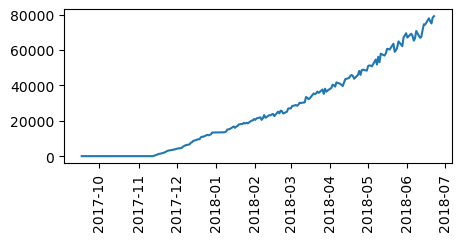

DBSF8793 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


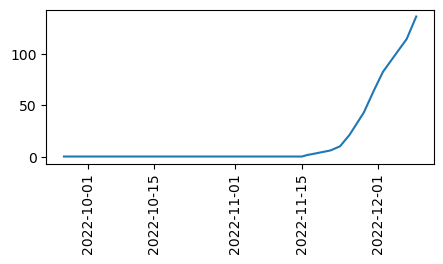

DBSF8830 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


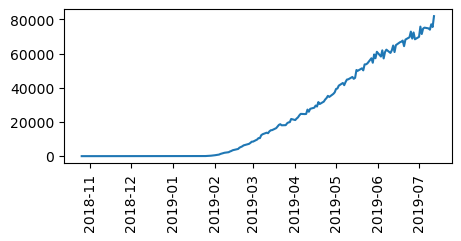

DBSF8906 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


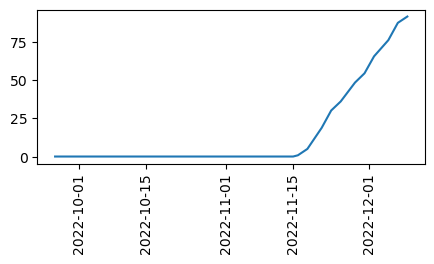

DBSF8924 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


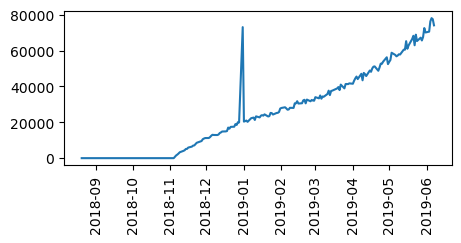

DBSF8958 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


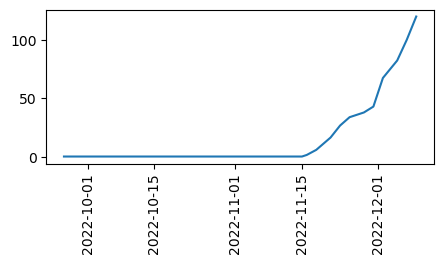

DBSF8966 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


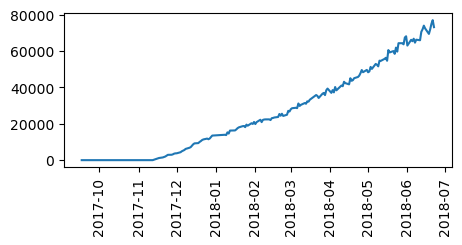

DBSF9076 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


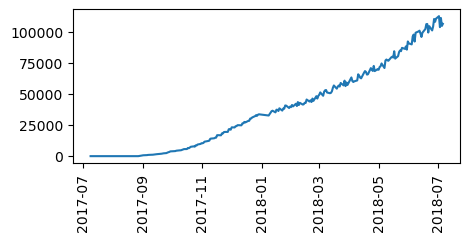

DBSF9088 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


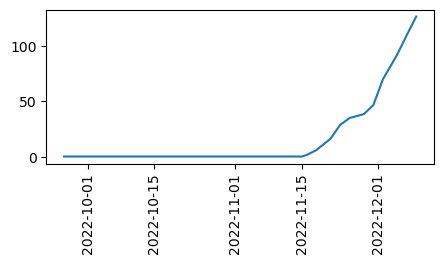

DBSF9161 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


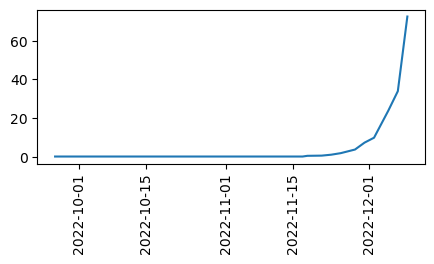

DBSF9172 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


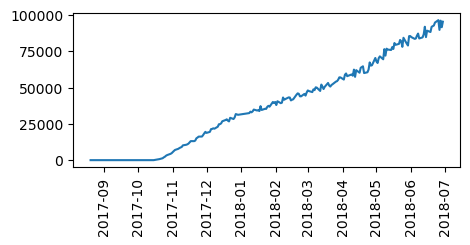

DBSF9184 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


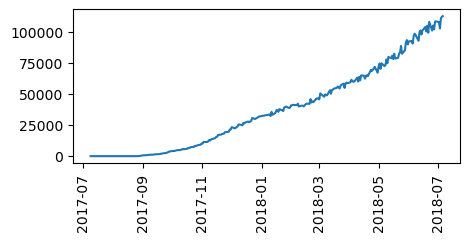

DBSF9221 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


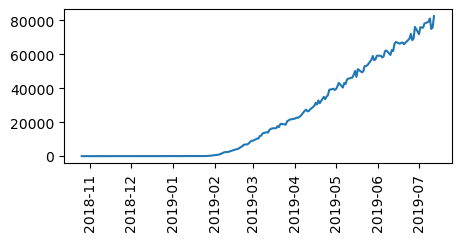

DBSF9223 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


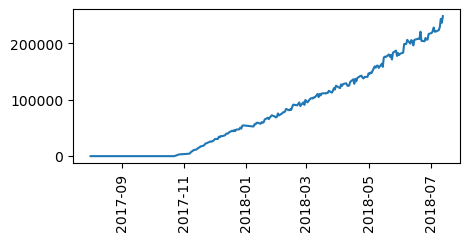

DBSF9229 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


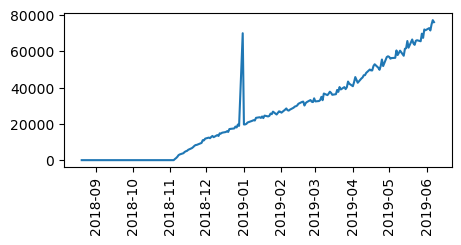

DBSF9275 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


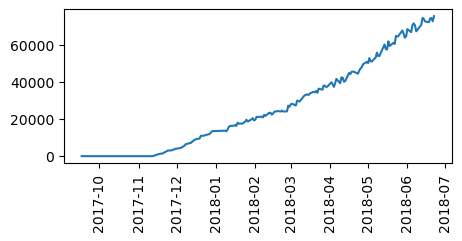

DBSF9369 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


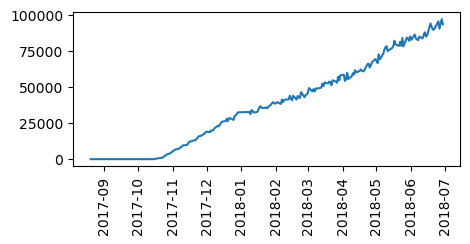

DBSF9377 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


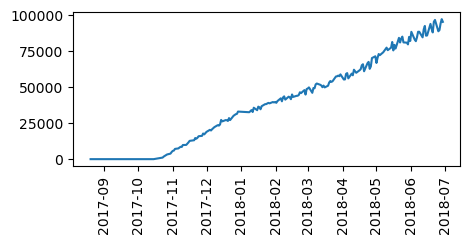

DBSF9378 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


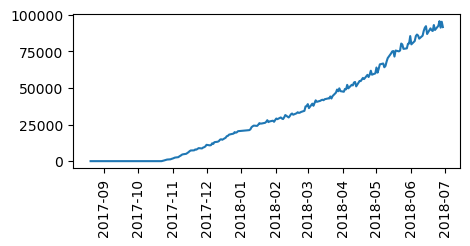

DBSF9391 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


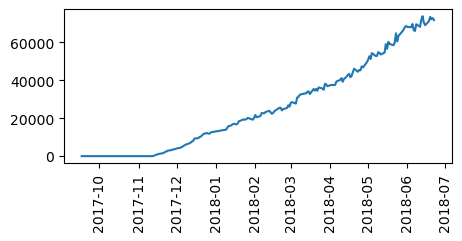

DBSF9404 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


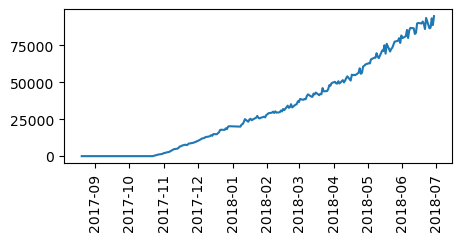

DBSF9406 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


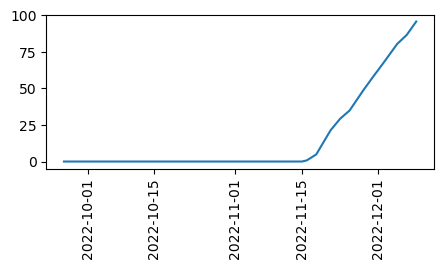

DBSF9498 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


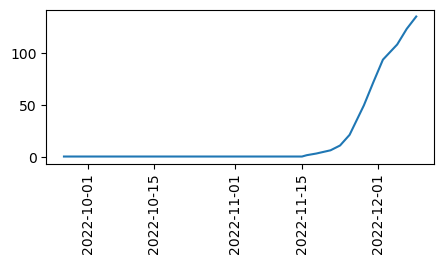

DBSF9546 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


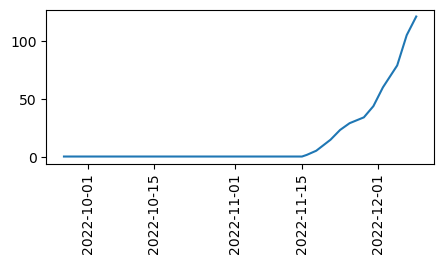

DBSF9627 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


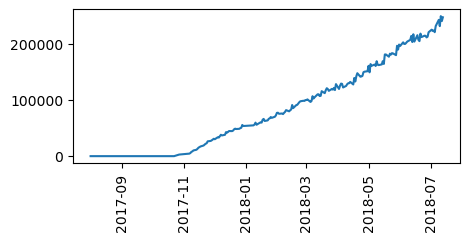

DBSF9631 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


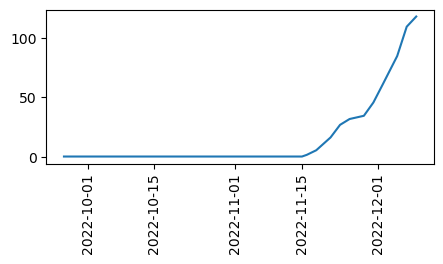

DBSF9675 / Date: 2017-08-13 00:00:00 2018-07-06 00:00:00


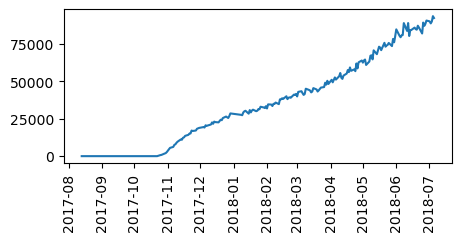

DBSF9688 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


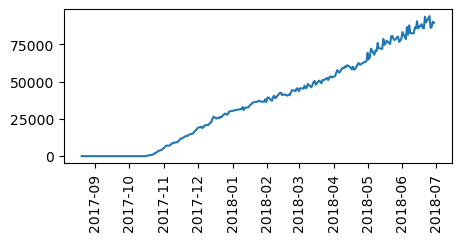

DBSF9741 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


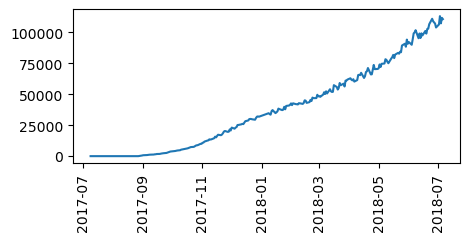

DBSF9746 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


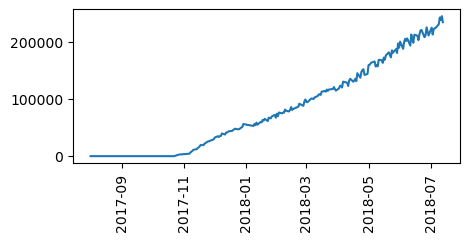

DBSF9761 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


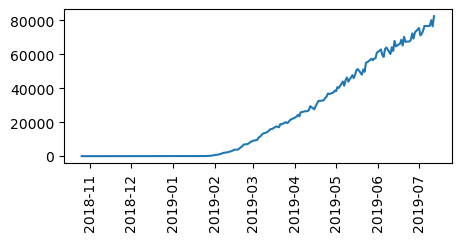

DBSF9777 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


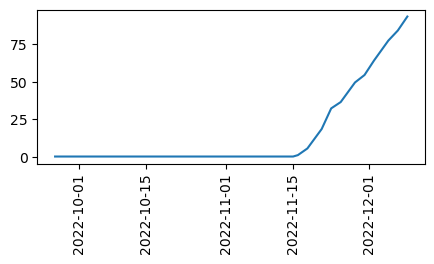

DBSF9793 / Date: 2017-08-20 00:00:00 2018-06-29 00:00:00


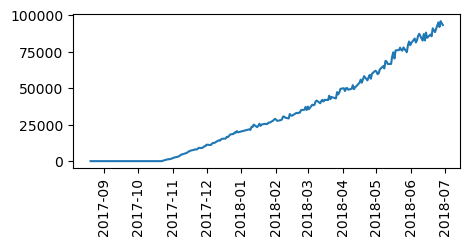

DBSF9838 / Date: 2018-10-26 00:00:00 2019-07-12 00:00:00


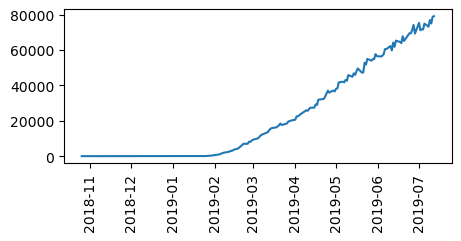

DBSF9894 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


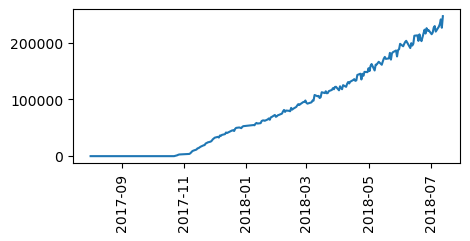

DBSF9922 / Date: 2018-08-20 00:00:00 2019-06-07 00:00:00


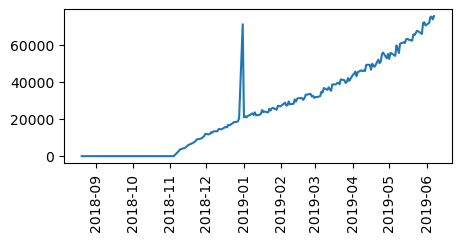

DBSF9942 / Date: 2017-09-17 00:00:00 2018-06-22 00:00:00


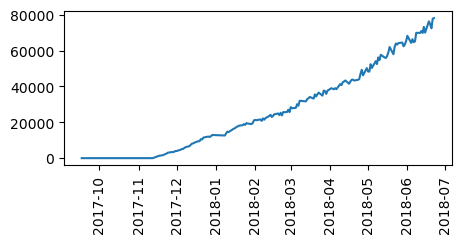

DBSF9948 / Date: 2022-09-26 00:00:00 2022-12-09 00:00:00


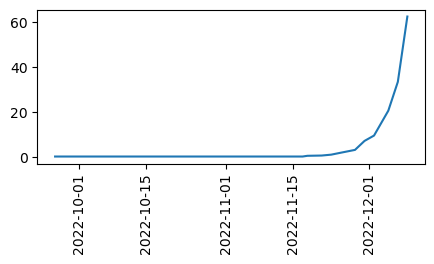

DBSF9961 / Date: 2017-07-09 00:00:00 2018-07-06 00:00:00


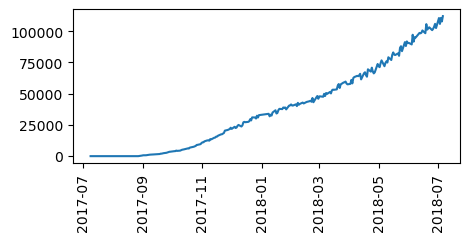

DBSF9969 / Date: 2017-08-01 00:00:00 2018-07-13 00:00:00


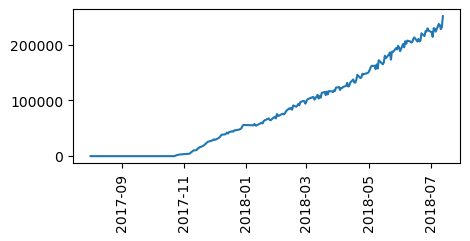

In [253]:
tmp_df2 = tmp_df[~((tmp_df["outtrn_cumsum"] == 0)&(tmp_df["outtrn_cumsum_new"] != 0))]
for i in tmp_df2.frmDist.unique():
    plt.figure(figsize=[5,2])
    sub_df = tmp_df2[tmp_df2.frmDist==i]
    print(i, "/ Date:", min(sub_df.date), max(sub_df.date))
    plt.plot(sub_df.date, sub_df.outtrn_cumsum)
    plt.xticks(rotation=90)
    plt.show()

DBSF1059 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


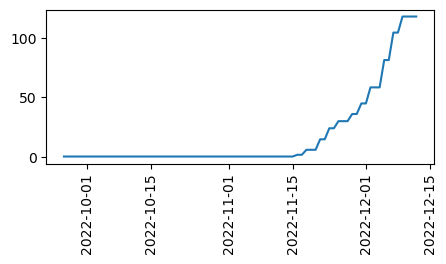

DBSF1093 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


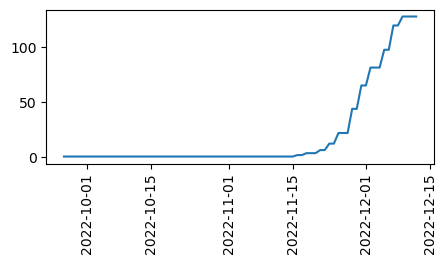

DBSF1121 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


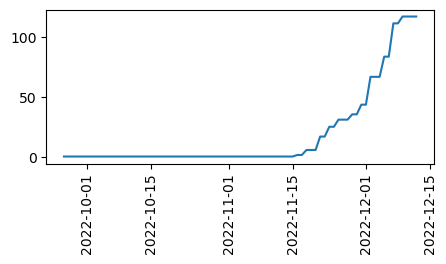

DBSF1172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


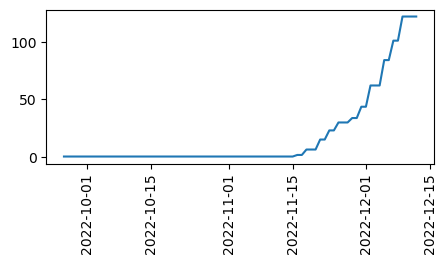

DBSF1180 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


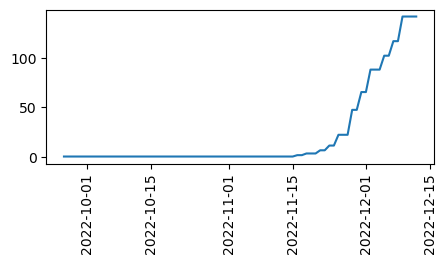

DBSF1186 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


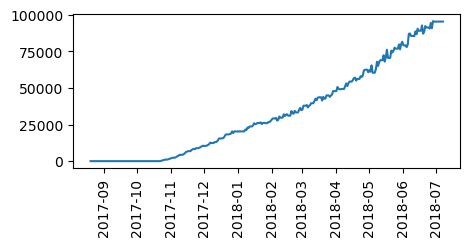

DBSF1205 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


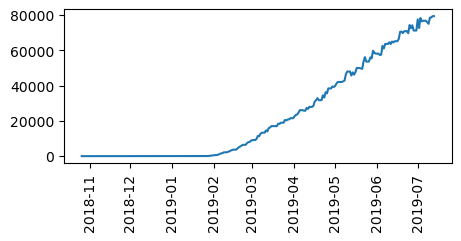

DBSF1215 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


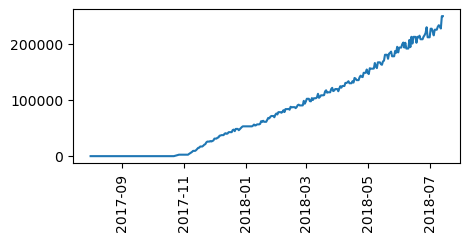

DBSF1218 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


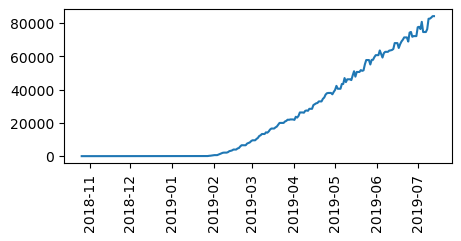

DBSF1232 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


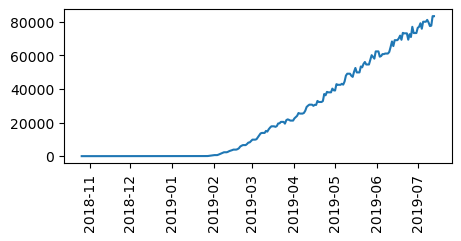

DBSF1279 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


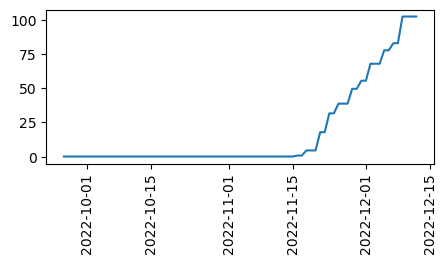

DBSF1294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


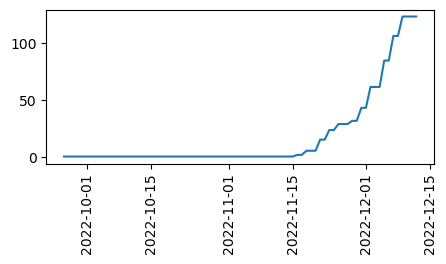

DBSF1385 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


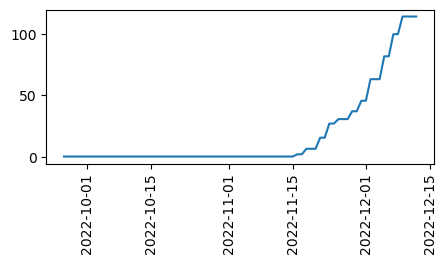

DBSF1386 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


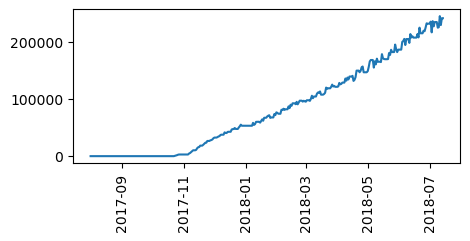

DBSF1459 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


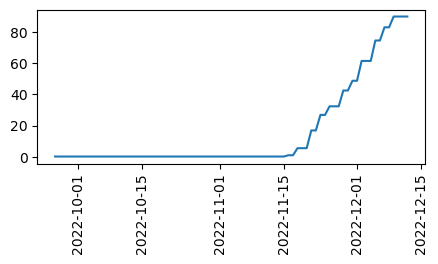

DBSF1466 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


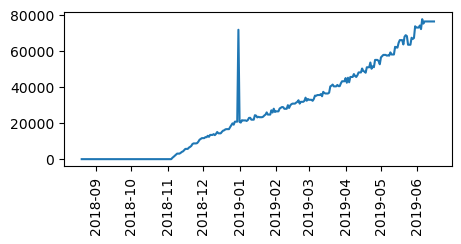

DBSF1469 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


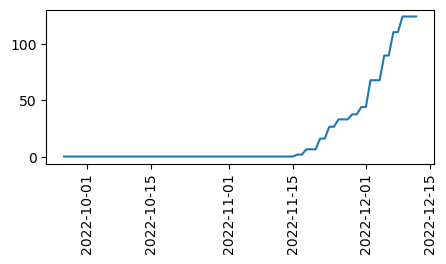

DBSF1490 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


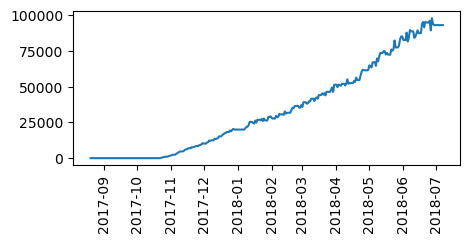

DBSF1505 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


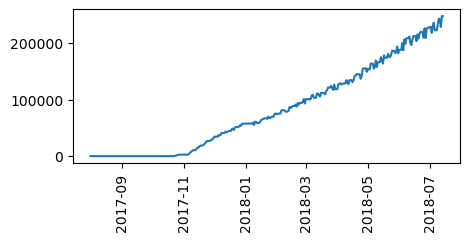

DBSF1507 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


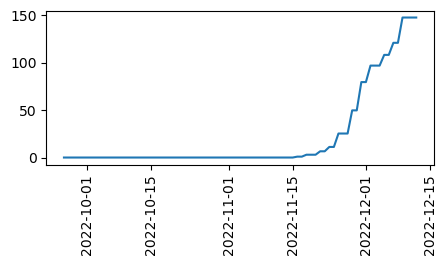

DBSF1539 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


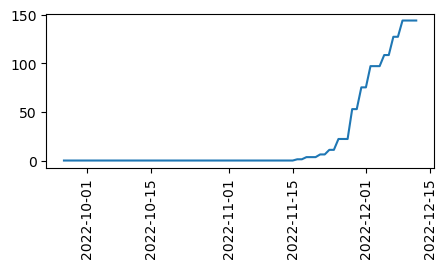

DBSF1554 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


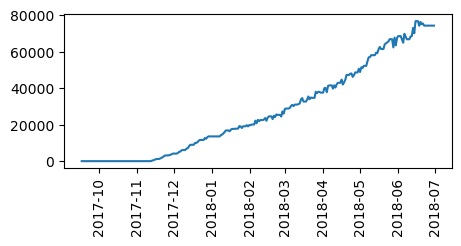

DBSF1601 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


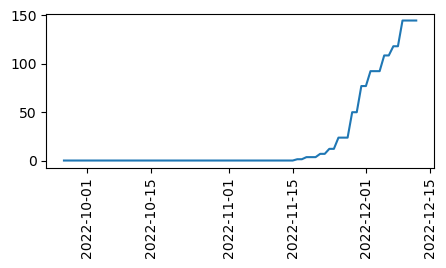

DBSF1621 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


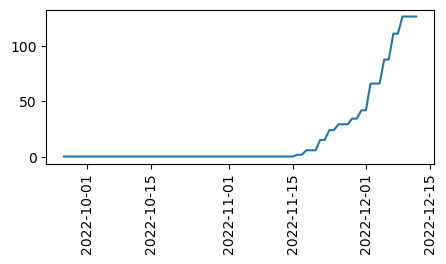

DBSF1644 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


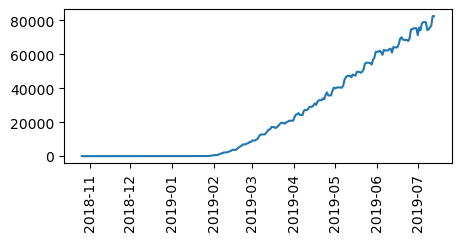

DBSF1645 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


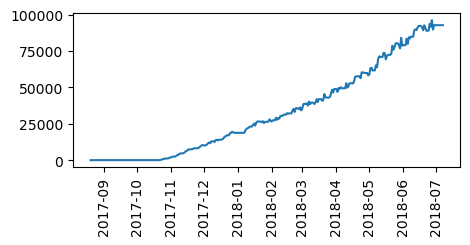

DBSF1673 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


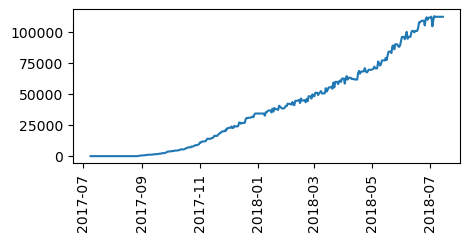

DBSF1757 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


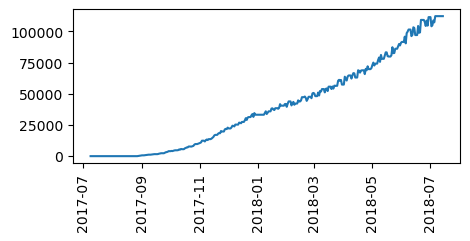

DBSF1767 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


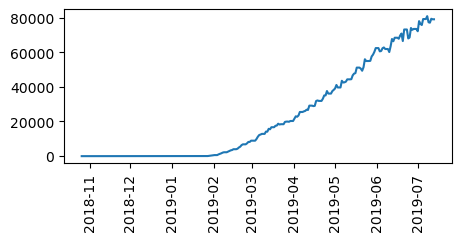

DBSF1871 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


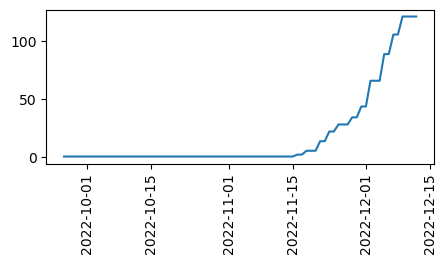

DBSF1873 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


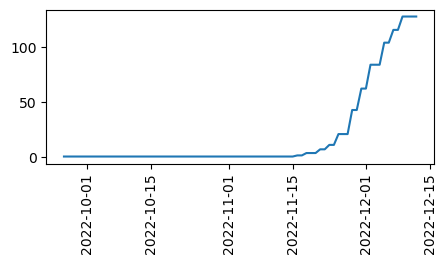

DBSF1880 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


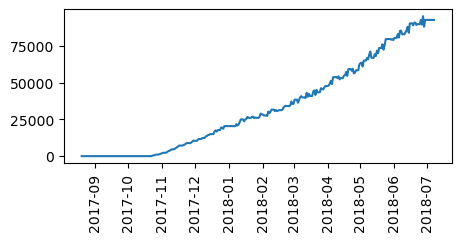

DBSF1886 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


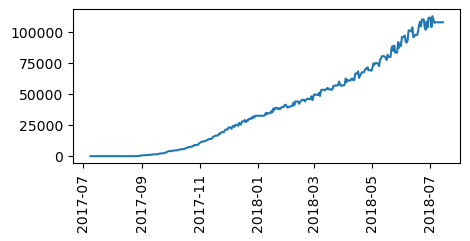

DBSF1916 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


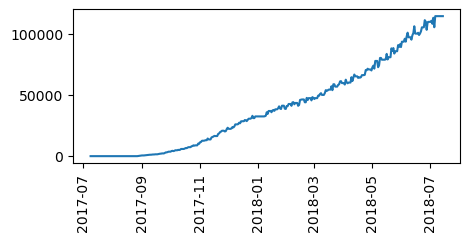

DBSF1921 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


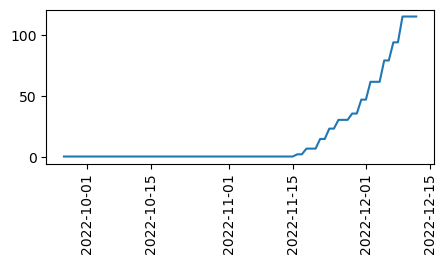

DBSF1934 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


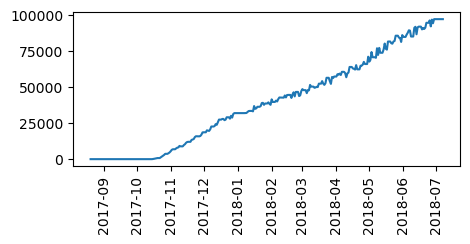

DBSF1974 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


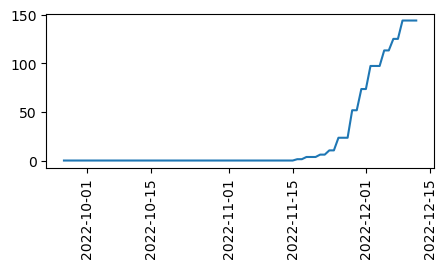

DBSF1975 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


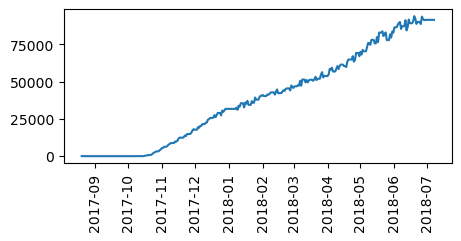

DBSF1991 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


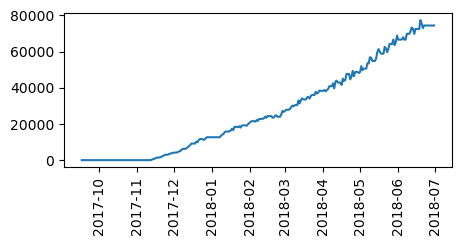

DBSF1998 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


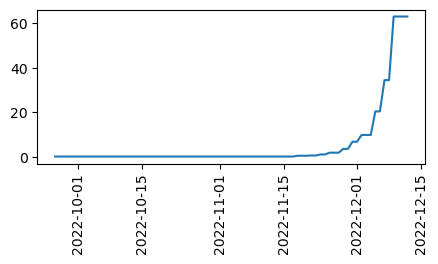

DBSF2008 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


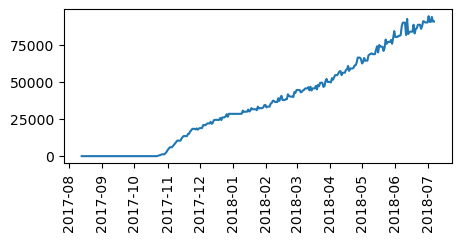

DBSF2027 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


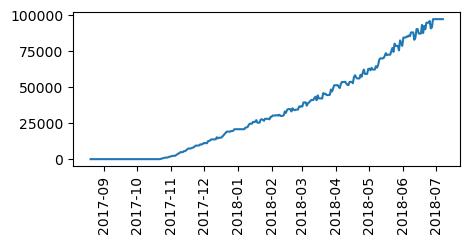

DBSF2032 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


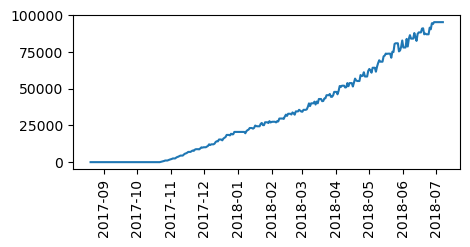

DBSF2044 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


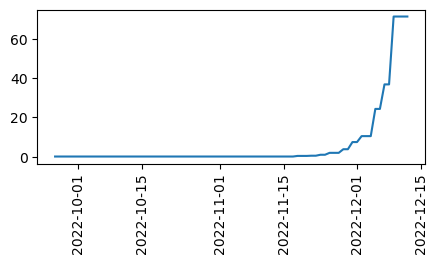

DBSF2117 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


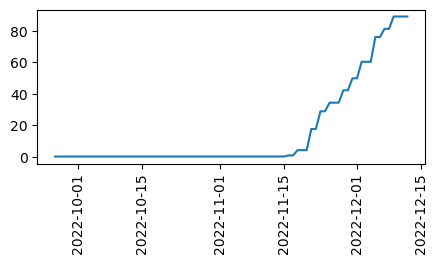

DBSF2191 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


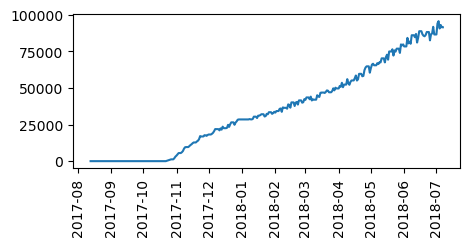

DBSF2212 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


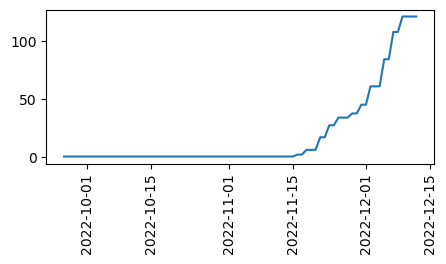

DBSF2218 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


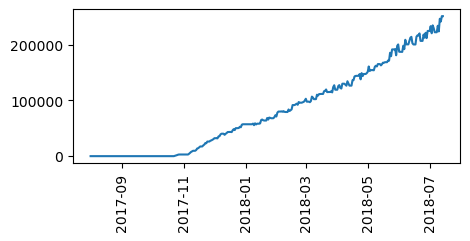

DBSF2244 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


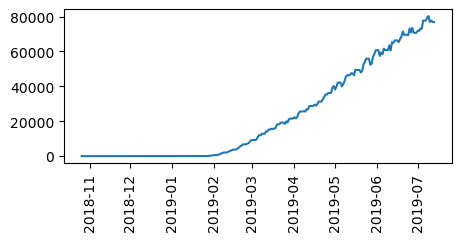

DBSF2252 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


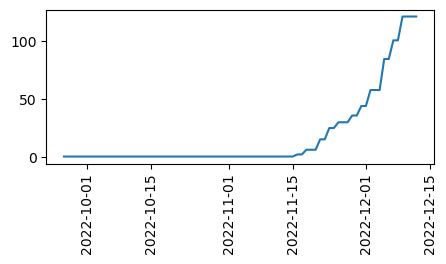

DBSF2256 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


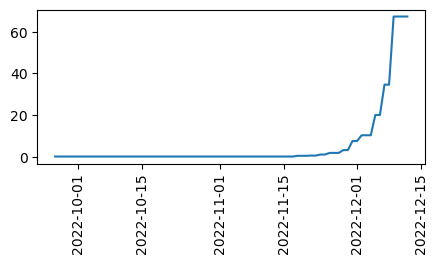

DBSF2259 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


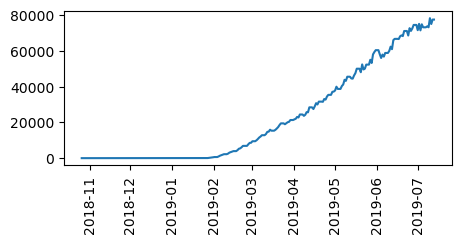

DBSF2274 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


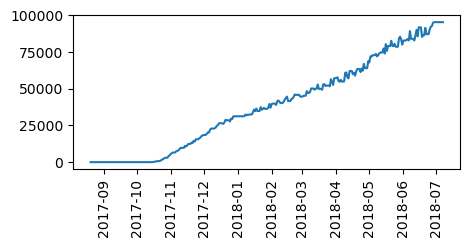

DBSF2318 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


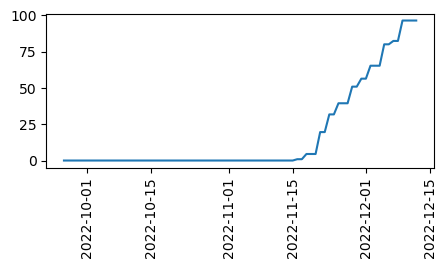

DBSF2319 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


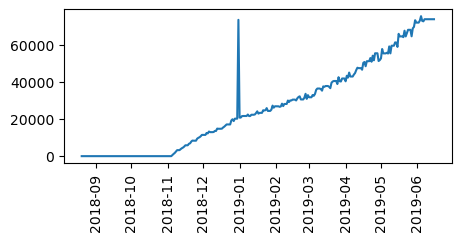

DBSF2334 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


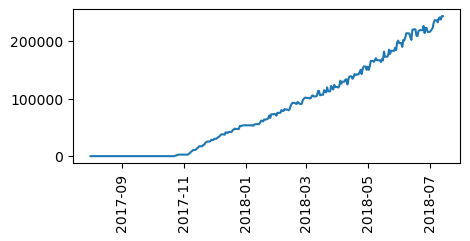

DBSF2335 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


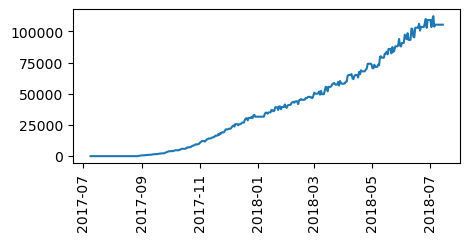

DBSF2347 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


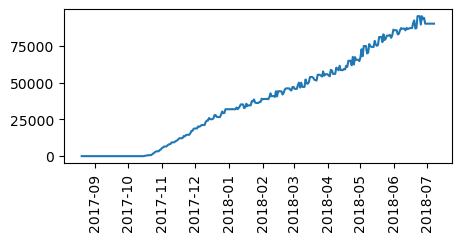

DBSF2352 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


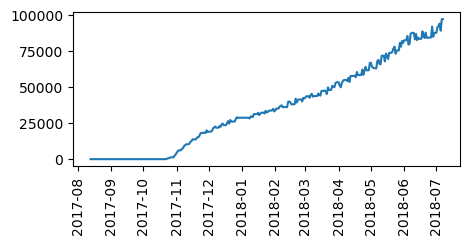

DBSF2360 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


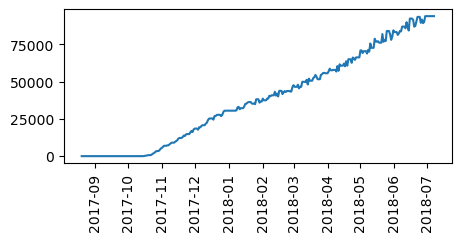

DBSF2371 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


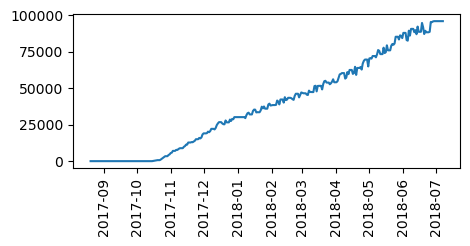

DBSF2376 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


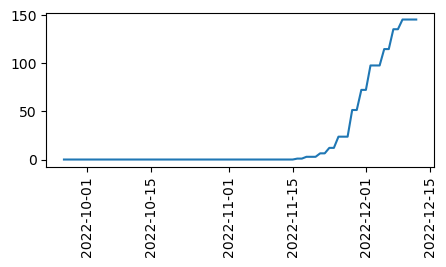

DBSF2378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


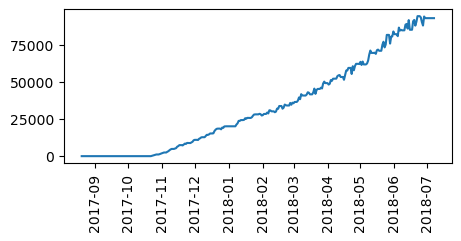

DBSF2389 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


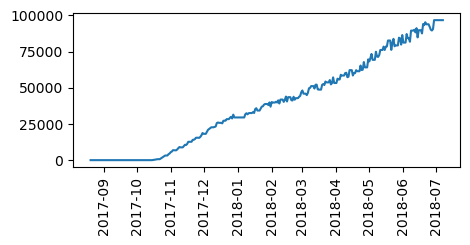

DBSF2413 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


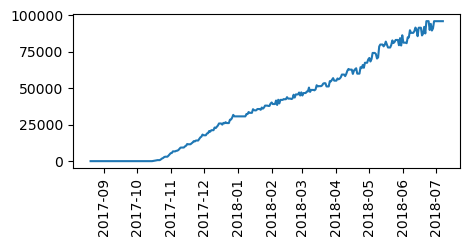

DBSF2422 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


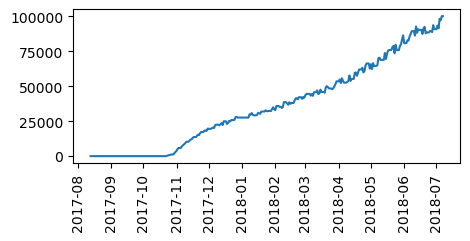

DBSF2471 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


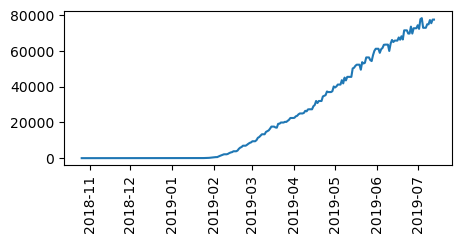

DBSF2525 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


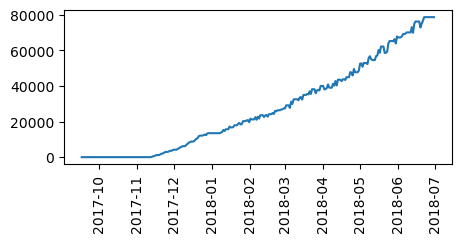

DBSF2571 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


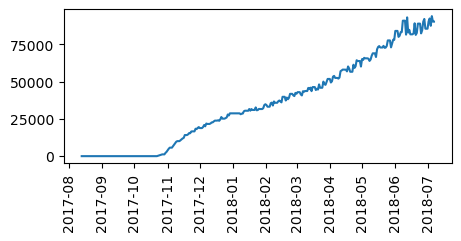

DBSF2630 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


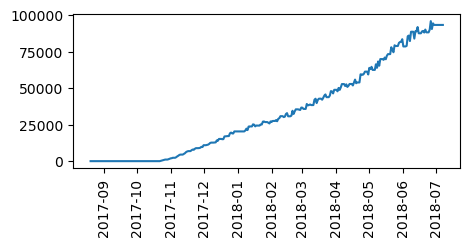

DBSF2640 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


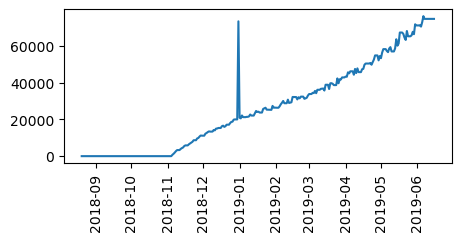

DBSF2681 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


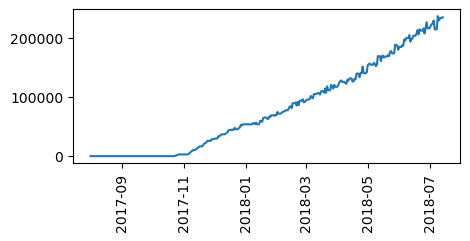

DBSF2686 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


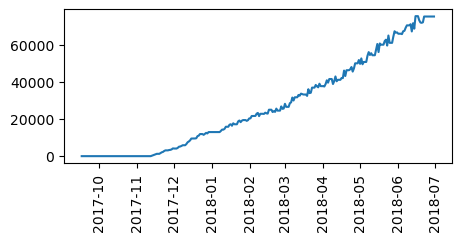

DBSF2689 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


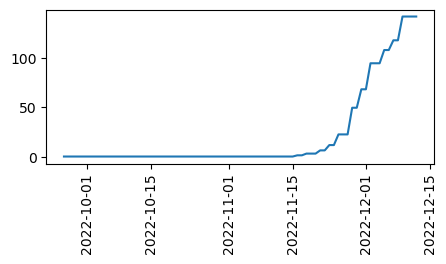

DBSF2708 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


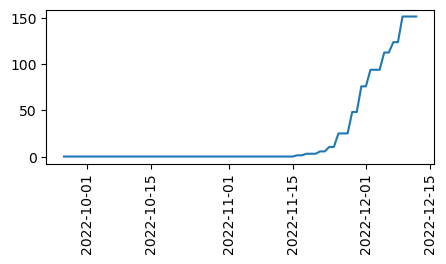

DBSF2752 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


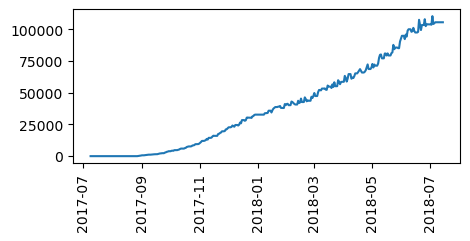

DBSF2803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


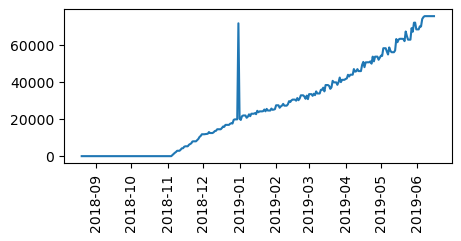

DBSF2809 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


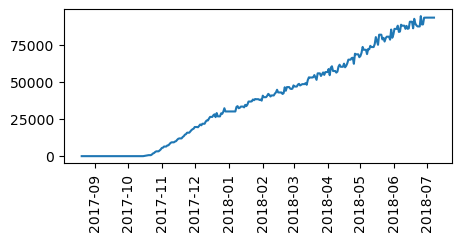

DBSF2822 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


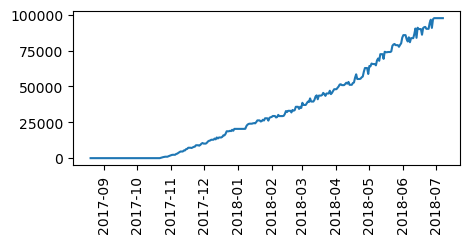

DBSF2823 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


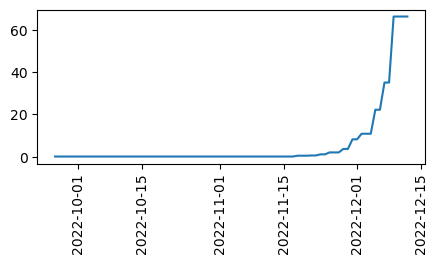

DBSF2828 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


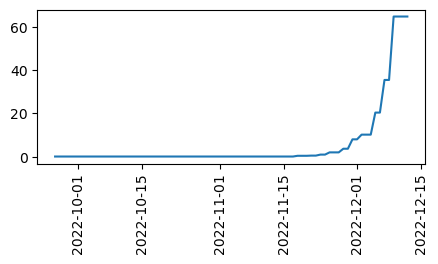

DBSF2832 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


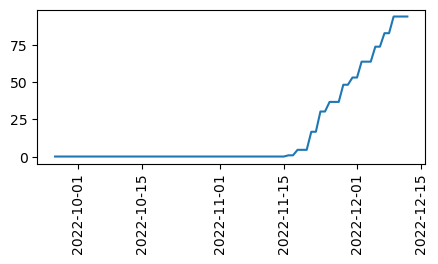

DBSF2846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


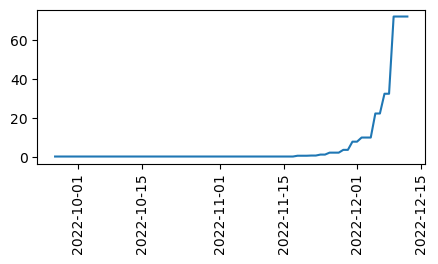

DBSF2888 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


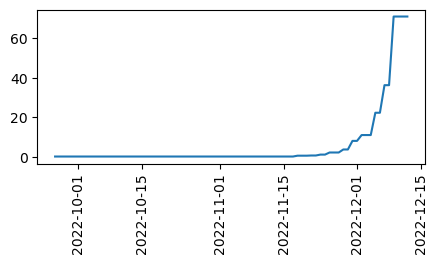

DBSF2911 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


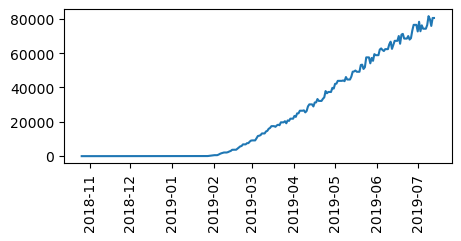

DBSF2918 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


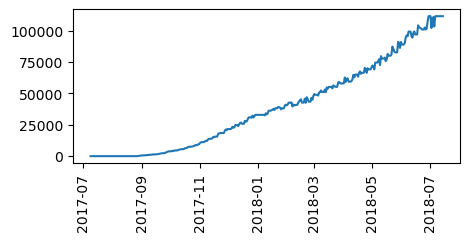

DBSF2927 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


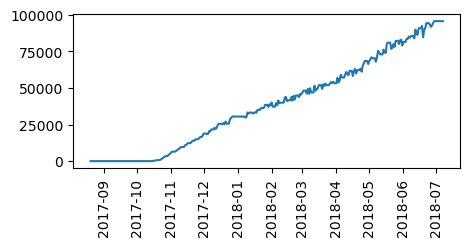

DBSF2989 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


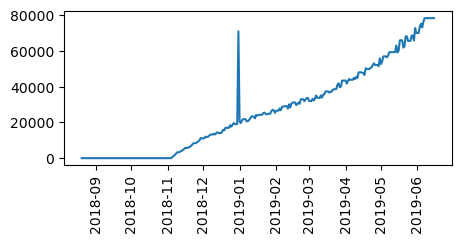

DBSF2992 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


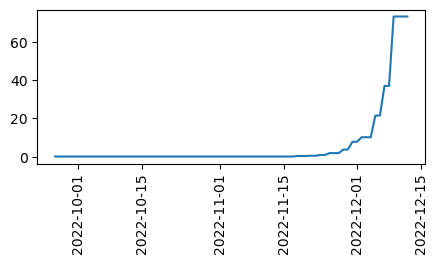

DBSF3001 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


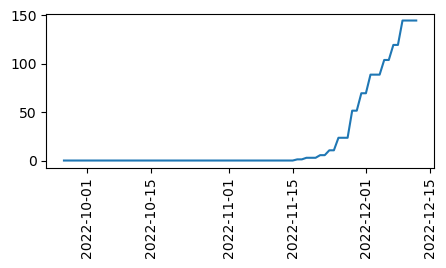

DBSF3010 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


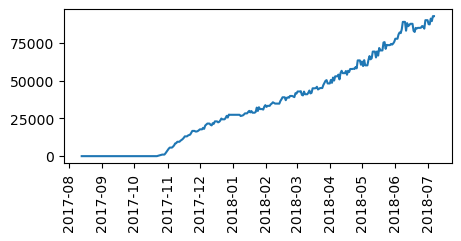

DBSF3034 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


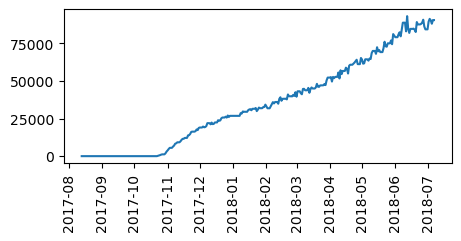

DBSF3067 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


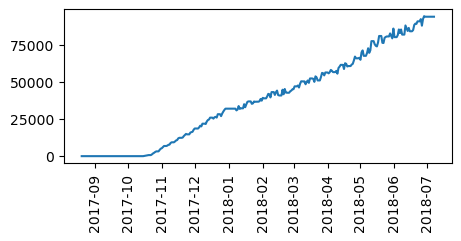

DBSF3068 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


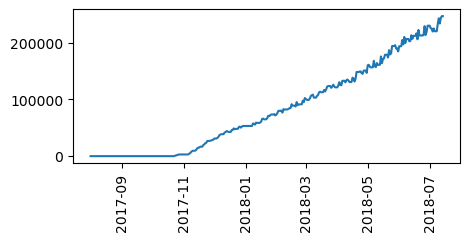

DBSF3075 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


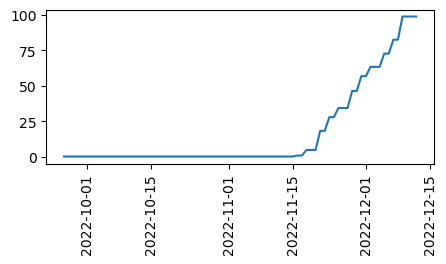

DBSF3076 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


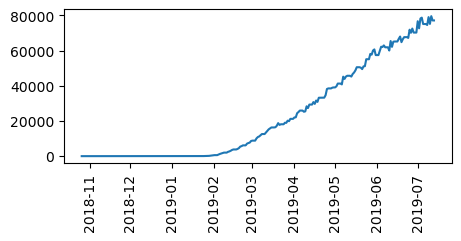

DBSF3118 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


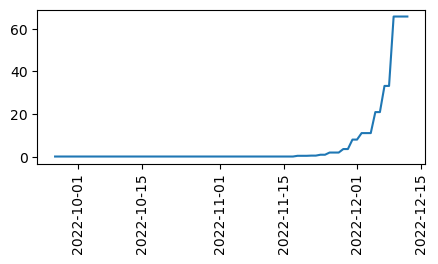

DBSF3132 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


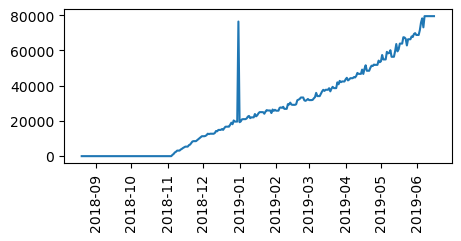

DBSF3135 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


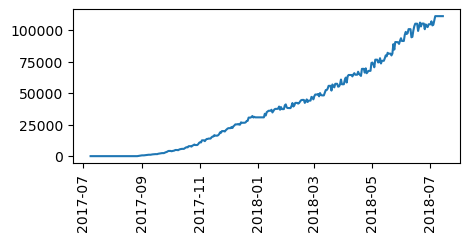

DBSF3165 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


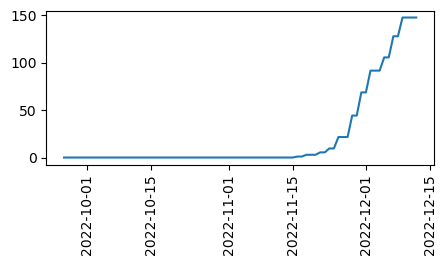

DBSF3172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


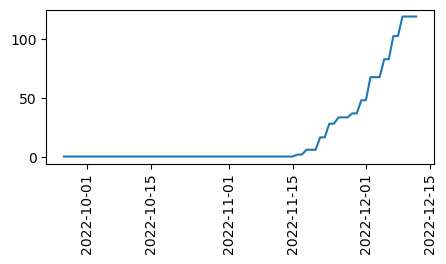

DBSF3199 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


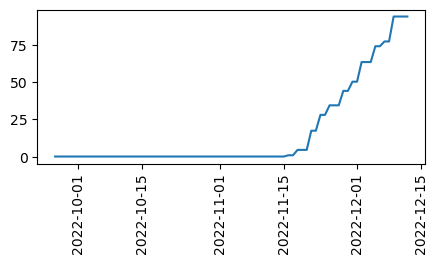

DBSF3205 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


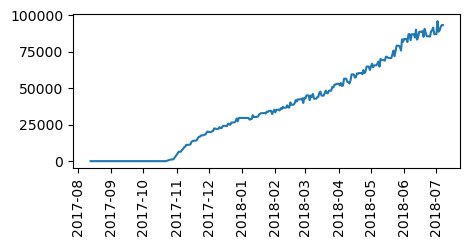

DBSF3214 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


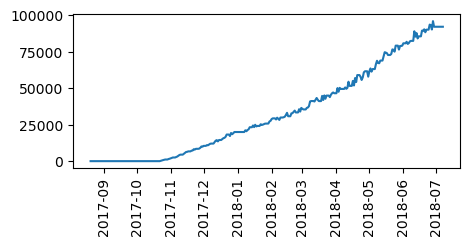

DBSF3228 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


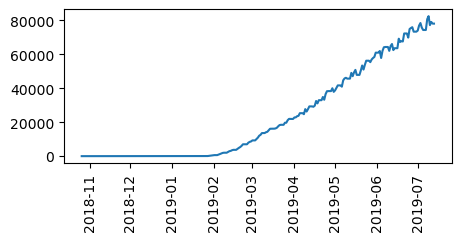

DBSF3311 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


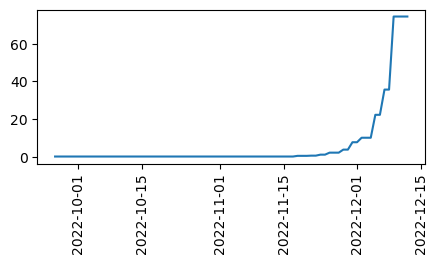

DBSF3367 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


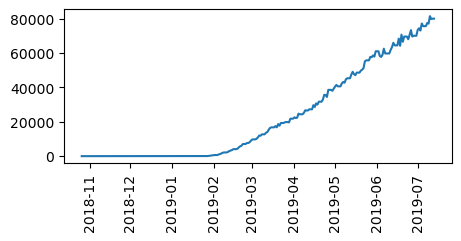

DBSF3372 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


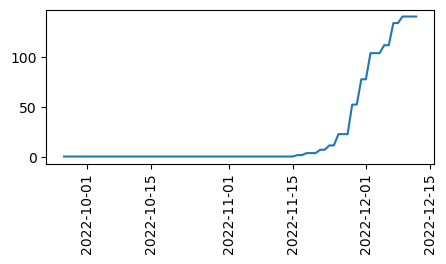

DBSF3383 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


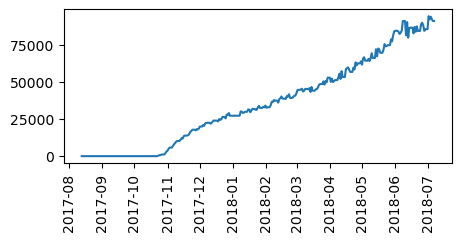

DBSF3399 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


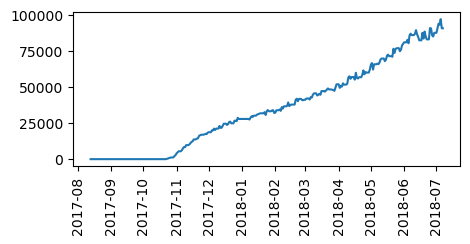

DBSF3425 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


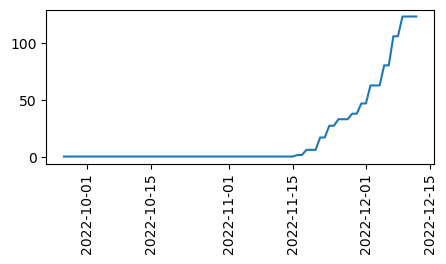

DBSF3426 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


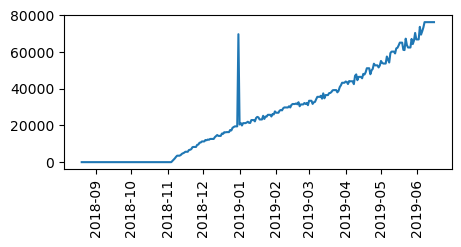

DBSF3467 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


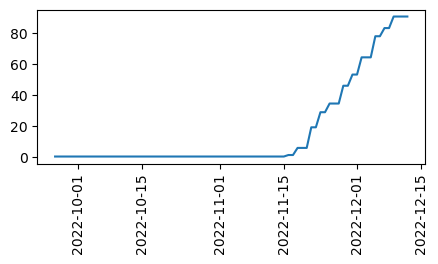

DBSF3470 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


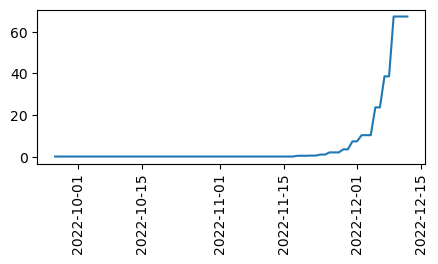

DBSF3490 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


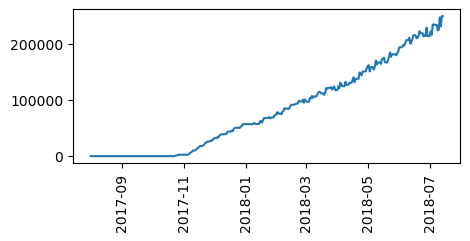

DBSF3527 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


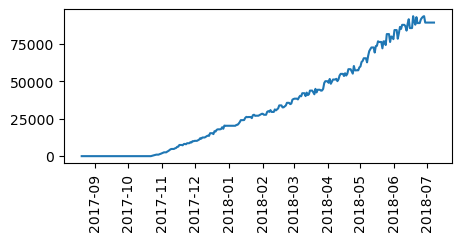

DBSF3532 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


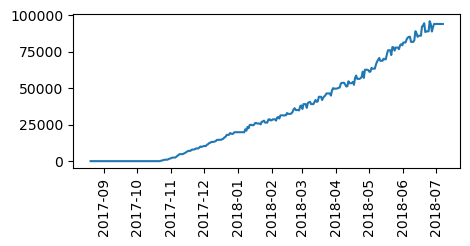

DBSF3546 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


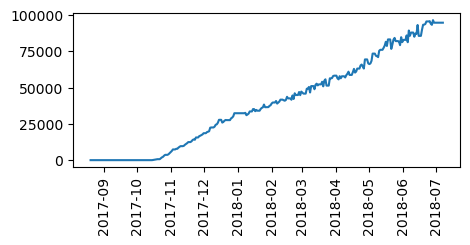

DBSF3567 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


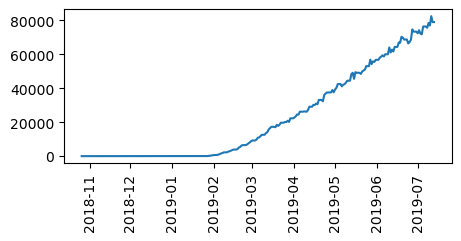

DBSF3583 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


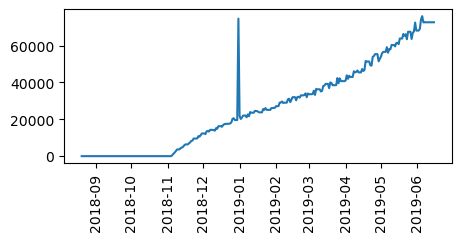

DBSF3593 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


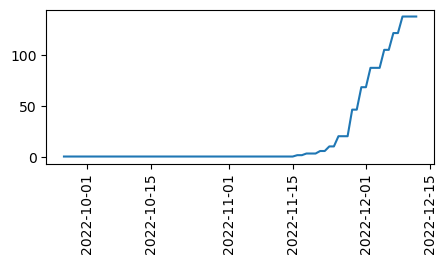

DBSF3597 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


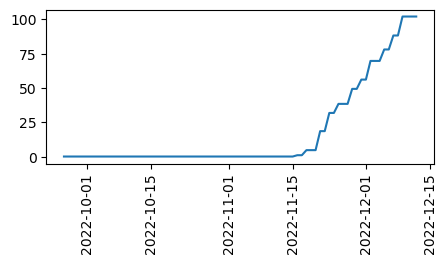

DBSF3655 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


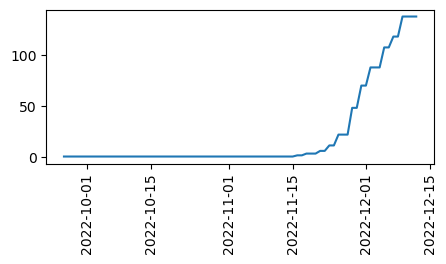

DBSF3661 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


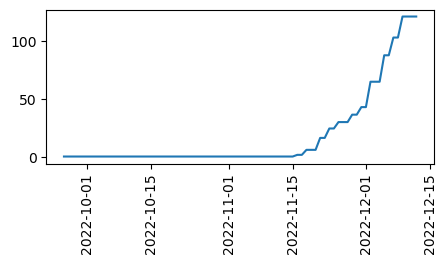

DBSF3705 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


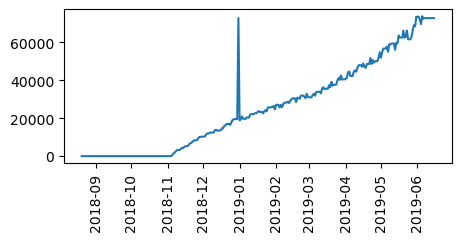

DBSF3755 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


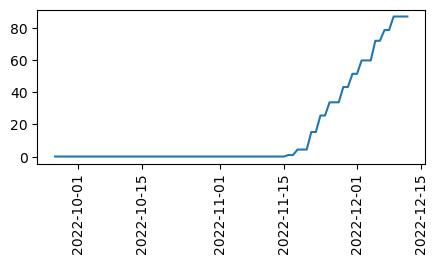

DBSF3803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


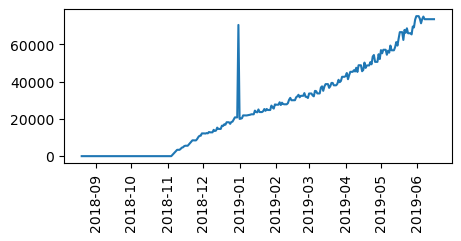

DBSF3841 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


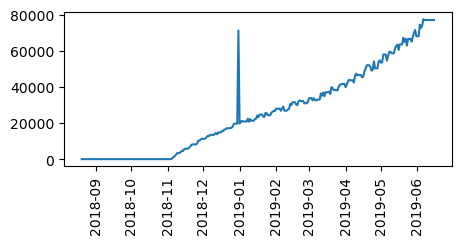

DBSF3850 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


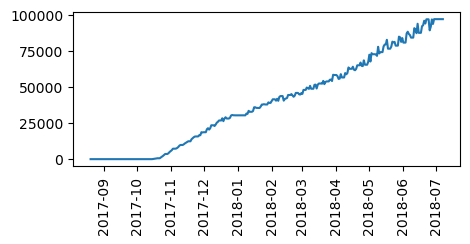

DBSF3891 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


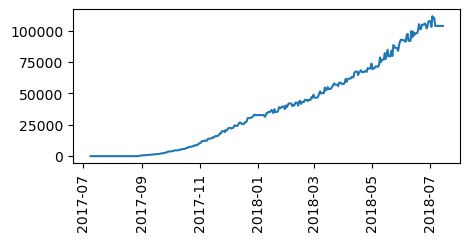

DBSF3906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


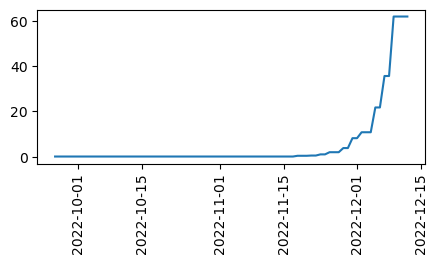

DBSF3911 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


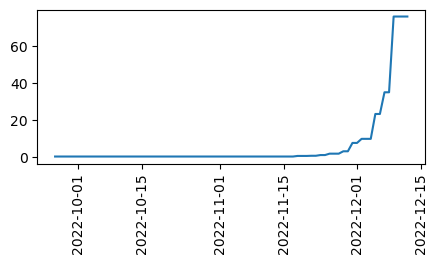

DBSF3912 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


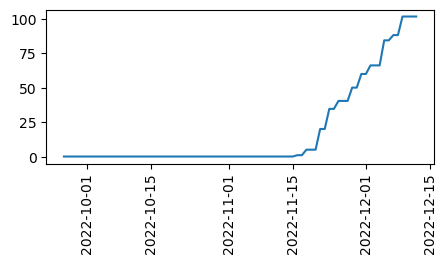

DBSF3924 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


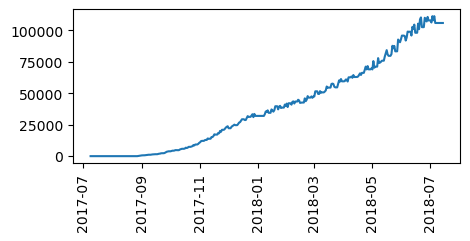

DBSF3932 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


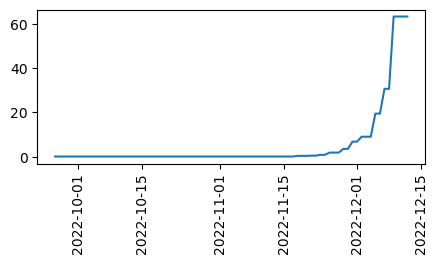

DBSF3990 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


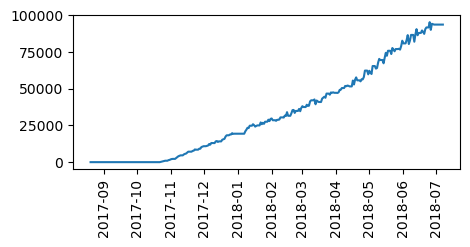

DBSF3998 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


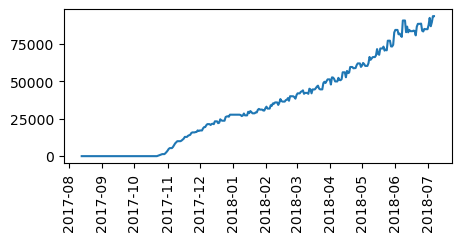

DBSF4004 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


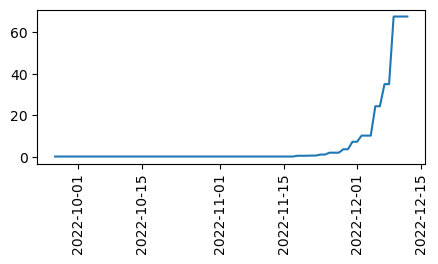

DBSF4013 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


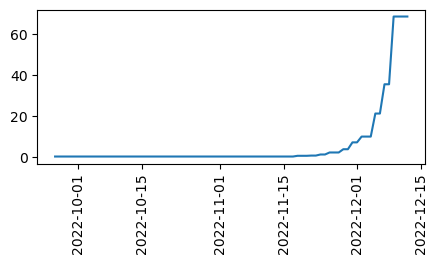

DBSF4049 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


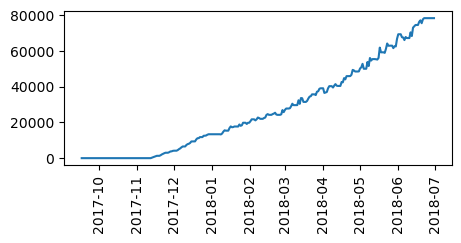

DBSF4083 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


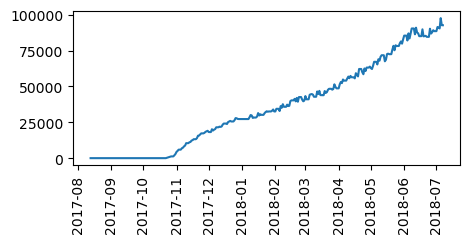

DBSF4101 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


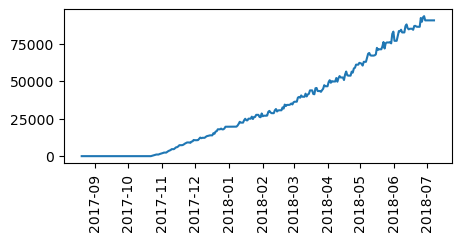

DBSF4111 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


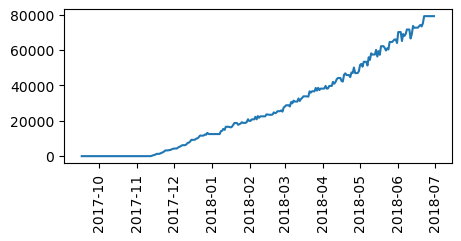

DBSF4121 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


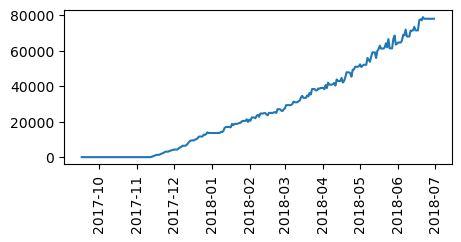

DBSF4146 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


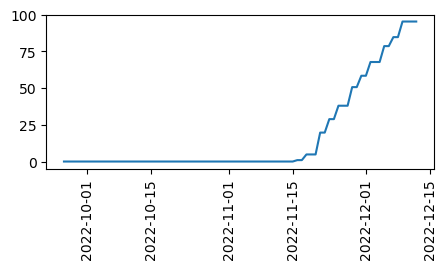

DBSF4154 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


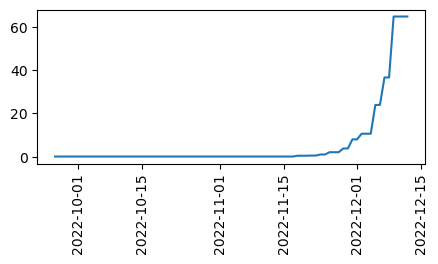

DBSF4163 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


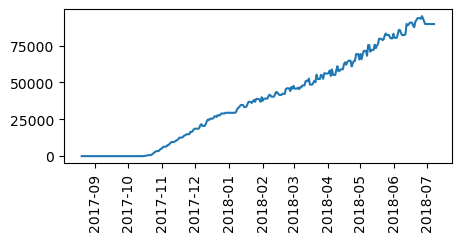

DBSF4181 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


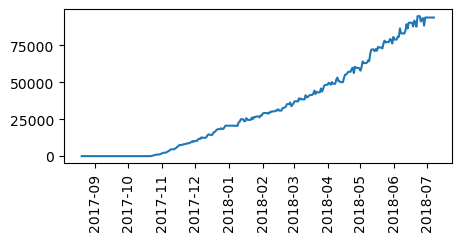

DBSF4197 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


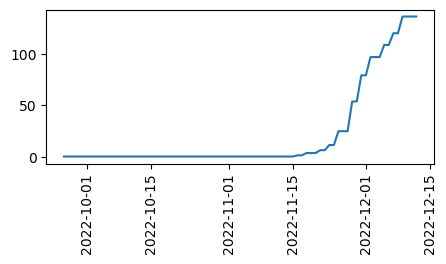

DBSF4202 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


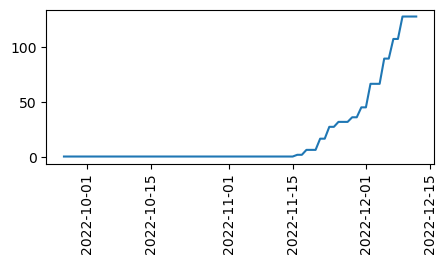

DBSF4212 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


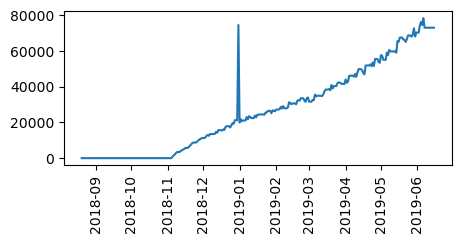

DBSF4250 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


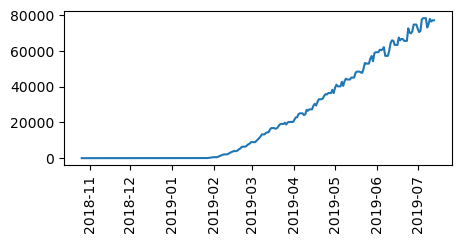

DBSF4283 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


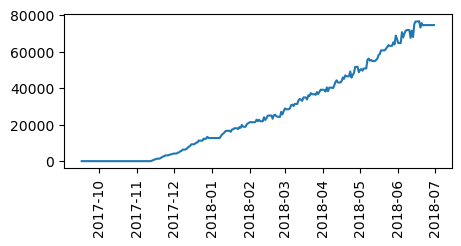

DBSF4310 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


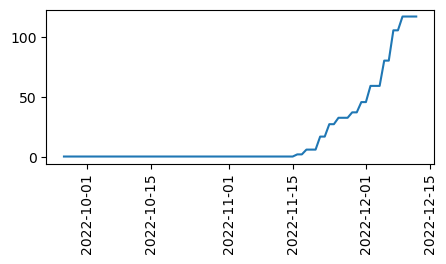

DBSF4329 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


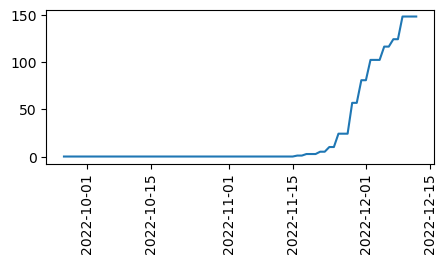

DBSF4371 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


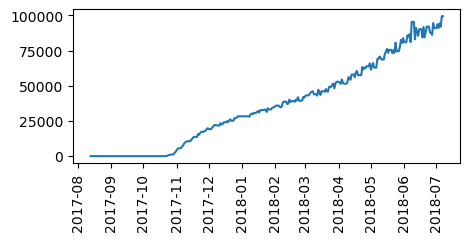

DBSF4401 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


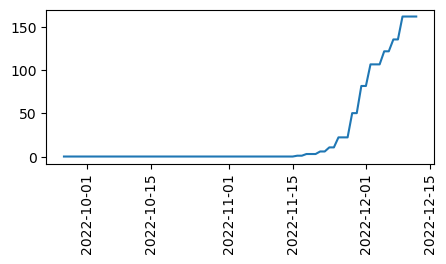

DBSF4442 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


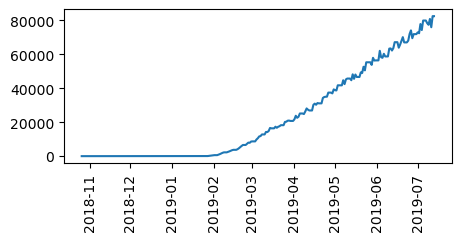

DBSF4466 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


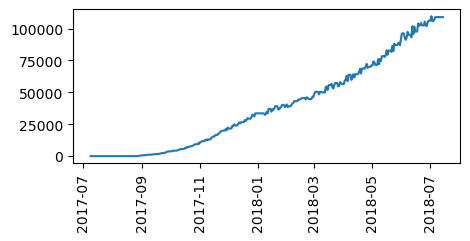

DBSF4554 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


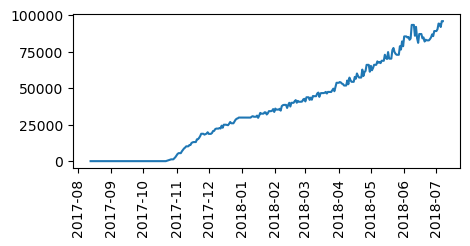

DBSF4640 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


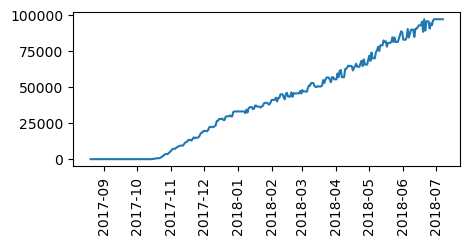

DBSF4646 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


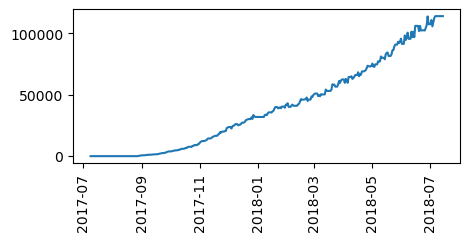

DBSF4659 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


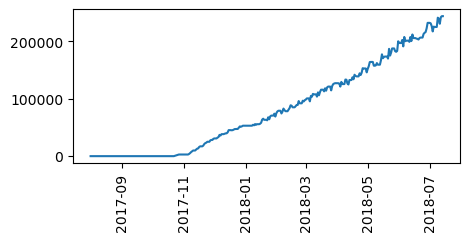

DBSF4678 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


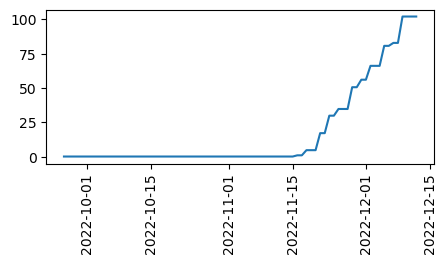

DBSF4713 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


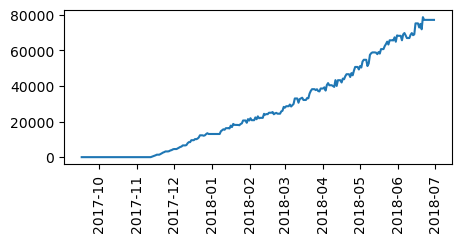

DBSF4716 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


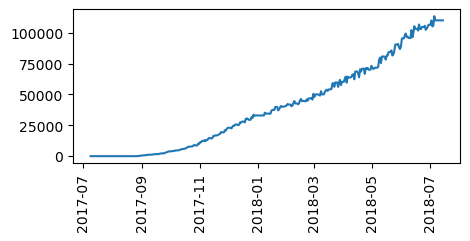

DBSF4720 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


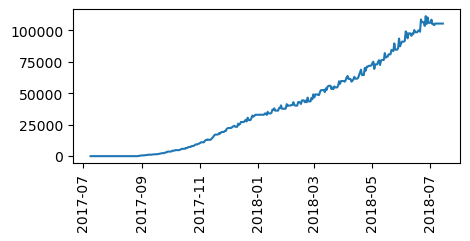

DBSF4752 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


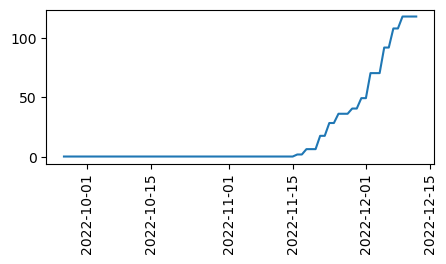

DBSF4800 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


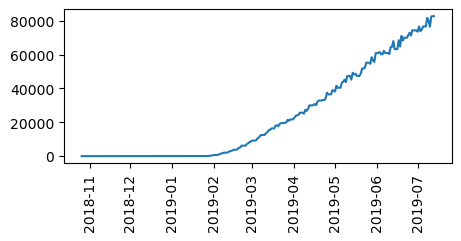

DBSF4812 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


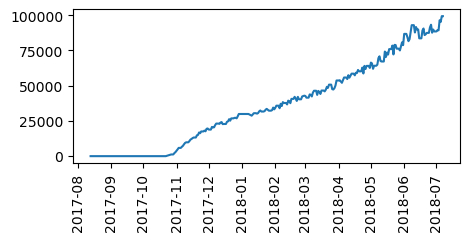

DBSF4814 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


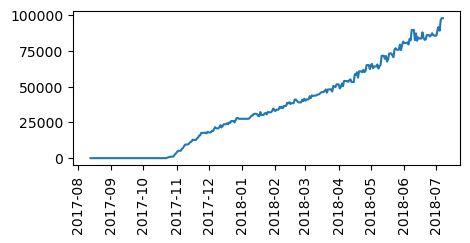

DBSF4817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


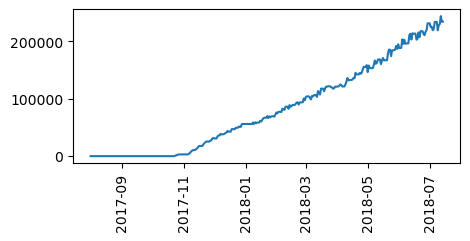

DBSF4846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


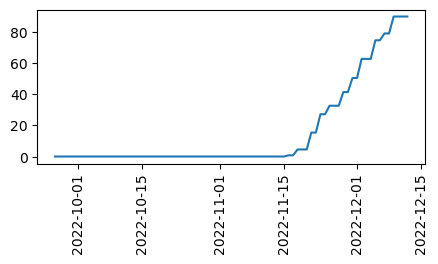

DBSF4885 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


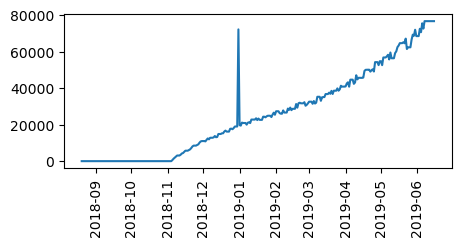

DBSF4907 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


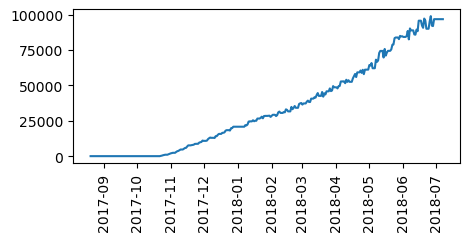

DBSF4964 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


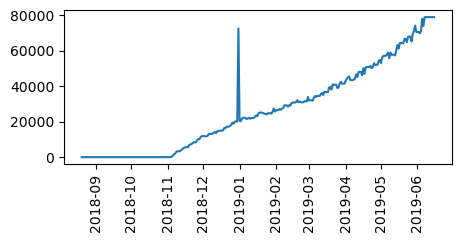

DBSF4972 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


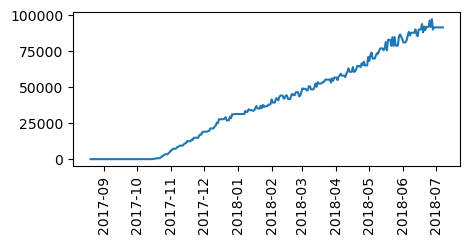

DBSF5022 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


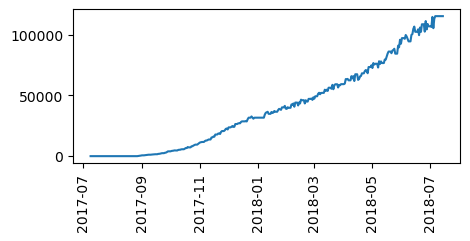

DBSF5056 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


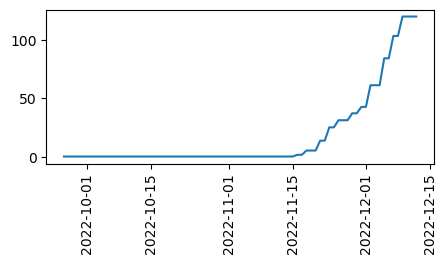

DBSF5095 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


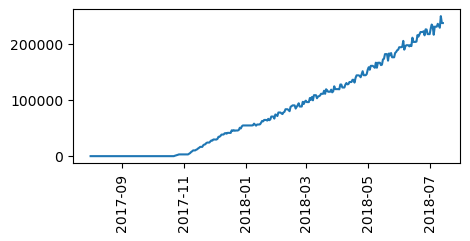

DBSF5121 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


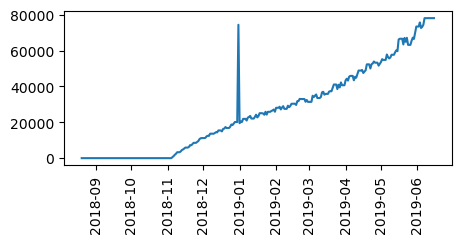

DBSF5170 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


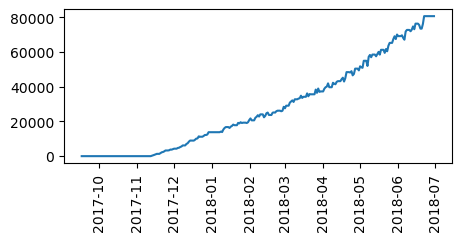

DBSF5193 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


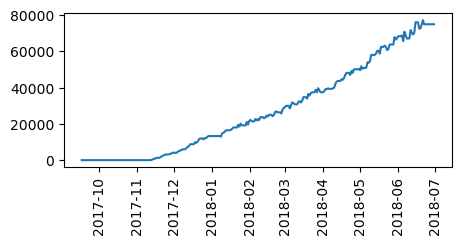

DBSF5216 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


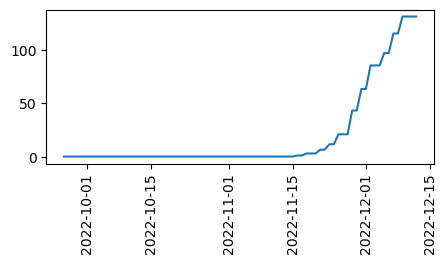

DBSF5227 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


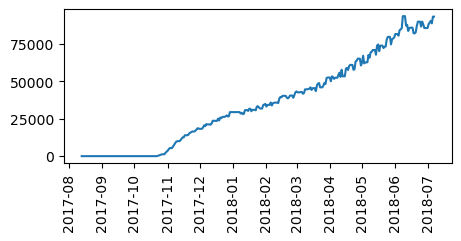

DBSF5240 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


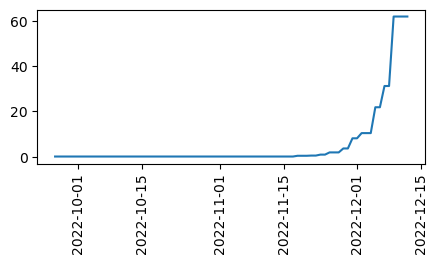

DBSF5243 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


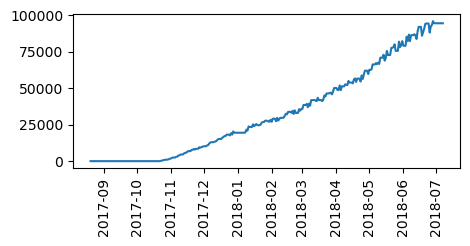

DBSF5271 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


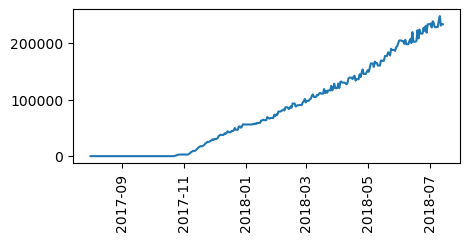

DBSF5299 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


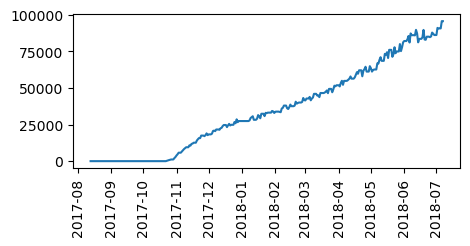

DBSF5303 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


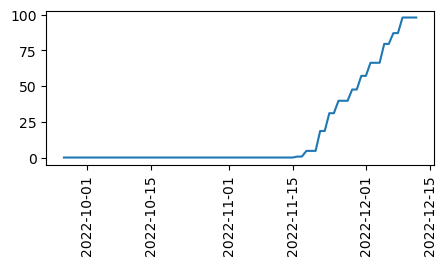

DBSF5344 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


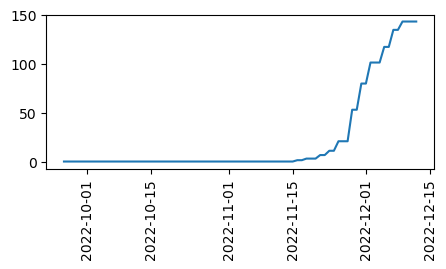

DBSF5351 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


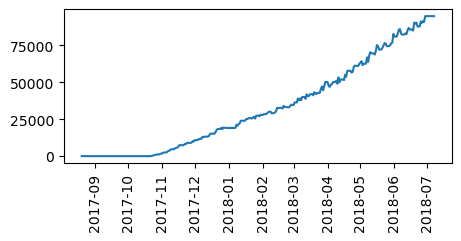

DBSF5403 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


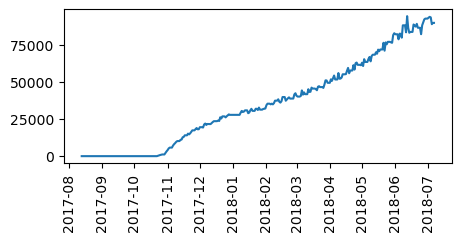

DBSF5429 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


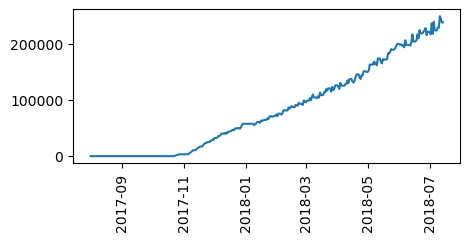

DBSF5452 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


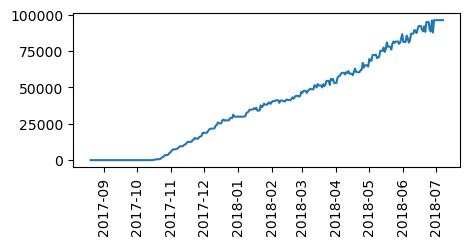

DBSF5534 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


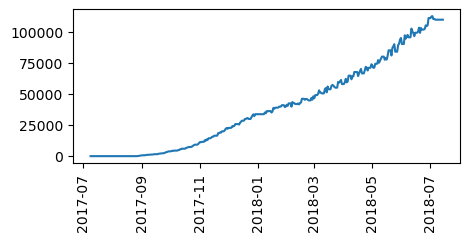

DBSF5549 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


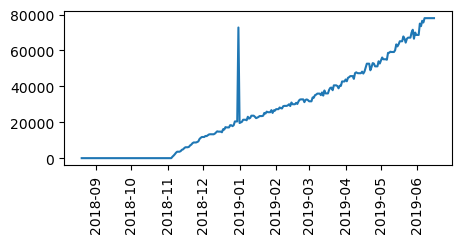

DBSF5566 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


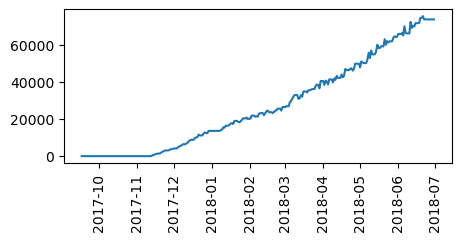

DBSF5575 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


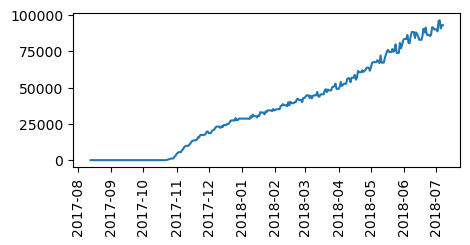

DBSF5587 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


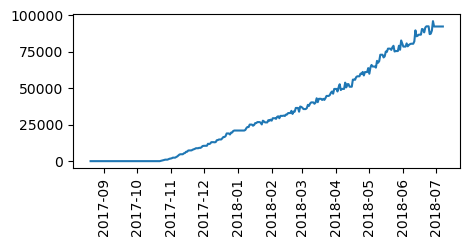

DBSF5607 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


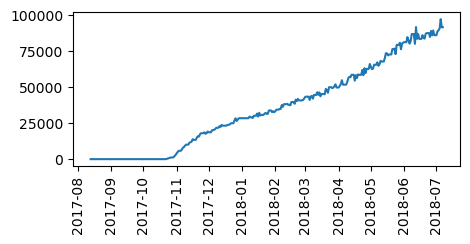

DBSF5628 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


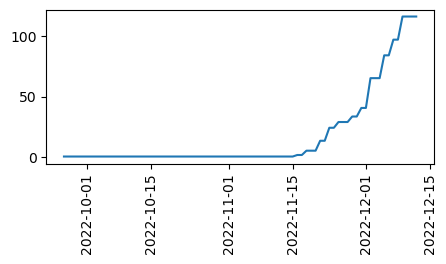

DBSF5644 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


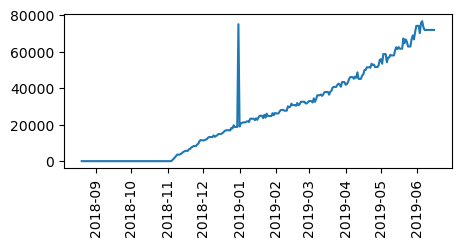

DBSF5661 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


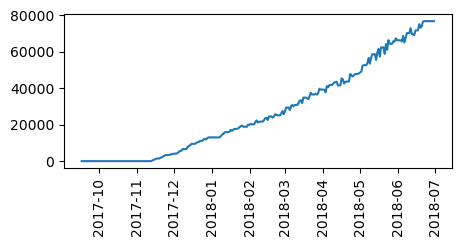

DBSF5686 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


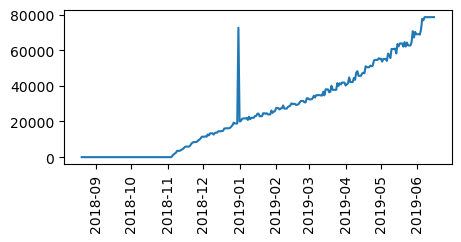

DBSF5705 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


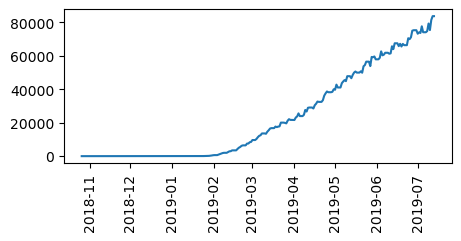

DBSF5734 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


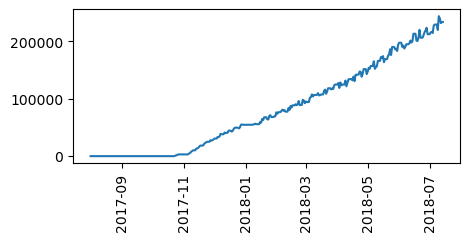

DBSF5764 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


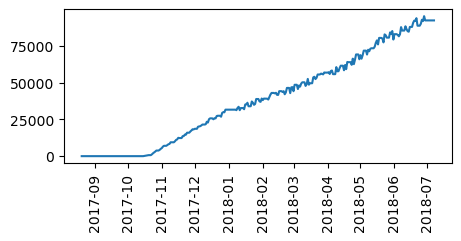

DBSF5769 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


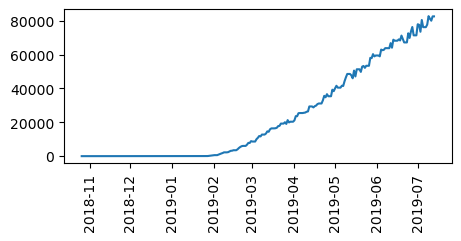

DBSF5772 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


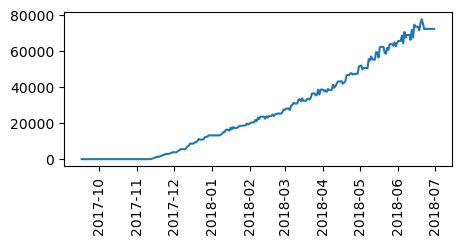

DBSF5823 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


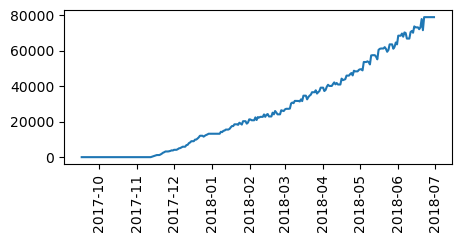

DBSF5833 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


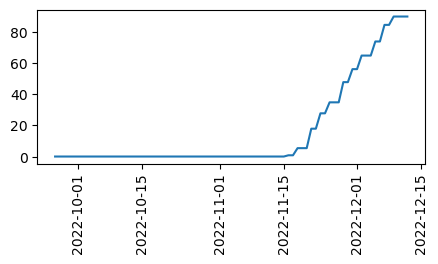

DBSF5847 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


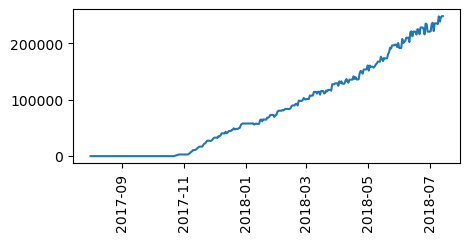

DBSF5848 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


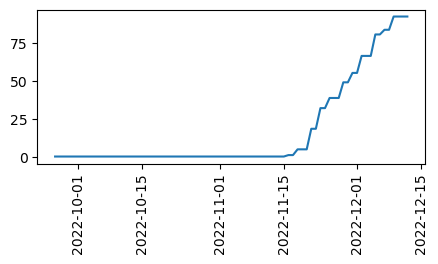

DBSF5875 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


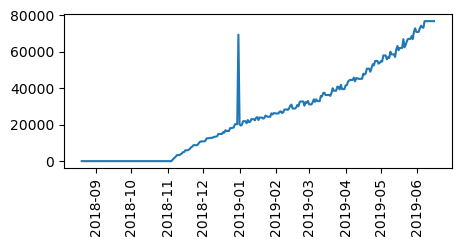

DBSF5973 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


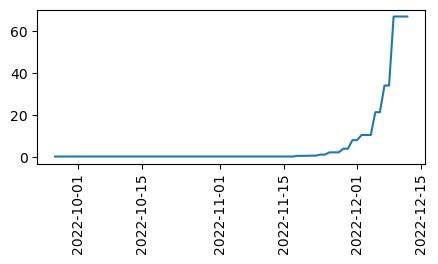

DBSF6030 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


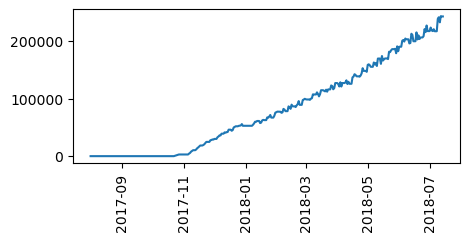

DBSF6039 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


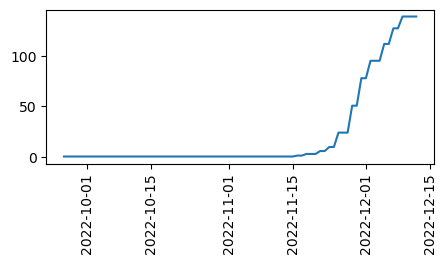

DBSF6042 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


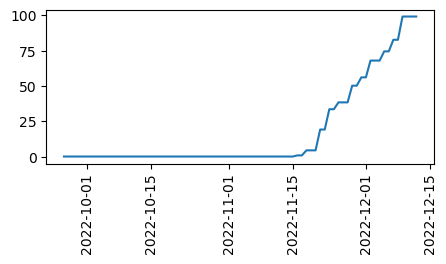

DBSF6053 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


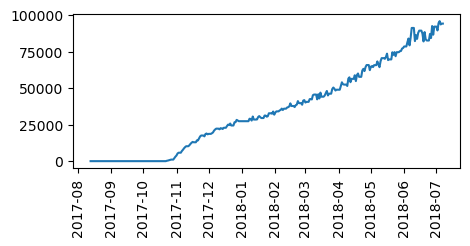

DBSF6057 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


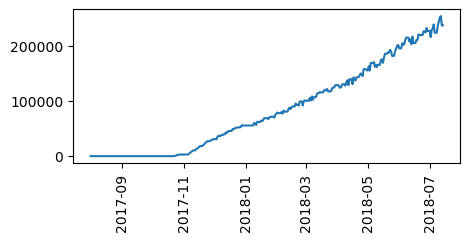

DBSF6059 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


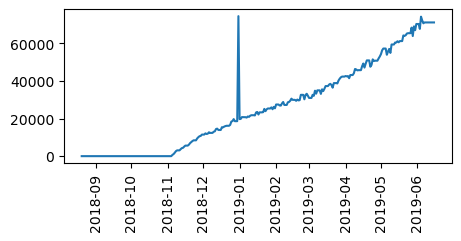

DBSF6134 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


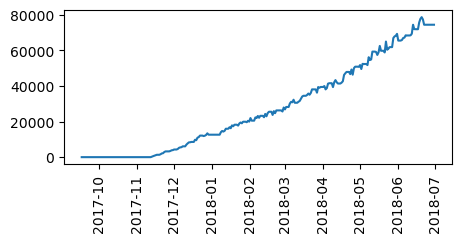

DBSF6144 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


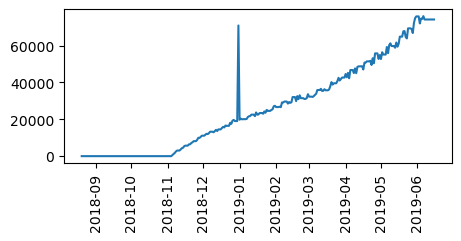

DBSF6147 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


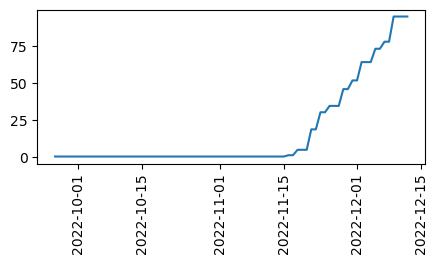

DBSF6163 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


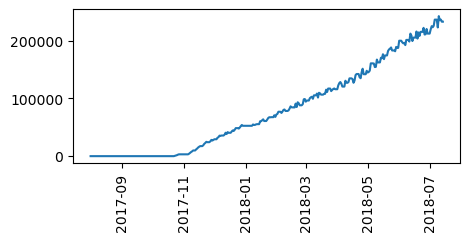

DBSF6174 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


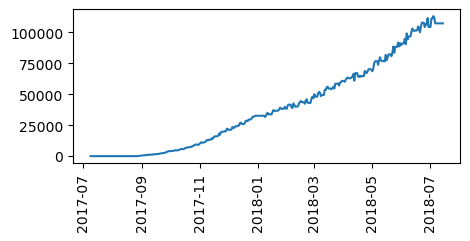

DBSF6206 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


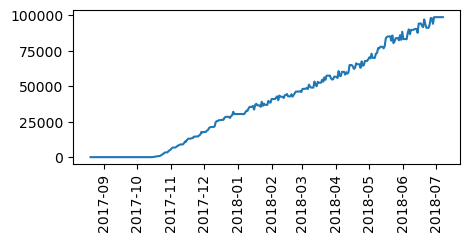

DBSF6211 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


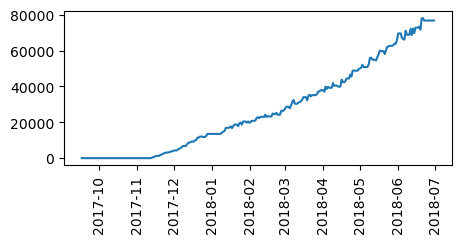

DBSF6218 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


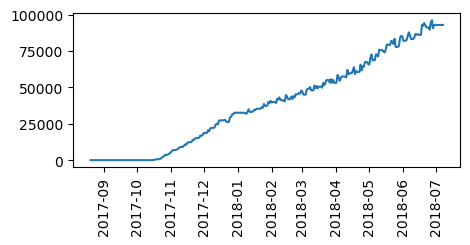

DBSF6295 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


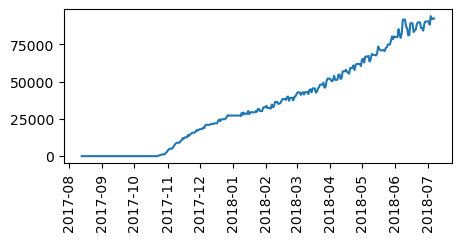

DBSF6298 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


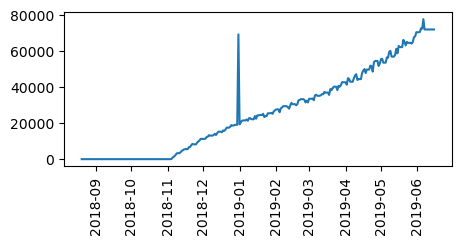

DBSF6305 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


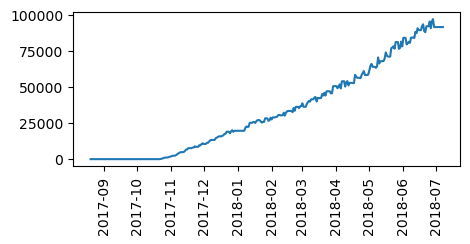

DBSF6318 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


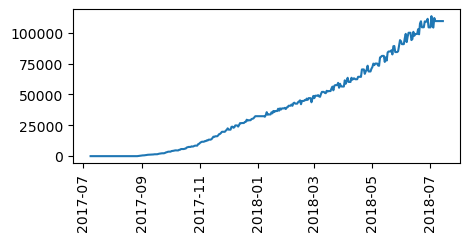

DBSF6441 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


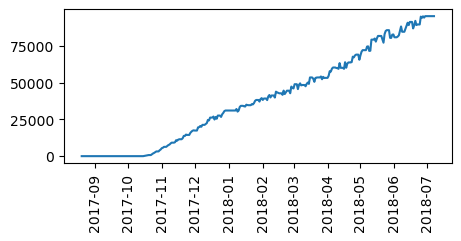

DBSF6473 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


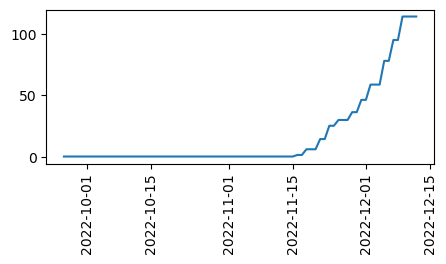

DBSF6497 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


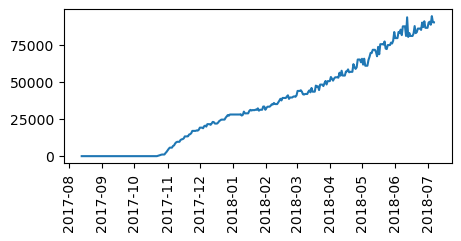

DBSF6502 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


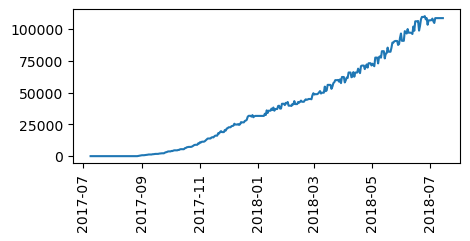

DBSF6503 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


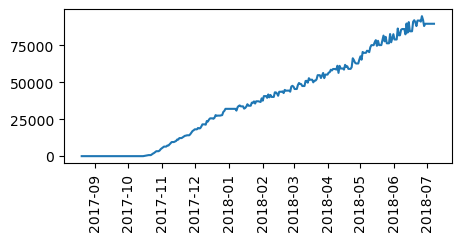

DBSF6522 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


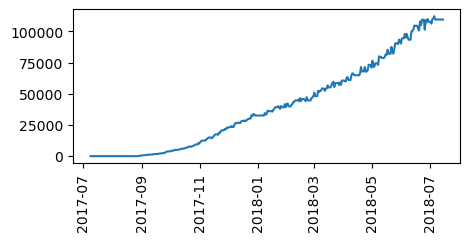

DBSF6576 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


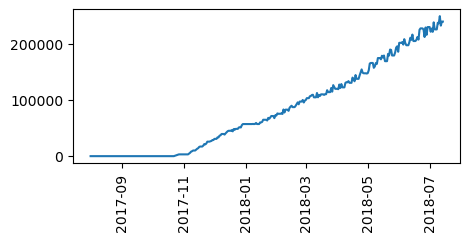

DBSF6618 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


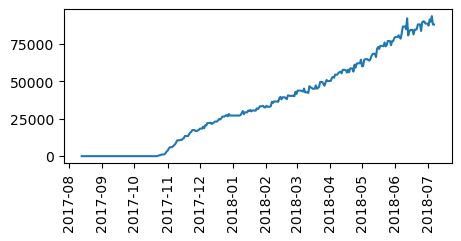

DBSF6619 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


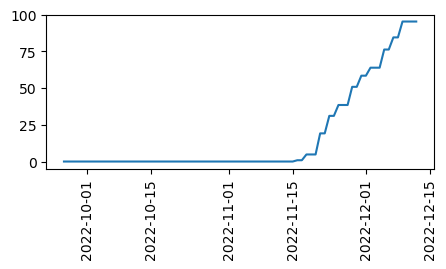

DBSF6641 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


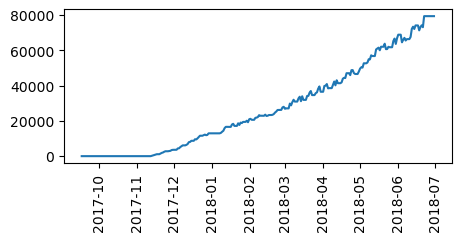

DBSF6690 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


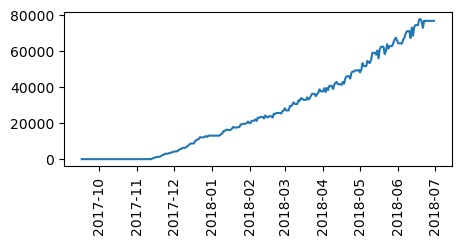

DBSF6699 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


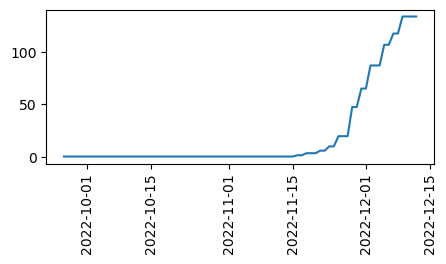

DBSF6771 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


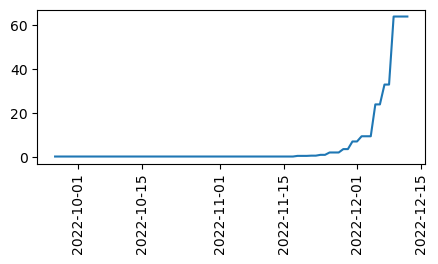

DBSF6806 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


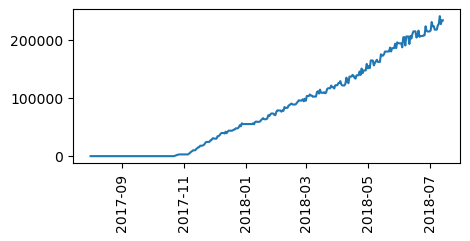

DBSF6817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


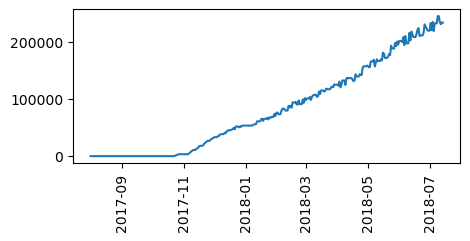

DBSF6833 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


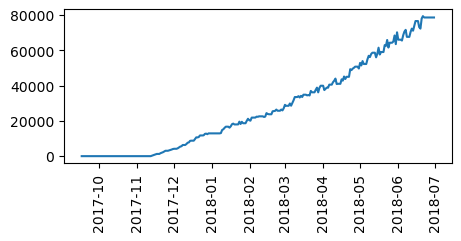

DBSF6892 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


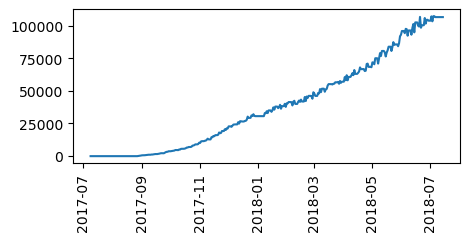

DBSF6914 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


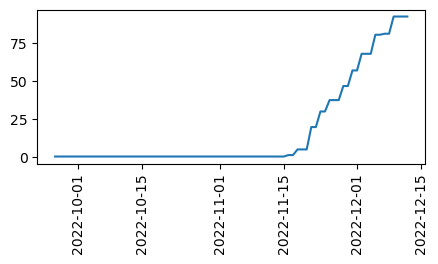

DBSF6949 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


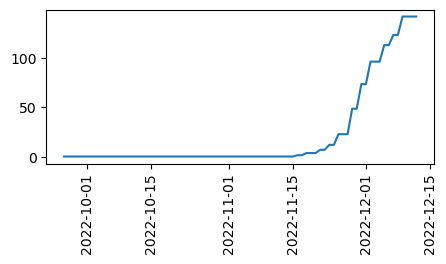

DBSF6979 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


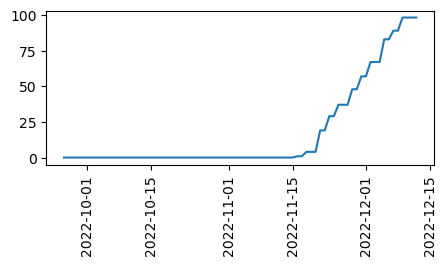

DBSF6990 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


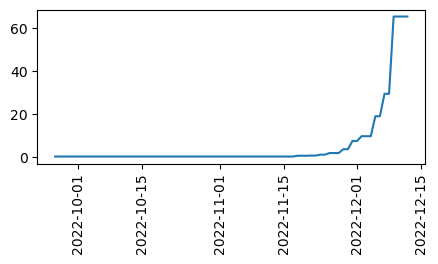

DBSF7114 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


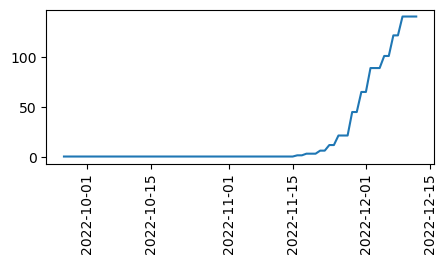

DBSF7130 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


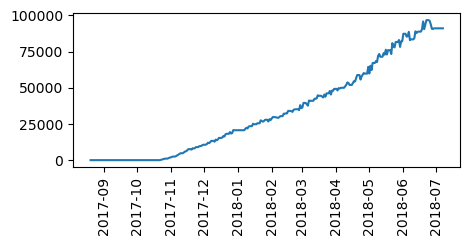

DBSF7151 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


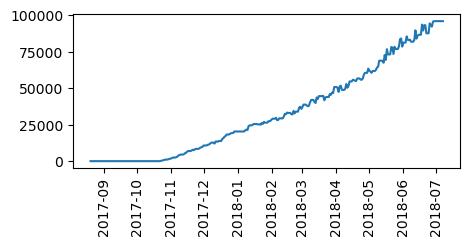

DBSF7185 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


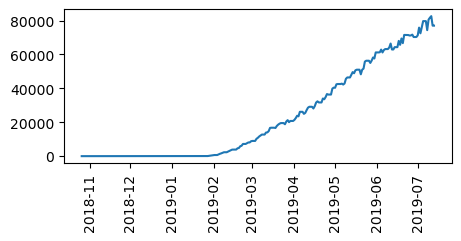

DBSF7186 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


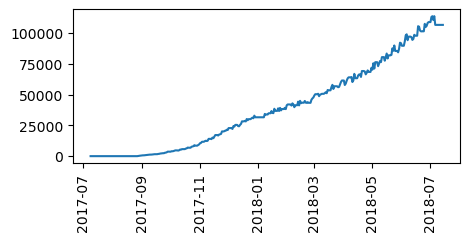

DBSF7195 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


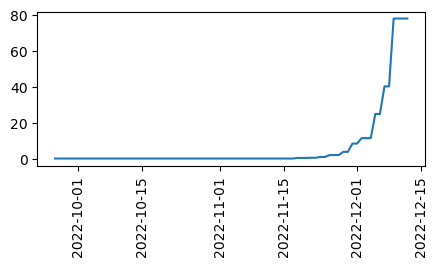

DBSF7198 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


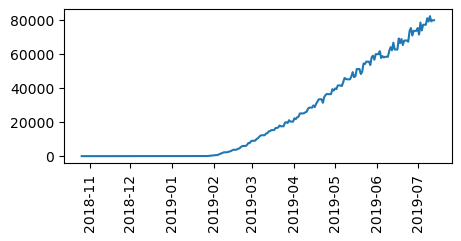

DBSF7221 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


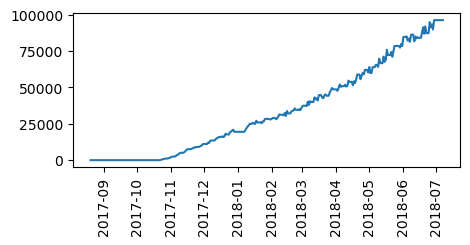

DBSF7294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


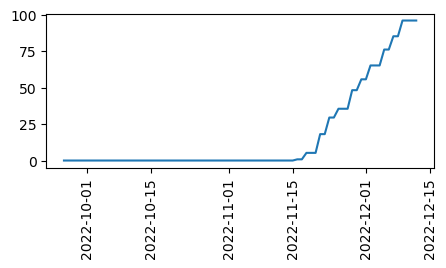

DBSF7339 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


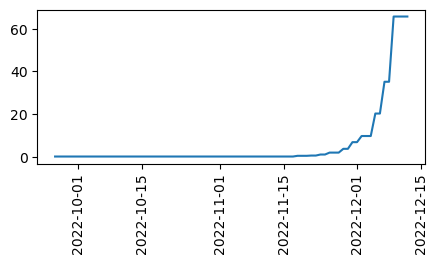

DBSF7419 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


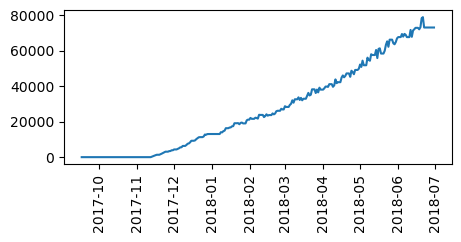

DBSF7476 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


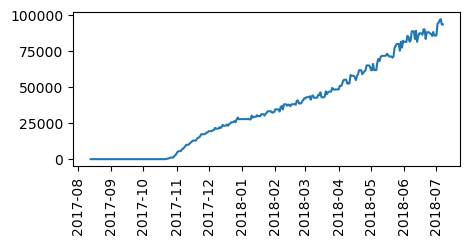

DBSF7477 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


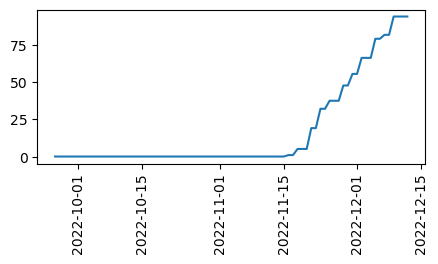

DBSF7548 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


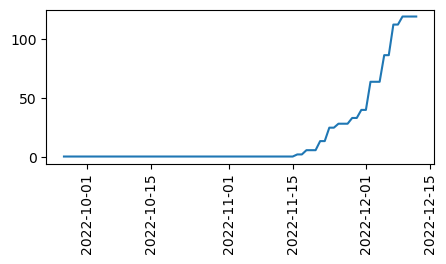

DBSF7633 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


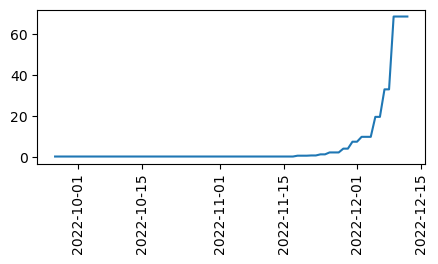

DBSF7641 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


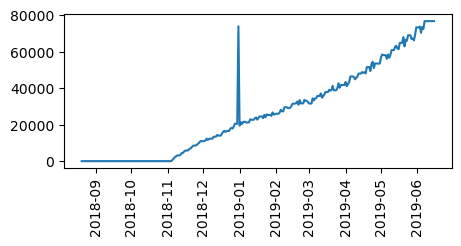

DBSF7654 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


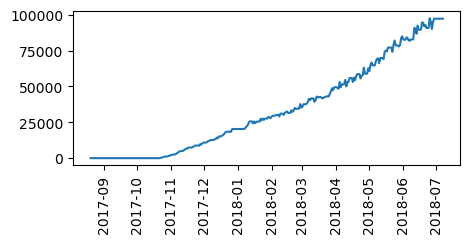

DBSF7666 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


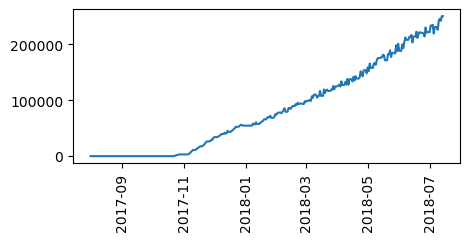

DBSF7673 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


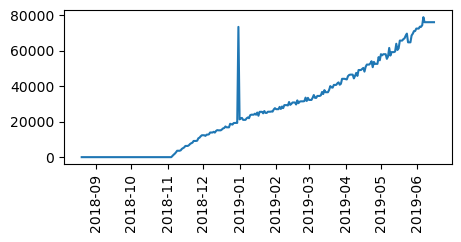

DBSF7679 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


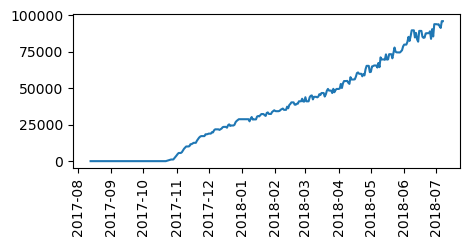

DBSF7692 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


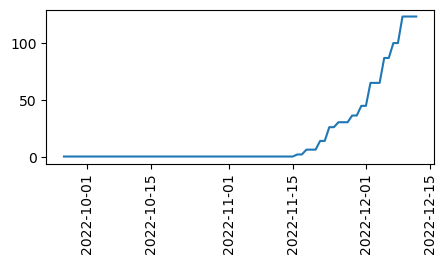

DBSF7705 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


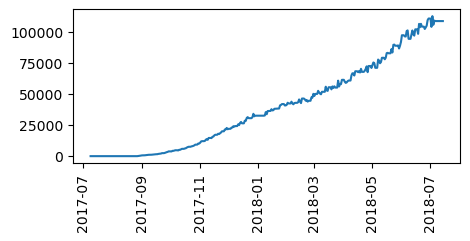

DBSF7717 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


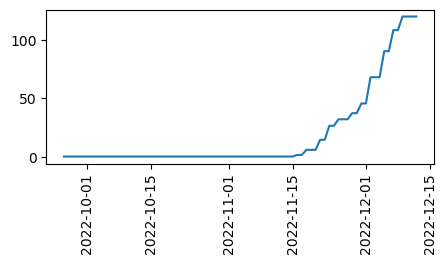

DBSF7722 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


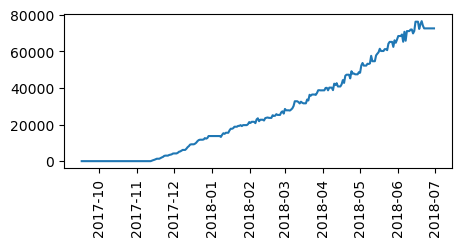

DBSF7740 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


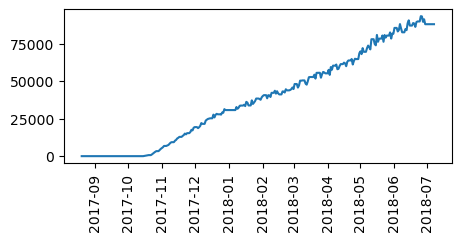

DBSF7828 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


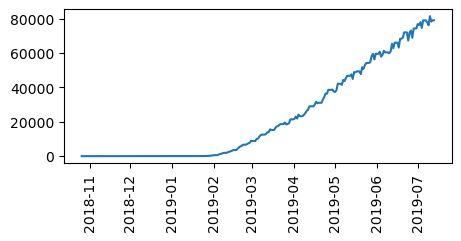

DBSF7863 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


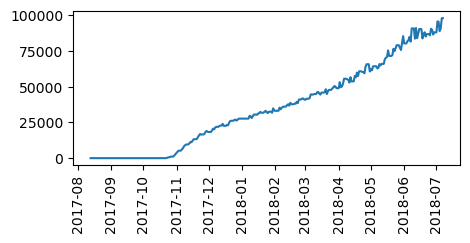

DBSF7882 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


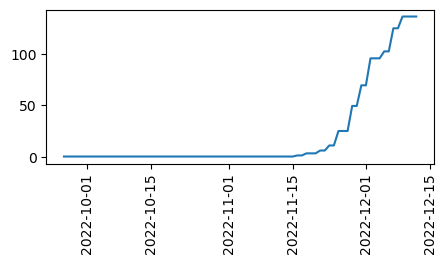

DBSF7897 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


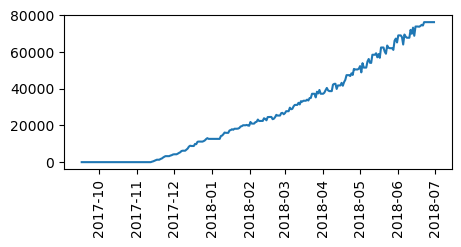

DBSF7898 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


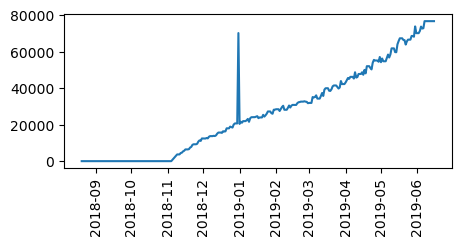

DBSF8040 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


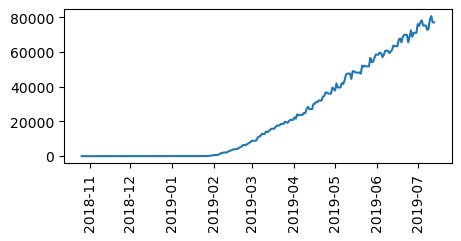

DBSF8047 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


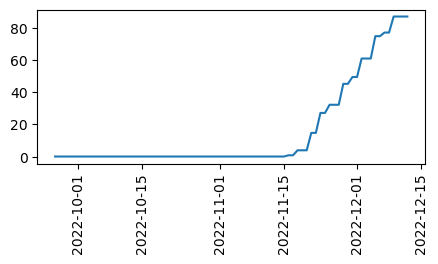

DBSF8065 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


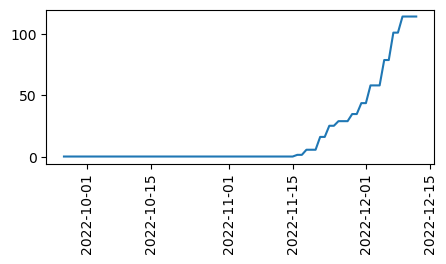

DBSF8072 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


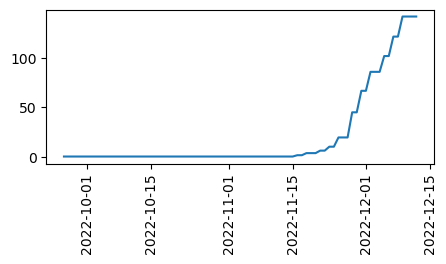

DBSF8083 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


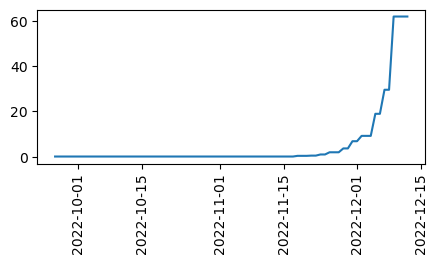

DBSF8124 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


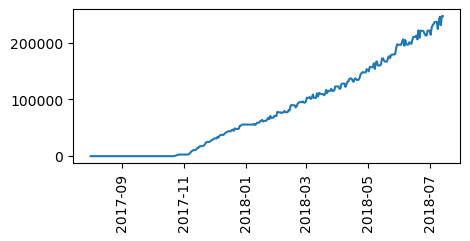

DBSF8175 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


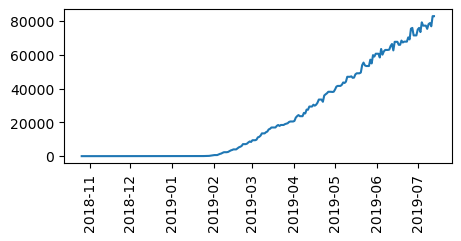

DBSF8195 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


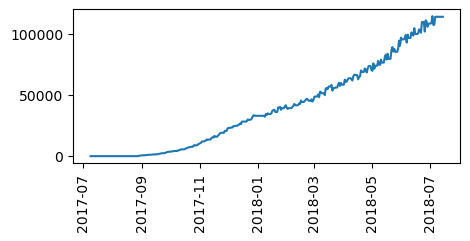

DBSF8205 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


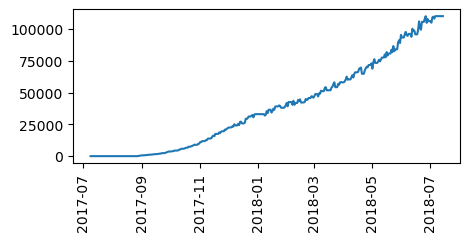

DBSF8221 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


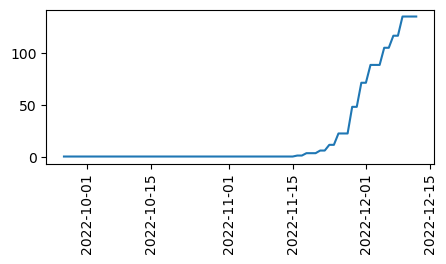

DBSF8230 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


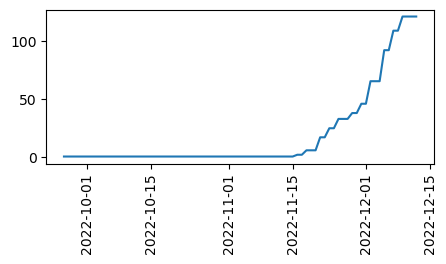

DBSF8242 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


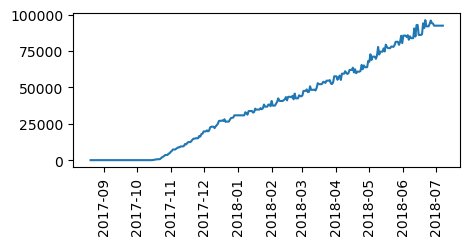

DBSF8258 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


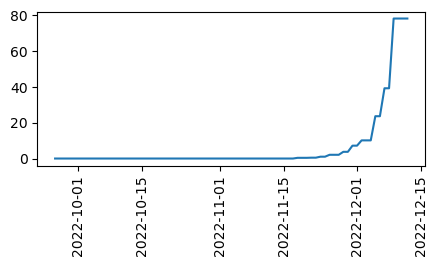

DBSF8285 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


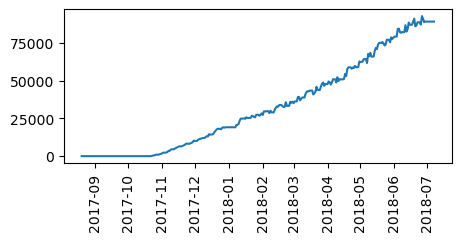

DBSF8293 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


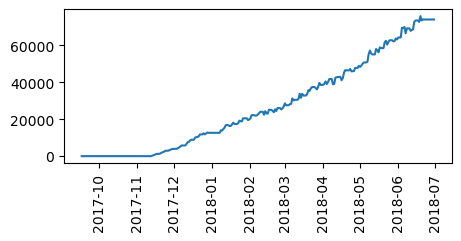

DBSF8318 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


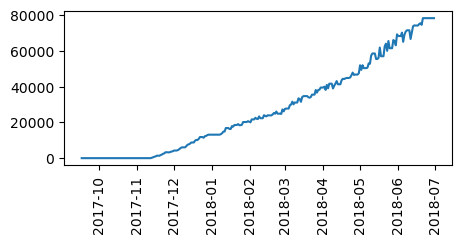

DBSF8381 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


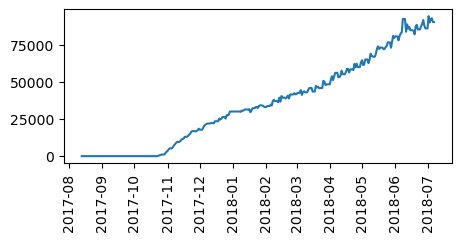

DBSF8383 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


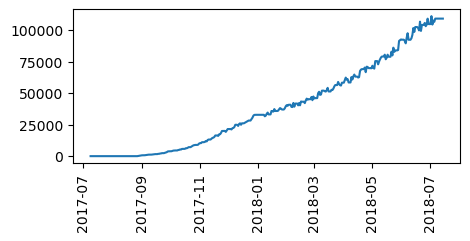

DBSF8405 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


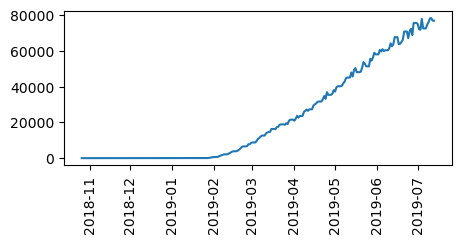

DBSF8411 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


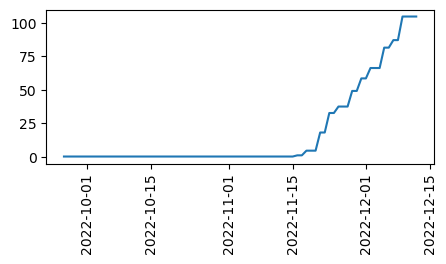

DBSF8440 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


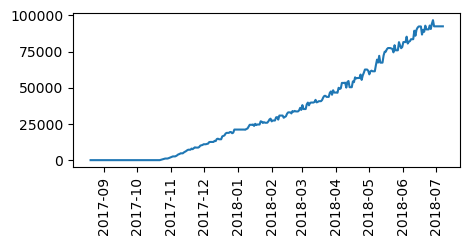

DBSF8457 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


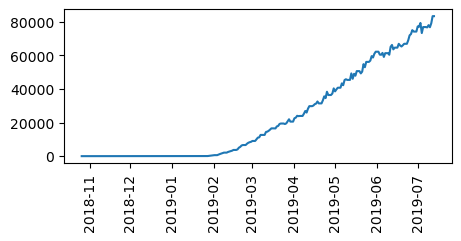

DBSF8462 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


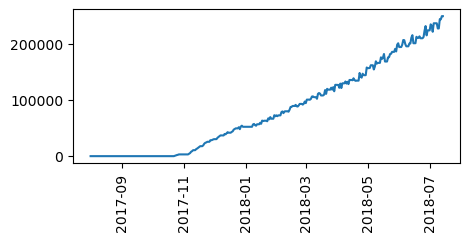

DBSF8492 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


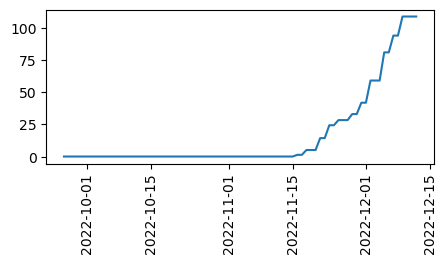

DBSF8512 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


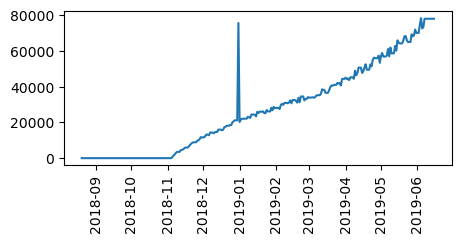

DBSF8533 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


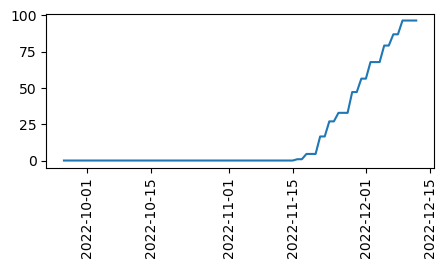

DBSF8545 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


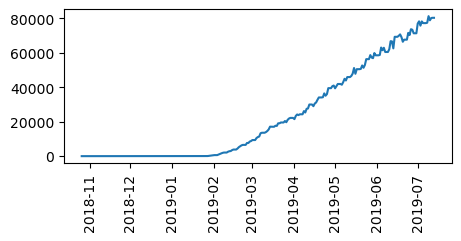

DBSF8557 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


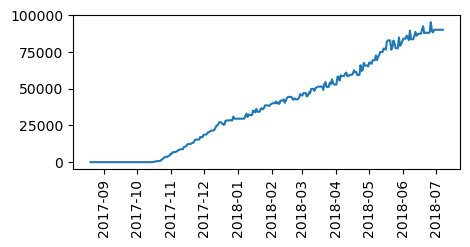

DBSF8573 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


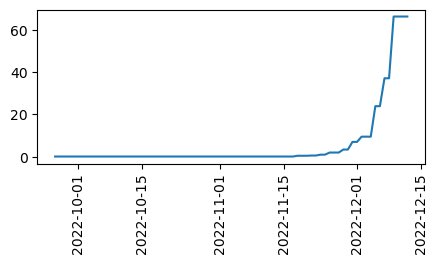

DBSF8588 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


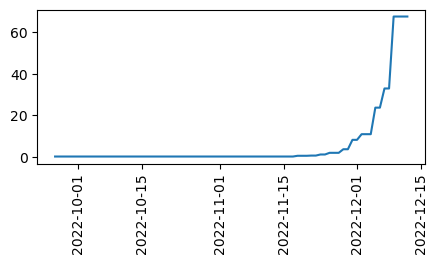

DBSF8590 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


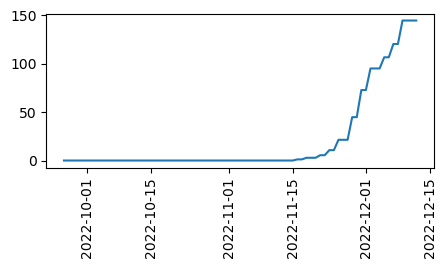

DBSF8665 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


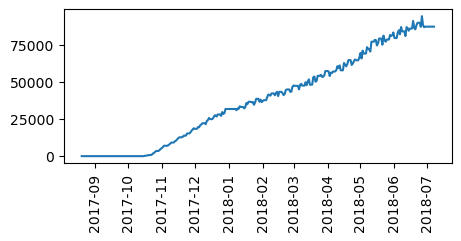

DBSF8670 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


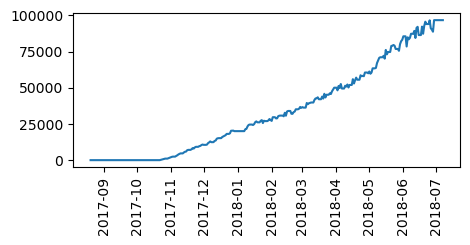

DBSF8704 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


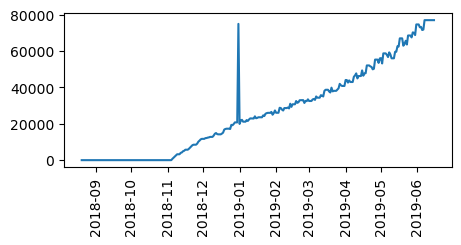

DBSF8721 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


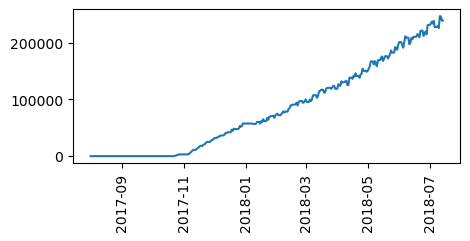

DBSF8764 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


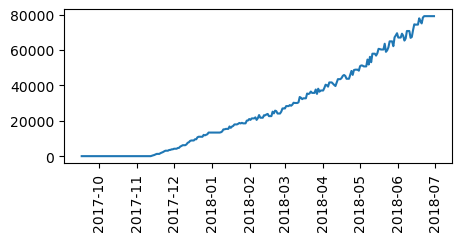

DBSF8793 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


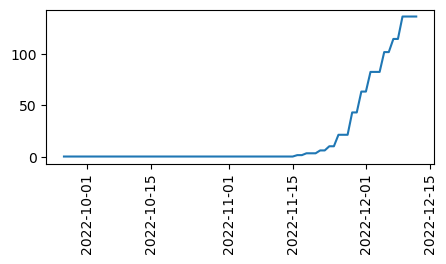

DBSF8830 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


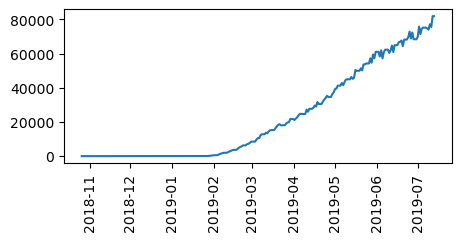

DBSF8906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


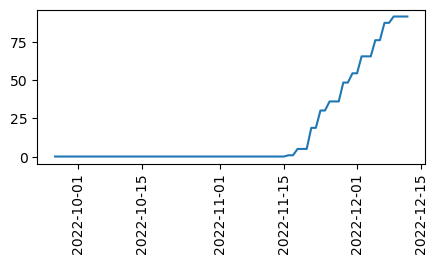

DBSF8924 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


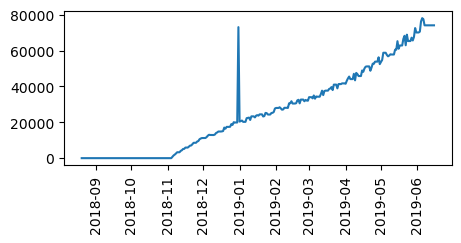

DBSF8958 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


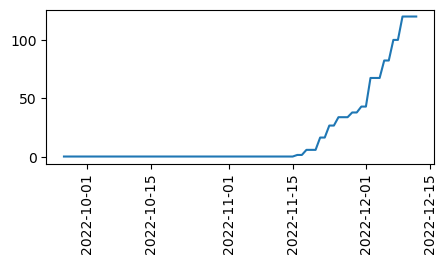

DBSF8966 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


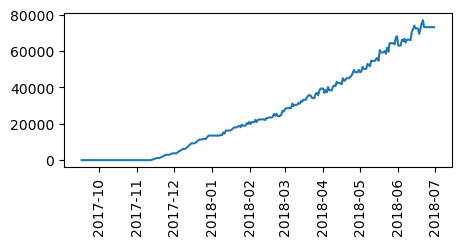

DBSF9076 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


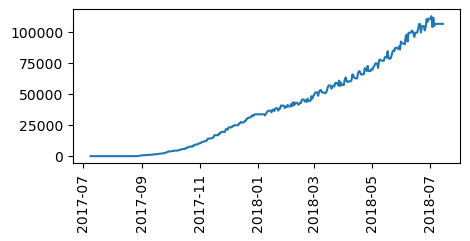

DBSF9088 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


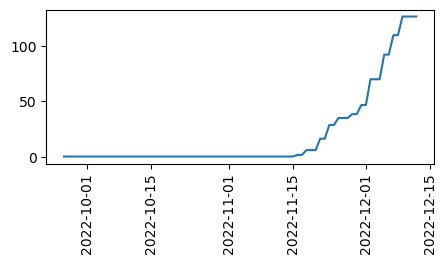

DBSF9161 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


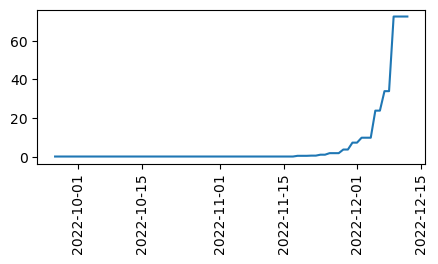

DBSF9172 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


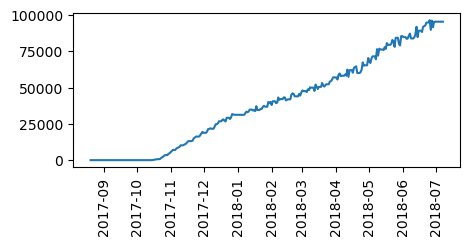

DBSF9184 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


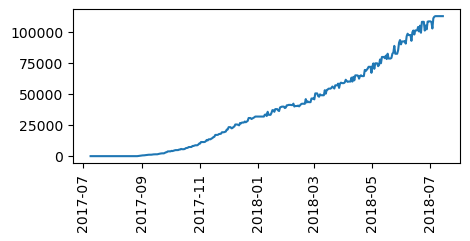

DBSF9221 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


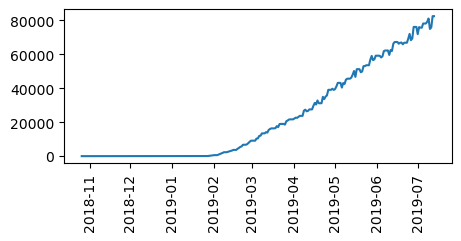

DBSF9223 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


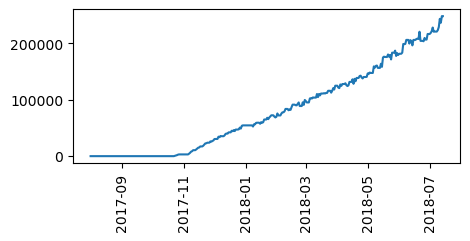

DBSF9229 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


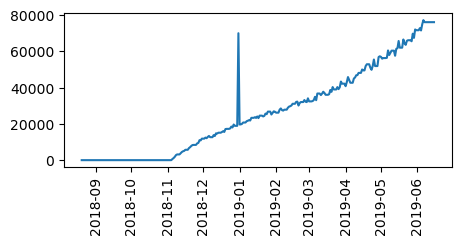

DBSF9275 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


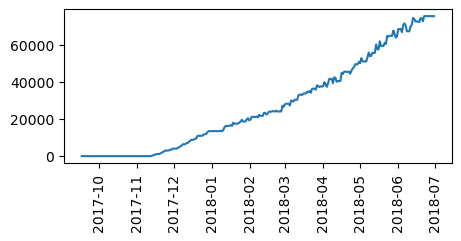

DBSF9369 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


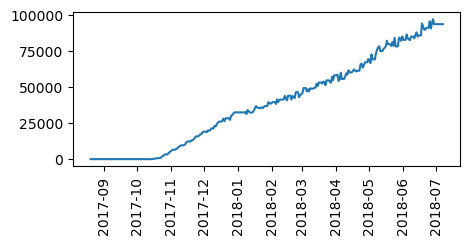

DBSF9377 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


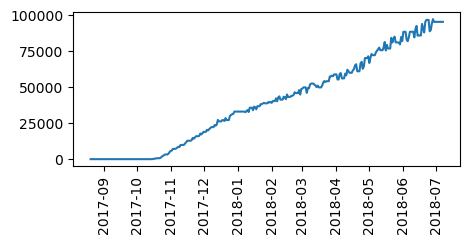

DBSF9378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


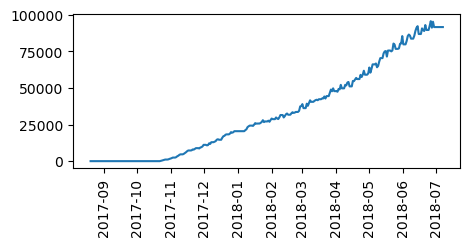

DBSF9391 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


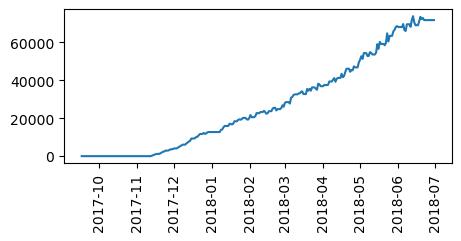

DBSF9404 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


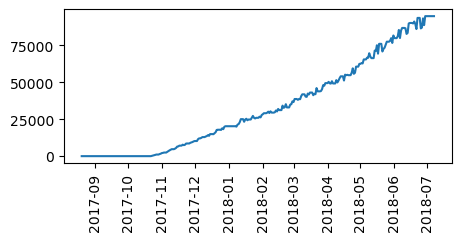

DBSF9406 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


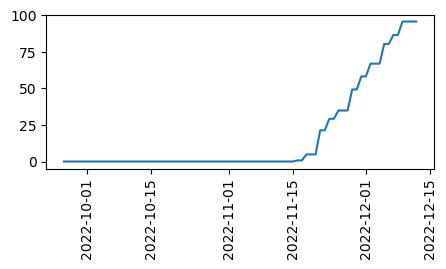

DBSF9498 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


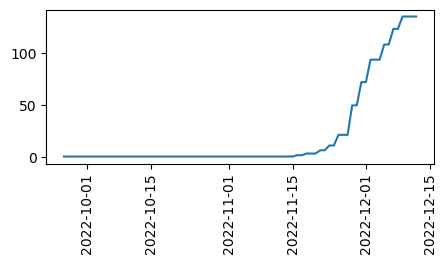

DBSF9546 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


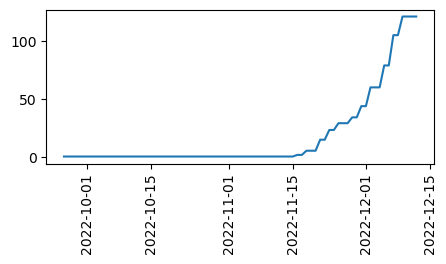

DBSF9627 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


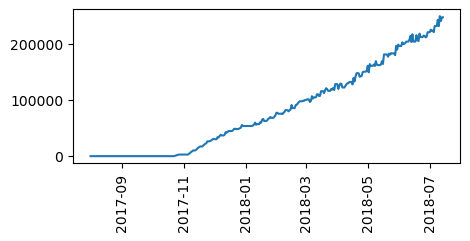

DBSF9631 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


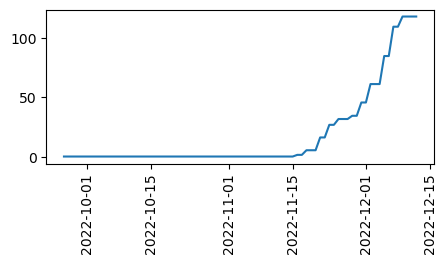

DBSF9675 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


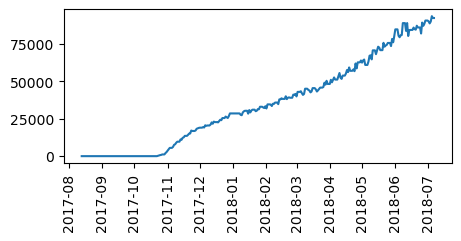

DBSF9688 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


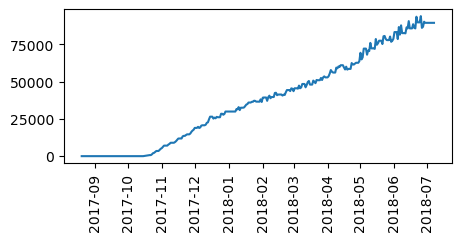

DBSF9741 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


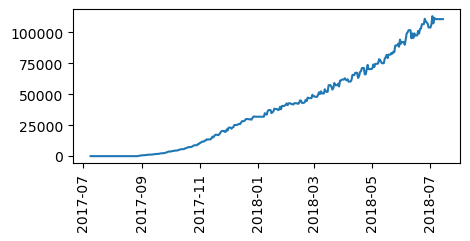

DBSF9746 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


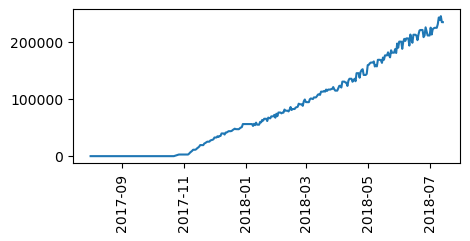

DBSF9761 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


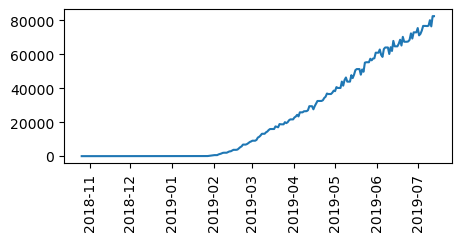

DBSF9777 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


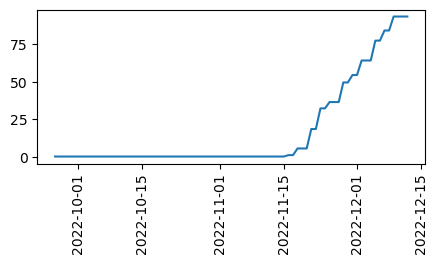

DBSF9793 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


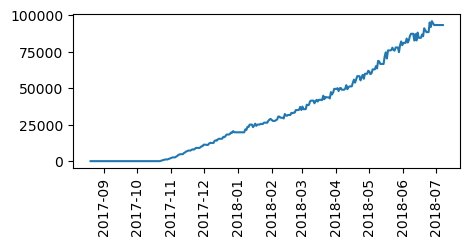

DBSF9838 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


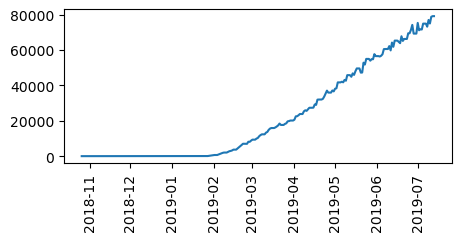

DBSF9894 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


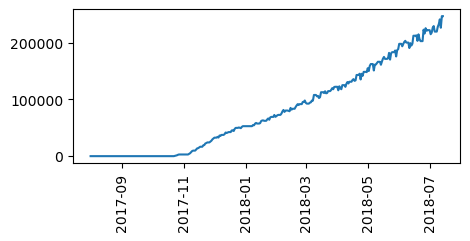

DBSF9922 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


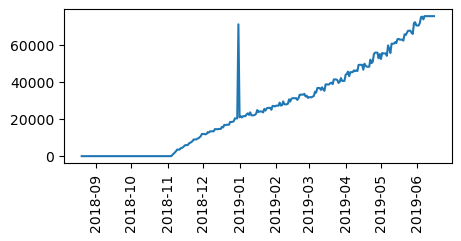

DBSF9942 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


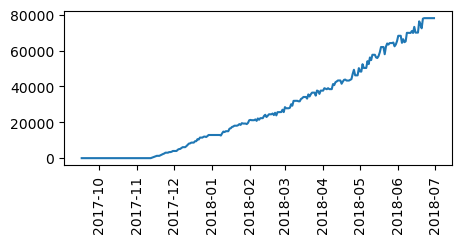

DBSF9948 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


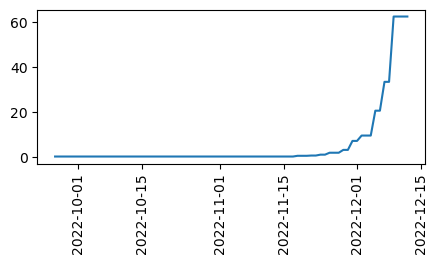

DBSF9961 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


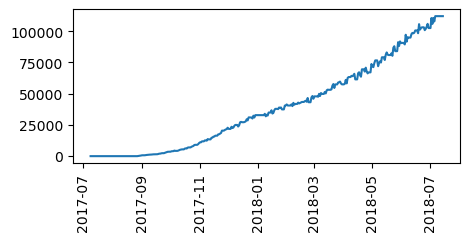

DBSF9969 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


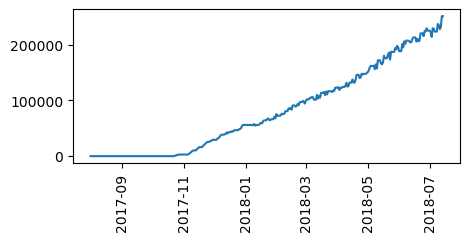

In [264]:
for i in tmp_df3.frmDist.unique():
    plt.figure(figsize=[5,2])
    sub_df = tmp_df3[tmp_df3.frmDist==i]
    print(i, "/ Date:", min(sub_df.date), max(sub_df.date))
    plt.plot(sub_df.date, sub_df.outtrn_cumsum)
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
PLLNLT
FRTSTCO
FLWRCO
FCLUHG
STEMTHCK
GRWTLT
TCDMT
LEFSTALKLT
LEFBT
LEFCUNT
LEFLT


In [267]:
tmp_df.columns.sort_values()

Index(['CO2Cost', 'CO2Usage', 'FertilizerCost', 'FertilizerUsage',
       'HeatingEnergyUsage_cumsum', 'Mist Cost', 'MistUsageTime', 'WaterCost',
       'WaterUsage', 'acSlrdQy', 'cunt', 'date', 'daysuplyqy', 'ec', 'fcluHg',
       'flanGrupp', 'flanJnt', 'flwrCo', 'frmAr', 'frmDist', 'frmDov',
       'frmWeek', 'frmYear', 'frmhsFclu', 'frtstCo', 'frtstGrupp', 'frtstJnt',
       'frtstSetCo', 'grwtLt', 'hvstCo', 'hvstGrupp', 'hvstJnt', 'inCo2',
       'inHd', 'inTp', 'lefBt', 'lefCunt', 'lefLt', 'lefstalklt', 'otmsuplyqy',
       'outTp', 'outWs', 'outtrn_cumsum', 'outtrn_cumsum_new', 'ph', 'pllnLt',
       'stemThck', 'tcdmt'],
      dtype='object')

In [268]:

growth_cols = ['pllnLt','frtstCo','stemThck','grwtLt','tcdmt','lefstalklt','lefBt','lefCunt','lefLt']

DBSF1059 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


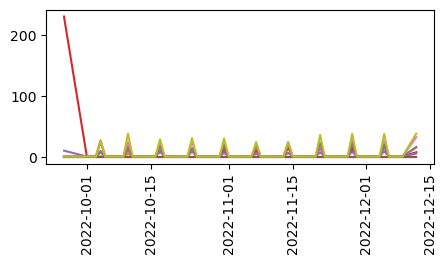

DBSF1093 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


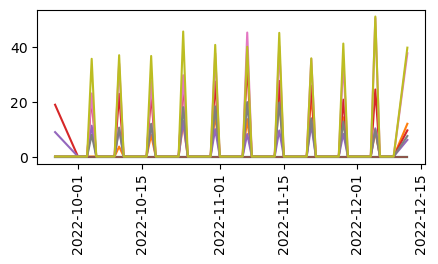

DBSF1121 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


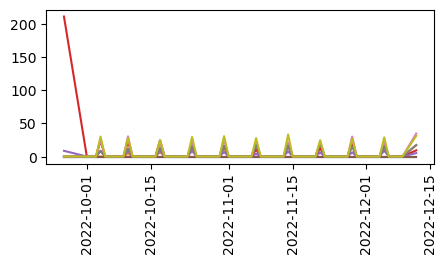

DBSF1172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


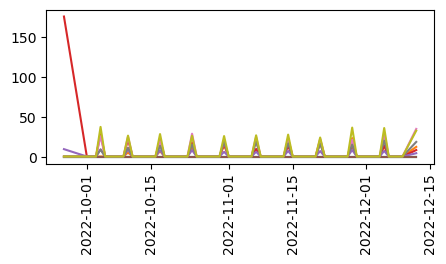

DBSF1180 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


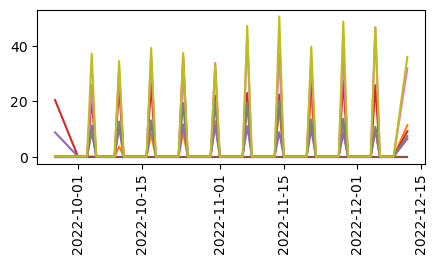

DBSF1186 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


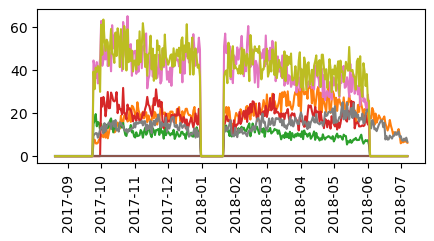

DBSF1205 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


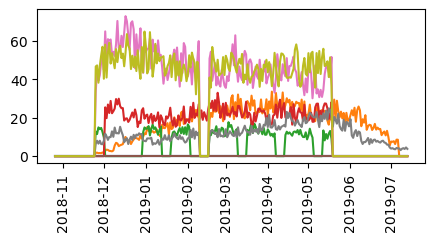

DBSF1215 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


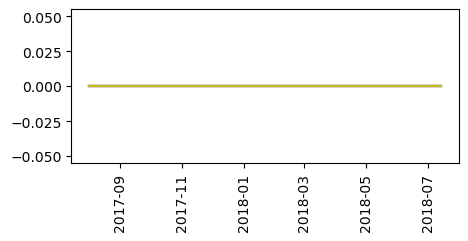

DBSF1218 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


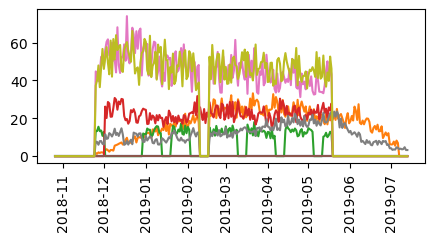

DBSF1232 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


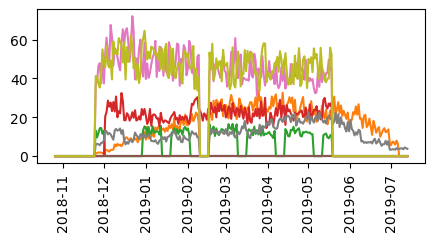

DBSF1279 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


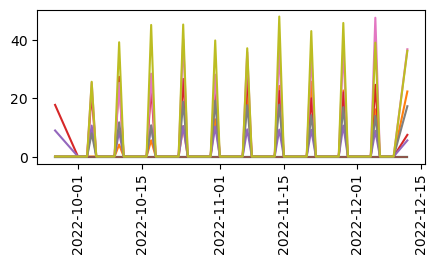

DBSF1294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


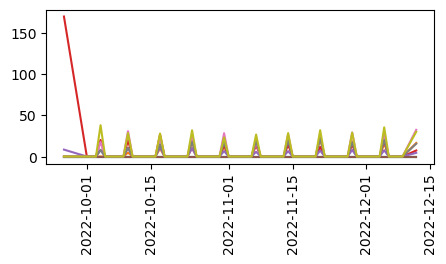

DBSF1385 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


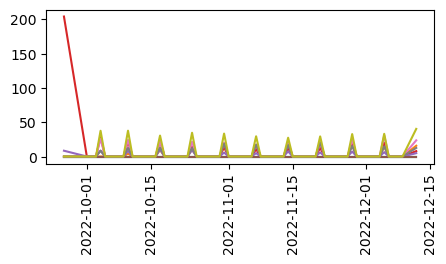

DBSF1386 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


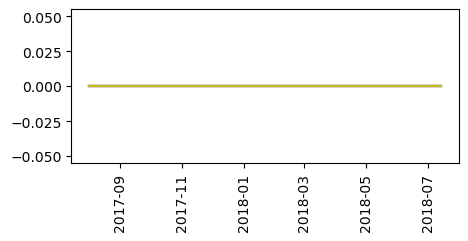

DBSF1459 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


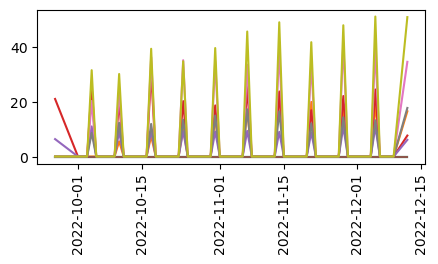

DBSF1466 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


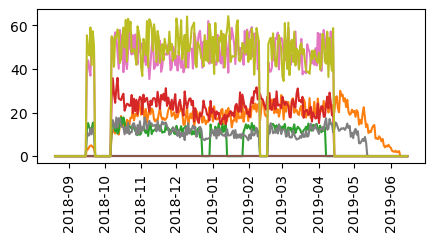

DBSF1469 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


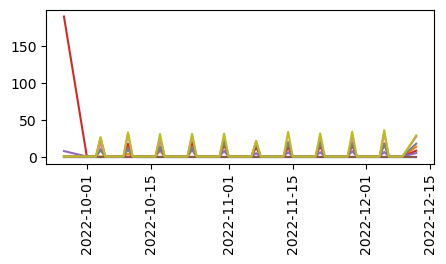

DBSF1490 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


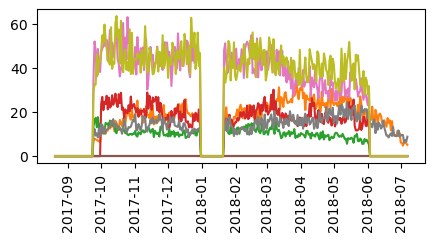

DBSF1505 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


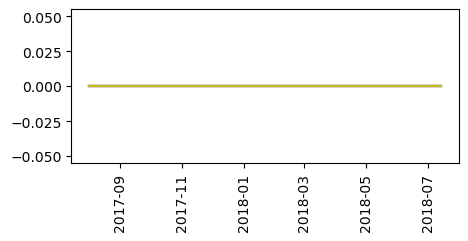

DBSF1507 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


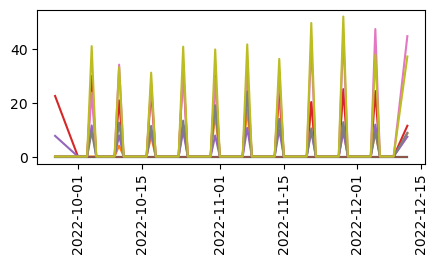

DBSF1539 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


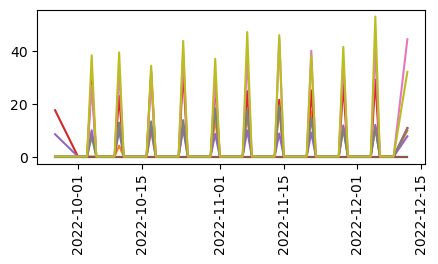

DBSF1554 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


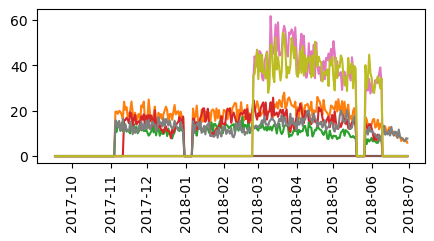

DBSF1601 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


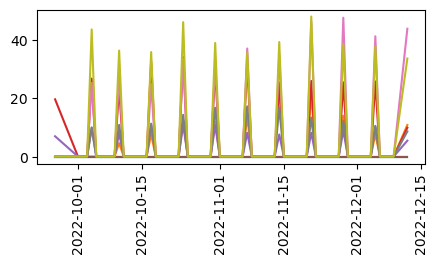

DBSF1621 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


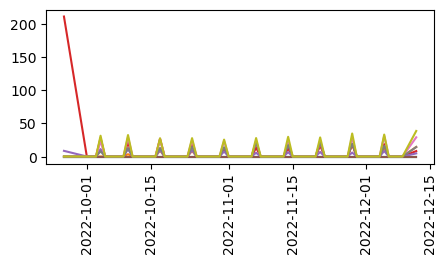

DBSF1644 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


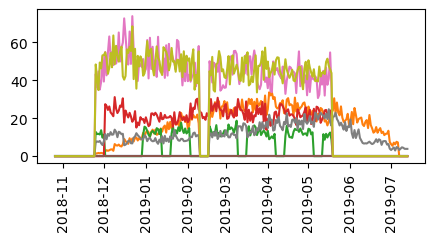

DBSF1645 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


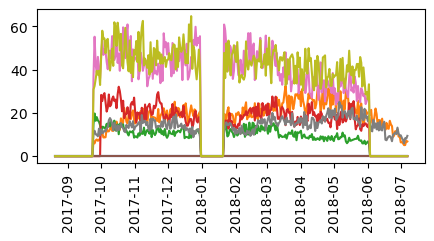

DBSF1673 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


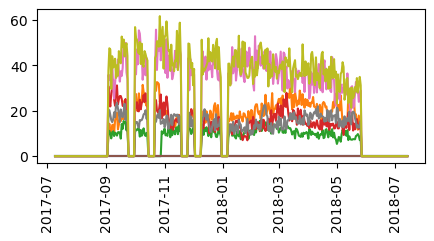

DBSF1757 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


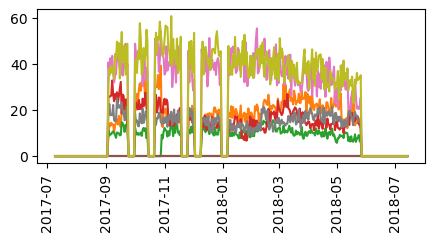

DBSF1767 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


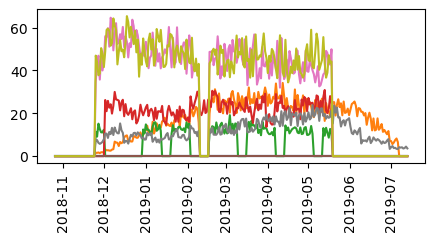

DBSF1871 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


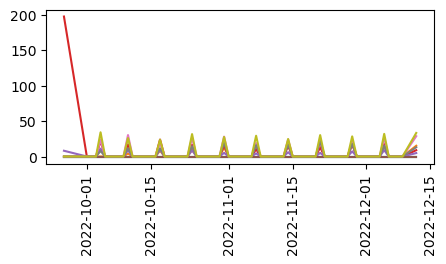

DBSF1873 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


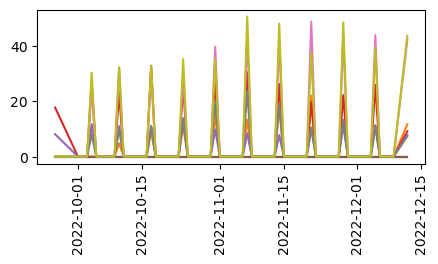

DBSF1880 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


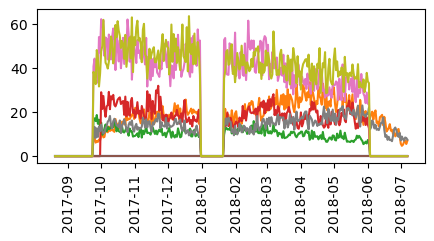

DBSF1886 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


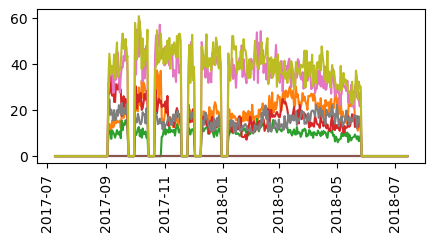

DBSF1916 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


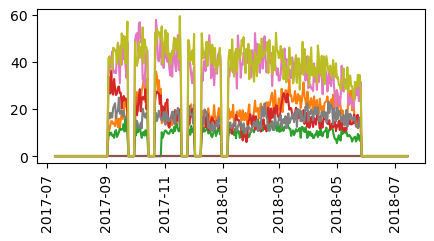

DBSF1921 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


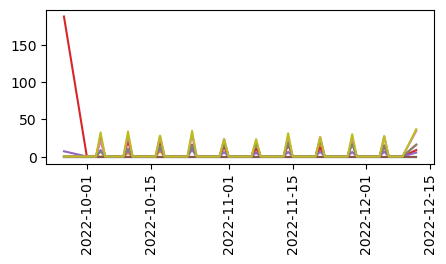

DBSF1934 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


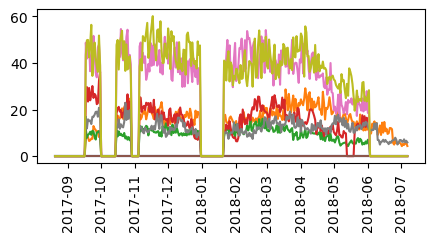

DBSF1974 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


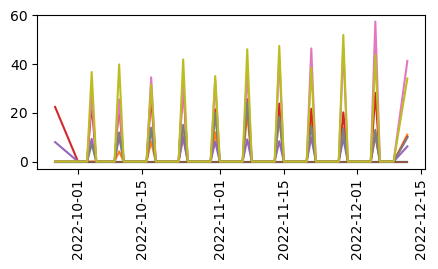

DBSF1975 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


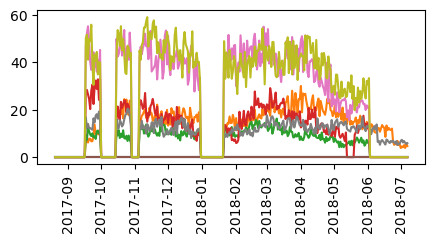

DBSF1991 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


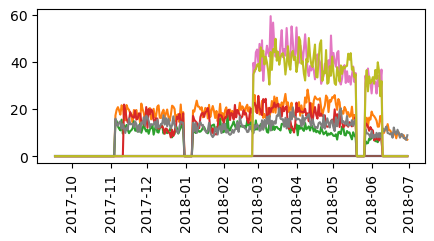

DBSF1998 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


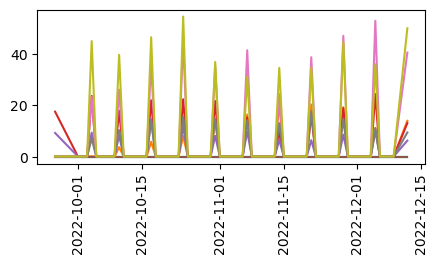

DBSF2008 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


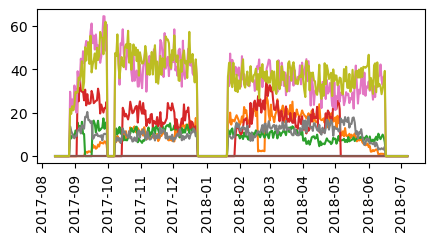

DBSF2027 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


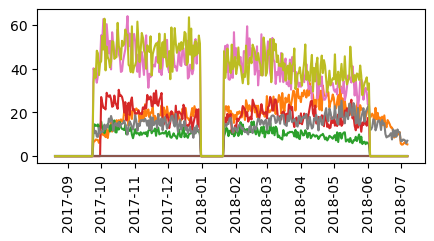

DBSF2032 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


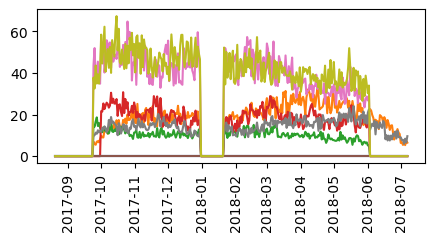

DBSF2044 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


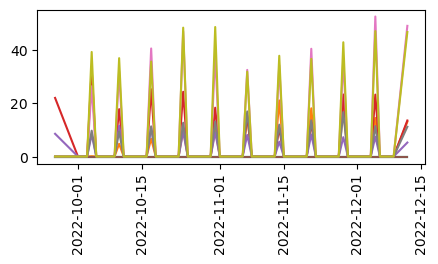

DBSF2117 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


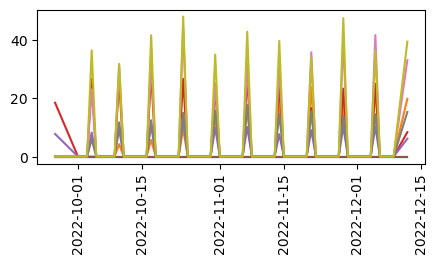

DBSF2191 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


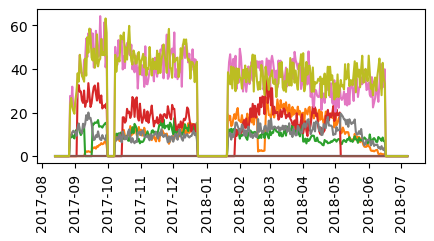

DBSF2212 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


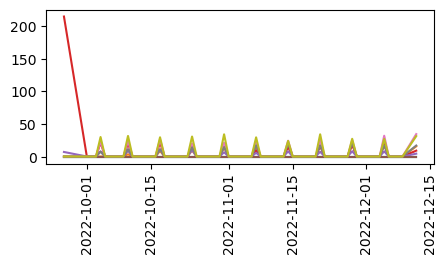

DBSF2218 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


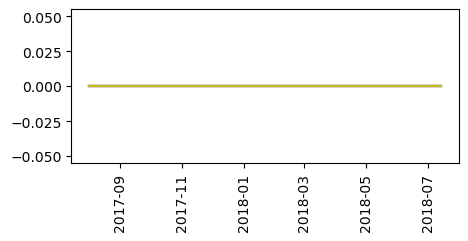

DBSF2244 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


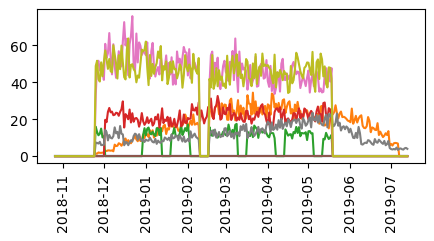

DBSF2252 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


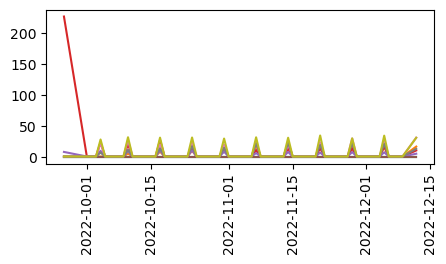

DBSF2256 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


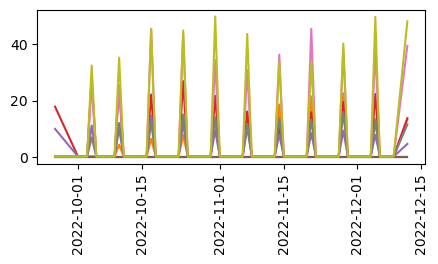

DBSF2259 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


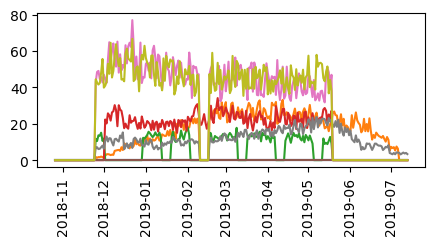

DBSF2274 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


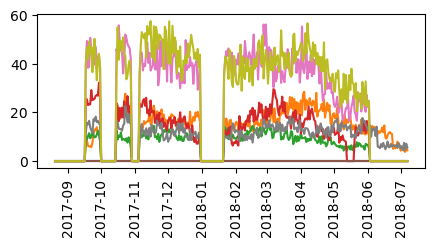

DBSF2318 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


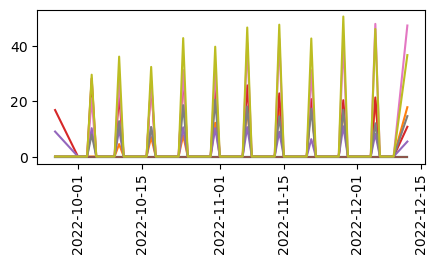

DBSF2319 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


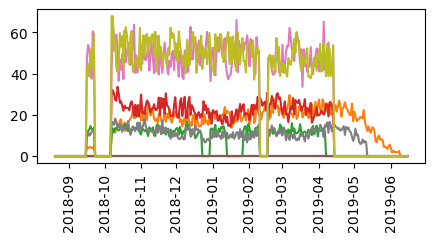

DBSF2334 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


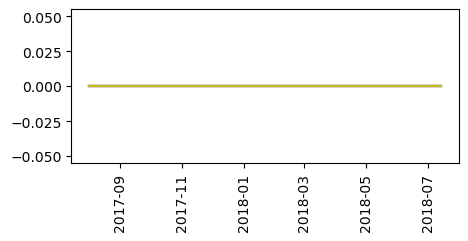

DBSF2335 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


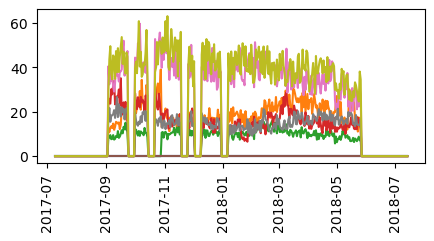

DBSF2347 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


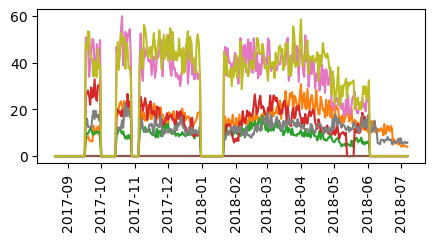

DBSF2352 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


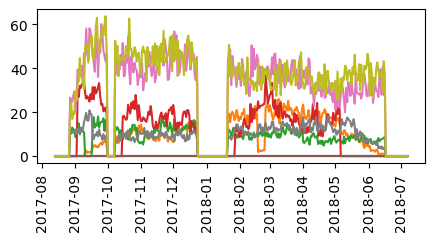

DBSF2360 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


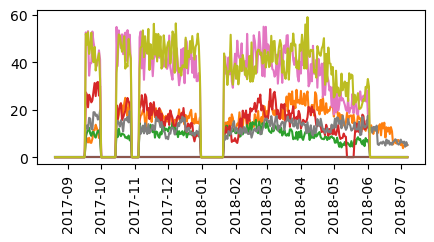

DBSF2371 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


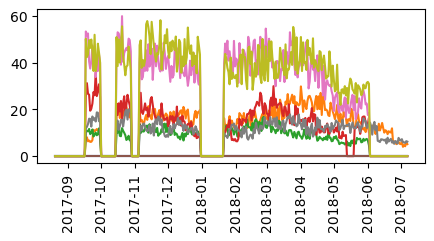

DBSF2376 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


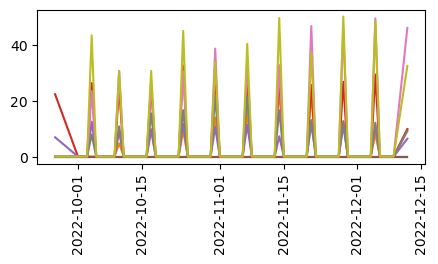

DBSF2378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


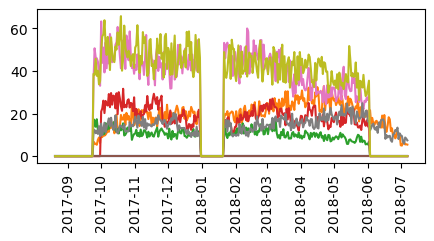

DBSF2389 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


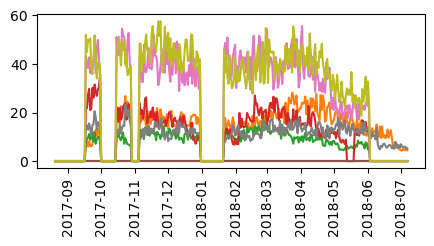

DBSF2413 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


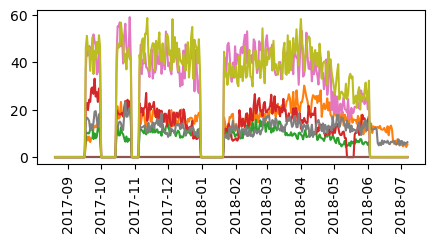

DBSF2422 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


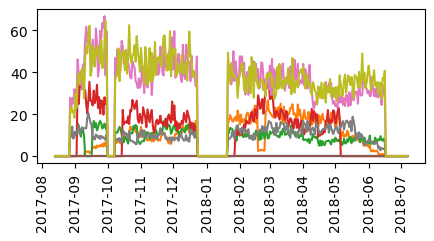

DBSF2471 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


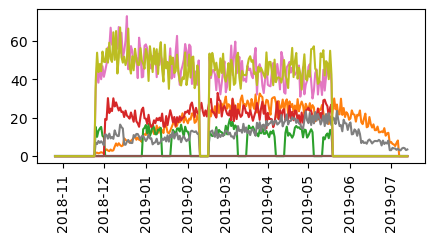

DBSF2525 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


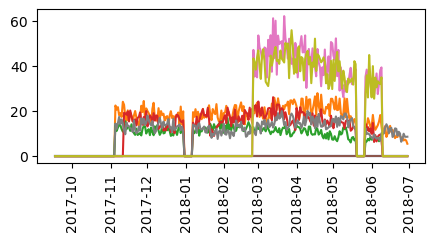

DBSF2571 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


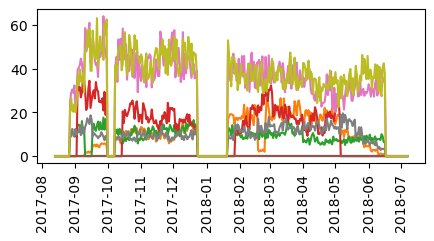

DBSF2630 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


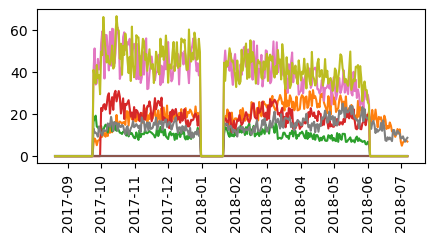

DBSF2640 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


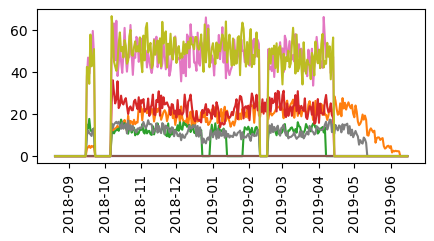

DBSF2681 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


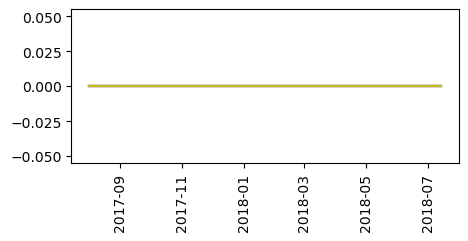

DBSF2686 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


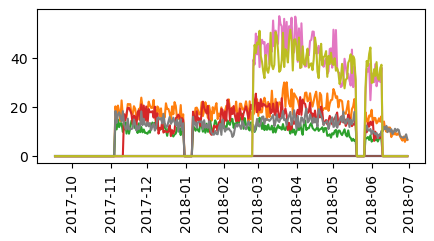

DBSF2689 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


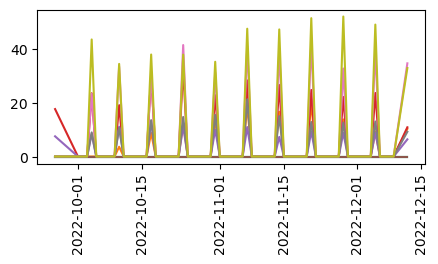

DBSF2708 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


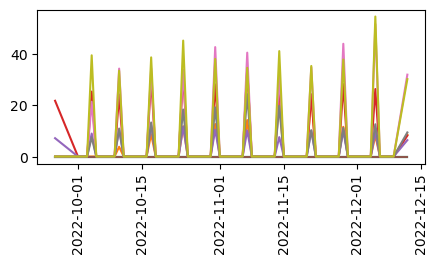

DBSF2752 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


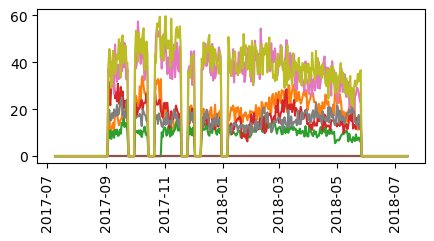

DBSF2803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


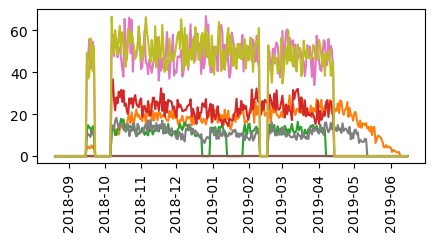

DBSF2809 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


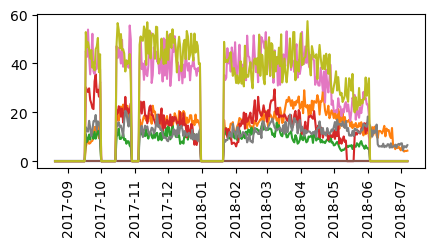

DBSF2822 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


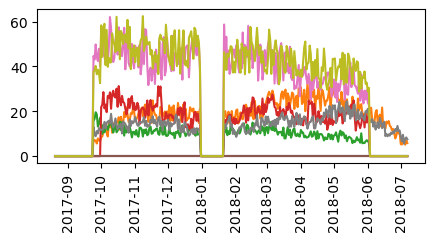

DBSF2823 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


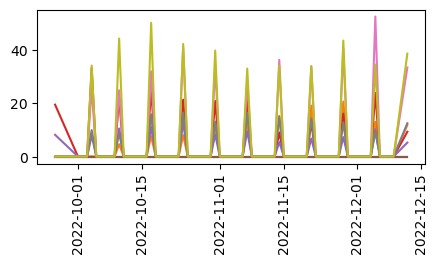

DBSF2828 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


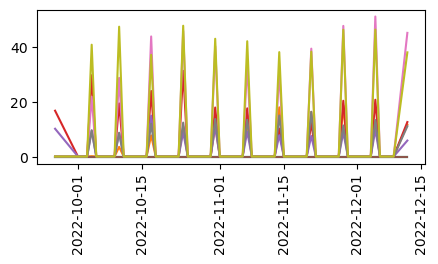

DBSF2832 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


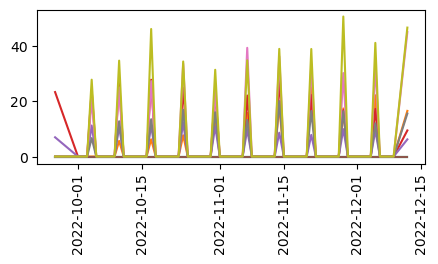

DBSF2846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


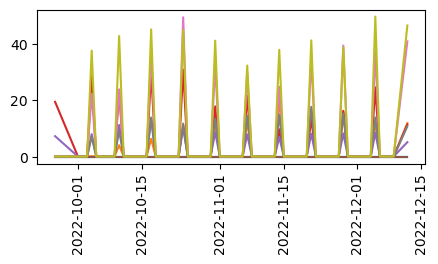

DBSF2888 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


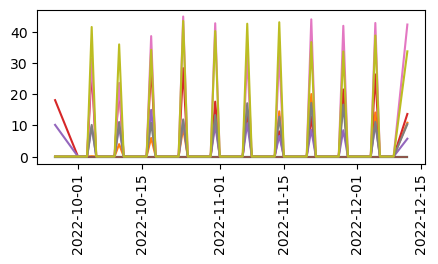

DBSF2911 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


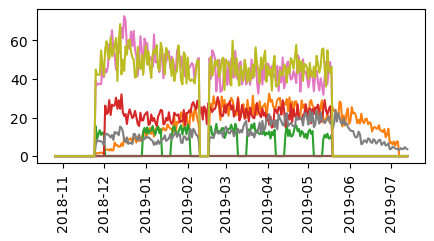

DBSF2918 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


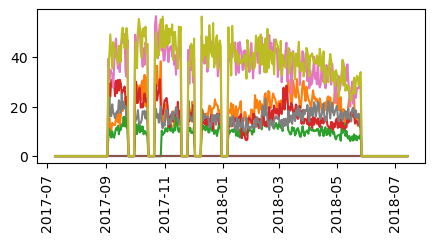

DBSF2927 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


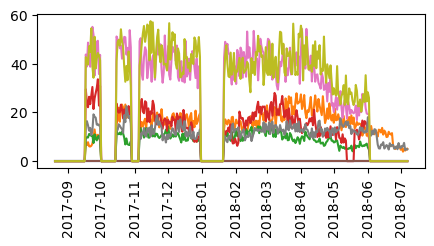

DBSF2989 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


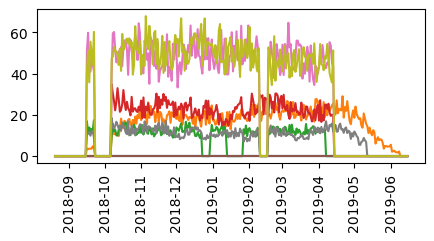

DBSF2992 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


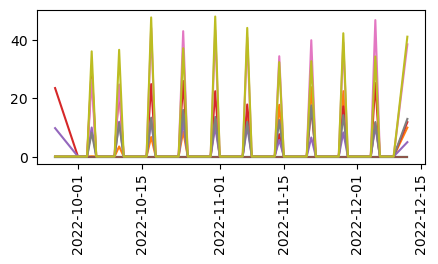

DBSF3001 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


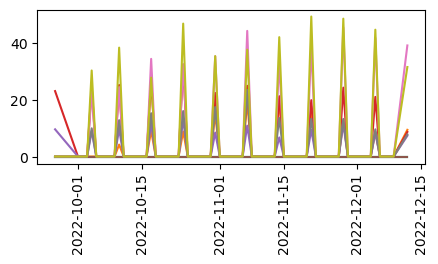

DBSF3010 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


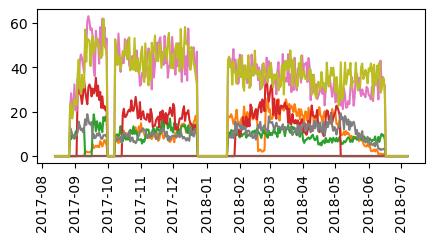

DBSF3034 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


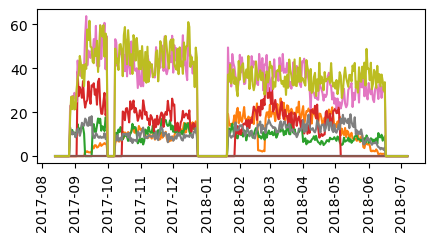

DBSF3067 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


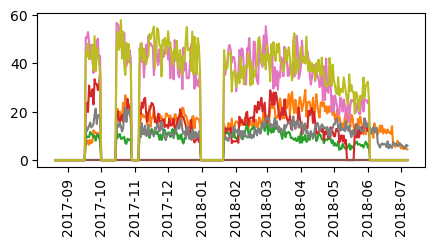

DBSF3068 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


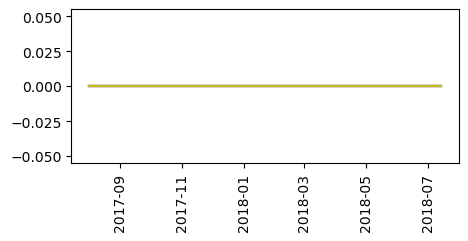

DBSF3075 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


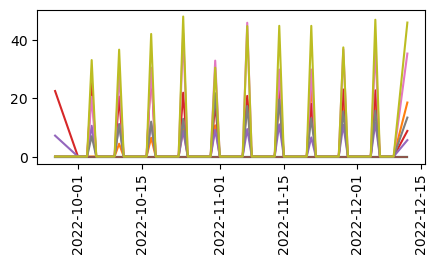

DBSF3076 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


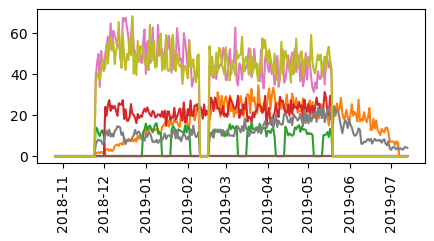

DBSF3118 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


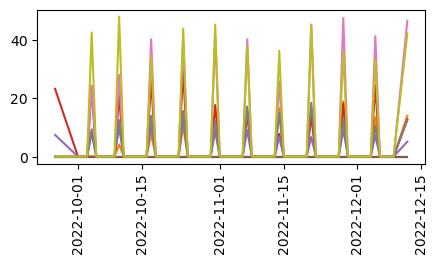

DBSF3132 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


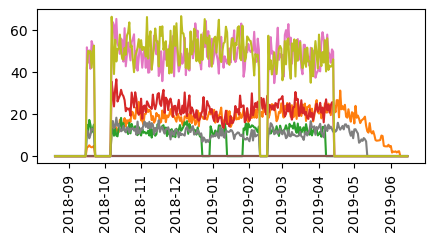

DBSF3135 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


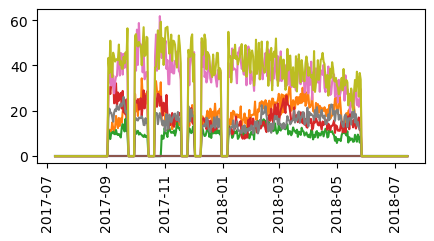

DBSF3165 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


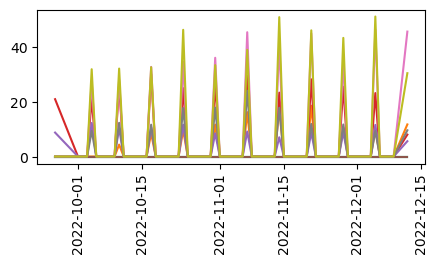

DBSF3172 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


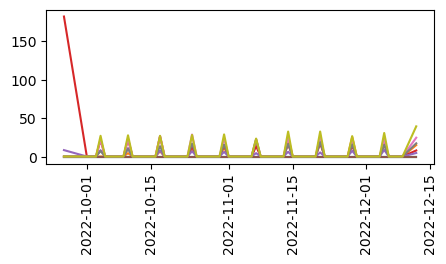

DBSF3199 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


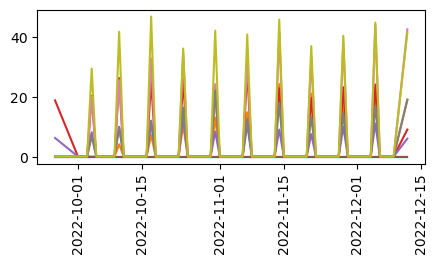

DBSF3205 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


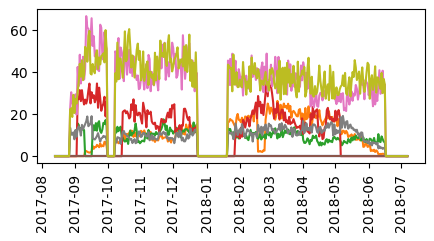

DBSF3214 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


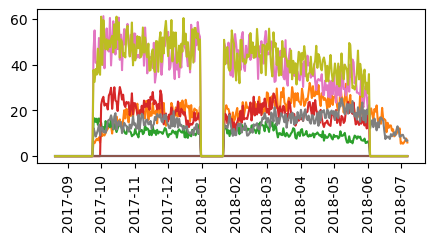

DBSF3228 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


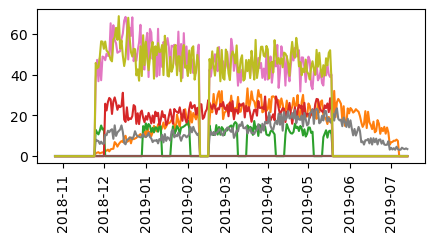

DBSF3311 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


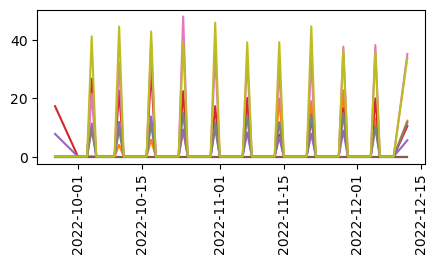

DBSF3367 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


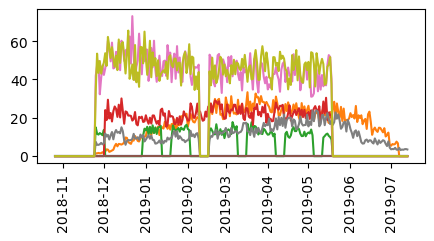

DBSF3372 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


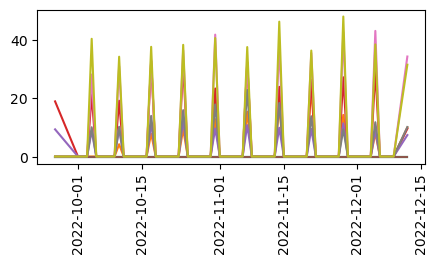

DBSF3383 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


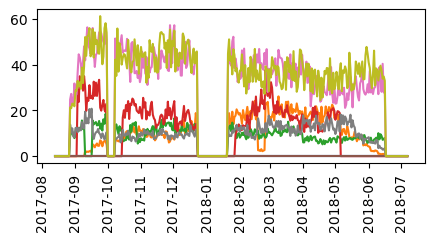

DBSF3399 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


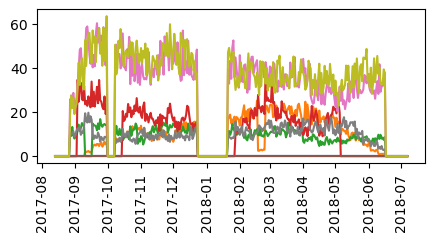

DBSF3425 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


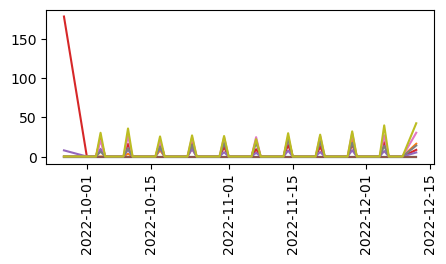

DBSF3426 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


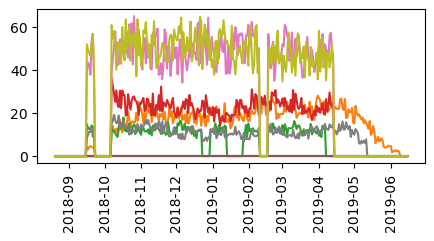

DBSF3467 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


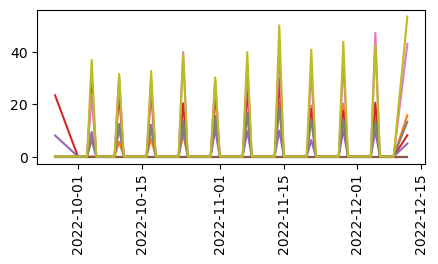

DBSF3470 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


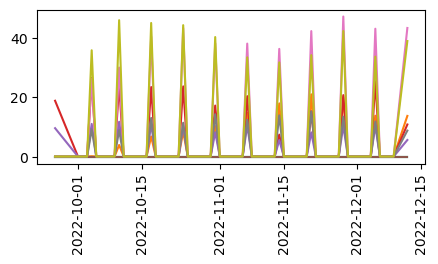

DBSF3490 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


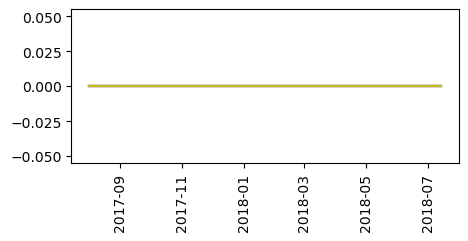

DBSF3527 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


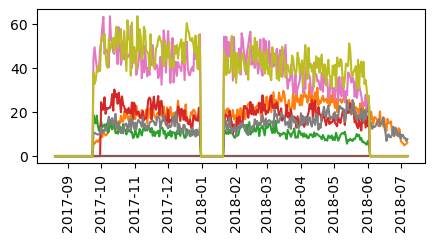

DBSF3532 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


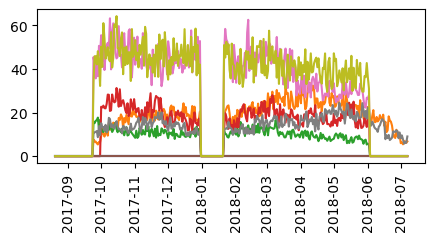

DBSF3546 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


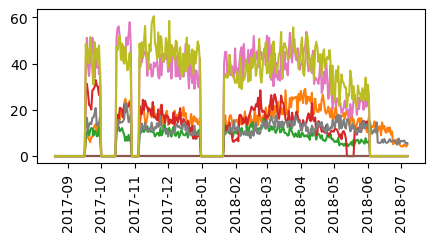

DBSF3567 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


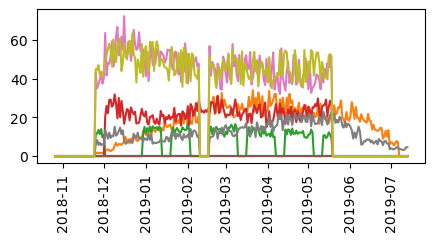

DBSF3583 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


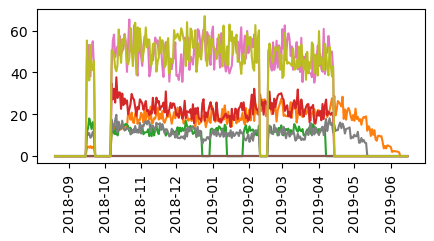

DBSF3593 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


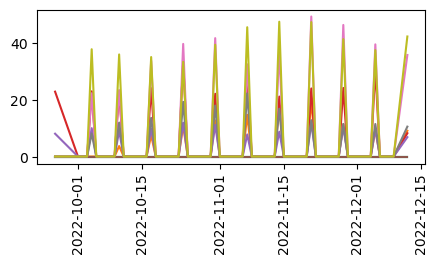

DBSF3597 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


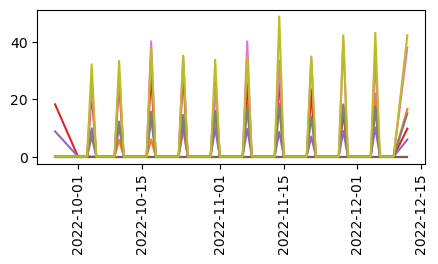

DBSF3655 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


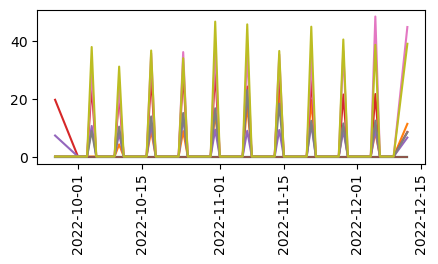

DBSF3661 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


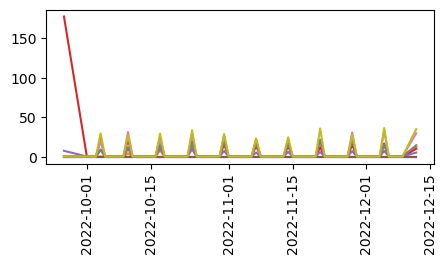

DBSF3705 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


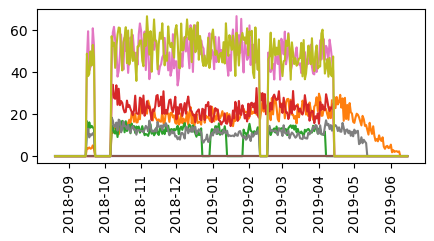

DBSF3755 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


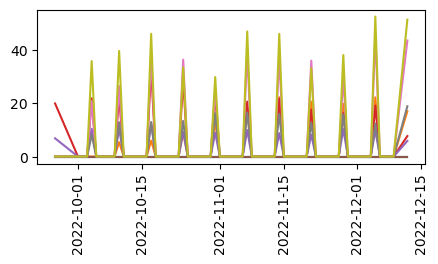

DBSF3803 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


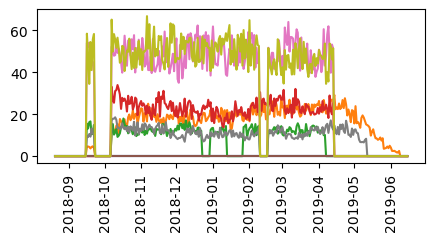

DBSF3841 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


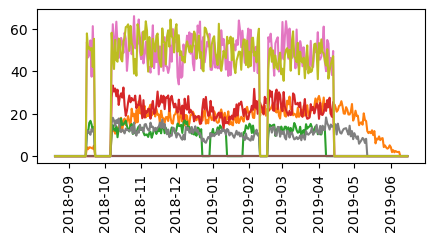

DBSF3850 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


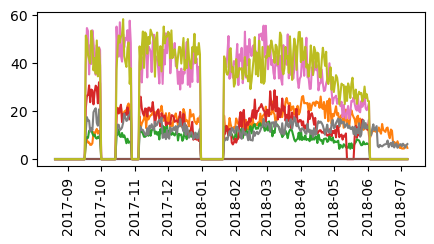

DBSF3891 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


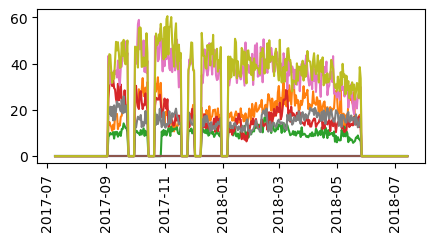

DBSF3906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


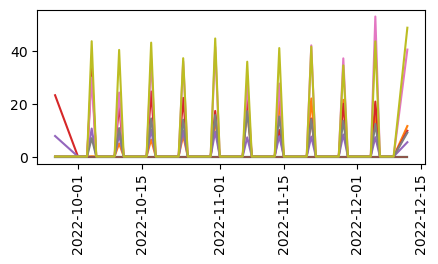

DBSF3911 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


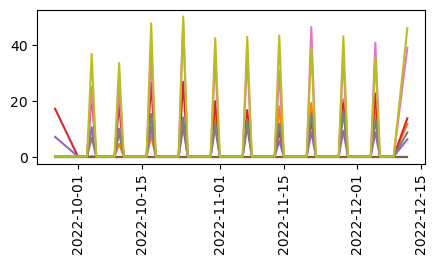

DBSF3912 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


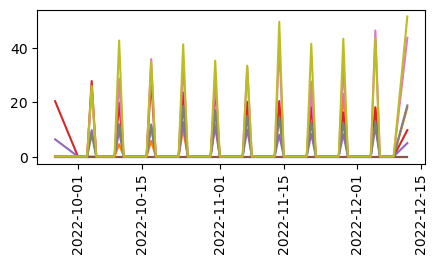

DBSF3924 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


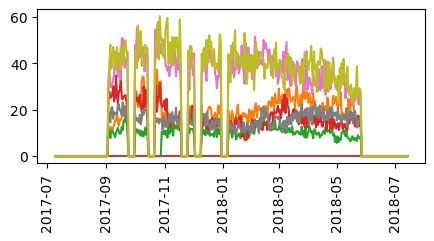

DBSF3932 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


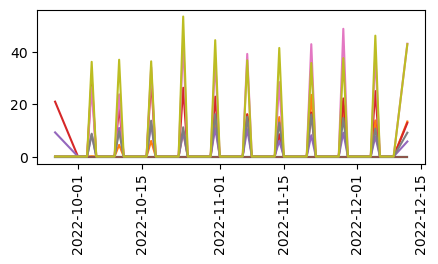

DBSF3990 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


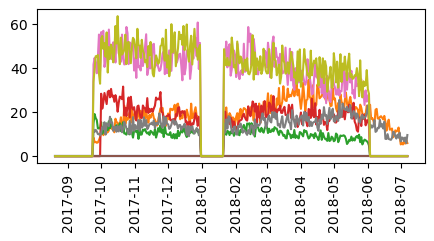

DBSF3998 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


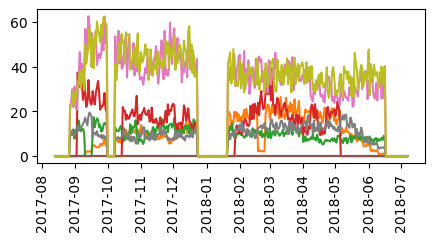

DBSF4004 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


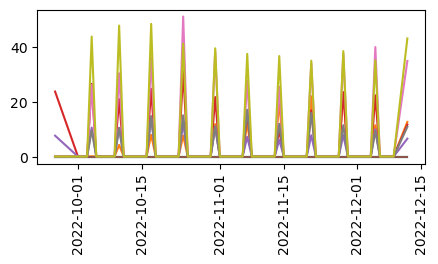

DBSF4013 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


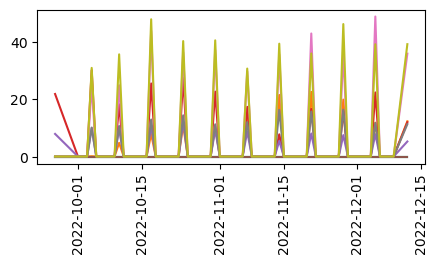

DBSF4049 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


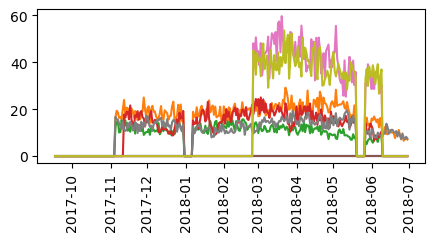

DBSF4083 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


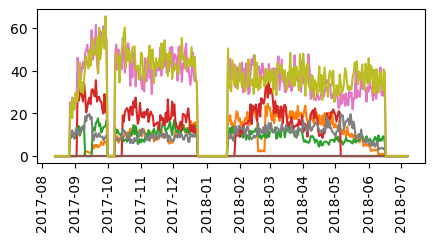

DBSF4101 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


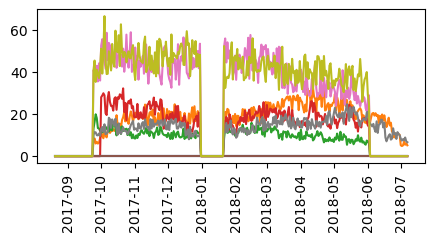

DBSF4111 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


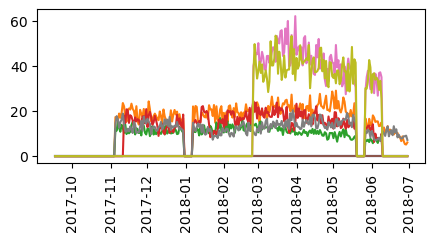

DBSF4121 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


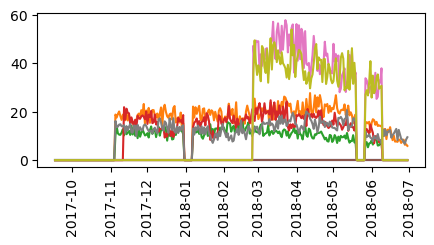

DBSF4146 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


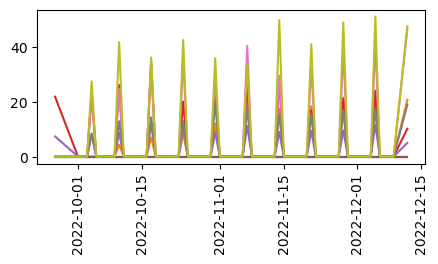

DBSF4154 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


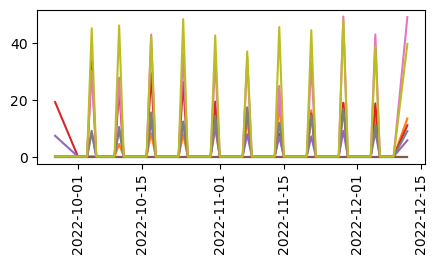

DBSF4163 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


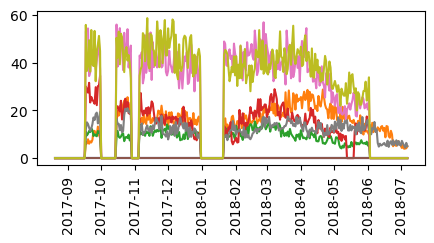

DBSF4181 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


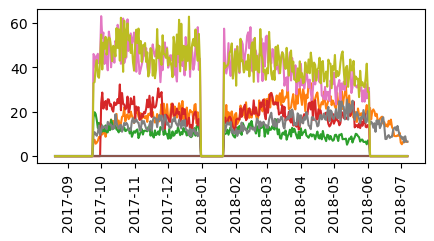

DBSF4197 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


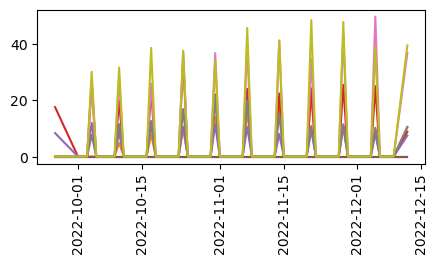

DBSF4202 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


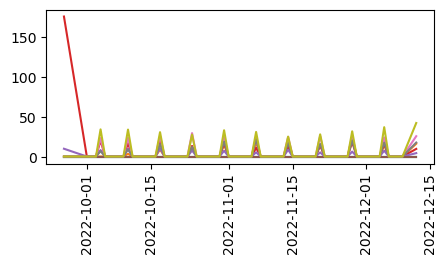

DBSF4212 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


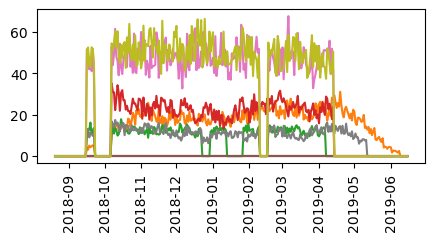

DBSF4250 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


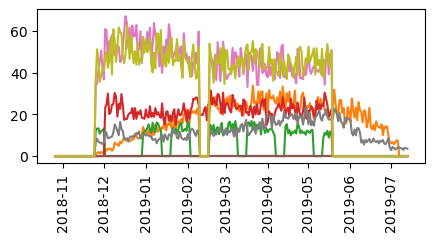

DBSF4283 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


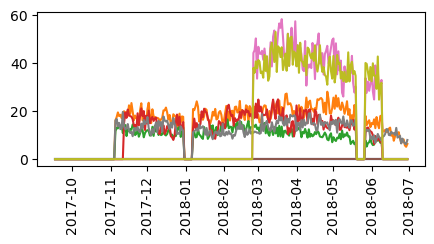

DBSF4310 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


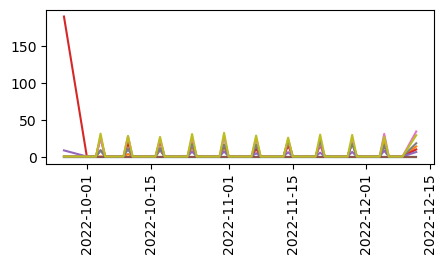

DBSF4329 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


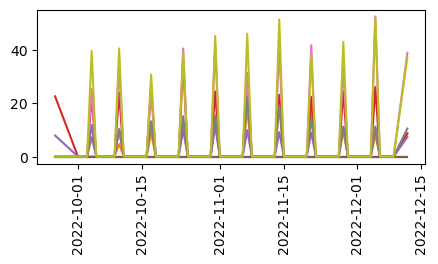

DBSF4371 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


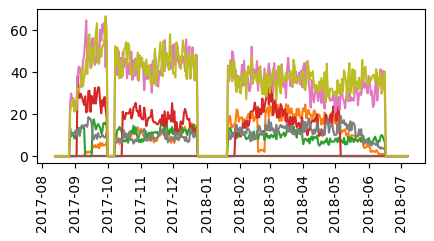

DBSF4401 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


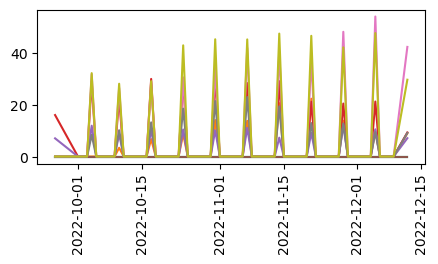

DBSF4442 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


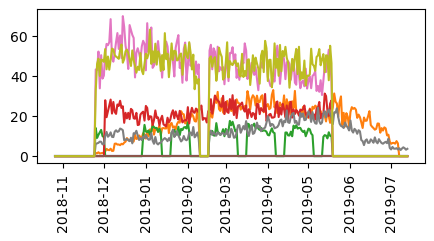

DBSF4466 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


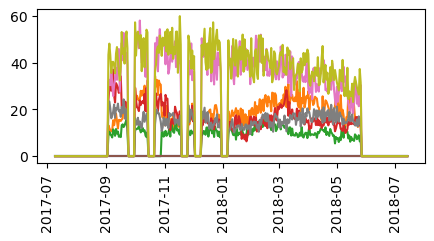

DBSF4554 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


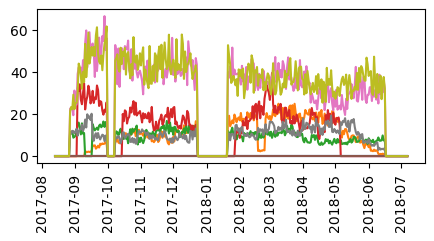

DBSF4640 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


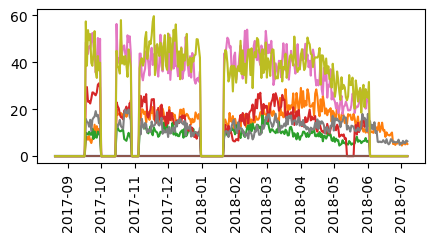

DBSF4646 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


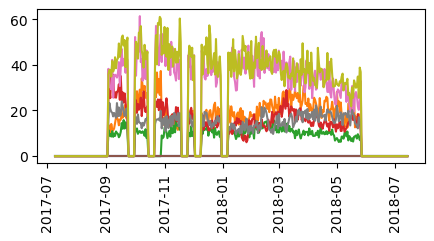

DBSF4659 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


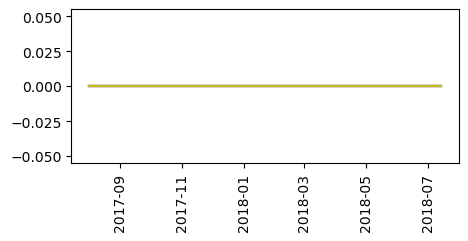

DBSF4678 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


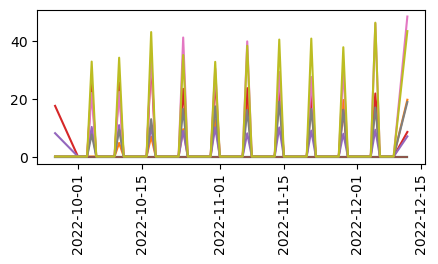

DBSF4713 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


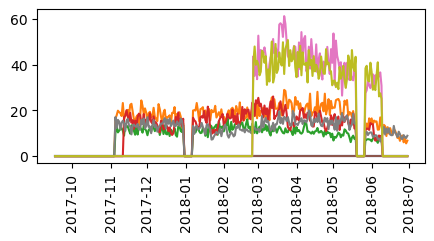

DBSF4716 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


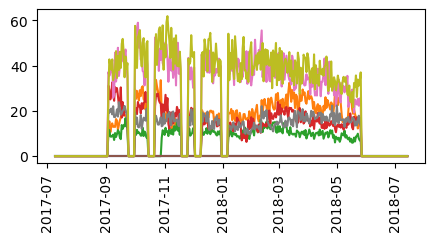

DBSF4720 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


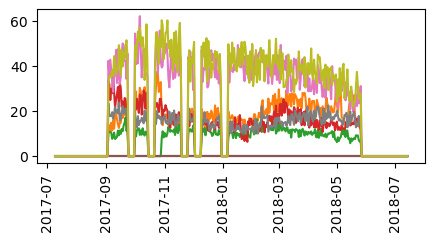

DBSF4752 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


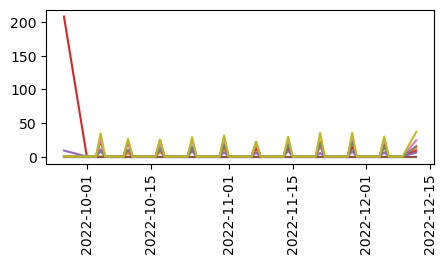

DBSF4800 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


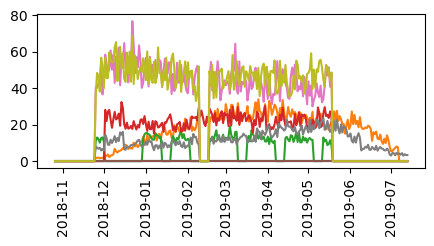

DBSF4812 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


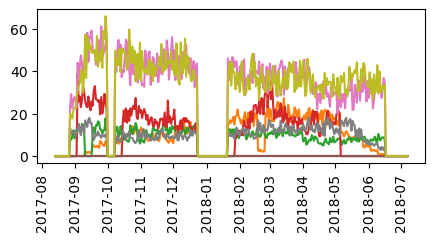

DBSF4814 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


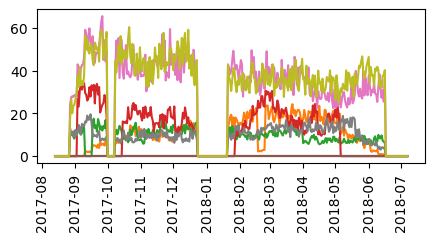

DBSF4817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


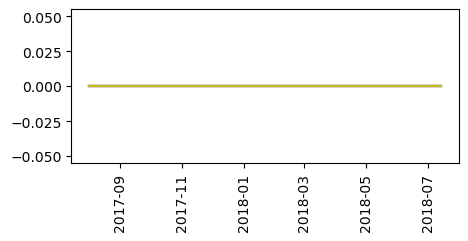

DBSF4846 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


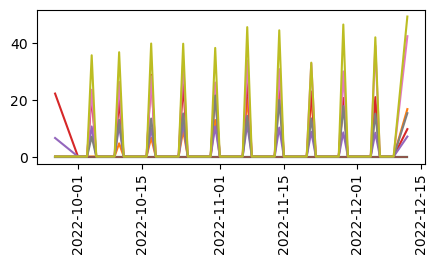

DBSF4885 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


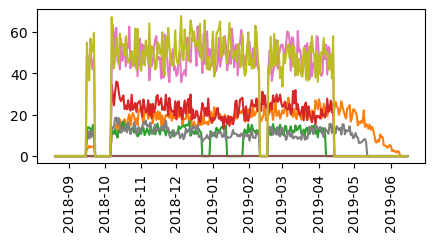

DBSF4907 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


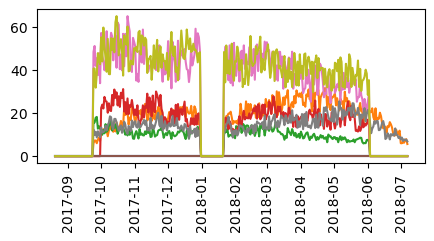

DBSF4964 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


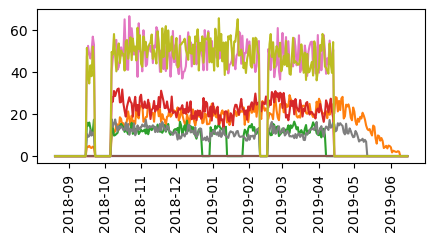

DBSF4972 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


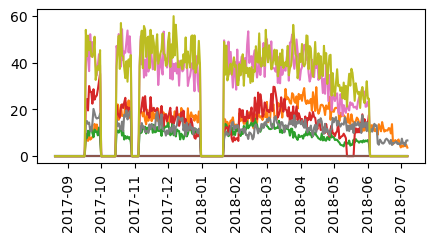

DBSF5022 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


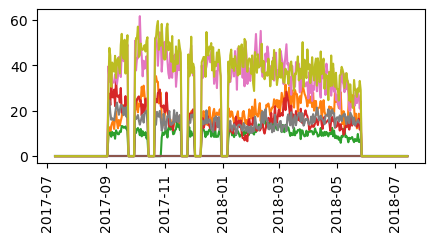

DBSF5056 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


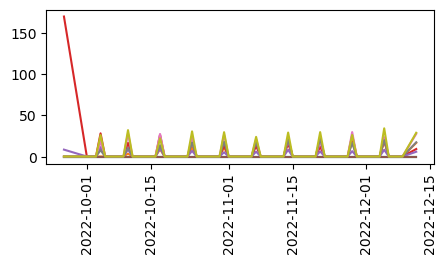

DBSF5095 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


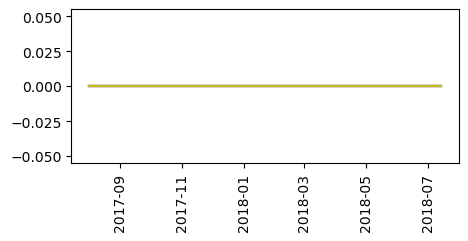

DBSF5121 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


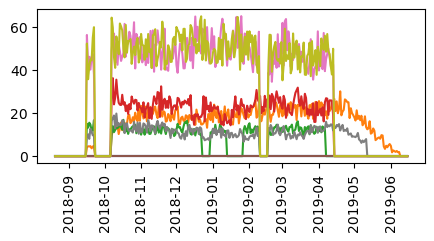

DBSF5170 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


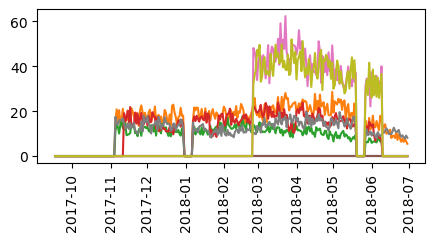

DBSF5193 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


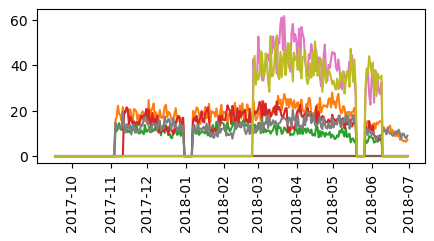

DBSF5216 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


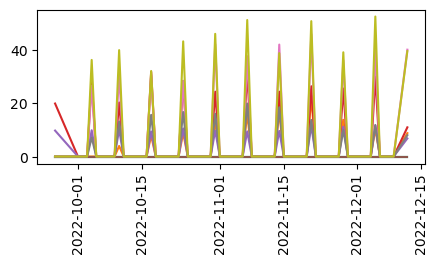

DBSF5227 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


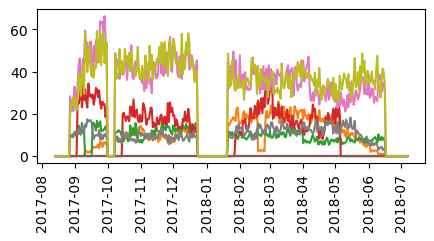

DBSF5240 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


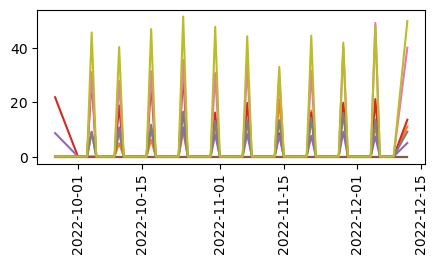

DBSF5243 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


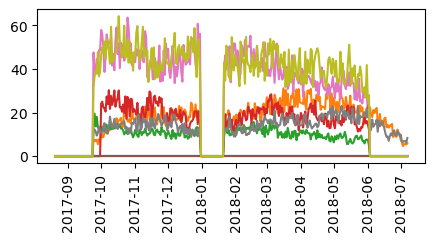

DBSF5271 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


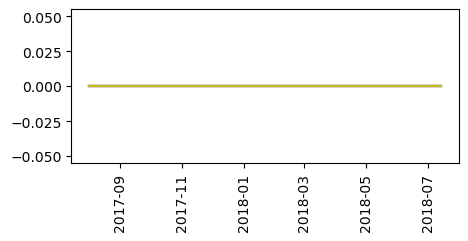

DBSF5299 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


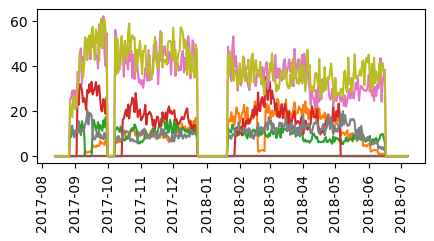

DBSF5303 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


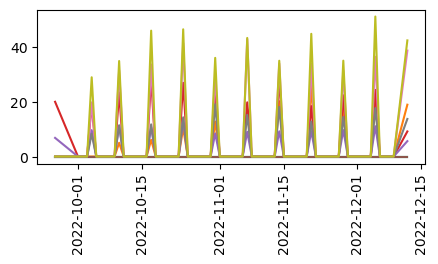

DBSF5344 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


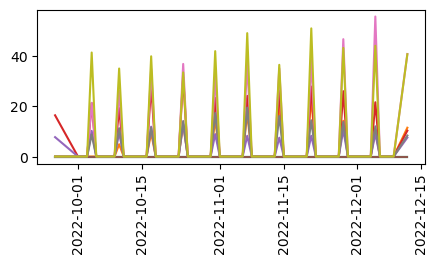

DBSF5351 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


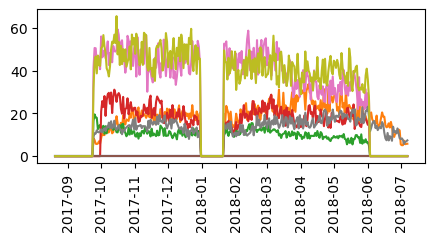

DBSF5403 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


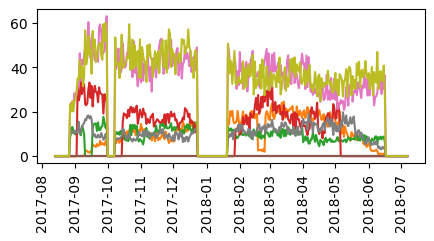

DBSF5429 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


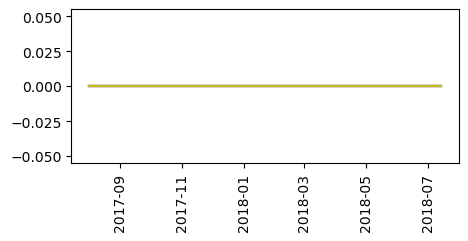

DBSF5452 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


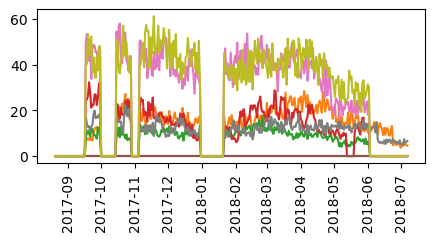

DBSF5534 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


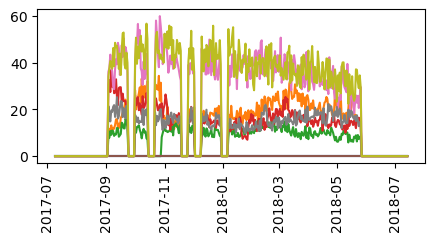

DBSF5549 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


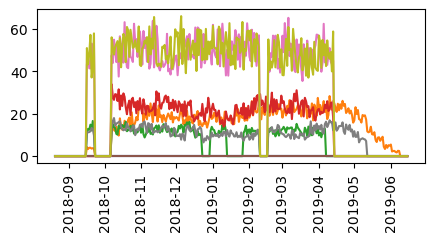

DBSF5566 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


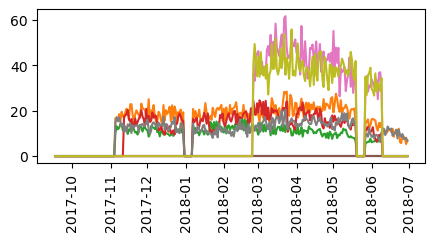

DBSF5575 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


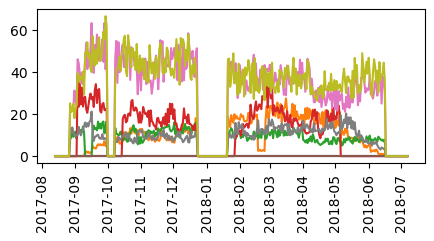

DBSF5587 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


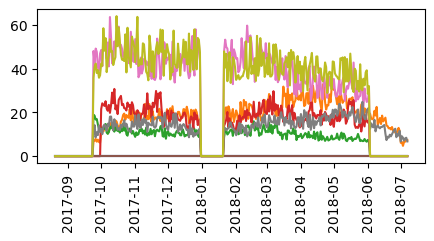

DBSF5607 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


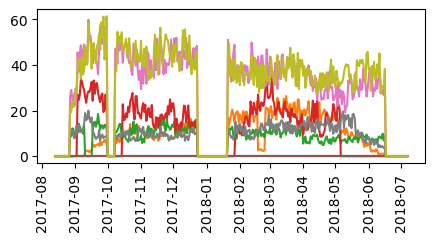

DBSF5628 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


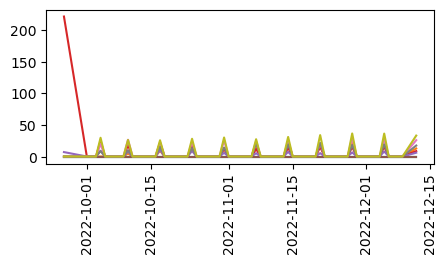

DBSF5644 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


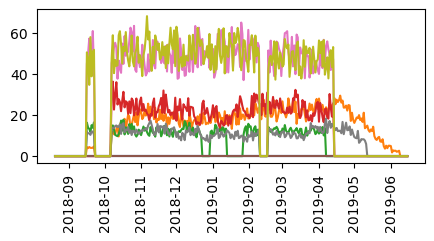

DBSF5661 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


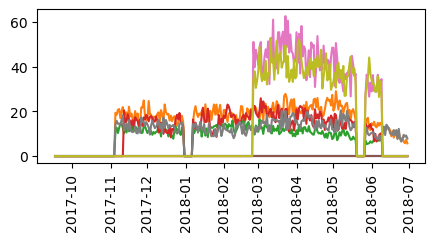

DBSF5686 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


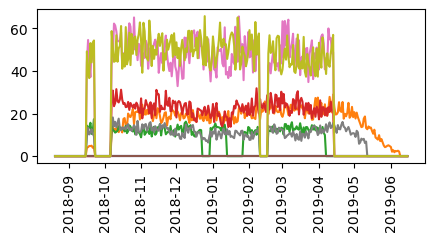

DBSF5705 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


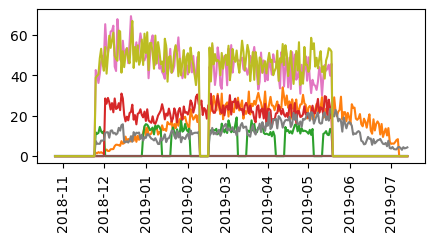

DBSF5734 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


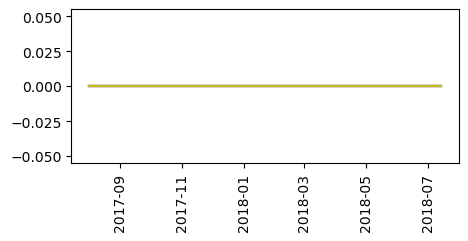

DBSF5764 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


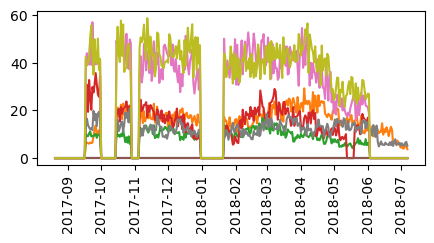

DBSF5769 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


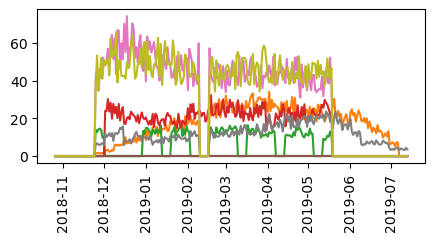

DBSF5772 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


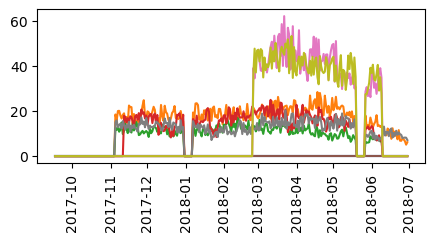

DBSF5823 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


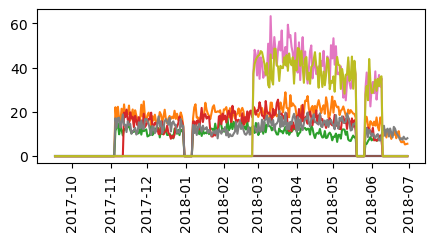

DBSF5833 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


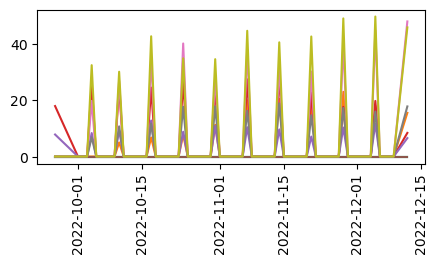

DBSF5847 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


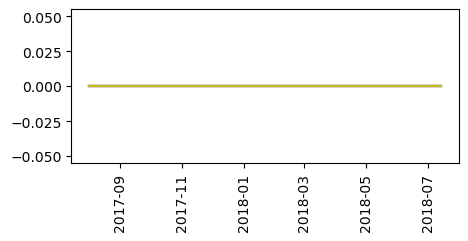

DBSF5848 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


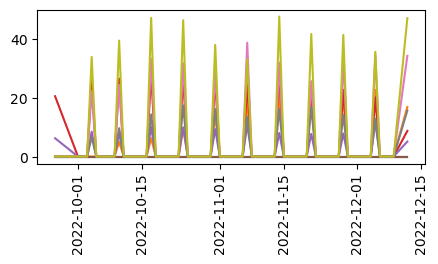

DBSF5875 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


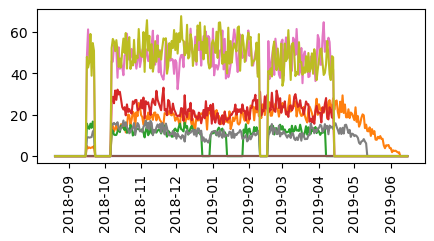

DBSF5973 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


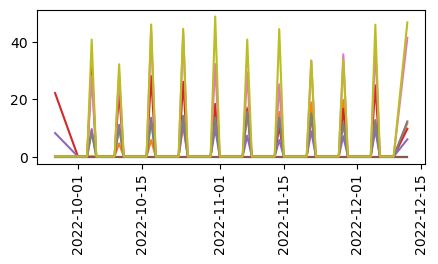

DBSF6030 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


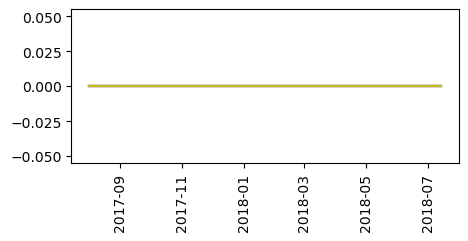

DBSF6039 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


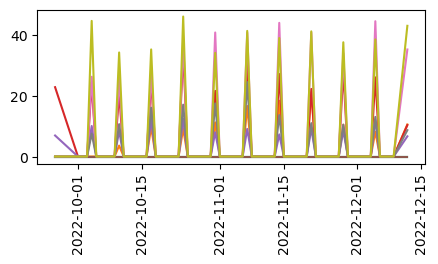

DBSF6042 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


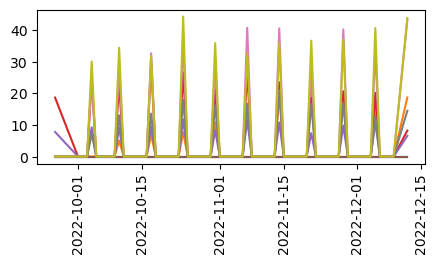

DBSF6053 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


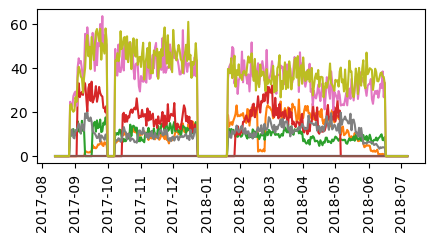

DBSF6057 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


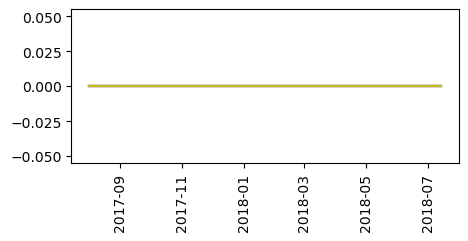

DBSF6059 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


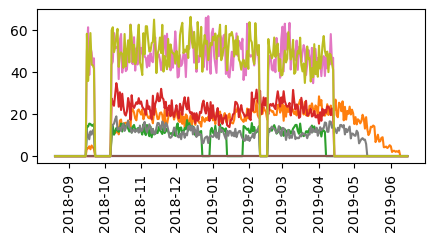

DBSF6134 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


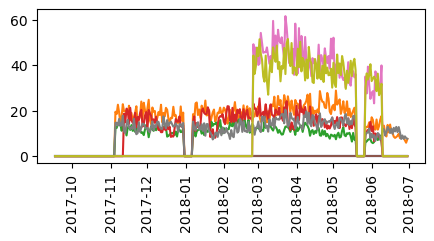

DBSF6144 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


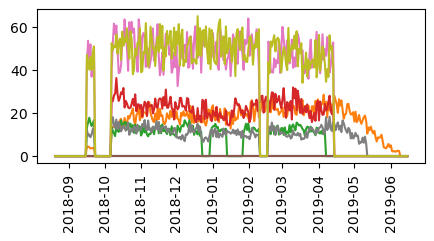

DBSF6147 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


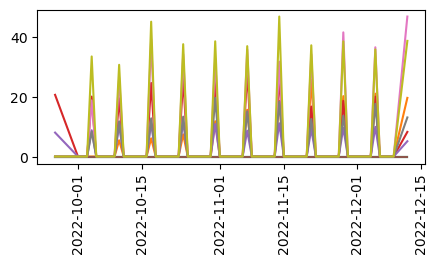

DBSF6163 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


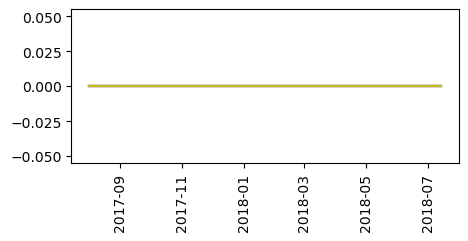

DBSF6174 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


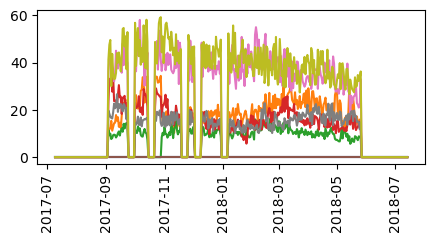

DBSF6206 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


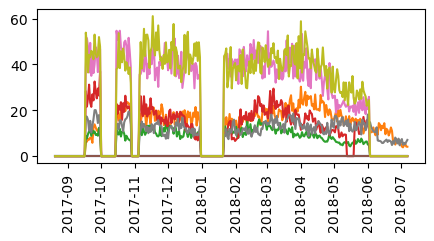

DBSF6211 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


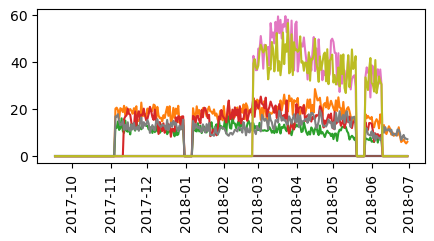

DBSF6218 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


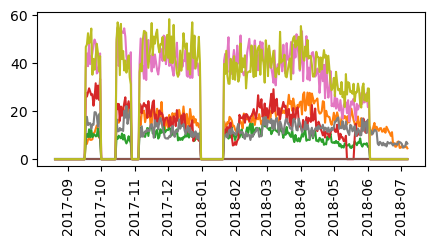

DBSF6295 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


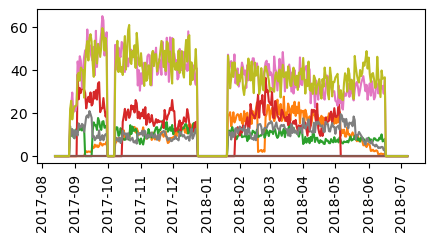

DBSF6298 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


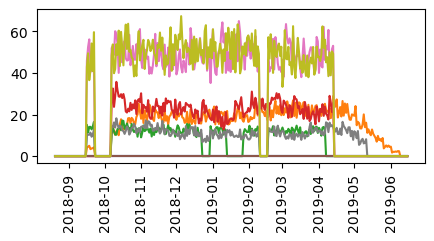

DBSF6305 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


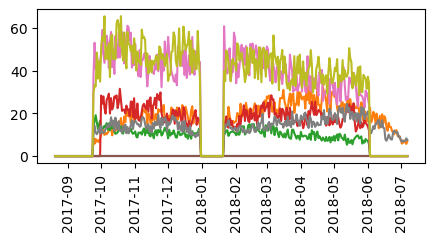

DBSF6318 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


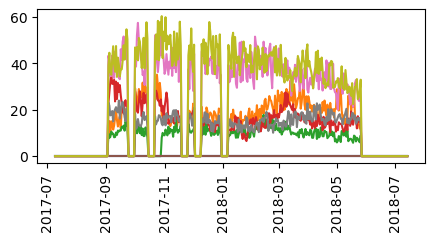

DBSF6441 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


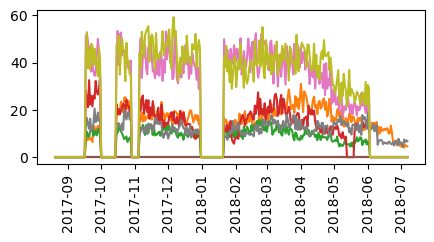

DBSF6473 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


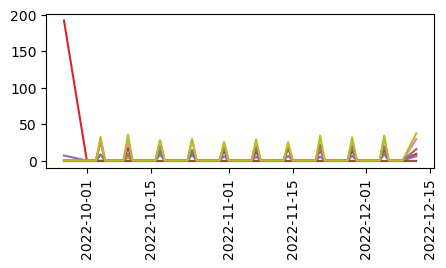

DBSF6497 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


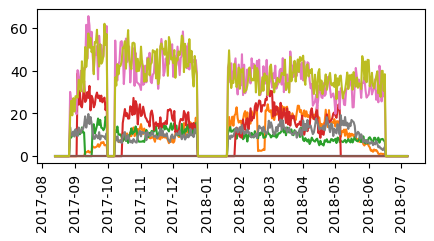

DBSF6502 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


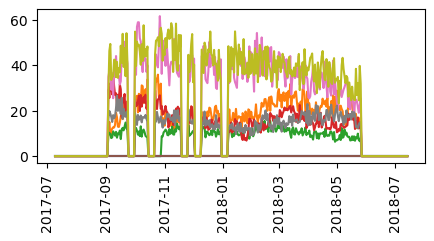

DBSF6503 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


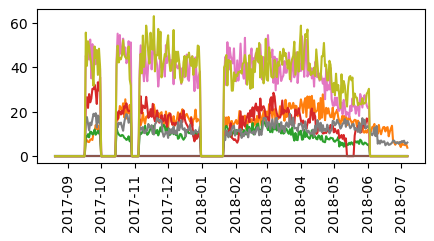

DBSF6522 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


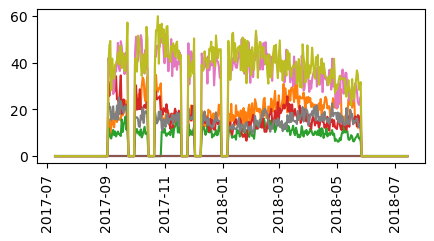

DBSF6576 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


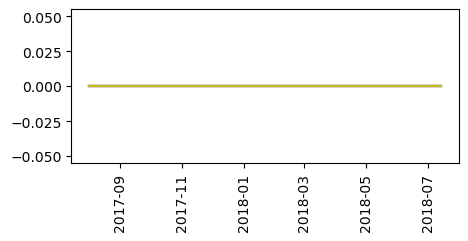

DBSF6618 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


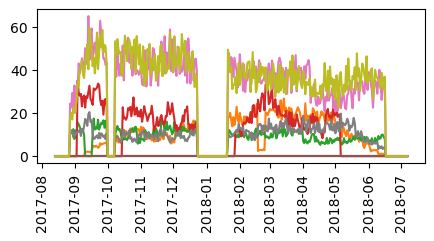

DBSF6619 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


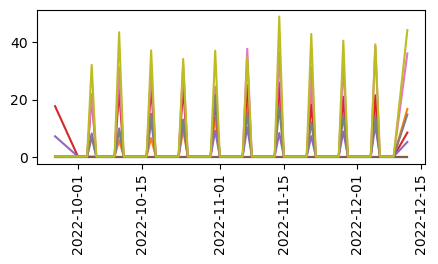

DBSF6641 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


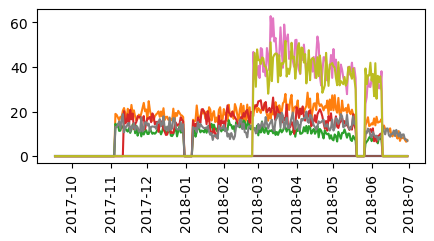

DBSF6690 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


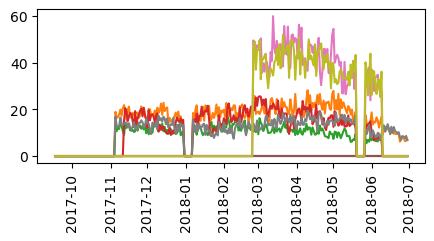

DBSF6699 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


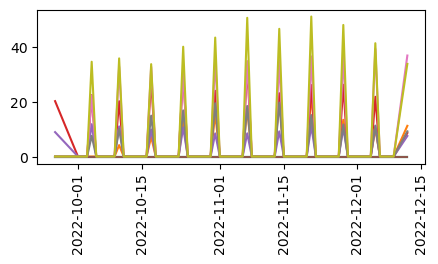

DBSF6771 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


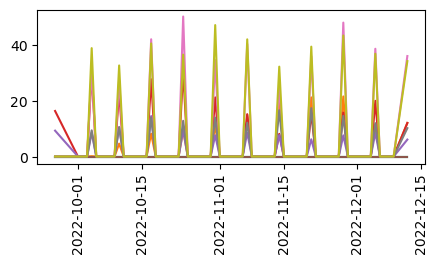

DBSF6806 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


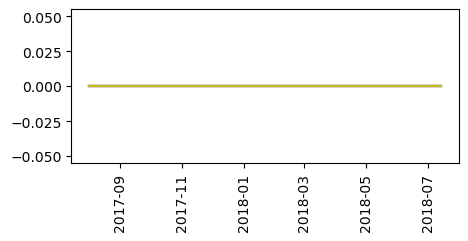

DBSF6817 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


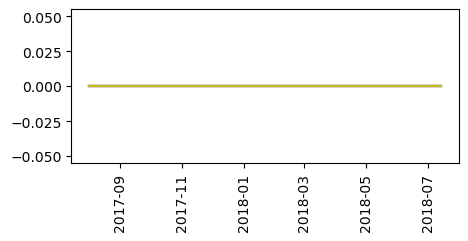

DBSF6833 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


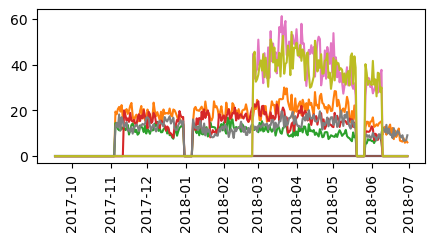

DBSF6892 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


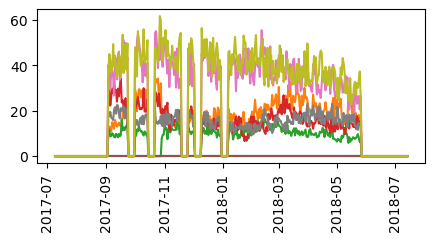

DBSF6914 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


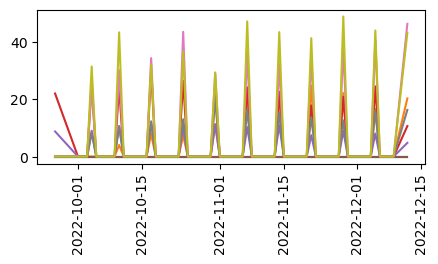

DBSF6949 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


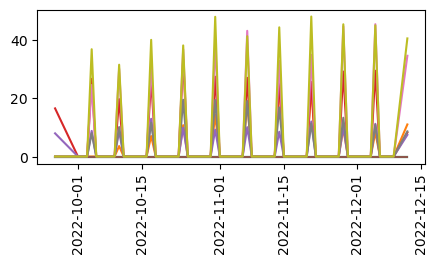

DBSF6979 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


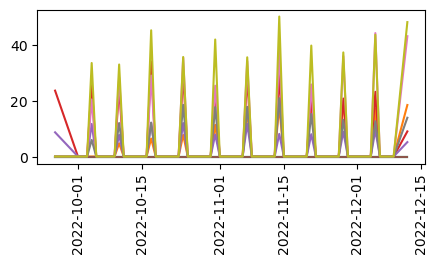

DBSF6990 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


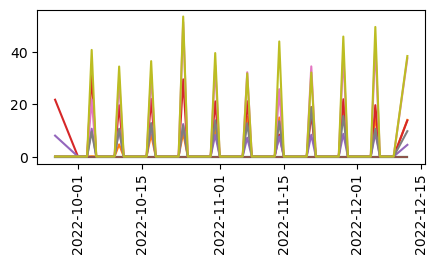

DBSF7114 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


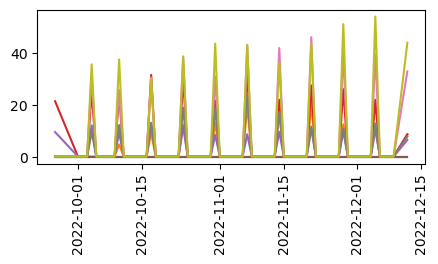

DBSF7130 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


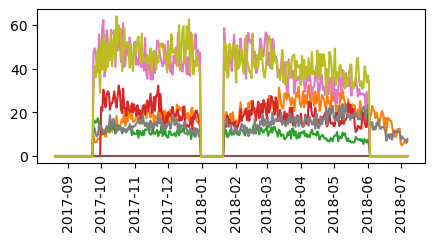

DBSF7151 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


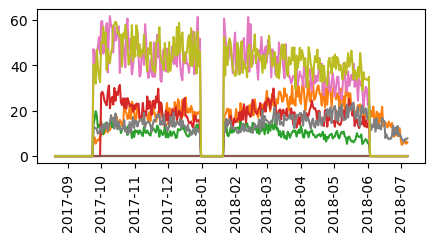

DBSF7185 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


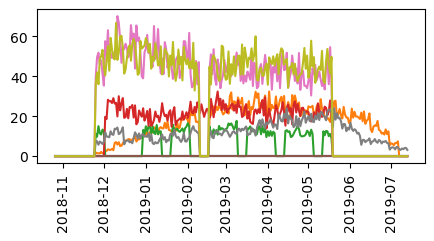

DBSF7186 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


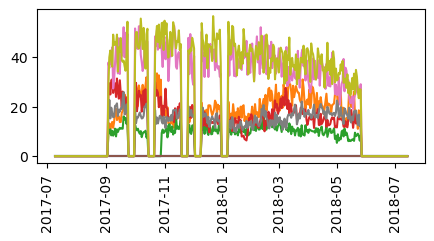

DBSF7195 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


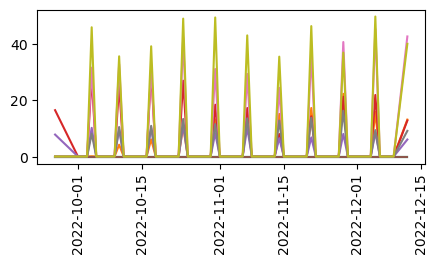

DBSF7198 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


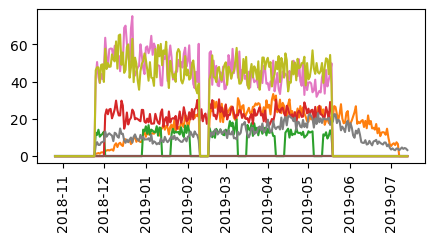

DBSF7221 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


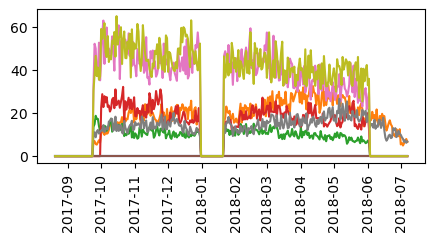

DBSF7294 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


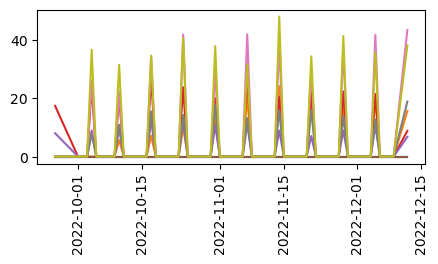

DBSF7339 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


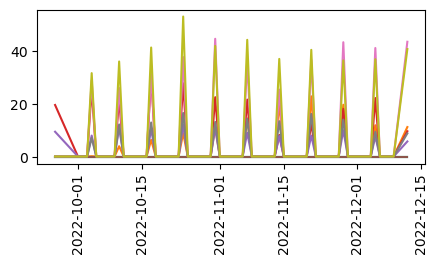

DBSF7419 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


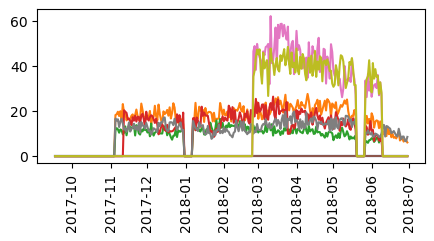

DBSF7476 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


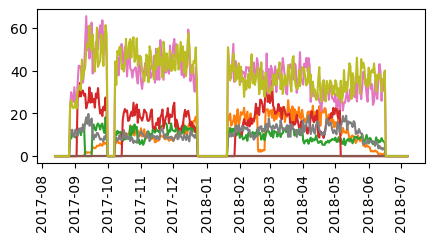

DBSF7477 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


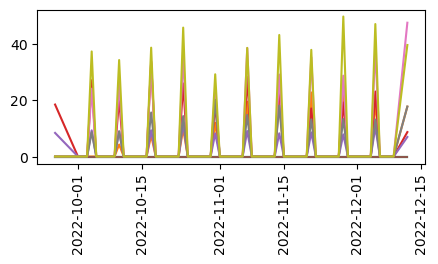

DBSF7548 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


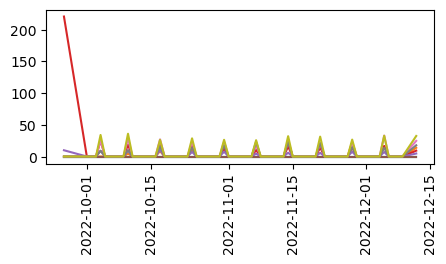

DBSF7633 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


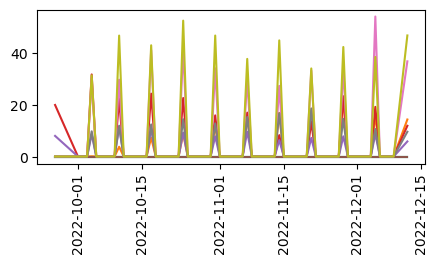

DBSF7641 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


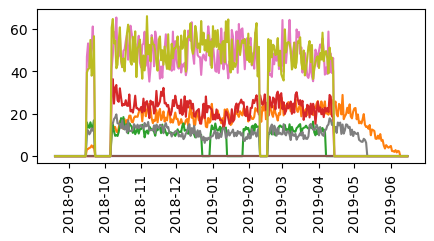

DBSF7654 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


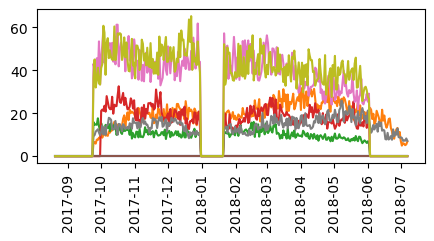

DBSF7666 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


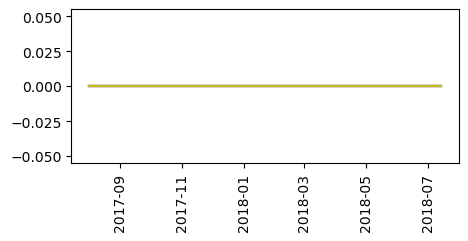

DBSF7673 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


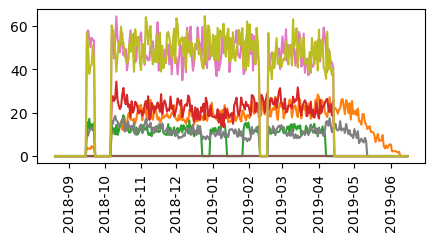

DBSF7679 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


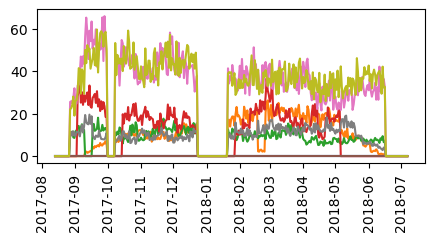

DBSF7692 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


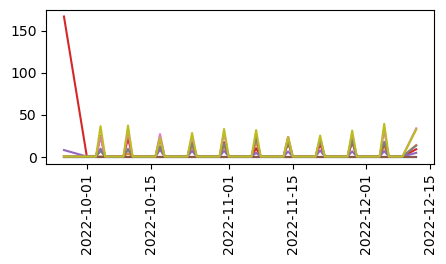

DBSF7705 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


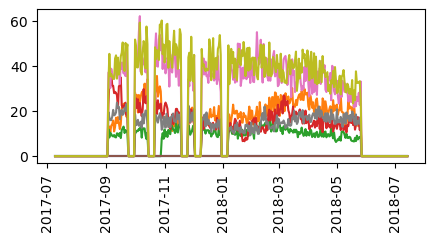

DBSF7717 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


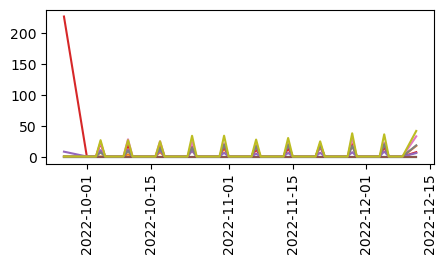

DBSF7722 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


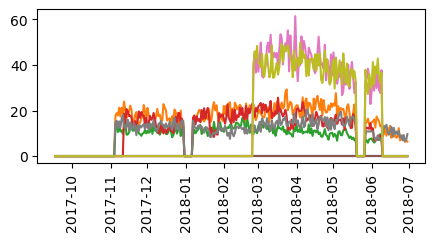

DBSF7740 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


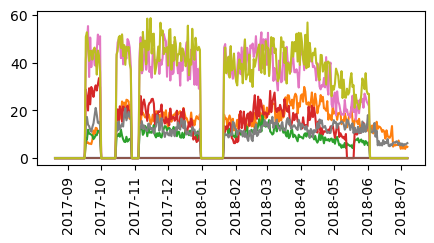

DBSF7828 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


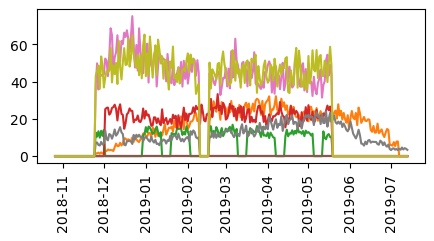

DBSF7863 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


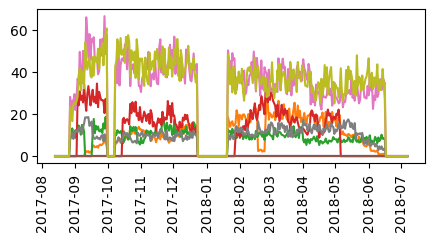

DBSF7882 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


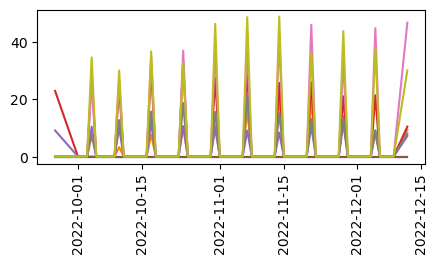

DBSF7897 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


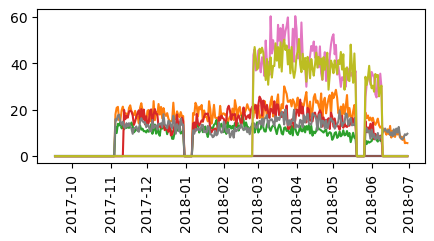

DBSF7898 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


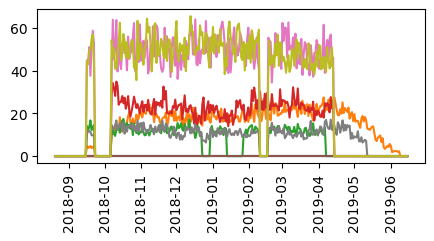

DBSF8040 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


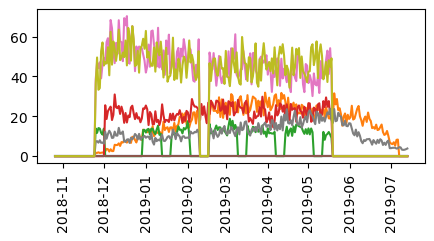

DBSF8047 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


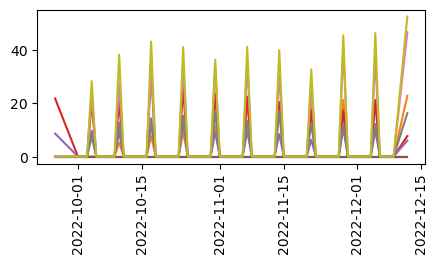

DBSF8065 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


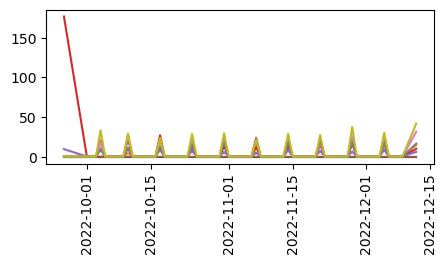

DBSF8072 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


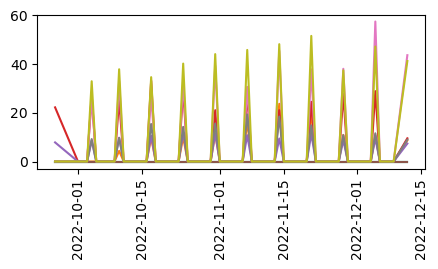

DBSF8083 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


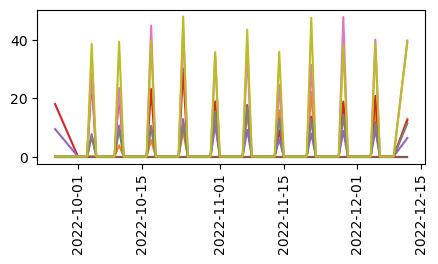

DBSF8124 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


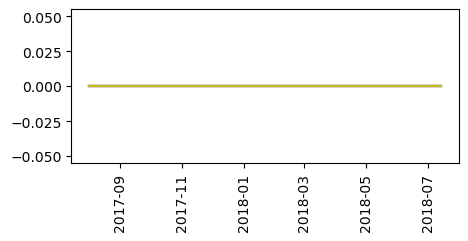

DBSF8175 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


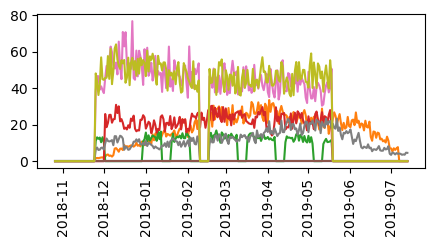

DBSF8195 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


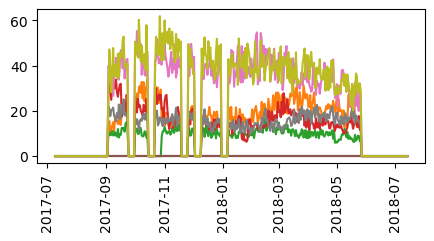

DBSF8205 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


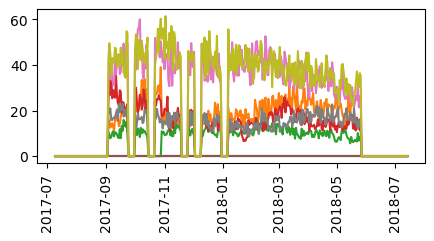

DBSF8221 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


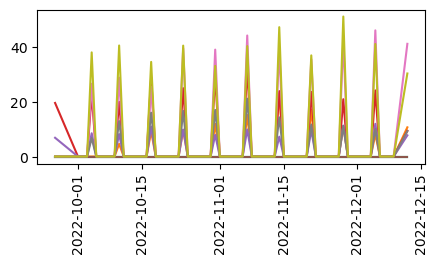

DBSF8230 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


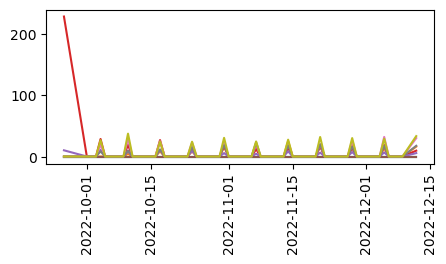

DBSF8242 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


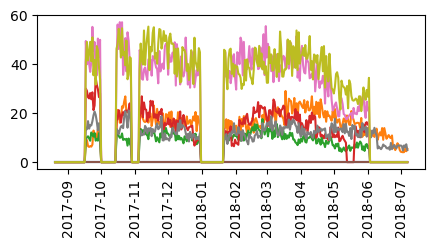

DBSF8258 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


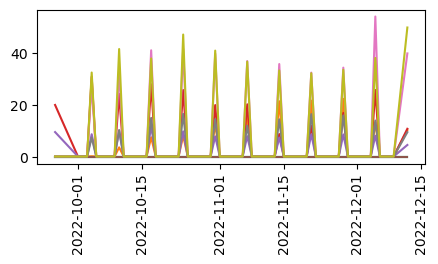

DBSF8285 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


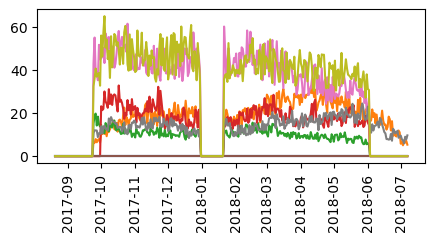

DBSF8293 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


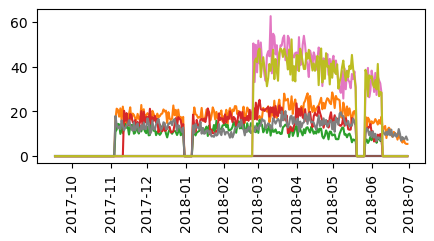

DBSF8318 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


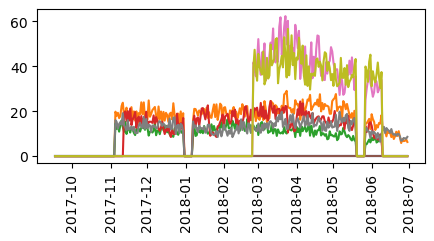

DBSF8381 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


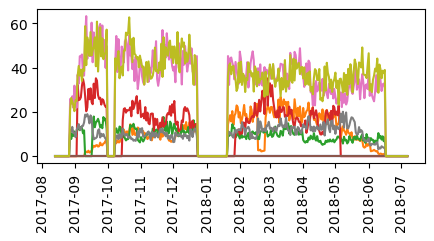

DBSF8383 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


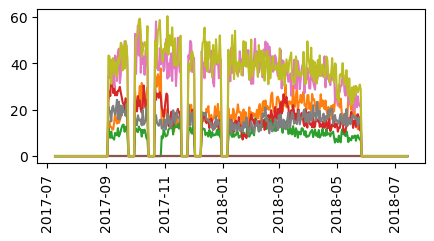

DBSF8405 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


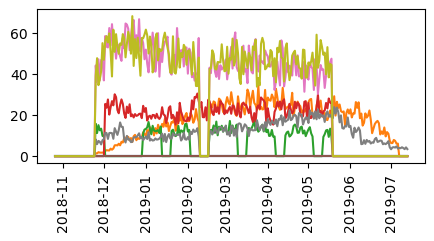

DBSF8411 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


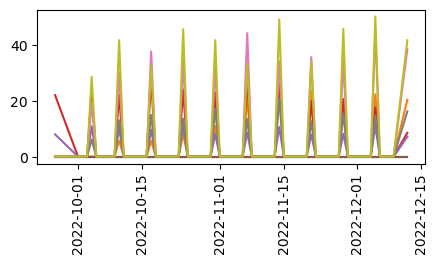

DBSF8440 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


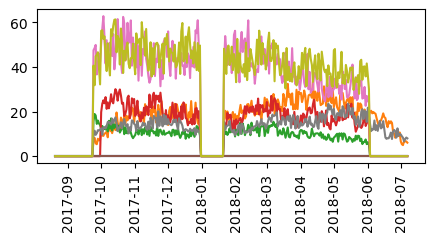

DBSF8457 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


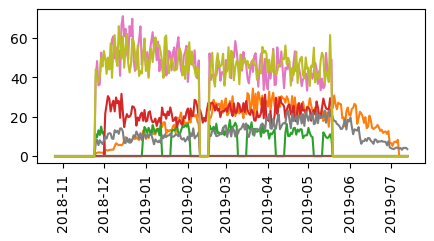

DBSF8462 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


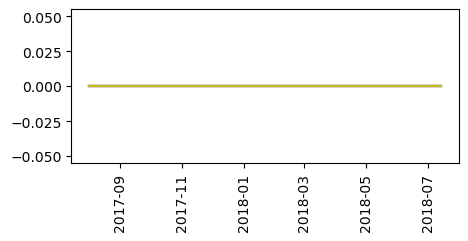

DBSF8492 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


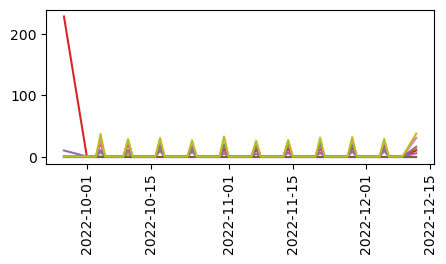

DBSF8512 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


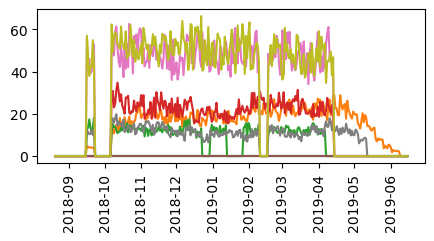

DBSF8533 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


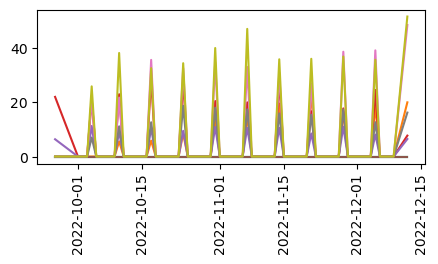

DBSF8545 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


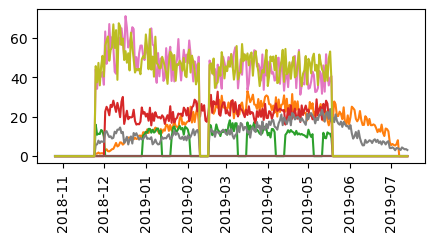

DBSF8557 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


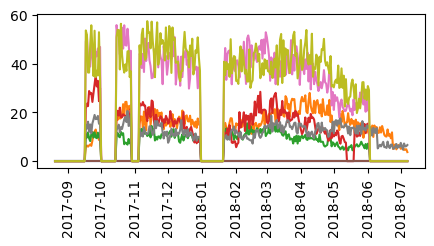

DBSF8573 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


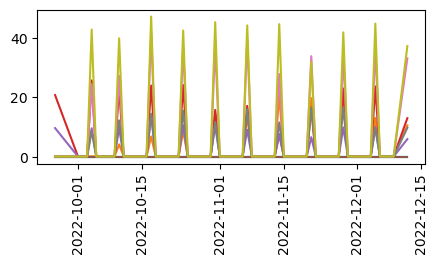

DBSF8588 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


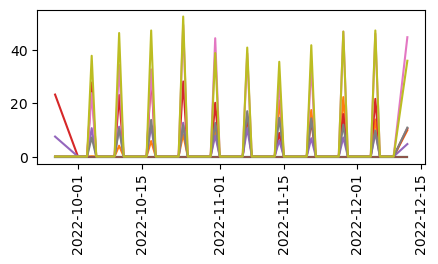

DBSF8590 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


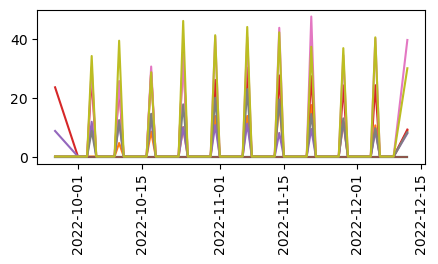

DBSF8665 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


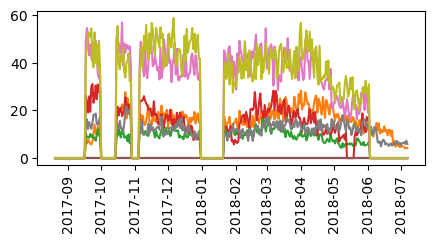

DBSF8670 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


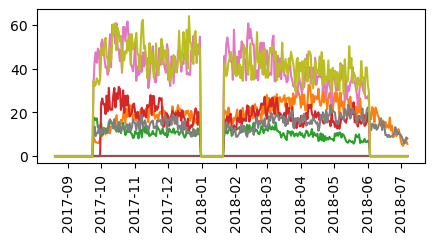

DBSF8704 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


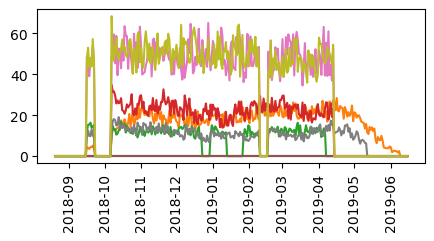

DBSF8721 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


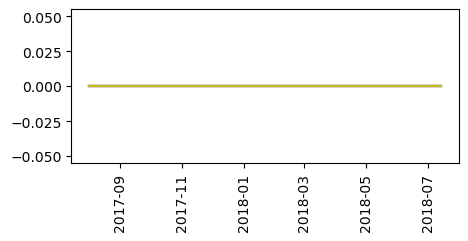

DBSF8764 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


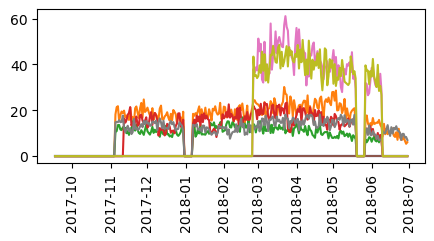

DBSF8793 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


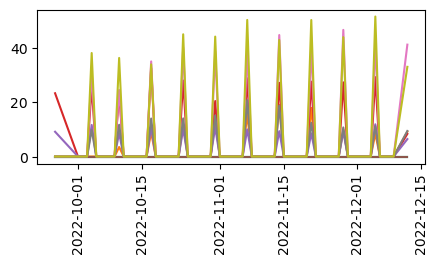

DBSF8830 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


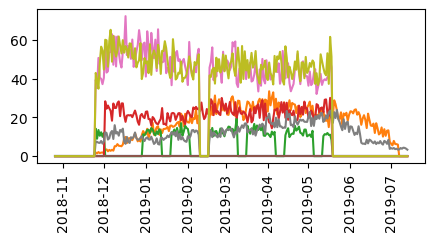

DBSF8906 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


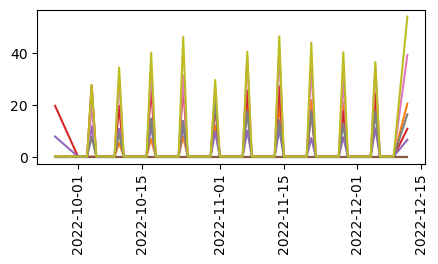

DBSF8924 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


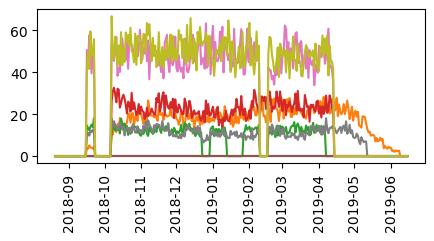

DBSF8958 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


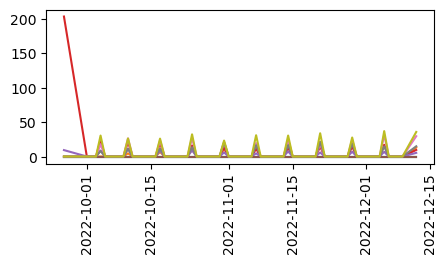

DBSF8966 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


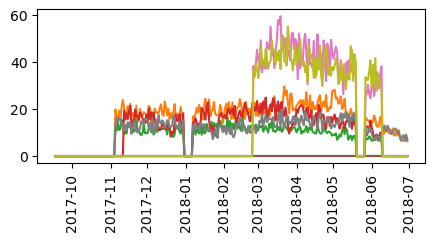

DBSF9076 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


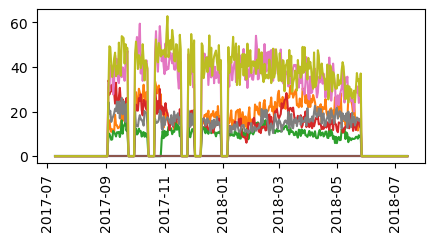

DBSF9088 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


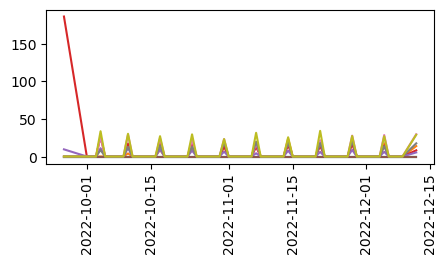

DBSF9161 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


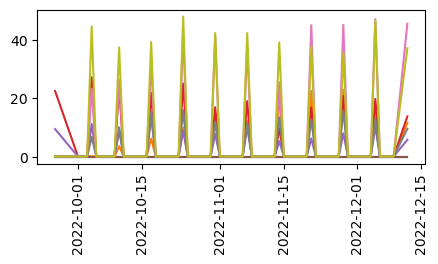

DBSF9172 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


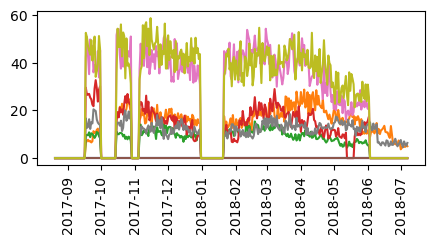

DBSF9184 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


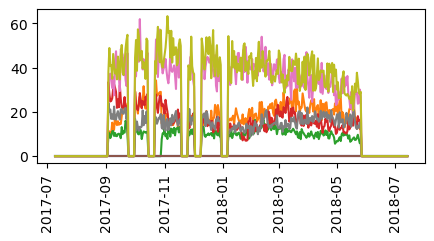

DBSF9221 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


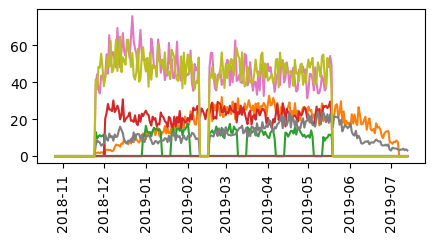

DBSF9223 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


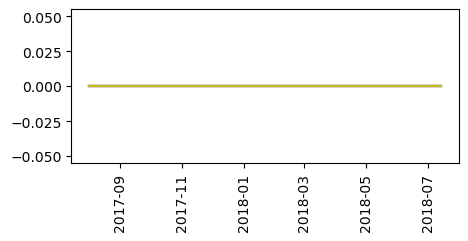

DBSF9229 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


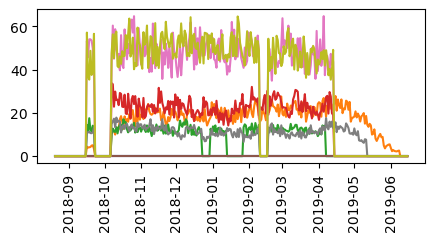

DBSF9275 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


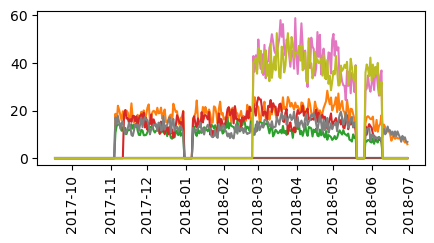

DBSF9369 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


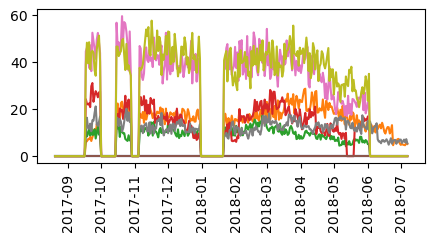

DBSF9377 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


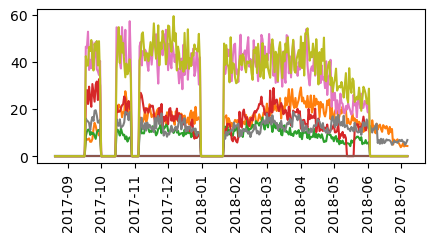

DBSF9378 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


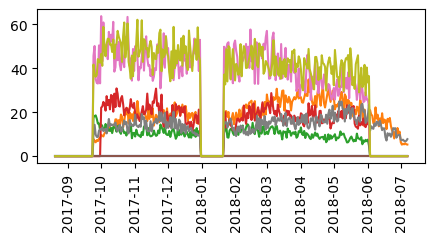

DBSF9391 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


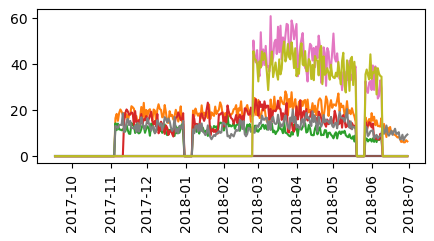

DBSF9404 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


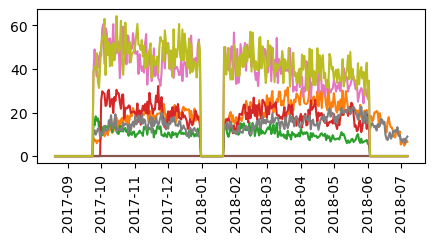

DBSF9406 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


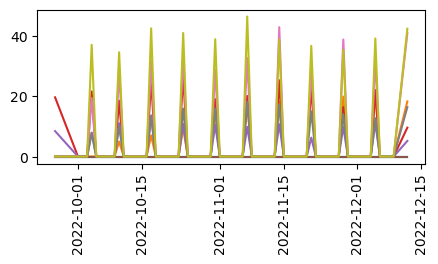

DBSF9498 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


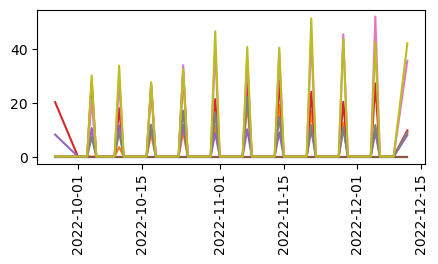

DBSF9546 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


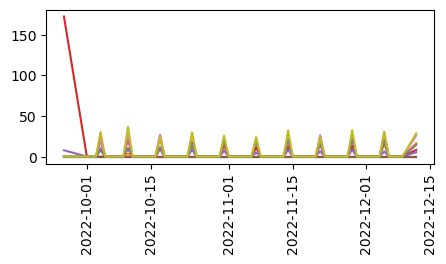

DBSF9627 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


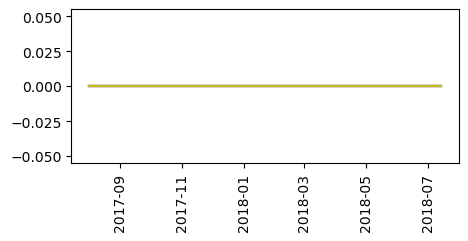

DBSF9631 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


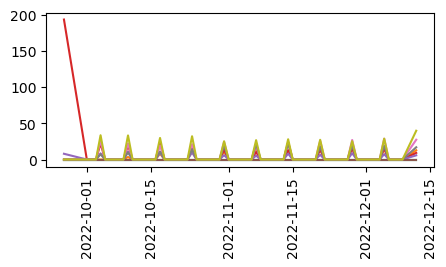

DBSF9675 / Date: 2017-08-13 00:00:00 2018-07-07 00:00:00


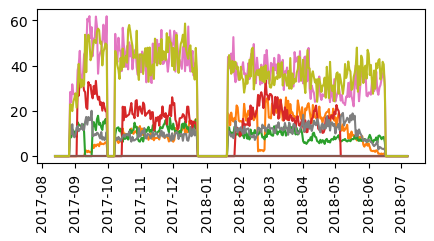

DBSF9688 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


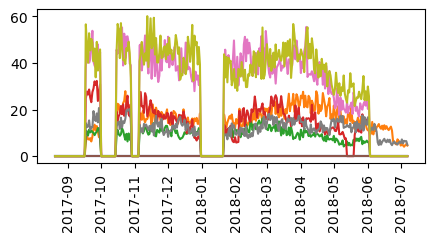

DBSF9741 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


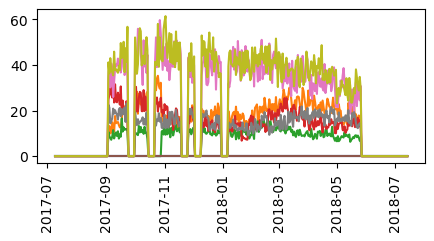

DBSF9746 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


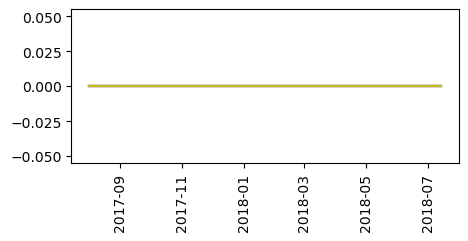

DBSF9761 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


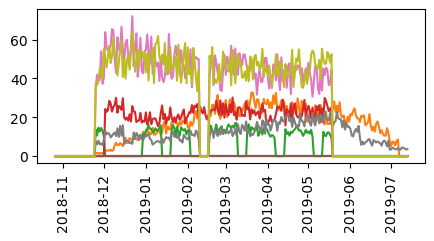

DBSF9777 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


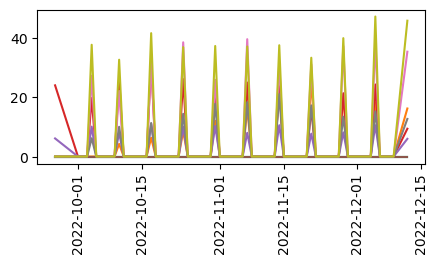

DBSF9793 / Date: 2017-08-20 00:00:00 2018-07-07 00:00:00


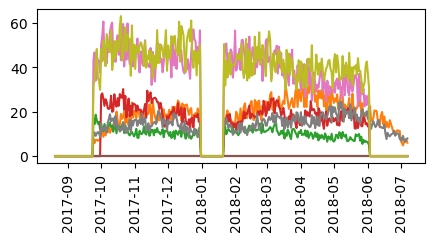

DBSF9838 / Date: 2018-10-26 00:00:00 2019-07-13 00:00:00


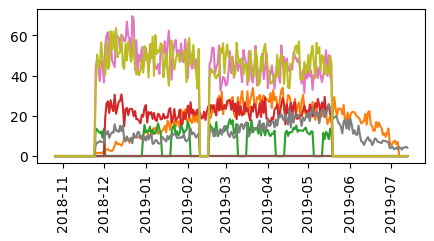

DBSF9894 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


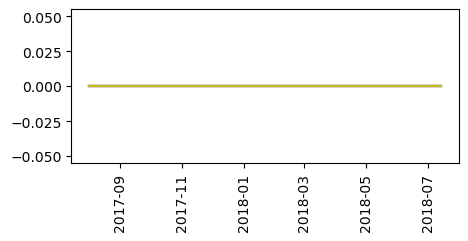

DBSF9922 / Date: 2018-08-20 00:00:00 2019-06-15 00:00:00


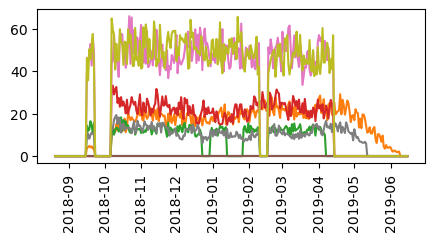

DBSF9942 / Date: 2017-09-17 00:00:00 2018-06-30 00:00:00


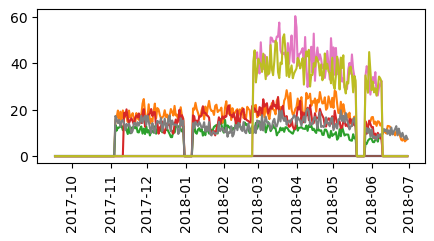

DBSF9948 / Date: 2022-09-26 00:00:00 2022-12-12 00:00:00


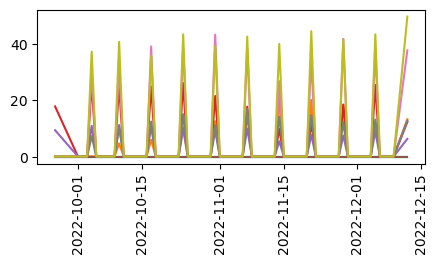

DBSF9961 / Date: 2017-07-09 00:00:00 2018-07-14 00:00:00


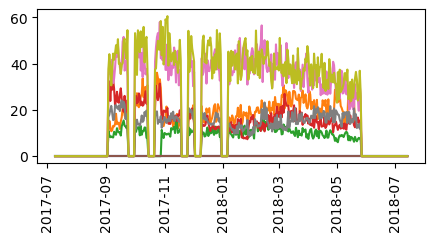

DBSF9969 / Date: 2017-08-01 00:00:00 2018-07-14 00:00:00


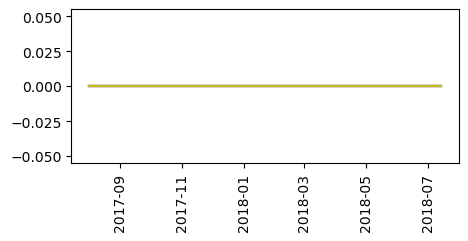

In [269]:
for i in tmp_df3.frmDist.unique():
    plt.figure(figsize=[5,2])
    sub_df = tmp_df3[tmp_df3.frmDist==i]
    print(i, "/ Date:", min(sub_df.date), max(sub_df.date))
    for j in growth_cols:
        plt.plot(sub_df.date, sub_df[j], label=j)
    plt.xticks(rotation=90)
    plt.legend
    plt.show()

In [57]:
for i in cost_col:
    input_data.loc[input_data[i] == 0, i] = np.nan

In [59]:
input_data[cost_col].ffill()

,WaterCost,FertilizerCost,CO2Cost,Mist Cost
59419,NaN,NaN,NaN,NaN
6118,NaN,NaN,NaN,NaN
18828,NaN,NaN,NaN,NaN
6489,NaN,NaN,NaN,NaN
55905,NaN,NaN,NaN,NaN
...,...,...,...,...
3993,222.187605,4496.72269,14.179069,1235.801551
76727,222.187605,4496.72269,14.179069,1235.801551
9524,222.187605,4496.72269,14.179069,1235.801551
67577,222.187605,4496.72269,14.179069,1235.801551


In [76]:
input_data.groupby("frmDist").agg({"date" : ["count",'min', 'max']})

date                    
         count       min       max
frmDist                           
DBSF1059    72  20220926  20221212
DBSF1093    72  20220926  20221212
DBSF1121    72  20220926  20221212
DBSF1172    72  20220926  20221212
DBSF1180    72  20220926  20221212
DBSF1186   322  20170820  20180707
DBSF1205   261  20181026  20190713
DBSF1215   348  20170801  20180714
DBSF1218   261  20181026  20190713
DBSF1232   261  20181026  20190713
DBSF1279    72  20220926  20221212
DBSF1294    72  20220926  20221212
DBSF1385    72  20220926  20221212
DBSF1386   348  20170801  20180714
DBSF1459    72  20220926  20221212
DBSF1466   300  20180820  20190615
DBSF1469    72  20220926  20221212
DBSF1490   322  20170820  20180707
DBSF1505   348  20170801  20180714
DBSF1507    72  20220926  20221212
DBSF1539    72  20220926  20221212
DBSF1554   287  20170917  20180630
DBSF1601    72  20220926  20221212
DBSF1621    72  20220926  20221212
DBSF1644   261  20181026  20190713
DBSF1645   322  20170820  20180707
DBSF1673   371  20170709  20180714
DBSF1757   371  20170709  20180714
DBSF1767   261  20181026  20190713
DBSF1871    72  20220926  20221212
DBSF1873    72  20220926  20221212
DBSF1880   322  20170820  20180707
DBSF1886   371  20170709  20180714
DBSF1916   371  20170709  20180714
DBSF1921    72  20220926  20221212
DBSF1934   322  20170820  20180707
DBSF1974    72  20220926  20221212
DBSF1975   322  20170820  20180707
DBSF1991   287  20170917  20180630
DBSF1998    72  20220926  20221212
DBSF2008   329  20170813  20180707
DBSF2027   322  20170820  20180707
DBSF2032   322  20170820  20180707
DBSF2044    72  20220926  20221212
DBSF2117    72  20220926  20221212
DBSF2191   329  20170813  20180707
DBSF2212    72  20220926  20221212
DBSF2218   348  20170801  20180714
DBSF2244   261  20181026  20190713
DBSF2252    72  20220926  20221212
DBSF2256    72  20220926  20221212
DBSF2259   261  20181026  20190713
DBSF2274   322  20170820  20180707
DBSF2318    72  20220926  20221212
DBSF2319   300  20180820  20190615
DBSF2334   348  20170801  20180714
DBSF2335   371  20170709  20180714
DBSF2347   322  20170820  20180707
DBSF2352   329  20170813  20180707
DBSF2360   322  20170820  20180707
DBSF2371   322  20170820  20180707
DBSF2376    72  20220926  20221212
DBSF2378   322  20170820  20180707
DBSF2389   322  20170820  20180707
DBSF2413   322  20170820  20180707
DBSF2422   329  20170813  20180707
DBSF2471   261  20181026  20190713
DBSF2525   287  20170917  20180630
DBSF2571   329  20170813  20180707
DBSF2630   322  20170820  20180707
DBSF2640   300  20180820  20190615
DBSF2681   348  20170801  20180714
DBSF2686   287  20170917  20180630
DBSF2689    72  20220926  20221212
DBSF2708    72  20220926  20221212
DBSF2752   371  20170709  20180714
DBSF2803   300  20180820  20190615
DBSF2809   322  20170820  20180707
DBSF2822   322  20170820  20180707
DBSF2823    72  20220926  20221212
DBSF2828    72  20220926  20221212
DBSF2832    72  20220926  20221212
DBSF2846    72  20220926  20221212
DBSF2888    72  20220926  20221212
DBSF2911   261  20181026  20190713
DBSF2918   371  20170709  20180714
DBSF2927   322  20170820  20180707
DBSF2989   300  20180820  20190615
DBSF2992    72  20220926  20221212
DBSF3001    72  20220926  20221212
DBSF3010   329  20170813  20180707
DBSF3034   329  20170813  20180707
DBSF3067   322  20170820  20180707
DBSF3068   348  20170801  20180714
DBSF3075    72  20220926  20221212
DBSF3076   261  20181026  20190713
DBSF3118    72  20220926  20221212
DBSF3132   300  20180820  20190615
DBSF3135   371  20170709  20180714
DBSF3165    72  20220926  20221212
DBSF3172    72  20220926  20221212
DBSF3199    72  20220926  20221212
DBSF3205   329  20170813  20180707
DBSF3214   322  20170820  20180707
DBSF3228   261  20181026  20190713
DBSF3311    72  20220926  20221212
DBSF3367   261  20181026  20190713
DBSF3372    72  20220926  20221212
DBSF3383   329  20170813  20180707
DBSF3399   329  20170813  20180707
DBSF3425    72  20220926  20221212
DBSF3426   300  2018

In [ ]:
FertilizerCost  

In [26]:
input_data[cost_col].value_counts()

WaterCost   FertilizerCost  CO2Cost   Mist Cost  
0.000000    0.000000        0.00000   0.000000       76440
274.050604  7802.756432     0.00000   322.000868         1
273.995032  4289.959373     0.00000   12.966536          1
273.903967  3425.757952     0.00000   1871.830211        1
273.899681  4629.418710     13.75219  2286.109282        1
                                                     ...  
186.713806  5448.723526     0.00000   0.000000           1
186.655042  3591.957057     0.00000   1310.921202        1
186.616261  6344.760697     0.00000   1868.512059        1
186.613667  3763.742137     0.00000   0.000000           1
808.241549  11343.143326    0.00000   341.463188         1
Length: 8401, dtype: int64

In [32]:
input_data[usage_col]

,WaterUsage,FertilizerUsage,CO2Usage,MistUsageTime,HeatingEnergyUsage_cumsum
0,0.000000,0.000000,0.000000,0.000000,0.0
1,1347.554178,4711.308821,0.000000,190.168990,0.0
2,69.899353,271.379890,0.000000,0.000000,0.0
3,412.225065,1539.505534,253.744916,0.000000,0.0
4,590.608634,2614.973165,3032.885084,1.149739,0.0
...,...,...,...,...,...
84835,0.000000,0.000000,0.000000,0.000000,0.0
84836,0.000000,0.000000,0.000000,0.000000,0.0
84837,0.000000,0.000000,0.000000,0.000000,0.0
84838,0.000000,0.000000,0.000000,0.000000,0.0


In [6]:
input_data.CO2Cost

0           0.0000
1           0.0000
2           0.0000
3         149.7095
4        1789.4022
           ...    
84835       0.0000
84836       0.0000
84837       0.0000
84838       0.0000
84839       0.0000
Name: CO2Cost, Length: 84840, dtype: float64

In [5]:
### CODE _ STUB ###
"""

For 2023 스마트팜 AI 경진대회 예선 해커톤
Project : 누적 수확량 예측 모델

dataset = '2023_smartFarm_AI_hackathon_dataset.csv'

"""

#  -------------------------------------------
"""
입출력 양식을 
준수해 주십시오

###  INPUT ###
import pandas as pd
input_data = pd.read_csv('2023_smartFarm_AI_hackathon_dataset.csv')

{
    
    Write codes...
    
    # 학습 모델 변수 : model
    # (ex) model.fit()


}



### OUTPUT ###
print("RMSE:", rmse)
"""


# ------------------------------------------------


#      SAMPLE MODEL


# ------------------------------------------------


###  INPUT ###

import pandas as pd

input_data = pd.read_csv("2023_smartFarm_AI_hackathon_dataset.csv")
#  -------------------------------------------
###    Write codes...  ###
#      EXAMPLE CODE      #

"""
input_data = pd.read_csv('2023_smartFarm_AI_hackathon_dataset.csv')

Read CSV files from the given list of file paths and return DataFrames.

"""


# Read CSV files from the lists of file paths


# Now you have lists of DataFrames for each type of data (env, grw, prd)

input_data["outtrn_cumsum"] = input_data["outtrn"].cumsum()
input_data["HeatingEnergyUsage_cumsum"] = input_data["HeatingEnergyUsage"].cumsum()

import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


def calculate_rmse(targets, predictions):
    """
    Calculate the Root Mean Squared Error (RMSE) between predicted and target values.

    :param predictions: Predicted values.
    :type predictions: array-like
    :param targets: Target values.
    :type targets: array-like
    :return: RMSE value.
    :rtype: float
    """
    return np.sqrt(mean_squared_error(targets, predictions))


# ... (Data preprocessing code here)


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, Y, test_size=0.2, random_state=42
)

# Initialize and train the LinearRegression model
model = LinearRegression()
model.fit(X_train, y_train)

# Predict 'prd' values using the trained model
y_pred = model.predict(X_test)

# Calculate RMSE between the predictions and actual 'prd' values
rmse = calculate_rmse(y_test, prd_preds)


# Calculate r2_score between the predictions and actual 'y' values
def calculate_R2_score(y_test,y_pred):
    from sklearn.metrics import r2_score
    return r2_score(y_test, y_pred)


r2score = calculate_R2_score(y_test, y_pred)

# ------------------------------------------------
### OUTPUT ###
print("RMSE:", rmse)
print("R2_score:", r2score)

FileNotFoundError: [Errno 2] No such file or directory: '2023_smartFarm_AI_hackathon_dataset.csv'

In [1]:
input_data = pd.read_csv("2023_smartFarm_AI_hackathon_dataset.csv")

NameError: name 'pd' is not defined